# TEST CON FEATURES DEL PSD

# Generar 'X' e 'y' para todos los experimentos
<p>Como datos para las X se toma la media de los 17 canales de:</p>
<ul>
    <li>X_1: PSD de la banda delta (1~4Hz)</li>
    <li>X_2: PSD de la banda theta (4~8Hz)</li>
    <li>X_3: PSD de la banda alpha (8~14Hz)</li>
    <li>X_4: PSD de la banda beta (14~31Hz)</li>
    <li>X_5: PSD de la banda gamma (31~50 Hz)</li>
</ul>

In [1]:
import mne
from mne.externals.pymatreader import read_mat

from read import read_features

import matplotlib
import matplotlib.pyplot as plt

import numpy as np

import pandas as pd

from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler

In [2]:
labels = {
    'leve': 0,
    'moderada': 1,
    'severa': 2
}

def parse_y(y, lim_leve=0.075, lim_moderada=0.15):
    def classify(val):
        if (val <= lim_leve):
            return labels['leve']
        if (val <= lim_moderada):
            return labels['moderada']
        return labels['severa']
    
    len_y = len(y)
    classified = np.zeros(len_y, dtype=int)
    
    for i in range(len_y):
        classified[i] = classify(y[i])
        
    return classified

In [3]:
# Las que mejores graficas tienen
# features_files = ['4_20151105_noon.mat', '4_20151107_noon.mat', '5_20141108_noon.mat','12_20150928_noon.mat','14_20151014_night.mat', '18_20150926_noon.mat', '21_20151016_noon.mat']

# features_files = ['4_20151105_noon.mat', '5_20141108_noon.mat', '21_20151016_noon.mat']

features_files = ['1_20151124_noon_2.csv', '2_20151106_noon.csv', '3_20151024_noon.csv','4_20151105_noon.csv', '4_20151107_noon.csv',
            '5_20141108_noon.csv', '5_20151012_night.csv', '6_20151121_noon.csv','7_20151015_night.csv', '8_20151022_noon.csv', 
            '9_20151017_night.csv', '10_20151125_noon.csv', '11_20151024_night.csv', '12_20150928_noon.csv', '13_20150929_noon.csv',
            '14_20151014_night.csv','15_20151126_night.csv', '16_20151128_night.csv', '17_20150925_noon.csv', '18_20150926_noon.csv',
            '19_20151114_noon.csv', '20_20151129_night.csv', '21_20151016_noon.csv']

# features_files = ['21_20151016_noon.csv']

X_all = {} # psd
X_all_eog = {} # psd + eog
y_all = {} # datos perclos raw
y_all_limits = {} # thresholds perclos para cada experimento
y_all_class = {} # datos parseados a su clase

for experiment in features_files:
    
    ''' EOG parpadeos por epoch'''
    mat_data = read_mat(f'./SEED-VIG/Raw_Data/{experiment[:-4]}.mat')
    
    sfreq = mat_data['EOG']['eog_config']['current_sample_rate']
    samples = mat_data['EOG']['eog_h']*1e-6 
    samples = np.vstack((samples, mat_data['EOG']['eog_v']*1e-6))

    ch_names = ['EOG_H', 'EOG_V']
    ch_types = ["eog"]*len(ch_names)

    info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types=ch_types)

    info.set_montage('standard_1020')
    
    raw = mne.io.RawArray(samples, info, verbose=False)
    
    # Busqueda del treshold para el parpadeo
    # En los 5 primeros segundos del experimento, buscamos el percentil 2.5 y calculamos su valor absoluto como threshold para detectar parpadeos
    threshold = abs(np.percentile(raw.get_data()[1][:5*1000], 2.5))
    
    blinks = mne.preprocessing.find_eog_events(raw, filter_length='10s', thresh=threshold, verbose=False)
    blinks = blinks.T[0]
    
    n_samples = 885
    dur_sample = 8 # segs
    len_sample = 8*125
    
    blinks_per_sample = []
    for i in range(n_samples):
        blinks_per_sample.append([])
        
    for val in blinks:
        blinks_per_sample[val//len_sample].append(val)
    
    n_blinks_per_sample = [0]*n_samples
        
    for i in range(885):
        n_blinks_per_sample[i] = len(blinks_per_sample[i])
        
    scaler = MinMaxScaler(feature_range=(0, 1))
    n_blinks_per_sample = np.array(n_blinks_per_sample)
    n_blinks_per_sample = scaler.fit_transform(n_blinks_per_sample.reshape(-1,1))
    
    
    ''' PSD '''
    mat_data = read_mat(f'./SEED-VIG/EEG_Feature_5Bands/{experiment[:-4]}.mat')
    perclos_data = read_mat(f'./SEED-VIG/perclos_labels/{experiment[:-4]}.mat')
    y = np.array(perclos_data['perclos'])

    n_channels = 17
    psd_data = mat_data['psd_movingAve']
    perclos = []
    psd_delta = []
    psd_theta = []
    psd_alpha = []
    psd_beta = []
    psd_gamma = []
    start = 0
    end = 885
    for t in range(start, end):
        vals= np.zeros(5)

        for i in range(n_channels):
            vals[0] += psd_data[i][t][0]
            vals[1] += psd_data[i][t][1]
            vals[2] += psd_data[i][t][2]
            vals[3] += psd_data[i][t][3]
            vals[4] += psd_data[i][t][4]
        vals /= 17

        perclos.append(y[t])
        psd_delta.append(vals[0])
        psd_theta.append(vals[1])
        psd_alpha.append(vals[2])
        psd_beta.append(vals[3])
        psd_gamma.append(vals[4])

    
    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_delta = np.array(psd_delta)
    psd_delta = scaler.fit_transform(psd_delta.reshape(-1,1))

    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_theta = np.array(psd_theta)
    psd_theta = scaler.fit_transform(psd_theta.reshape(-1,1))

    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_alpha = np.array(psd_alpha)
    psd_alpha = scaler.fit_transform(psd_alpha.reshape(-1,1))

    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_beta = np.array(psd_beta)
    psd_beta = scaler.fit_transform(psd_beta.reshape(-1,1))
    
    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_gamma = np.array(psd_gamma)
    psd_gamma = scaler.fit_transform(psd_gamma.reshape(-1,1))

    X = psd_delta
    X = np.hstack((X, psd_theta))
    X = np.hstack((X, psd_alpha))
    X = np.hstack((X, psd_beta))
    ''' DESCOMENTAR PARA USAR PSD DE GAMMA '''
    X = np.hstack((X, psd_gamma))
    
    X_all[f'{experiment[:-4]}'] = X # guardamos los psd
    
    X = np.hstack((X, n_blinks_per_sample))
    
    X_all_eog[f'{experiment[:-4]}'] = X # guardamos psd + eog
    
    ''' LABELS '''
    y_all[f'{experiment[:-4]}'] = y # guardamos perclos raw
    
    range_values = (np.max(y)-np.min(y))/100
    lim_leve = np.min(y)+range_values*12.5
    lim_moderada = np.min(y)+range_values*30
    y_all_limits[f'{experiment[:-4]}'] = [lim_leve, lim_moderada]
    
    y_all_class[f'{experiment[:-4]}'] = parse_y(y, lim_leve, lim_moderada) # guardamos ya clasificada
    
print(f'Generados los diccionarios X_all e y_all')

KeyboardInterrupt: 

In [ ]:
print(X_all_eog['1_20151124_noon_2'].shape)

for key in X_all:
    print(key)

# Para busqueda de hyperparametros y plotear resultados/metricas

## Clasificacion

In [ ]:
from sklearn.model_selection import RandomizedSearchCV

from sklearn.model_selection import StratifiedShuffleSplit

from sklearn.model_selection import train_test_split

from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
from sklearn.metrics import plot_confusion_matrix

from scipy.stats import uniform, randint, loguniform, gamma

def find_and_test_best_model_class(X, y, model, space, cv=10, n_iter=100, scoring=None, conf_mat=True):
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)
    
    search = RandomizedSearchCV(model, space, n_iter=n_iter, scoring=scoring, n_jobs=-1, cv=cv, random_state=42)
    result = search.fit(X_train, y_train)
    
    print(f"Best Model:")
    print(f"\tScore: {result.best_score_:.4f}")
    print(f"\tHyperparameters: {result.best_params_}")
    
    print('\nResults with X_test:')
    best_model = result.best_estimator_
    final_predictions = best_model.predict(X_test)
    
    #TODO sklearn.metrics.classification_report ofrece los siguientes parametros y alguna cosilla mas, puede ser interesante ???
    acc = accuracy_score(y_test, final_predictions)
    pre = precision_score(y_test, final_predictions, average='macro', zero_division=1)
    rec = recall_score(y_test, final_predictions, average='macro', zero_division=1)
    f1 = f1_score(y_test, final_predictions, average='macro', zero_division=1)
    print(f"\tAccuracy: {acc*100:.2f}%")
    print(f"\tPrecision: {pre:.4f}")
    print(f"\tRecall: {rec:.4f}")
    print(f"\tf1: {f1:.4f}")
    
    ''' PARA MOSTRAR LA MATRIZ DE CONFUSION HAY QUE PASAR EL PARAMETRO conf_mat=True '''
    if (conf_mat):
        print(f'Matriz de confusión para X completo')
        try:
            plot_confusion_matrix(best_model, X, y, display_labels=['leve', 'moderara', 'severa'])
        except:
            pass
    
    return best_model, acc, pre, rec, f1

def map_2_colors(y, labels):
    label_2_color = {
        0: 'green',
        1: 'orange',
        2: 'red'
    }
    
    cmap = []
    for i in range(len(y)):
        cmap.append(label_2_color[y[i]])
    return cmap

def plot_results_class(X, y, model, lim_leve_moderada, lim_moderada_severa):
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(y, c='k', alpha=0.6)
    colors = map_2_colors(model.predict(X), labels)
    plt.scatter(range(len(y)), y, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

## Juntamos todos los datos en un solo X e y

In [ ]:
from read import read_features

X = []
X_eog = []
X_eeg = []
y = []
y_class = []

for key in X_all:
    X.append(X_all[key])
    X_eog.append(X_all_eog[key])
    aux, aux2 = read_features(f'./features/{key}.csv')
    scaler = MinMaxScaler(feature_range=(0, 1))
    aux_minmax = scaler.fit_transform(aux)
    X_eeg.append(aux_minmax)
    
    y.append(y_all[key])
    y_class.append(y_all_class[key])

X = np.array(X)
X = X.reshape((X.shape[0]*X.shape[1], X.shape[2]))
X_eog = np.array(X_eog)
X_eog = X_eog.reshape((X_eog.shape[0]*X_eog.shape[1], X_eog.shape[2]))
X_eeg = np.array(X_eeg)
X_eeg = X_eeg.reshape((X_eeg.shape[0]*X_eeg.shape[1], X_eeg.shape[2]))

y = np.array(y)
y = y.reshape((y.shape[0]*y.shape[1]))
y_class = np.array(y_class)
y_class = y_class.reshape((y_class.shape[0]*y_class.shape[1]))

In [ ]:
print(f'{X.shape}, {X_eog.shape}, {X_eeg.shape}, {y.shape}, {y_class.shape}')

# Modelo General
Se entrena con todos los datos de los experimentos

## SMV-c

In [8]:
from sklearn.svm import SVC

### SMV-c EEG

In [ ]:
print(f"Experiment: Modelo General SVM-c EEG")
model = SVC(random_state=42)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['C'] = uniform(1, 20)
space['kernel'] = ['linear', 'rbf']
space['gamma'] = ['scale', 'auto']
space['shrinking'] = [True, False]
space['probability'] = [True, False]
space['decision_function_shape'] = ['ovo', 'ovr']

general_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_eeg, y_class, model, space, cv=cv,  n_iter=10)

In [ ]:
for key in X_all:
    data, aux2 = read_features(f'./features/{key}.csv')
    scaler = MinMaxScaler(feature_range=(0, 1))
    data_minmax = scaler.fit_transform(data)
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(general_model.predict(data_minmax), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

### SMV-c PSD

In [ ]:
print(f"Experiment: Modelo General SVM-c PSD")
model = SVC(random_state=42)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['C'] = uniform(1, 20)
space['kernel'] = ['linear', 'rbf']
space['gamma'] = ['scale', 'auto']
space['shrinking'] = [True, False]
space['probability'] = [True, False]
space['decision_function_shape'] = ['ovo', 'ovr']

general_model, acc, pre, rec, f1 = find_and_test_best_model_class(X, y_class, model, space, cv=cv,  n_iter=10)

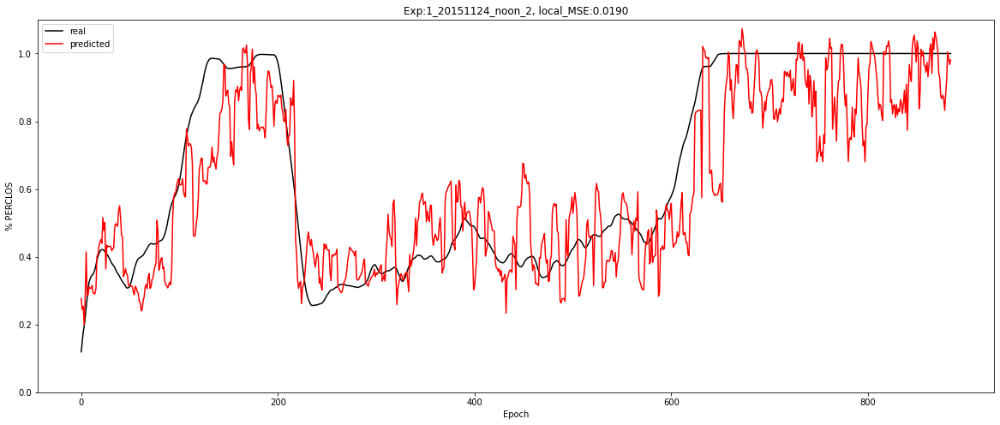

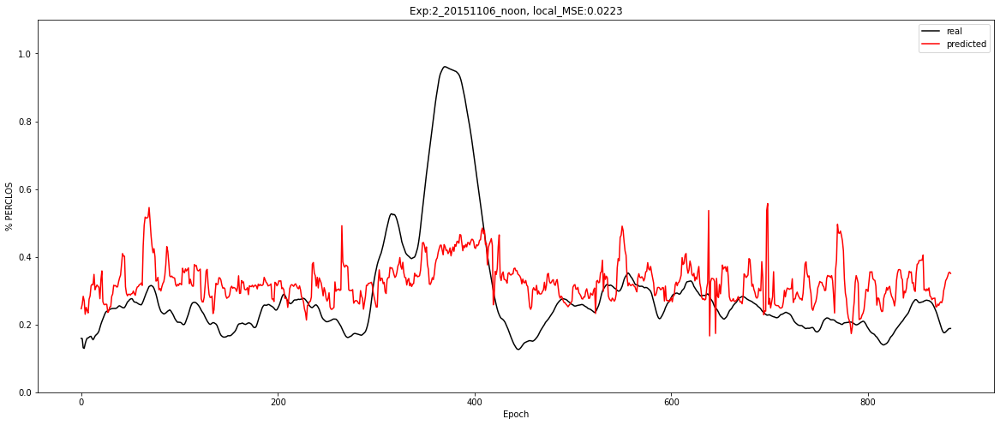

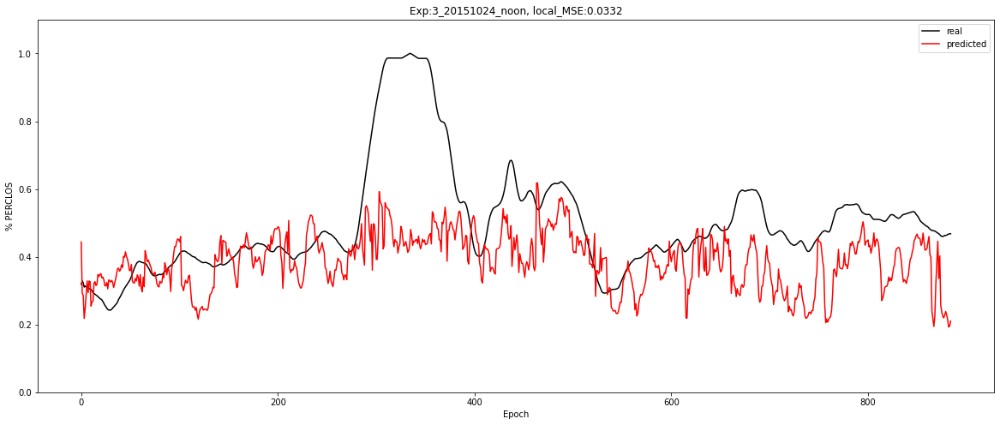

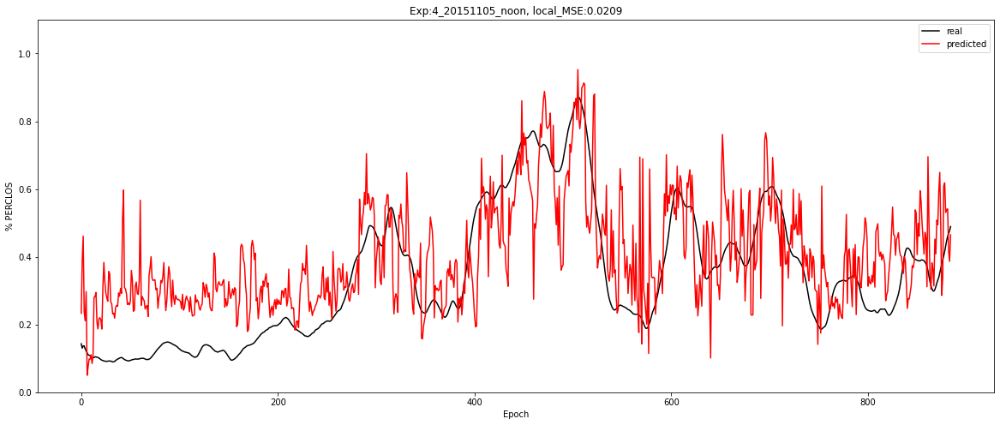

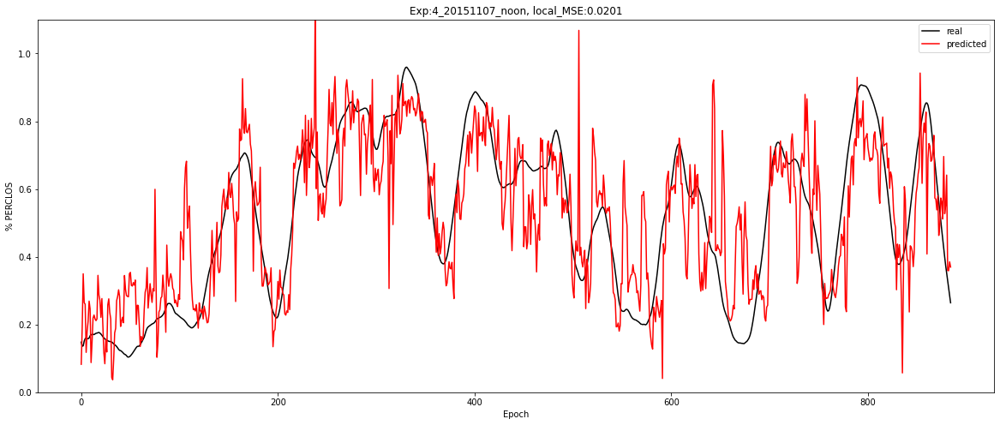

...

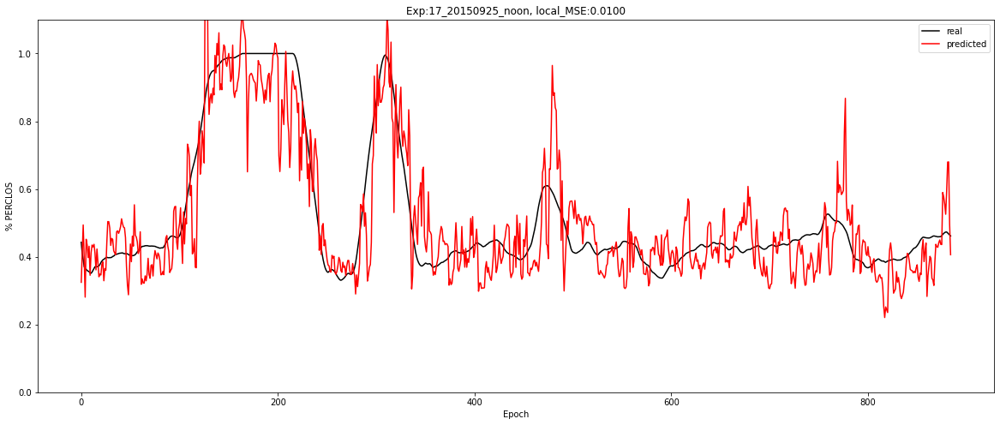

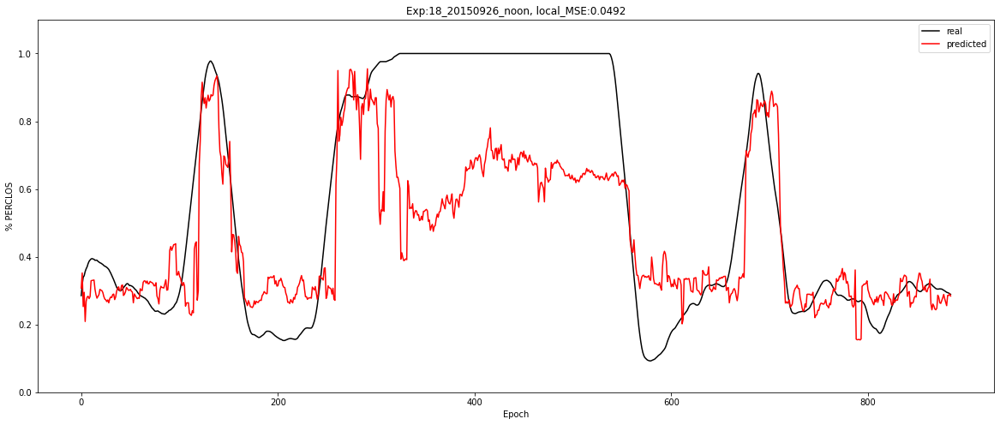

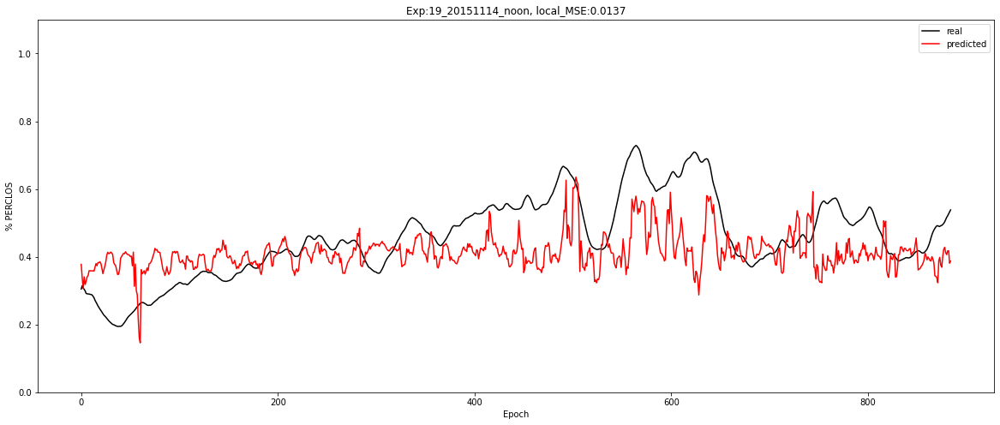

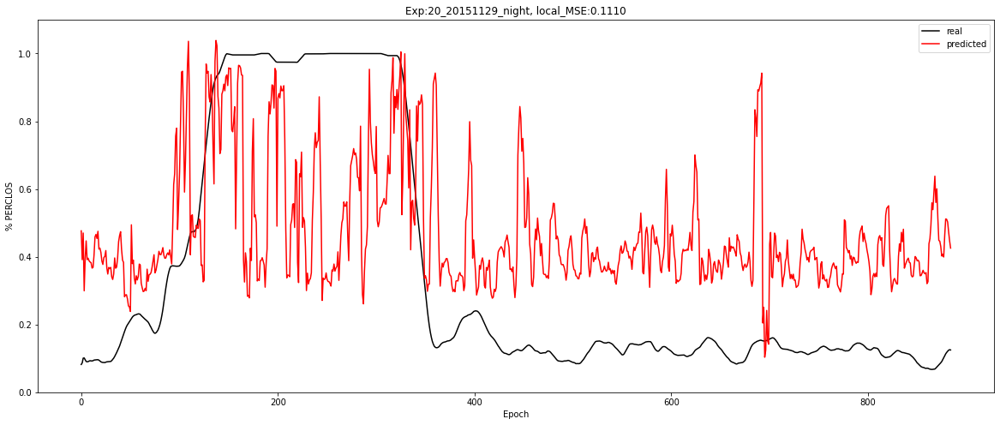

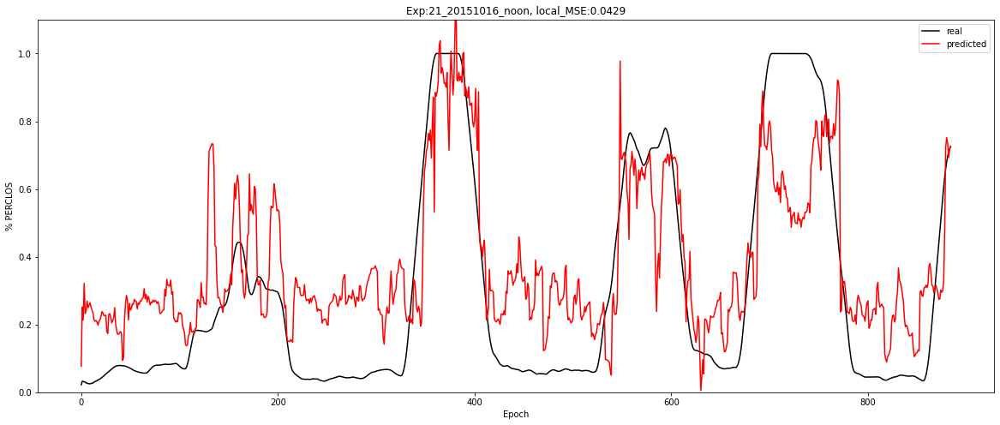

In [25]:
for key in X_all:
    data = X_all[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(general_model.predict(data), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

### SMV-c PSD + EOG

In [95]:
print(f"Experiment: Modelo General SVM-c PSD + EOG")
model = SVC(random_state=42)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['C'] = uniform(1, 20)
space['kernel'] = ['linear', 'rbf']
space['gamma'] = ['scale', 'auto']
space['shrinking'] = [True, False]
space['probability'] = [True, False]
space['decision_function_shape'] = ['ovo', 'ovr']

general_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_eog, y_class, model, space, cv=cv,  n_iter=10)

Experiment: Modelo General SVM-r PSD + EOG
Best Model:
	Score: 0.5409
	Hyperparameters: {'C': 100, 'epsilon': 0.08143340896097039, 'gamma': 'scale', 'kernel': 'rbf', 'shrinking': True, 'tol': 0.09700098521619943}

Results with X_test:
	RMSE: 0.1807
	r^2: 0.5579


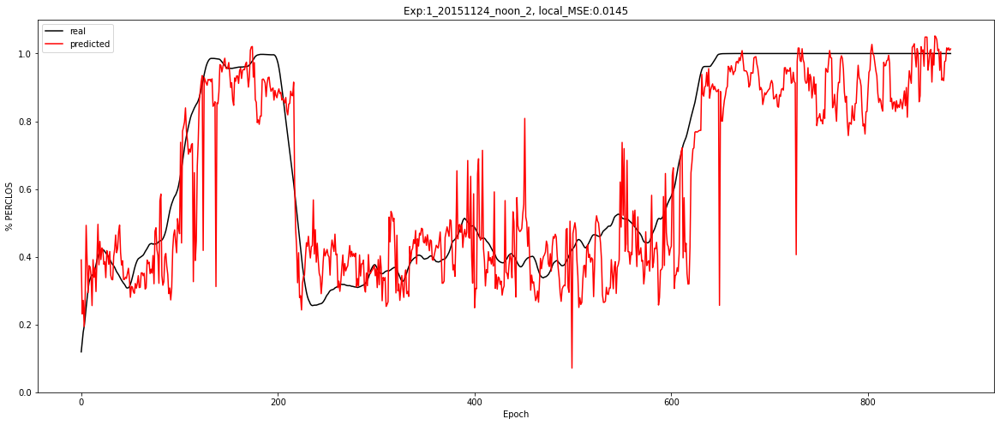

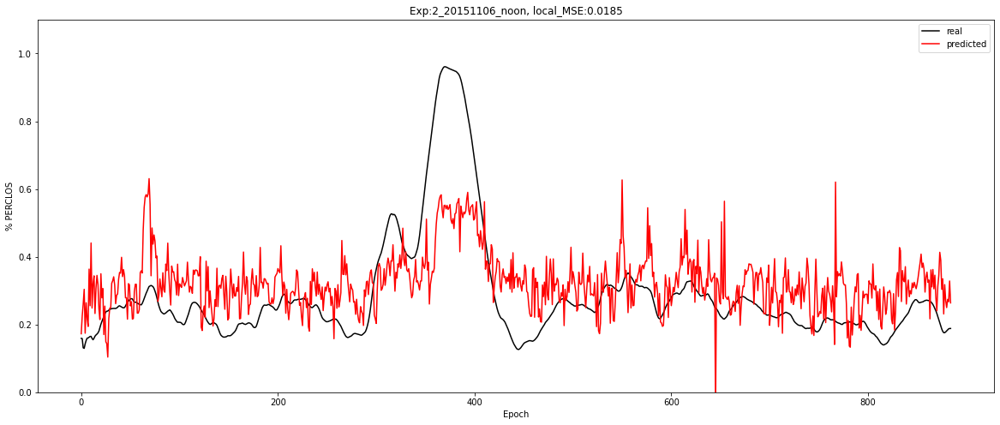

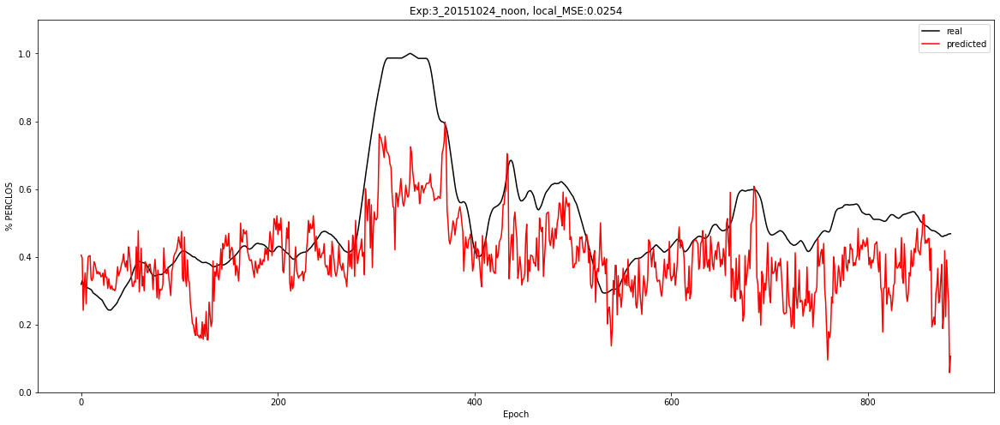

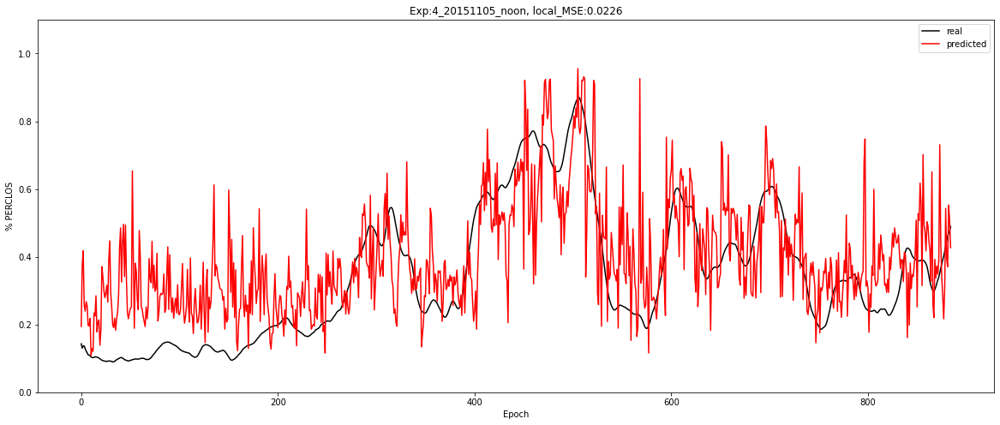

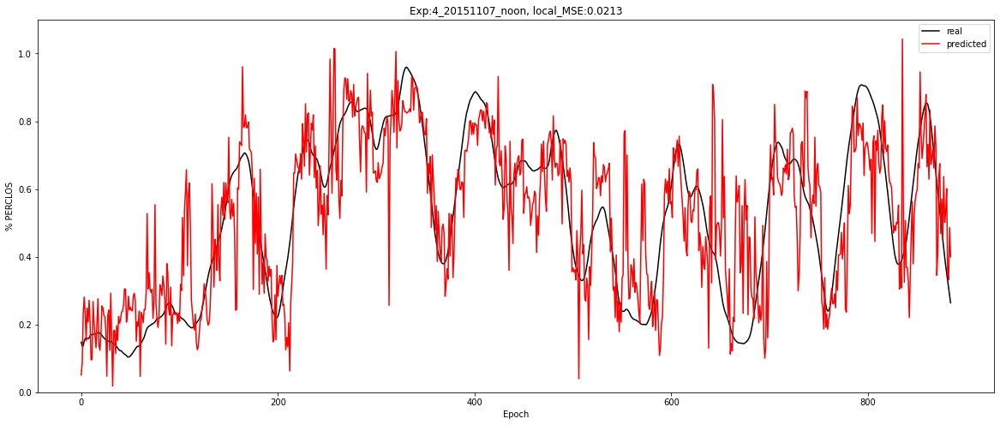

...

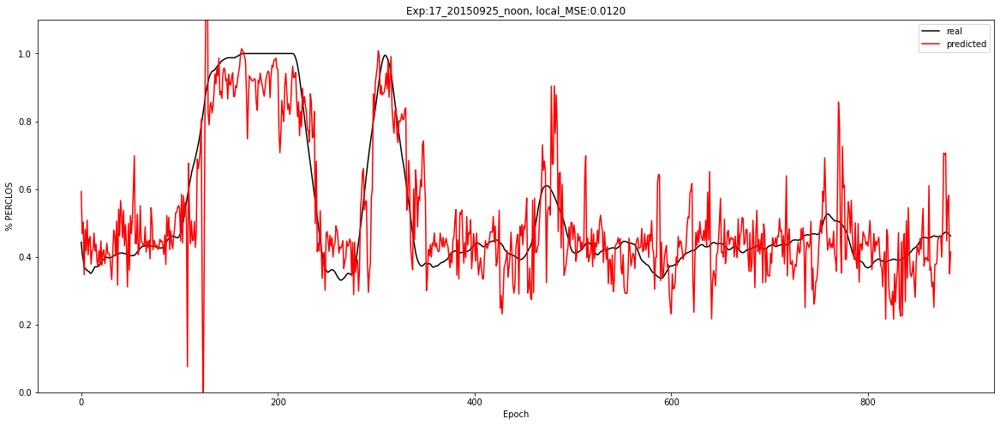

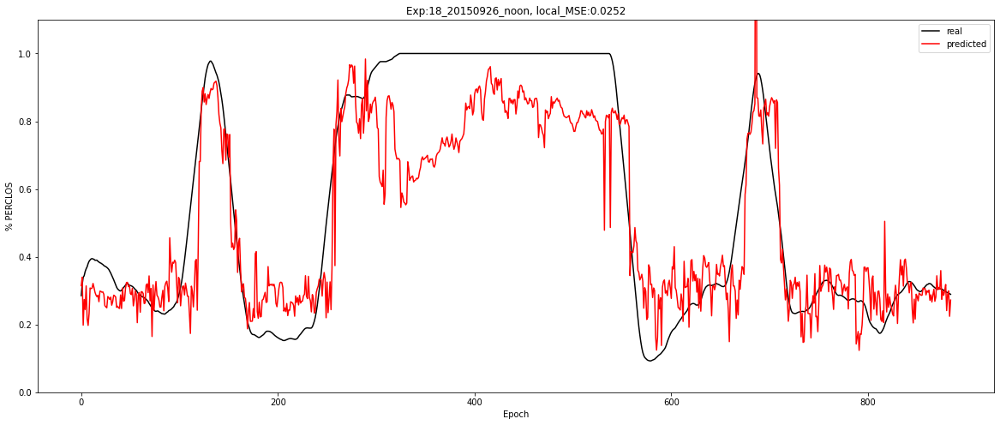

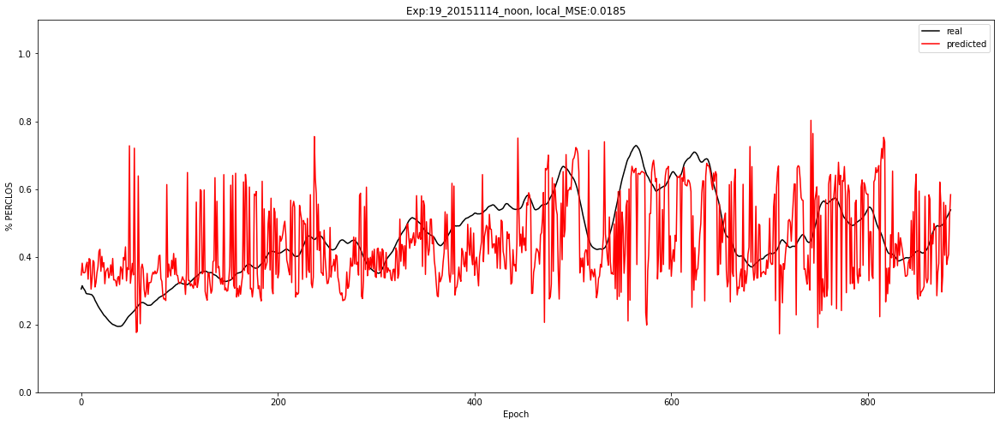

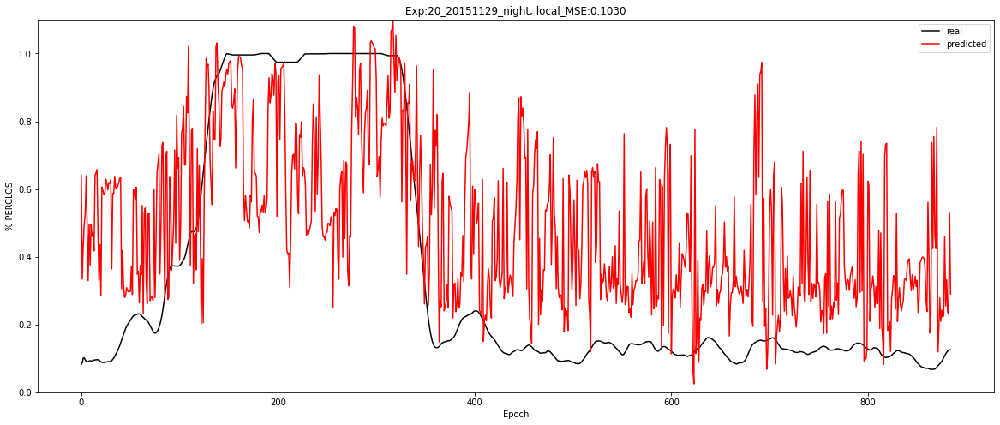

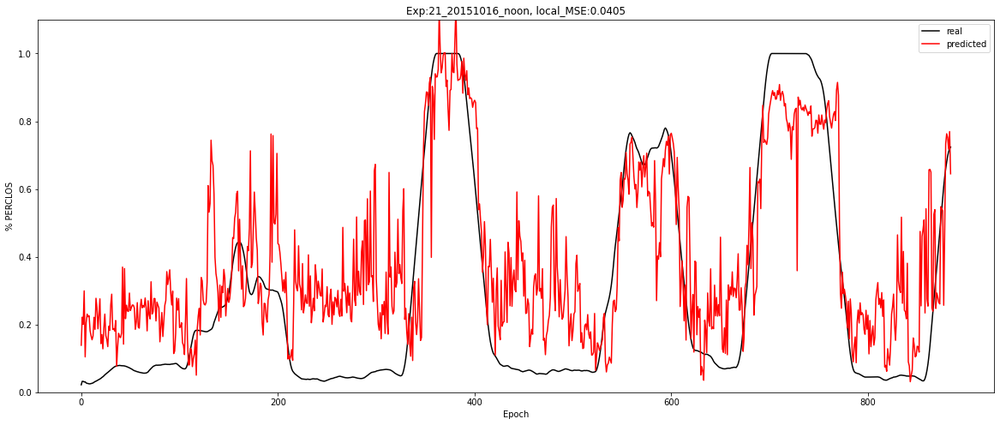

In [96]:
for key in X_all:
    data = X_all_eog[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(general_model.predict(data), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

## KNN

In [14]:
from sklearn.neighbors import KNeighborsClassifier

### KNN EEG

Experiment: Modelo General KNN EEG
Best Model:
	Score: 0.6953
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 43, 'n_neighbors': 17, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 70.29%
	Precision: 0.6493
	Recall: 0.6312
	f1: 0.6374
Matriz de confusión para X completo


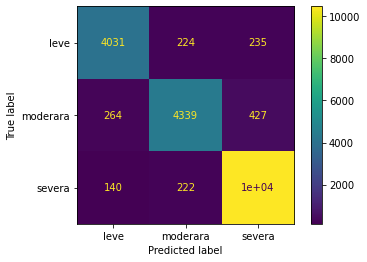

In [35]:
print(f"Experiment: Modelo General KNN EEG")
model = KNeighborsClassifier()

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['n_neighbors'] = randint(3, 21)
space['weights'] = ['uniform', 'distance']
space['algorithm'] = ['auto', 'ball_tree', 'kd_tree', 'brute']
space['leaf_size'] = randint(15,50)
space['p'] = [1, 2]

general_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_eeg, y_class, model, space, cv=cv,  n_iter=5)

Experiment: 1_20151124_noon_2


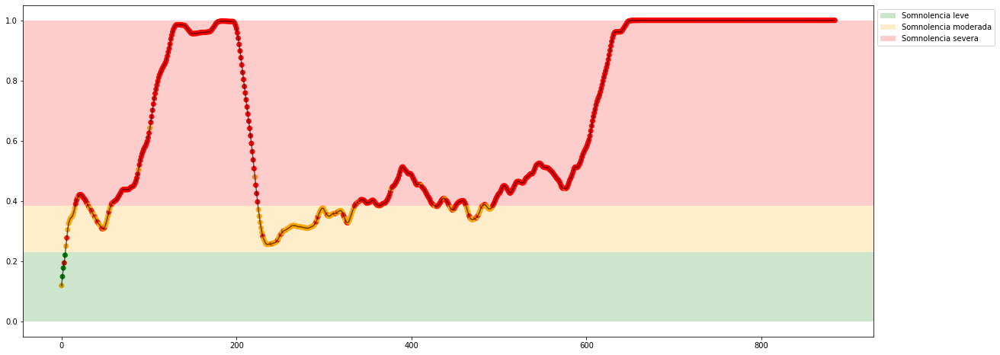

Experiment: 2_20151106_noon


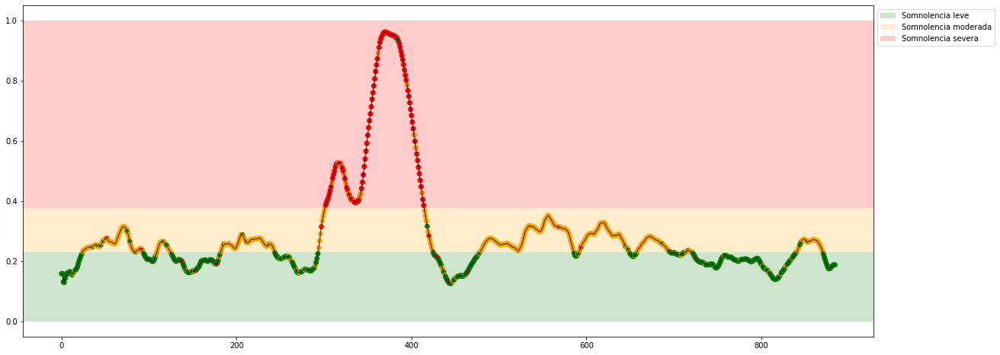

Experiment: 3_20151024_noon


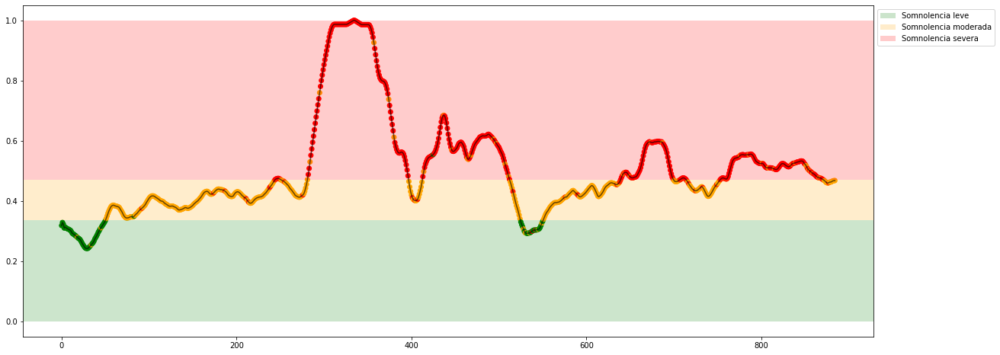

Experiment: 4_20151105_noon


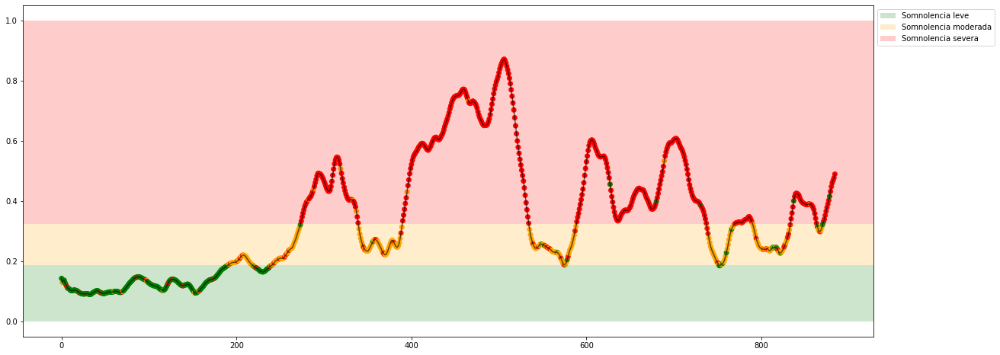

Experiment: 4_20151107_noon


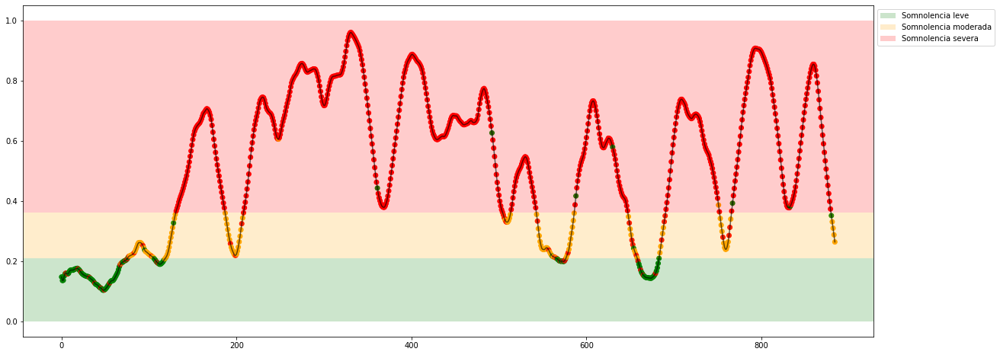

Experiment: 5_20141108_noon


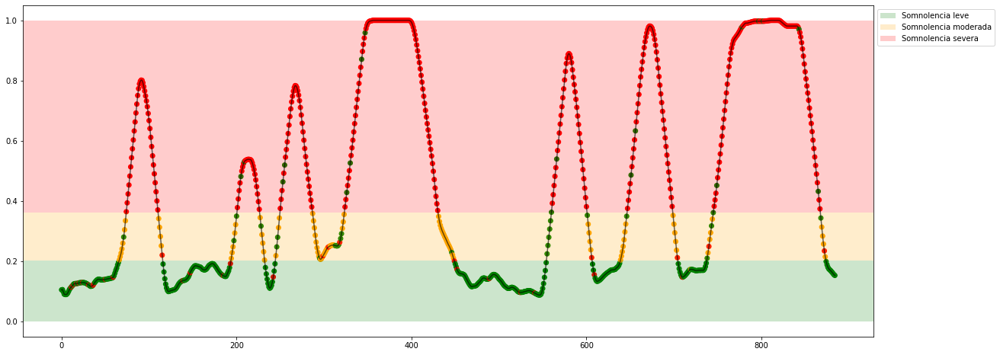

Experiment: 5_20151012_night


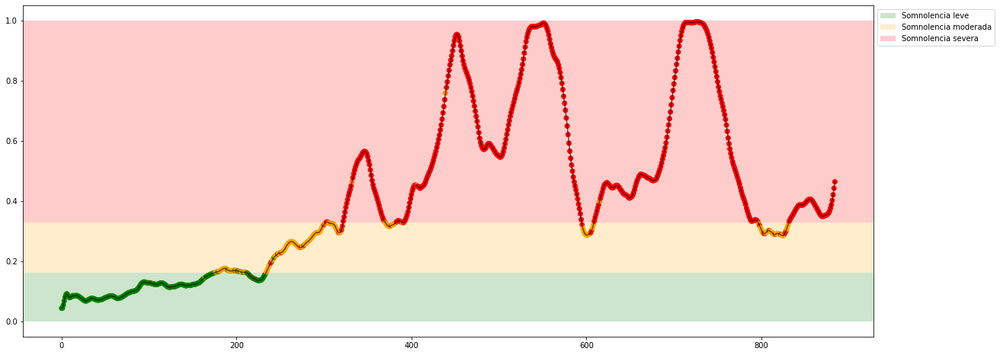

Experiment: 6_20151121_noon


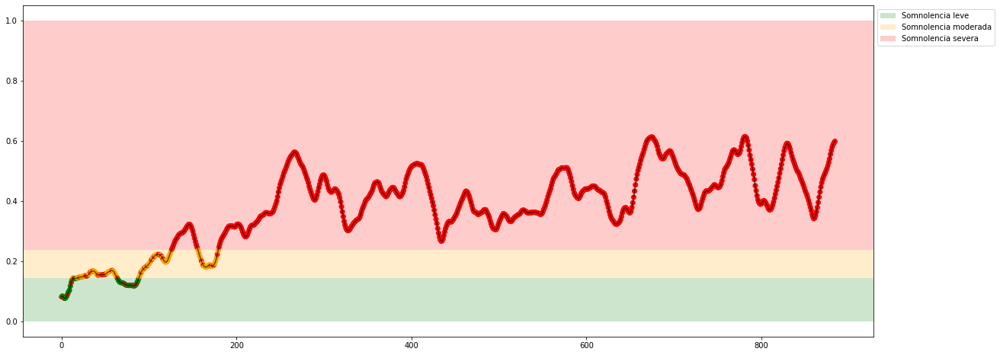

Experiment: 7_20151015_night


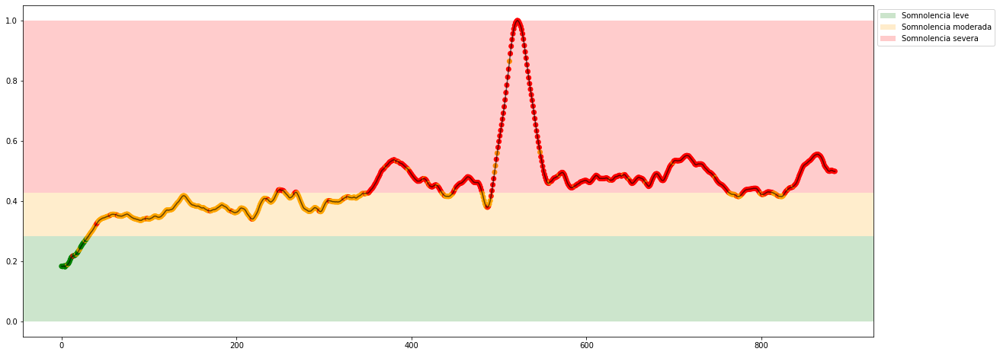

Experiment: 8_20151022_noon


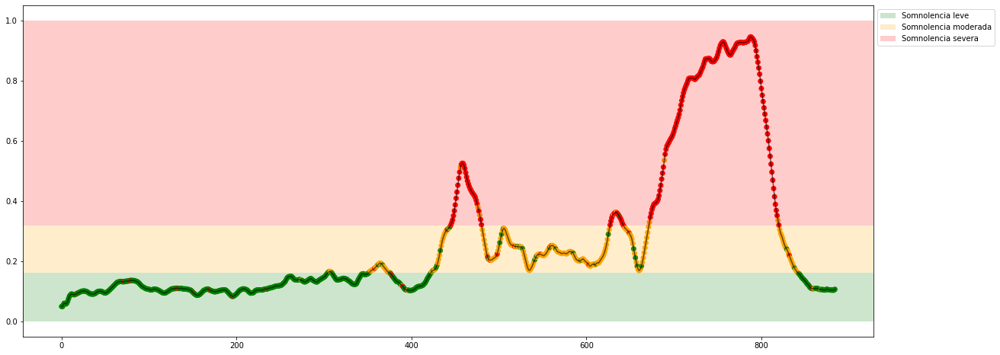

Experiment: 9_20151017_night


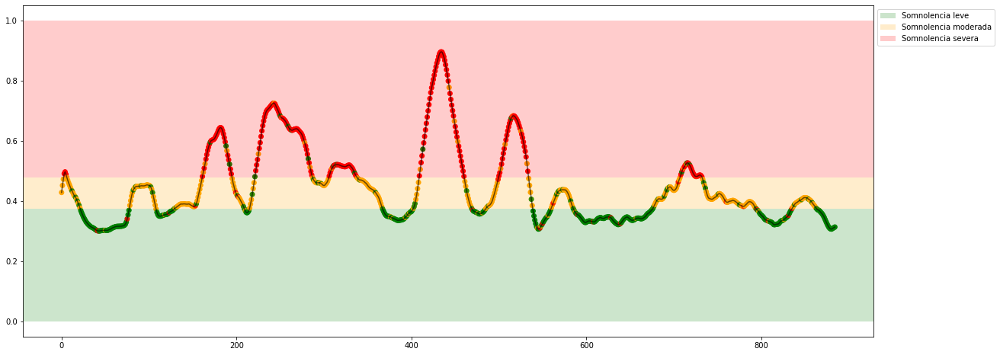

Experiment: 10_20151125_noon


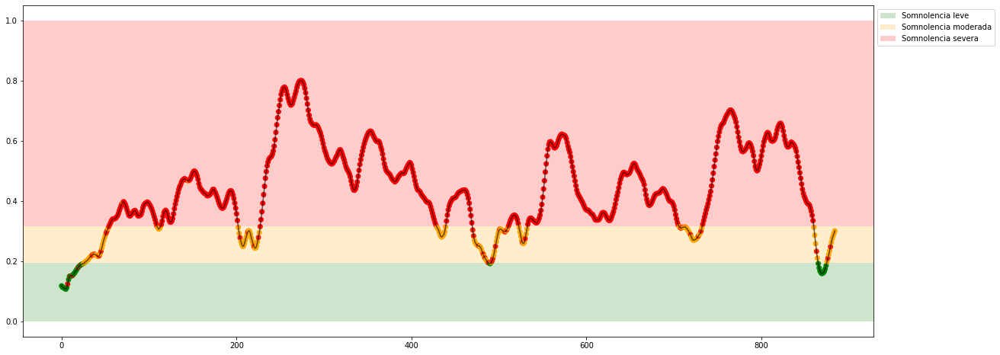

Experiment: 11_20151024_night


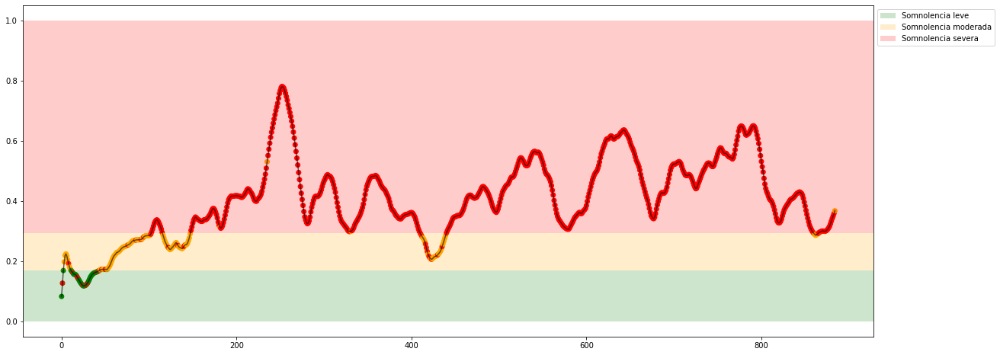

Experiment: 12_20150928_noon


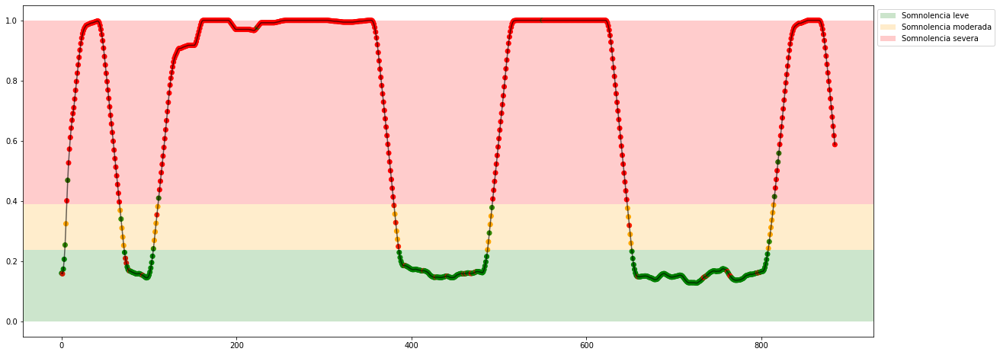

Experiment: 13_20150929_noon


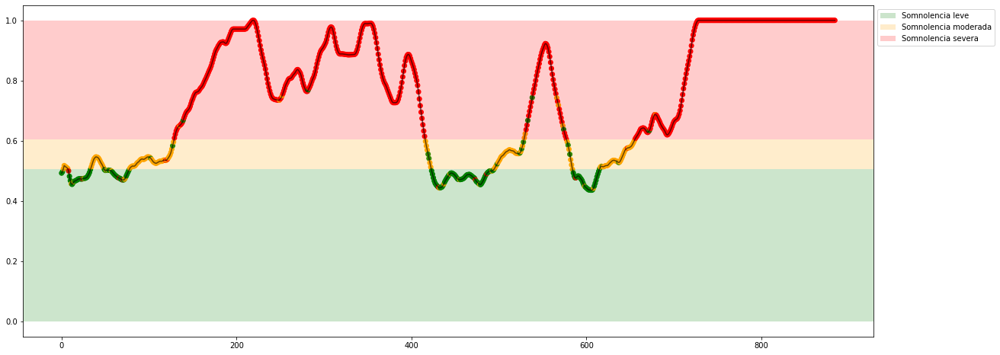

Experiment: 14_20151014_night


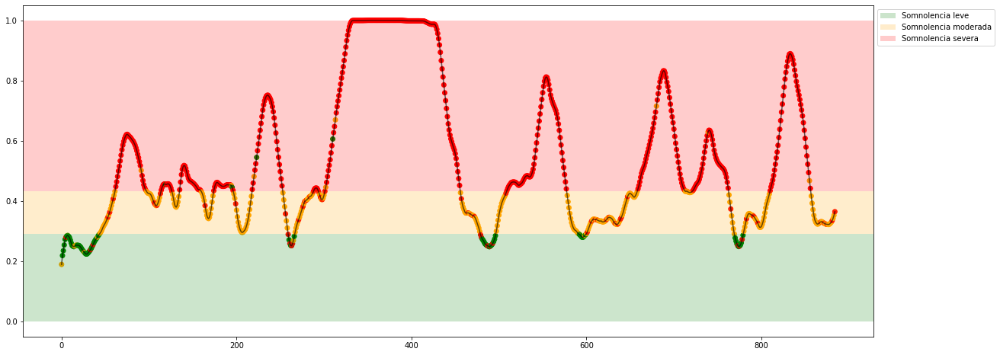

Experiment: 15_20151126_night


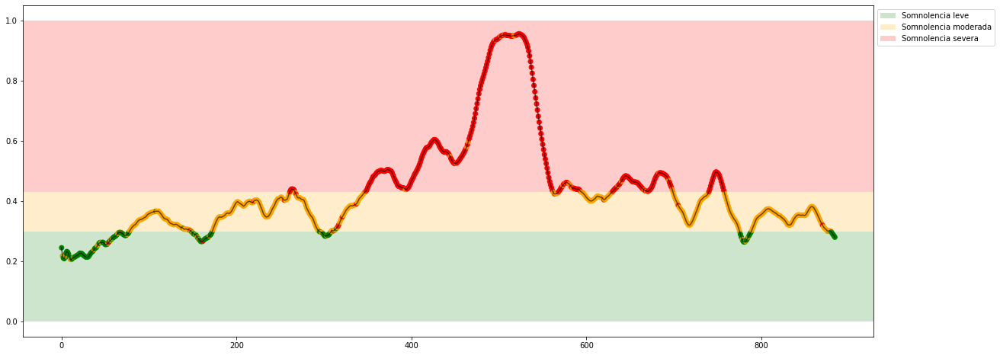

Experiment: 16_20151128_night


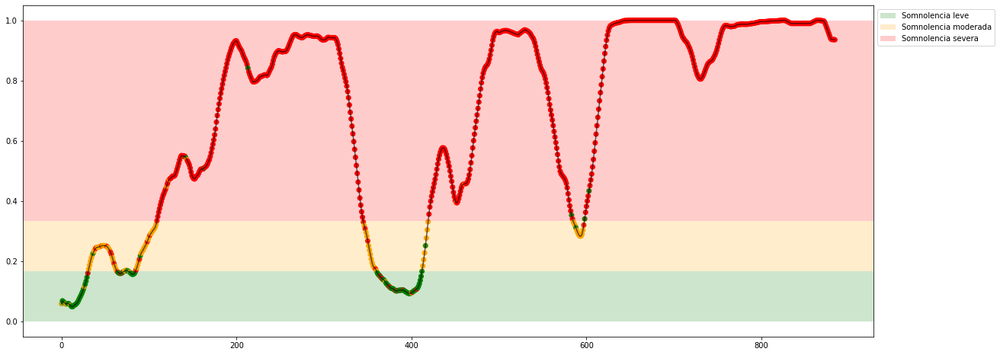

Experiment: 17_20150925_noon


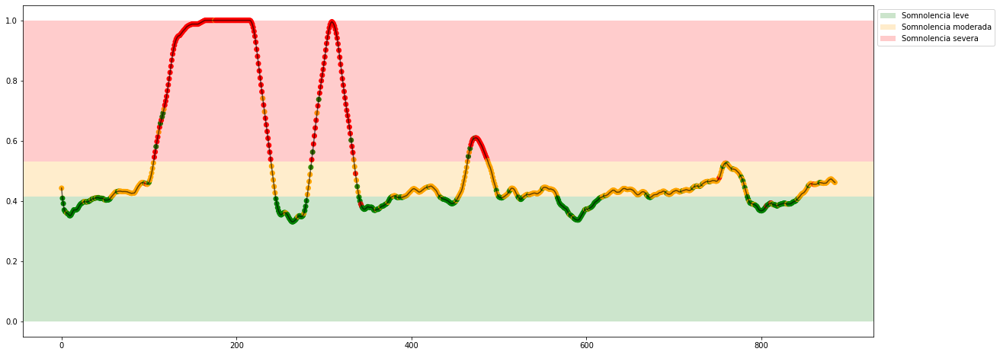

Experiment: 18_20150926_noon


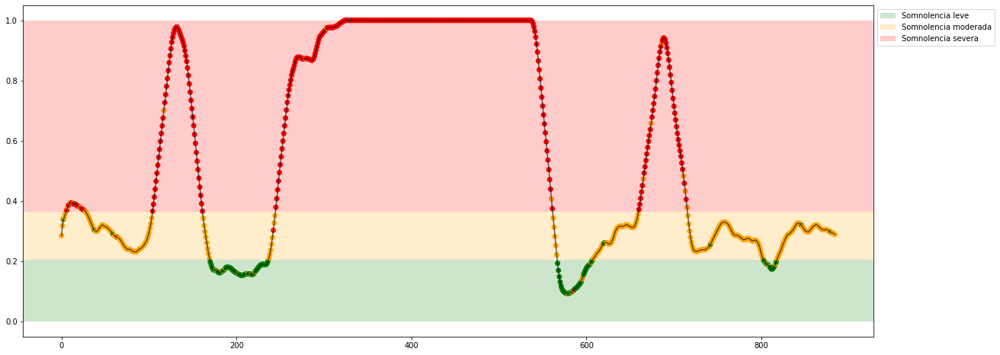

Experiment: 19_20151114_noon


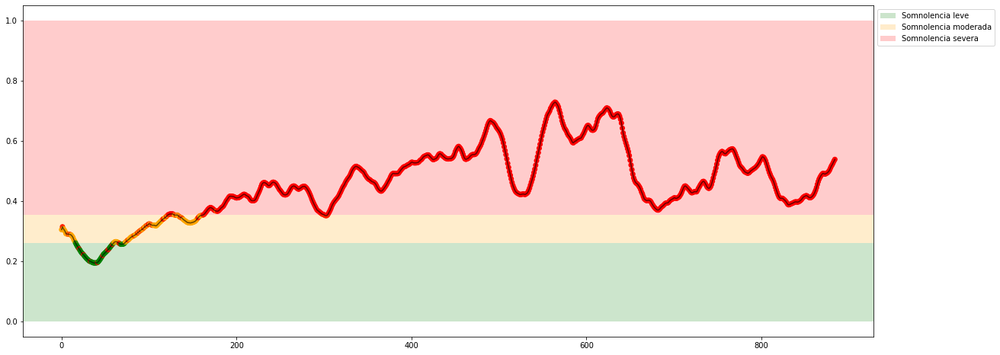

Experiment: 20_20151129_night


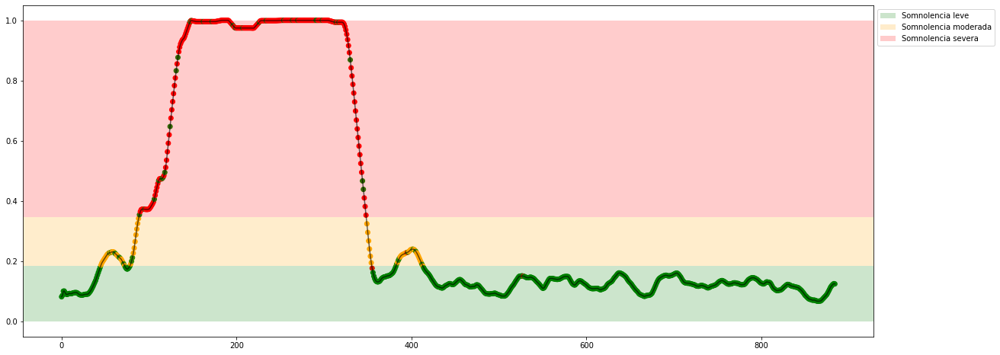

Experiment: 21_20151016_noon


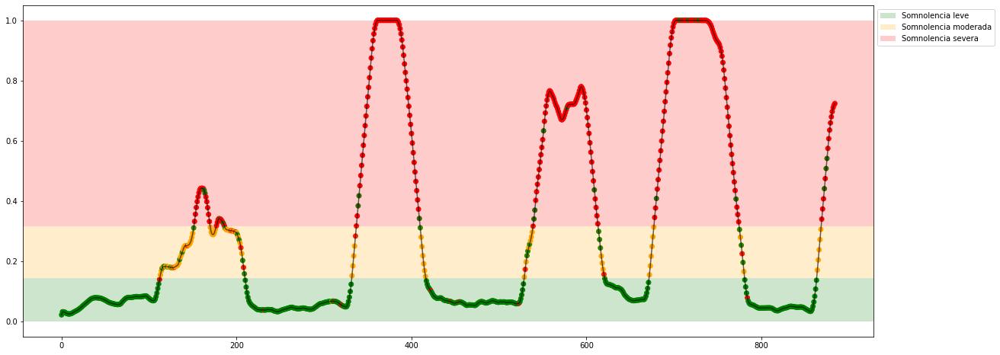

In [37]:
for key in X_all:
    data, aux2 = read_features(f'./features/{key}.csv')
    scaler = MinMaxScaler(feature_range=(0, 1))
    data_minmax = scaler.fit_transform(data)
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(general_model.predict(data_minmax), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

### KNN PSD

Experiment: Modelo General KNN PSD
Best Model:
	Score: 0.7742
	Hyperparameters: {'algorithm': 'auto', 'leaf_size': 18, 'n_neighbors': 4, 'p': 2, 'weights': 'distance'}

Results with X_test:
	Accuracy: 79.35%
	Precision: 0.7583
	Recall: 0.7608
	f1: 0.7595
Matriz de confusión para X completo


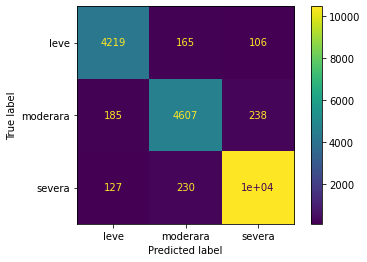

In [20]:
print(f"Experiment: Modelo General KNN PSD")
model = KNeighborsClassifier()

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['n_neighbors'] = randint(3, 21)
space['weights'] = ['uniform', 'distance']
space['algorithm'] = ['auto', 'ball_tree', 'kd_tree', 'brute']
space['leaf_size'] = randint(15,50)
space['p'] = [1, 2]

general_model, acc, pre, rec, f1 = find_and_test_best_model_class(X, y_class, model, space, cv=cv,  n_iter=10)

Experiment: 1_20151124_noon_2


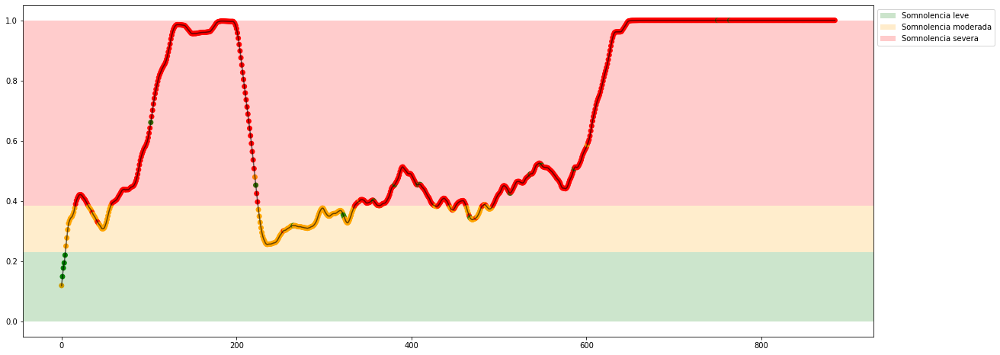

Experiment: 2_20151106_noon


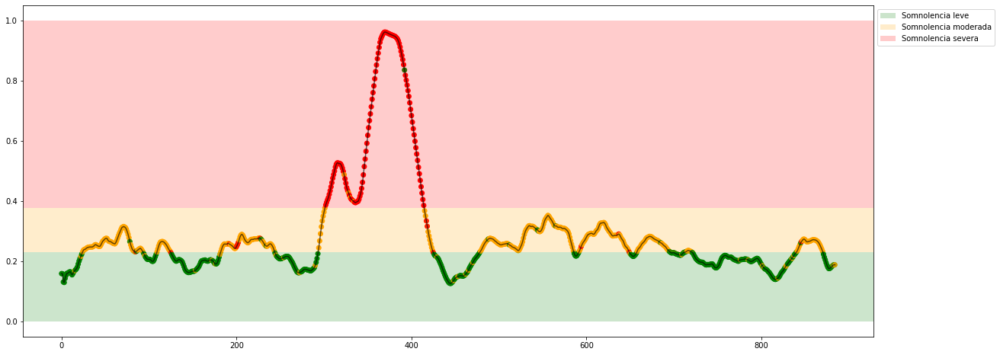

Experiment: 3_20151024_noon


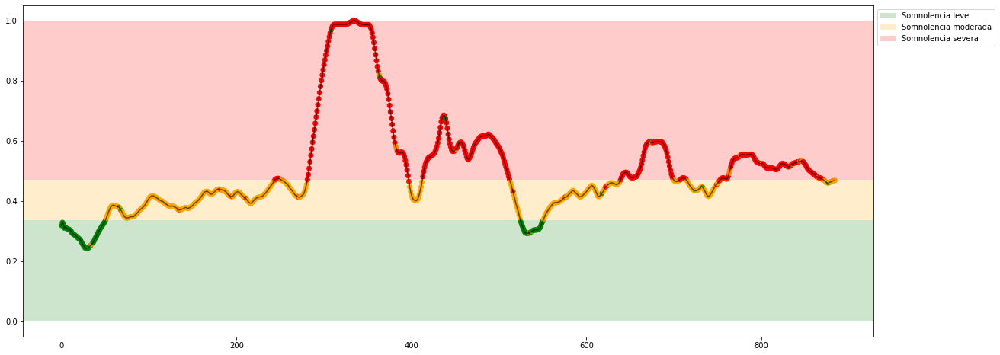

Experiment: 4_20151105_noon


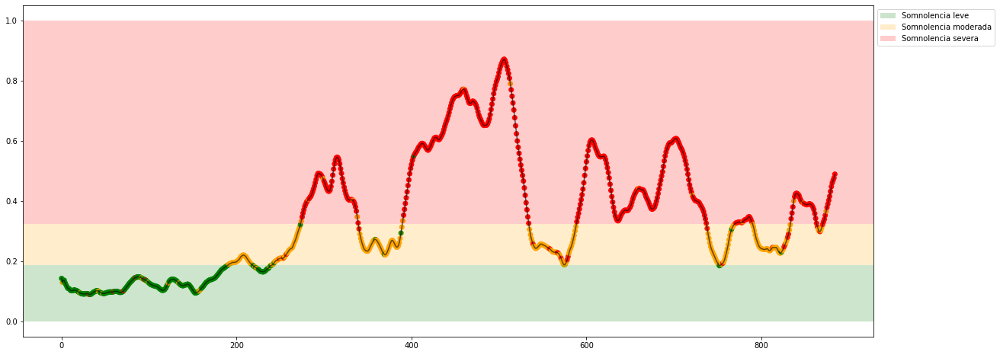

Experiment: 4_20151107_noon


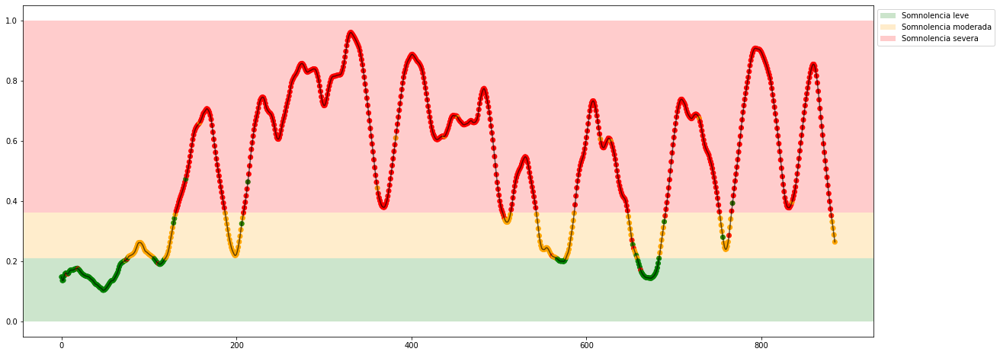

Experiment: 5_20141108_noon


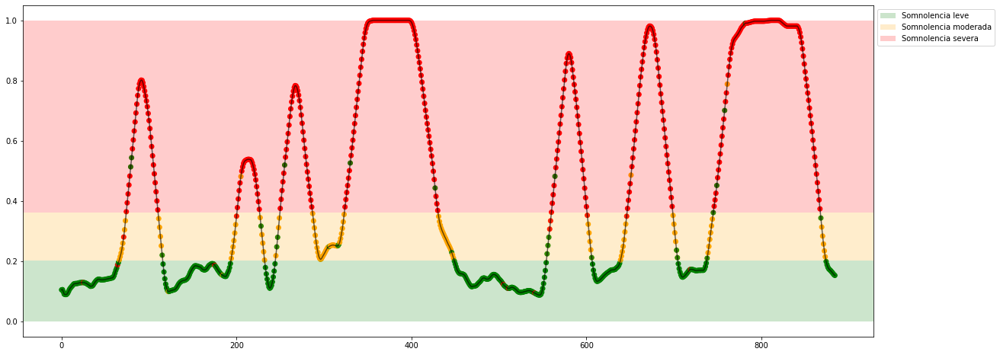

Experiment: 5_20151012_night


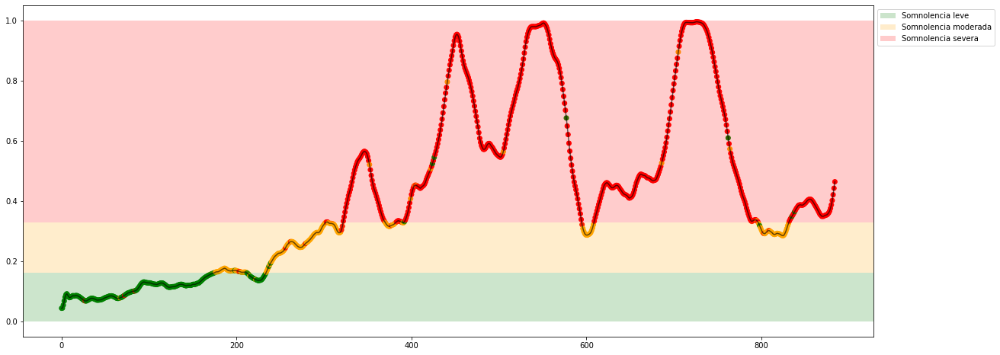

Experiment: 6_20151121_noon


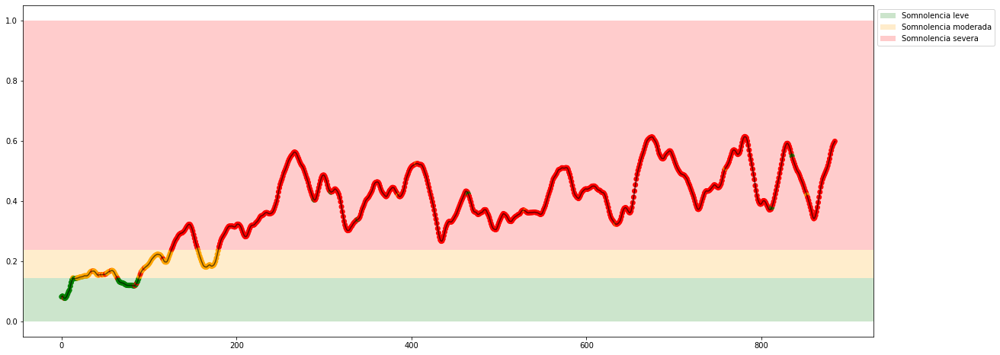

Experiment: 7_20151015_night


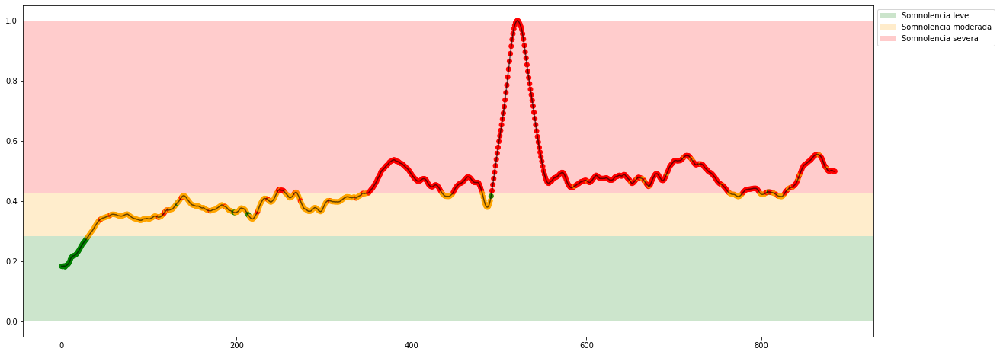

Experiment: 8_20151022_noon


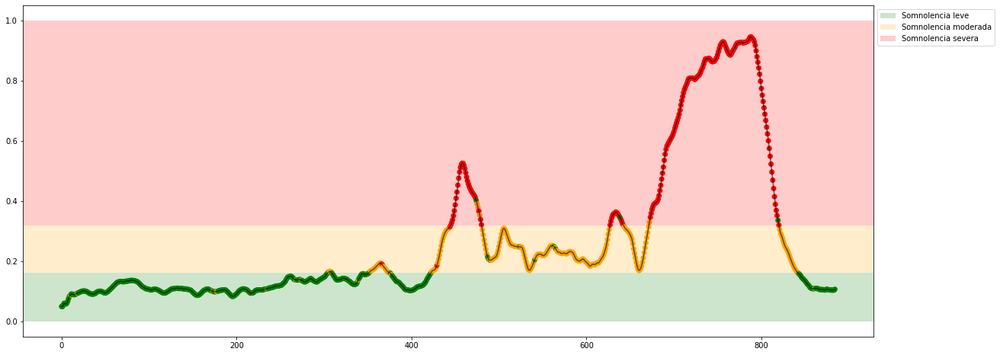

Experiment: 9_20151017_night


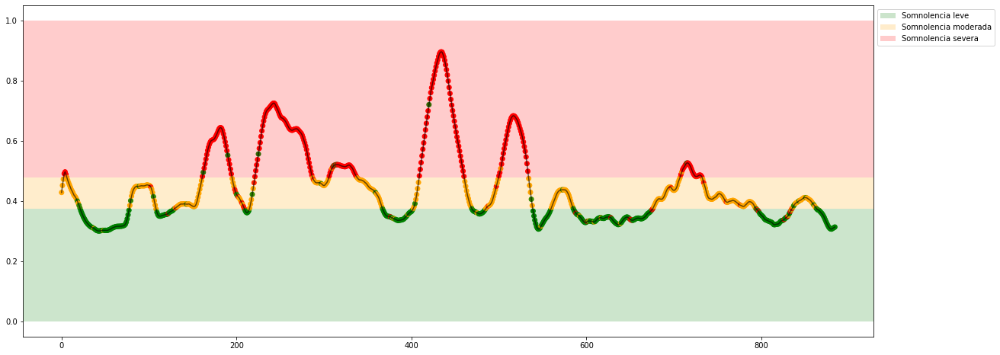

Experiment: 10_20151125_noon


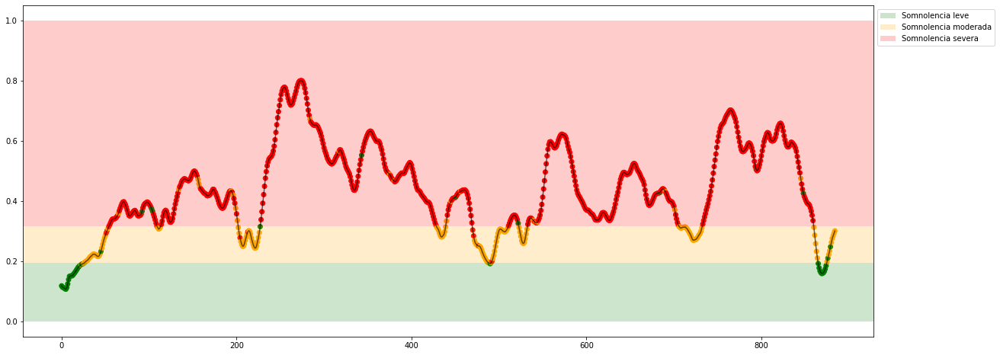

Experiment: 11_20151024_night


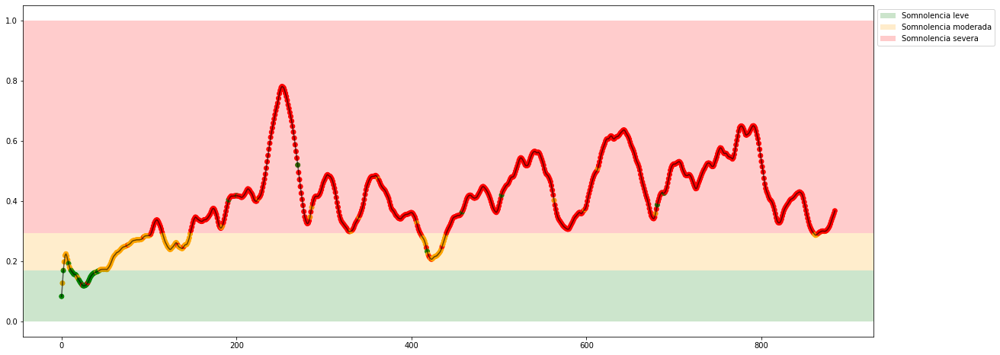

Experiment: 12_20150928_noon


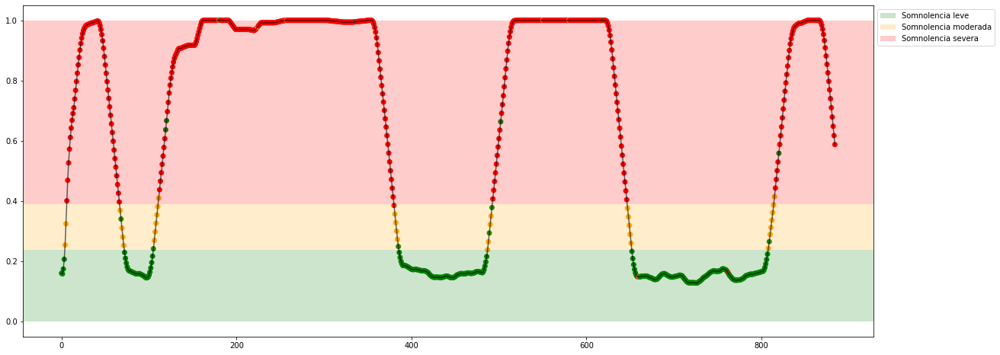

Experiment: 13_20150929_noon


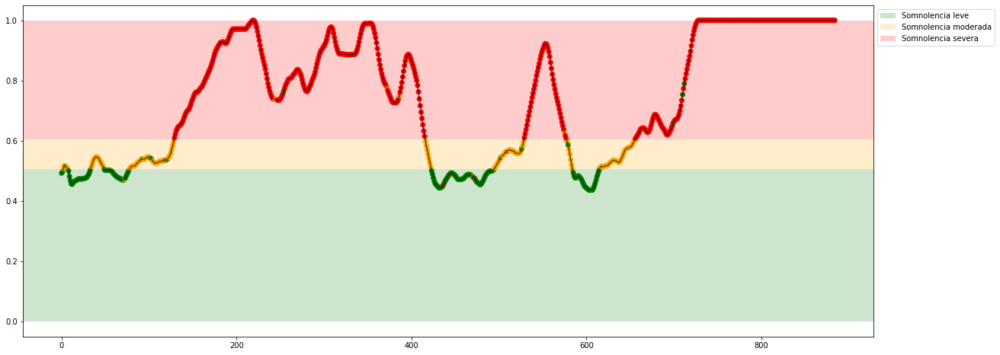

Experiment: 14_20151014_night


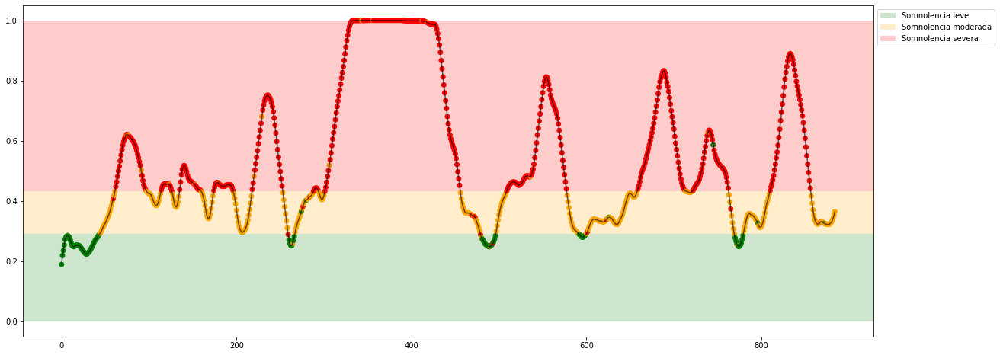

Experiment: 15_20151126_night


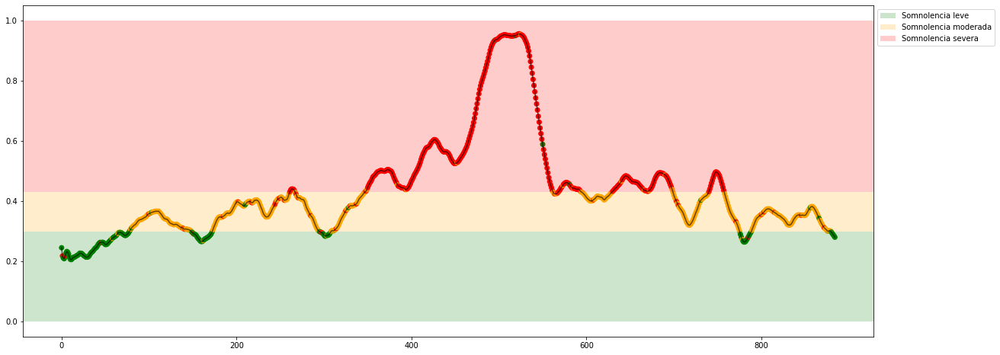

Experiment: 16_20151128_night


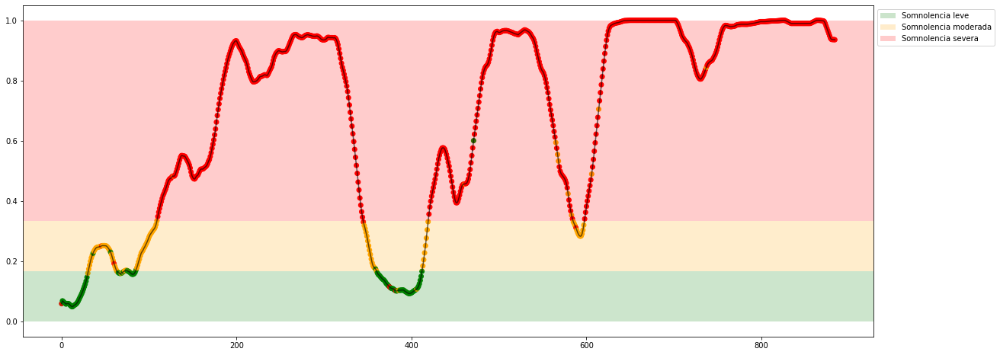

Experiment: 17_20150925_noon


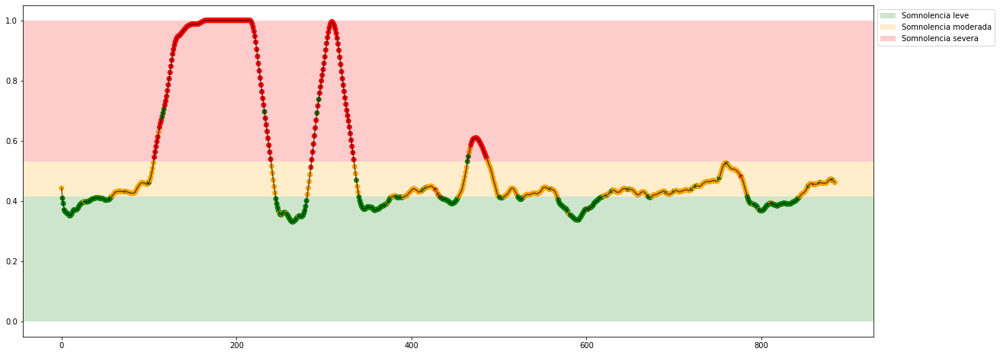

Experiment: 18_20150926_noon


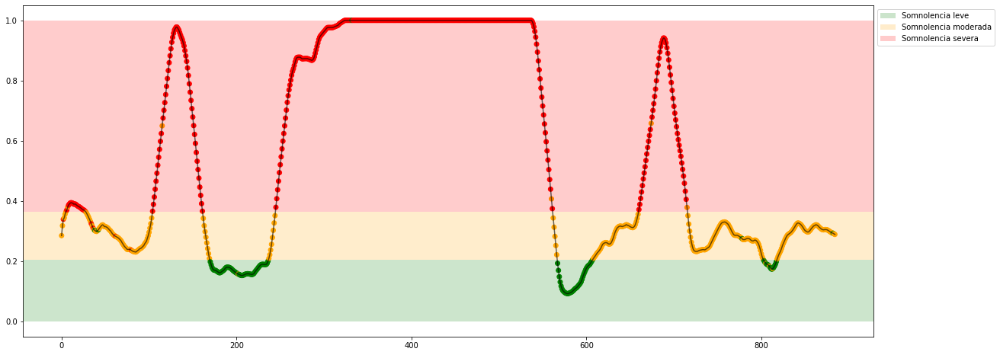

Experiment: 19_20151114_noon


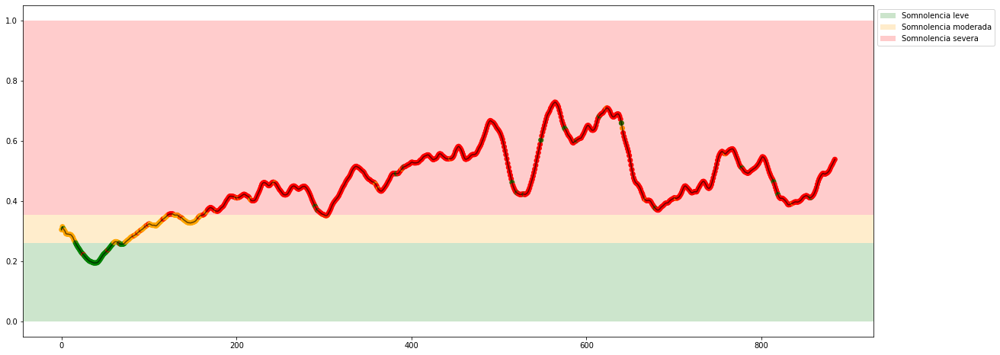

Experiment: 20_20151129_night


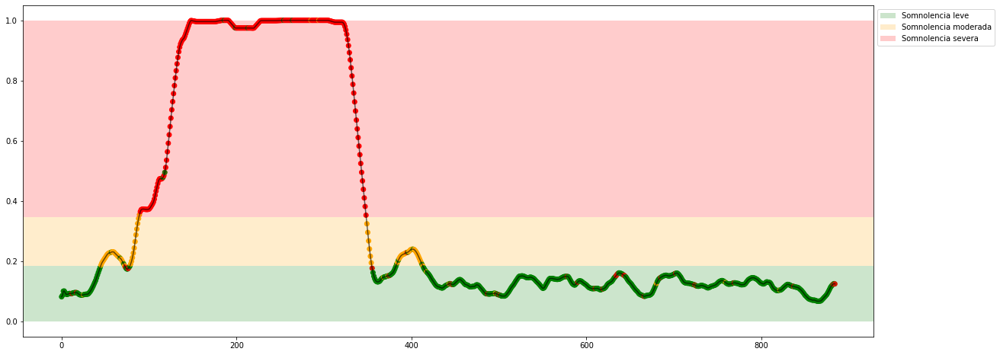

Experiment: 21_20151016_noon


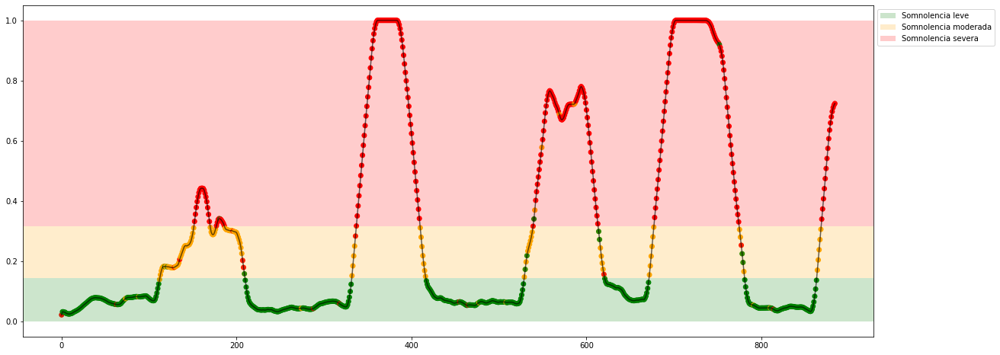

In [19]:
for key in X_all:
    data = X_all[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(general_model.predict(data), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

### KNN PSD + EOG

Experiment: Modelo General KNN PSD + EOG
Best Model:
	Score: 0.7147
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 43, 'n_neighbors': 17, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 74.79%
	Precision: 0.7013
	Recall: 0.6925
	f1: 0.6965
Matriz de confusión para X completo


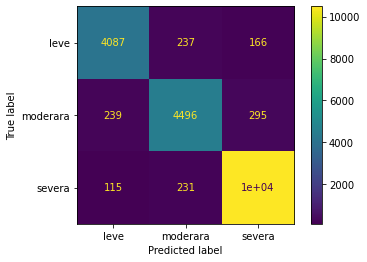

In [21]:
print(f"Experiment: Modelo General KNN PSD + EOG")
model = KNeighborsClassifier()

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['n_neighbors'] = randint(3, 21)
space['weights'] = ['uniform', 'distance']
space['algorithm'] = ['auto', 'ball_tree', 'kd_tree', 'brute']
space['leaf_size'] = randint(15,50)
space['p'] = [1, 2]

general_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_eog, y_class, model, space, cv=cv,  n_iter=10)

Experiment: 1_20151124_noon_2


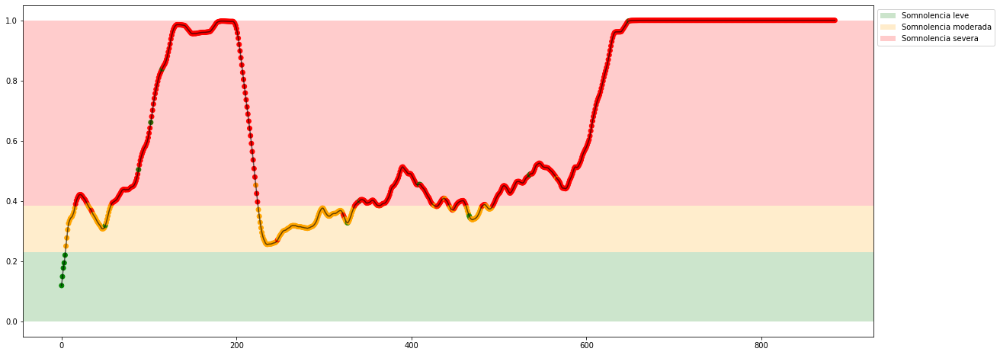

Experiment: 2_20151106_noon


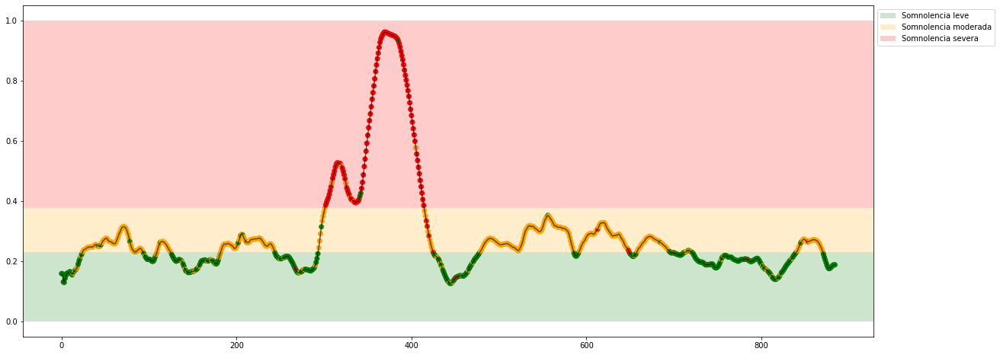

Experiment: 3_20151024_noon


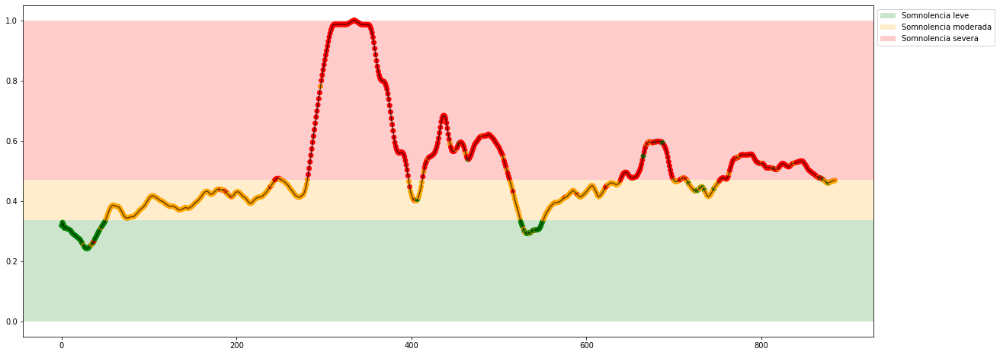

Experiment: 4_20151105_noon


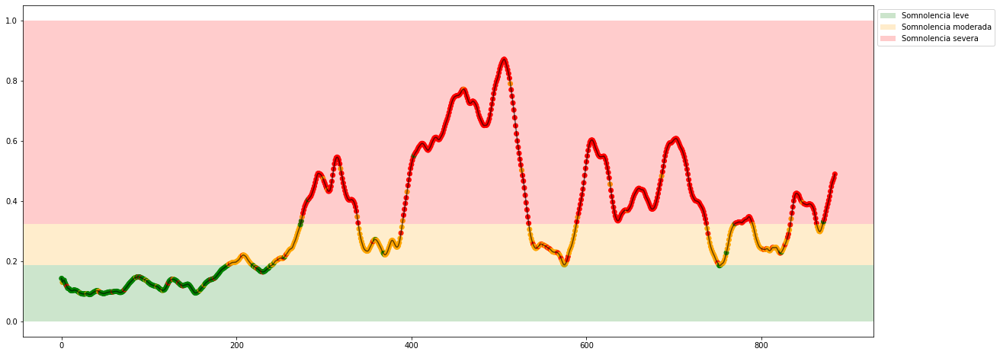

Experiment: 4_20151107_noon


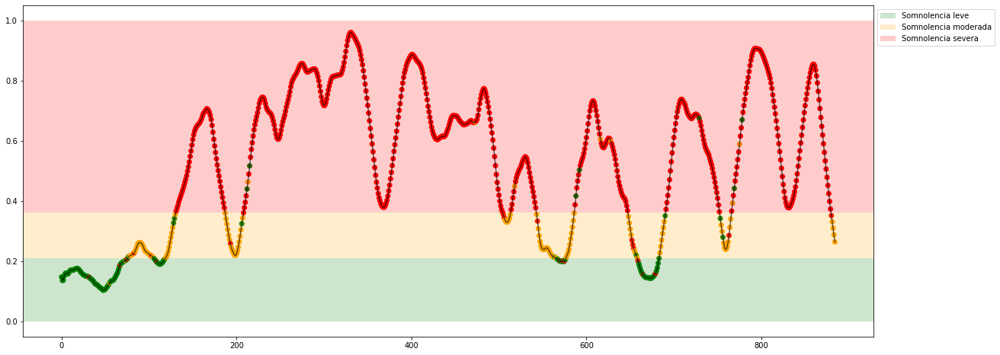

Experiment: 5_20141108_noon


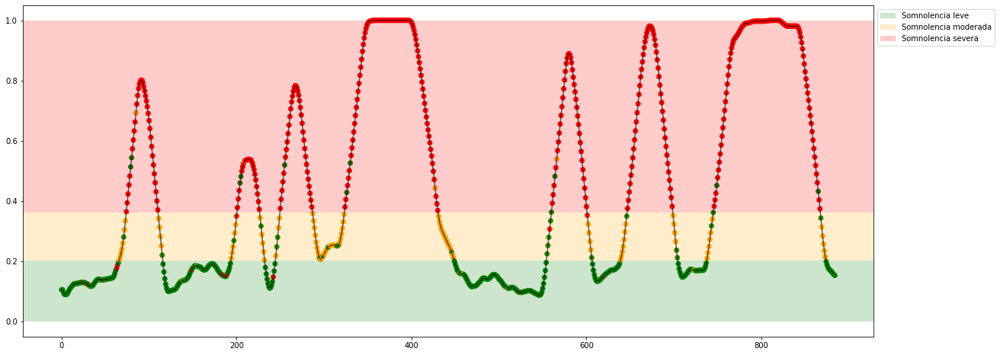

Experiment: 5_20151012_night


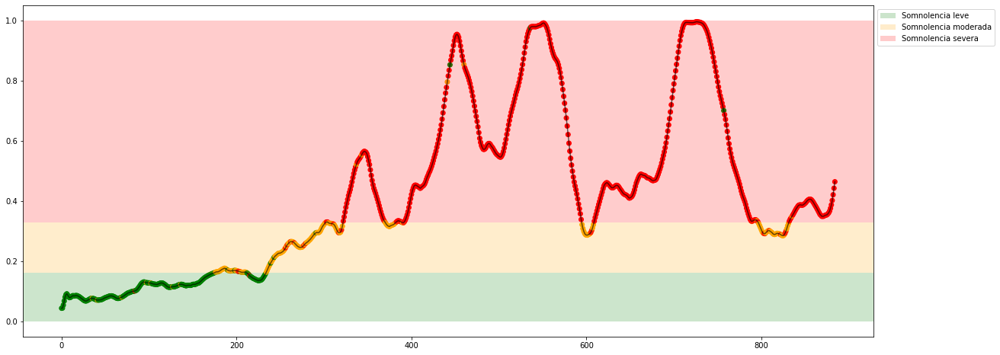

Experiment: 6_20151121_noon


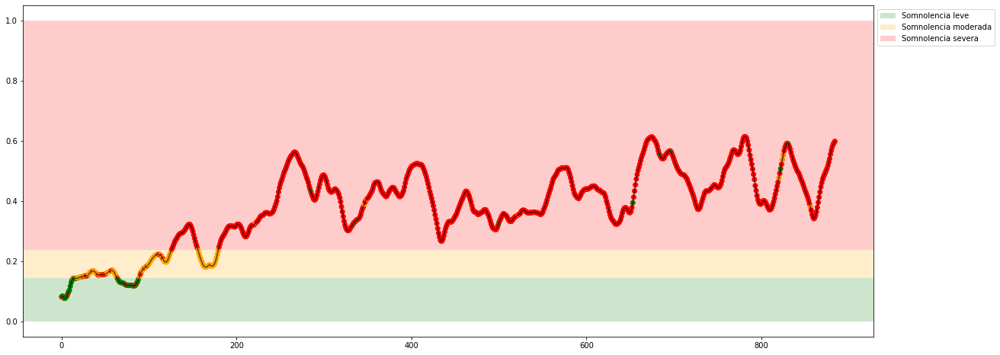

Experiment: 7_20151015_night


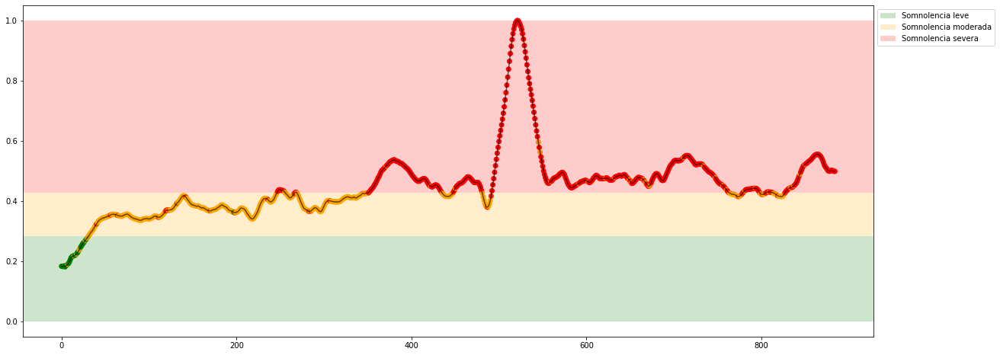

Experiment: 8_20151022_noon


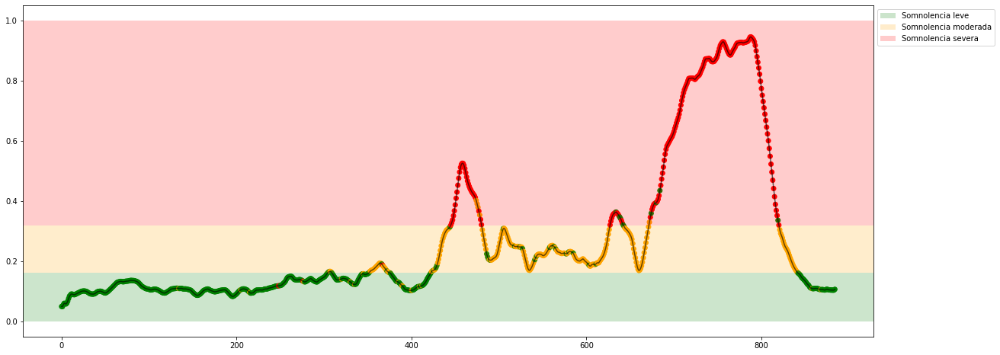

Experiment: 9_20151017_night


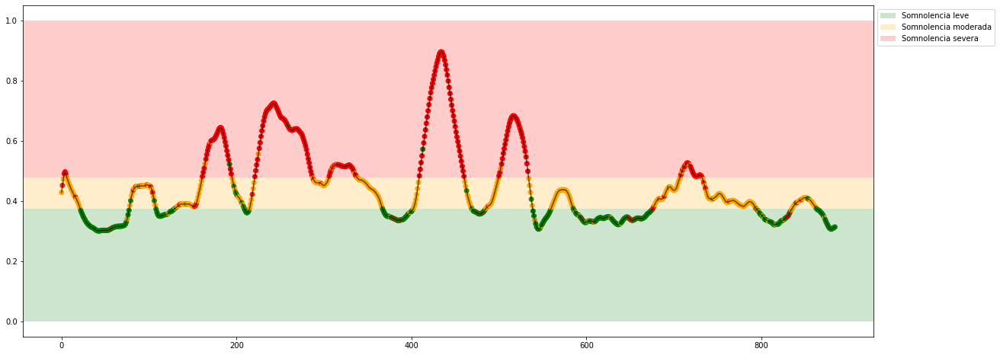

Experiment: 10_20151125_noon


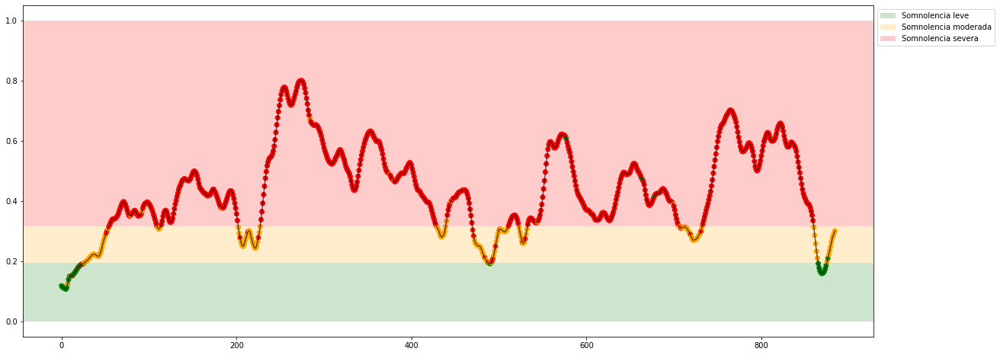

Experiment: 11_20151024_night


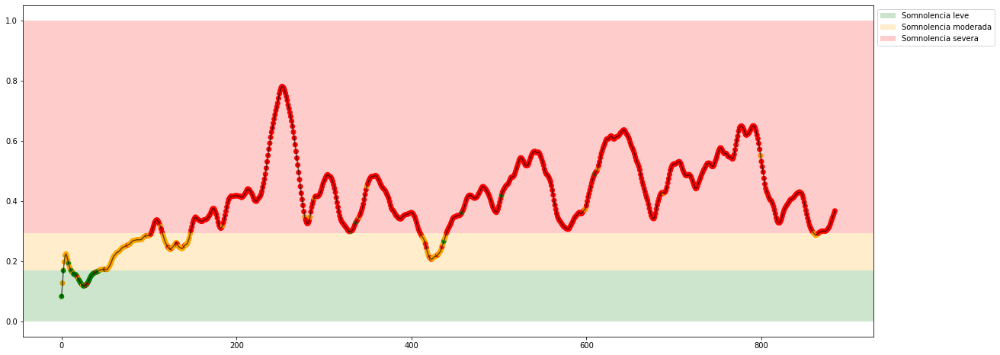

Experiment: 12_20150928_noon


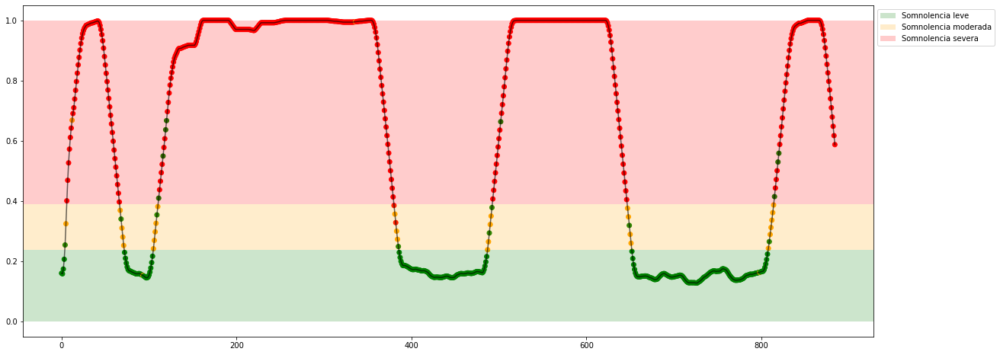

Experiment: 13_20150929_noon


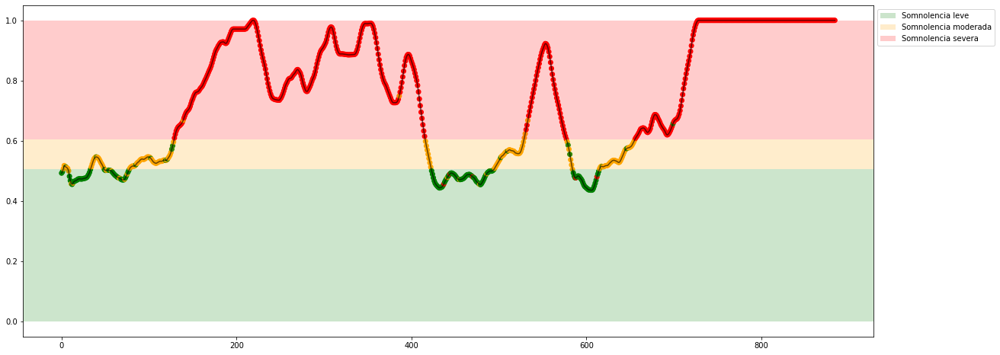

Experiment: 14_20151014_night


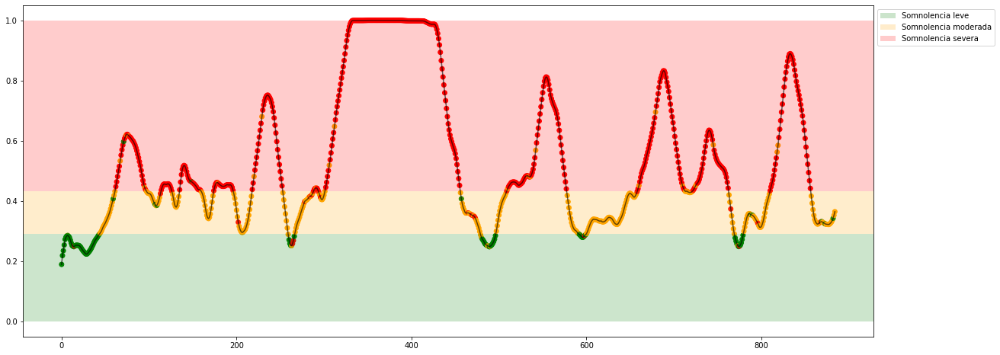

Experiment: 15_20151126_night


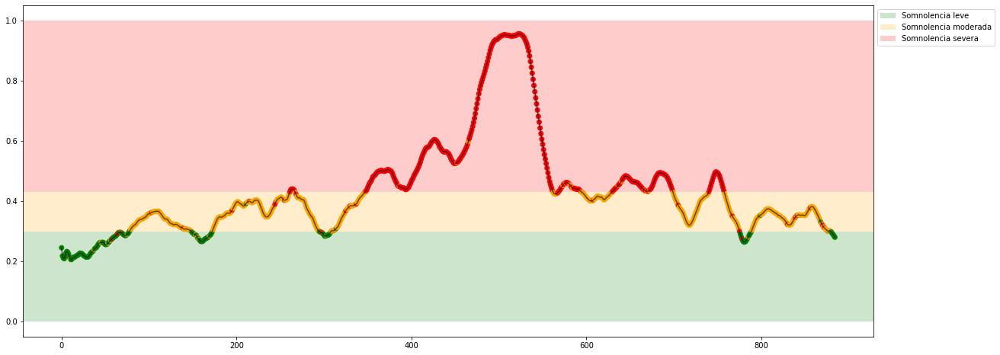

Experiment: 16_20151128_night


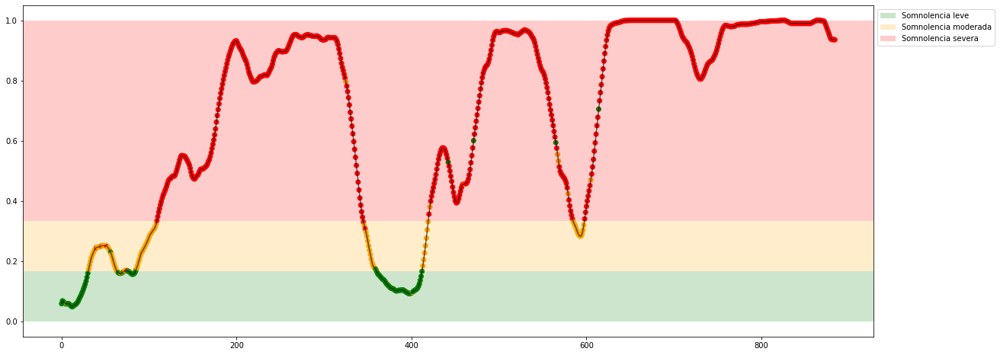

Experiment: 17_20150925_noon


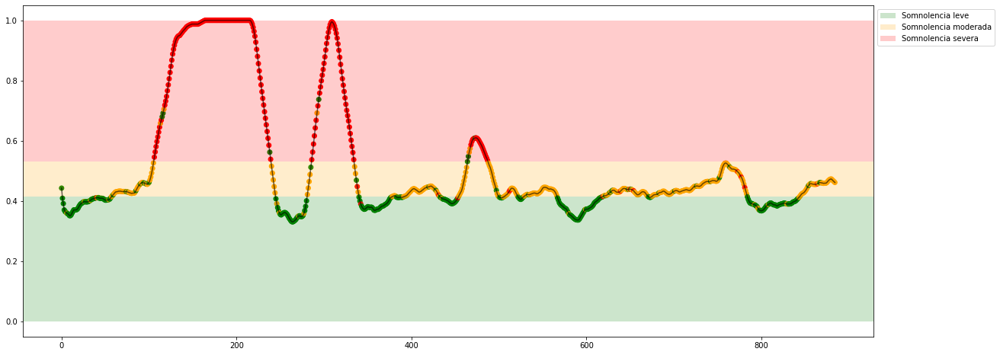

Experiment: 18_20150926_noon


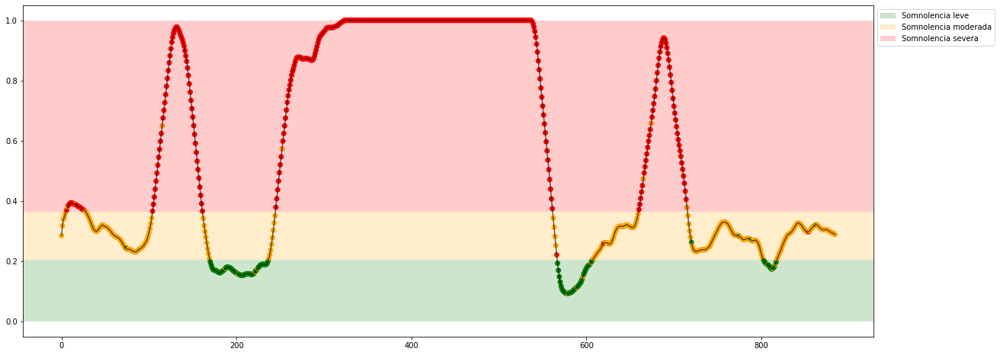

Experiment: 19_20151114_noon


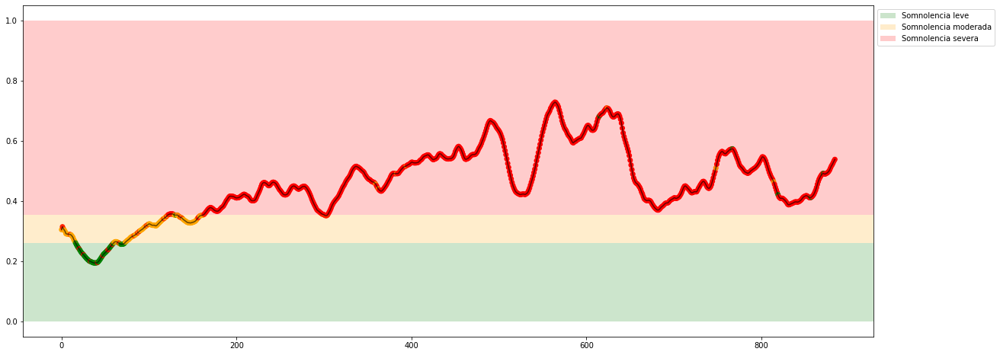

Experiment: 20_20151129_night


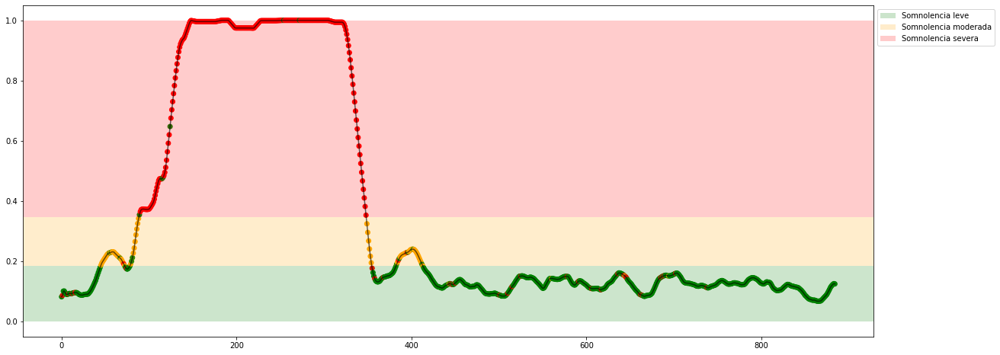

Experiment: 21_20151016_noon


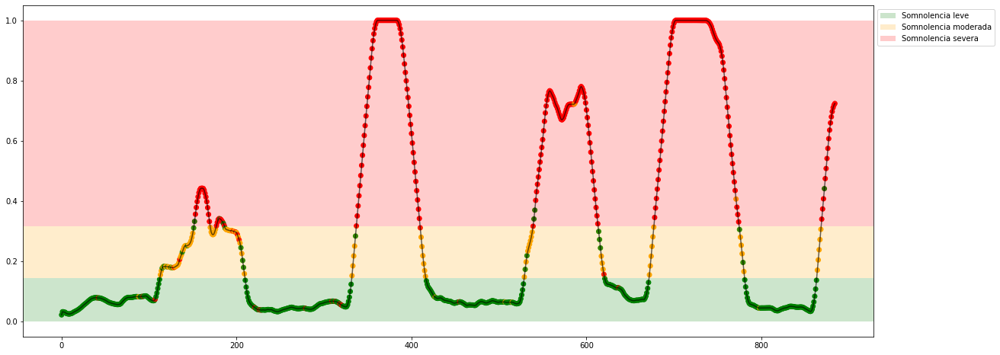

In [22]:
for key in X_all:
    data = X_all_eog[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(general_model.predict(data), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

## Decision Tree

In [39]:
from sklearn.tree import DecisionTreeClassifier

### Decision tree EEG

Experiment: Modelo General Decision Tree PSD
Best Model:
	Score: 0.6130
	Hyperparameters: {'criterion': 'gini', 'max_depth': 11, 'max_features': 'auto', 'min_samples_split': 2, 'splitter': 'best'}

Results with X_test:
	Accuracy: 63.25%
	Precision: 0.5678
	Recall: 0.5642
	f1: 0.5653
Matriz de confusión para X completo


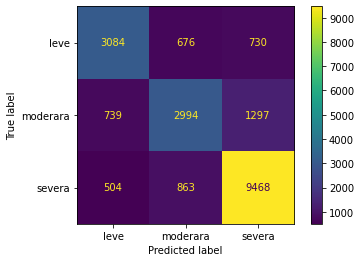

In [53]:
print(f"Experiment: Modelo General Decision Tree PSD")
model = DecisionTreeClassifier(random_state=42)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['criterion'] = ["gini", "entropy"]
space['splitter'] = ["best", "random"]
space['max_depth'] = randint(5, 100)
space['min_samples_split'] = randint(2, 10)
#space['min_samples_leaf'] = randint(1, 10)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['ccp_alpha'] = uniform(0, 5) # empeora el ponerlo, el mejor valor es 0.0

general_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_eeg, y_class, model, space, cv=cv,  n_iter=20)

Experiment: 1_20151124_noon_2


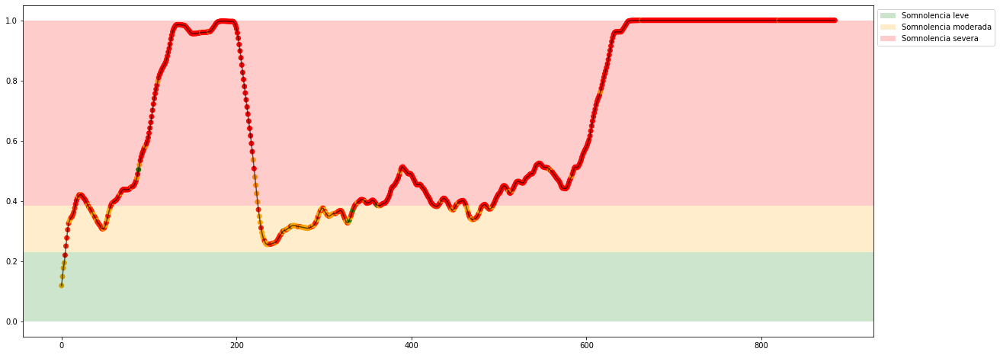

Experiment: 2_20151106_noon


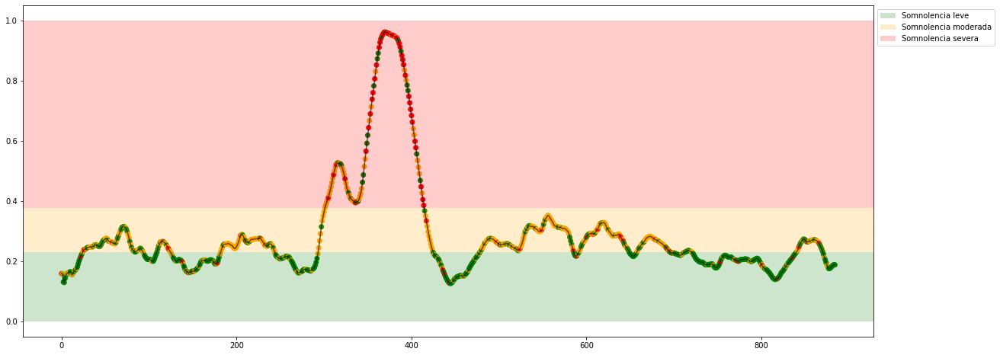

Experiment: 3_20151024_noon


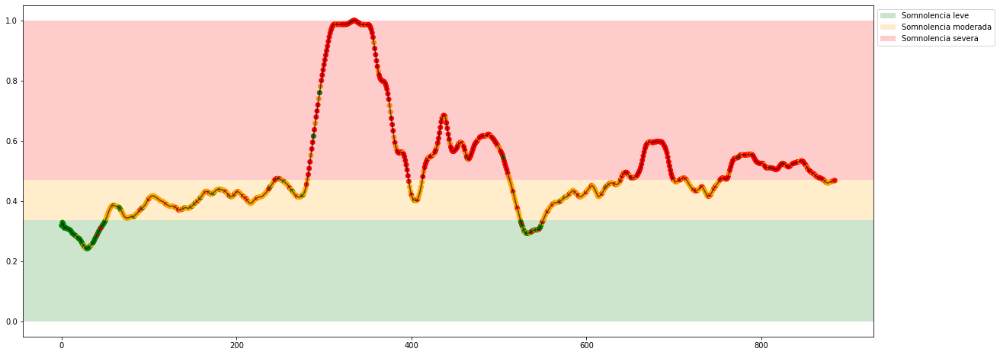

Experiment: 4_20151105_noon


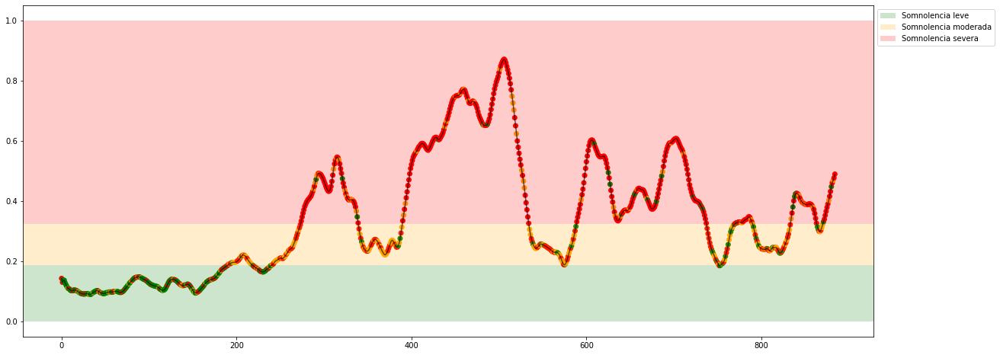

Experiment: 4_20151107_noon


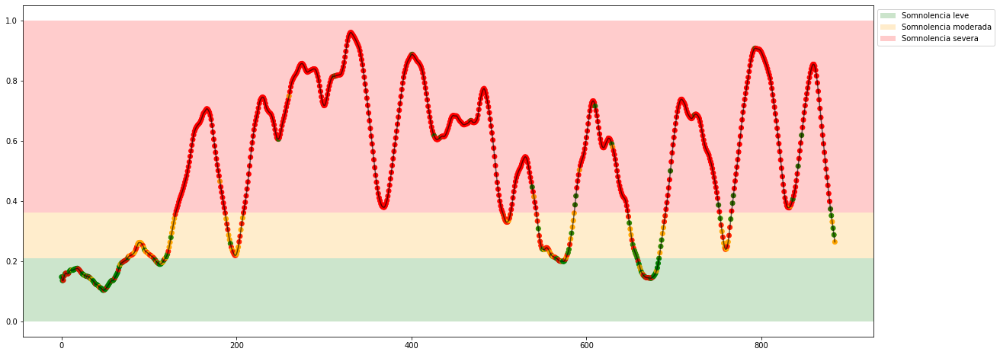

Experiment: 5_20141108_noon


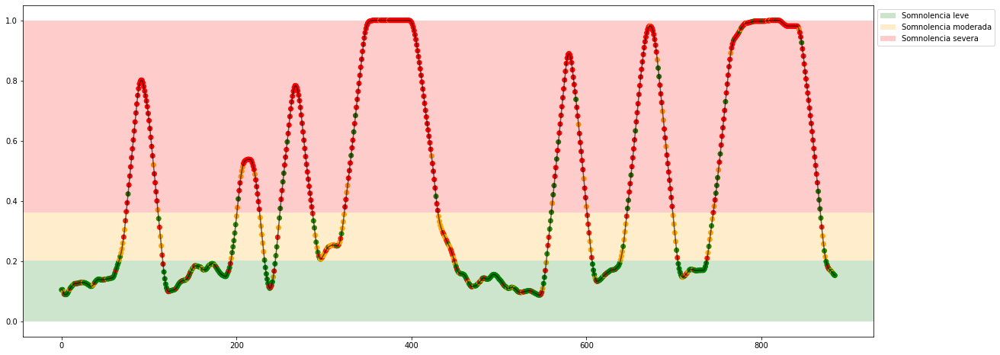

Experiment: 5_20151012_night


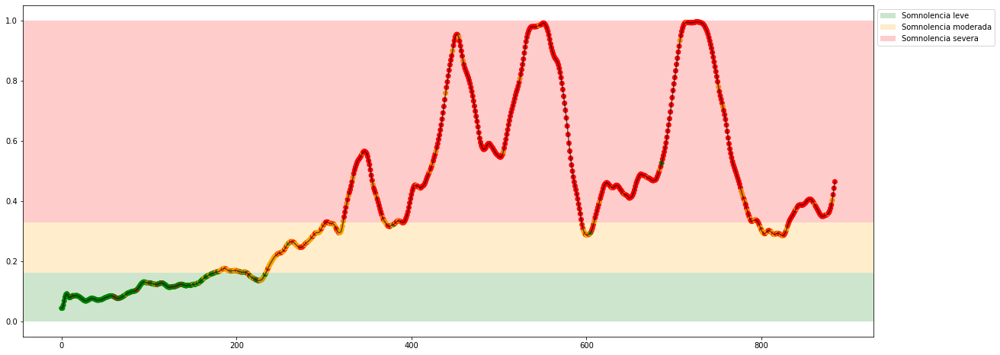

Experiment: 6_20151121_noon


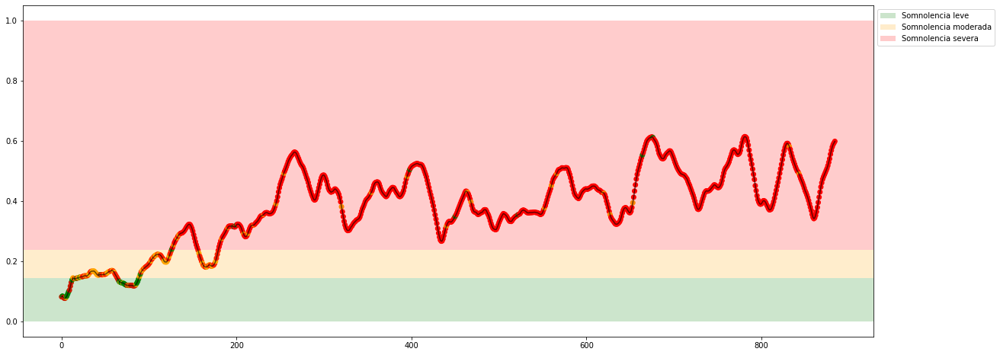

Experiment: 7_20151015_night


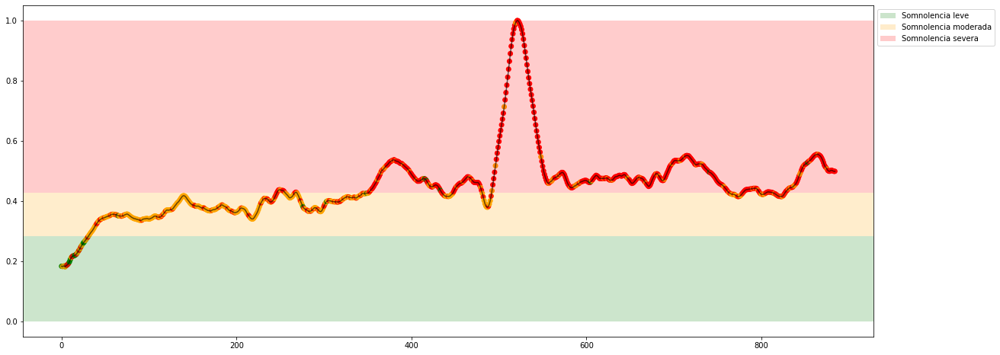

Experiment: 8_20151022_noon


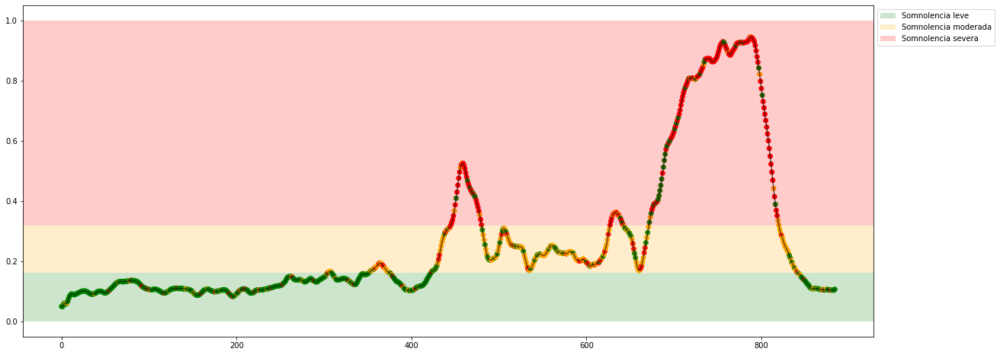

Experiment: 9_20151017_night


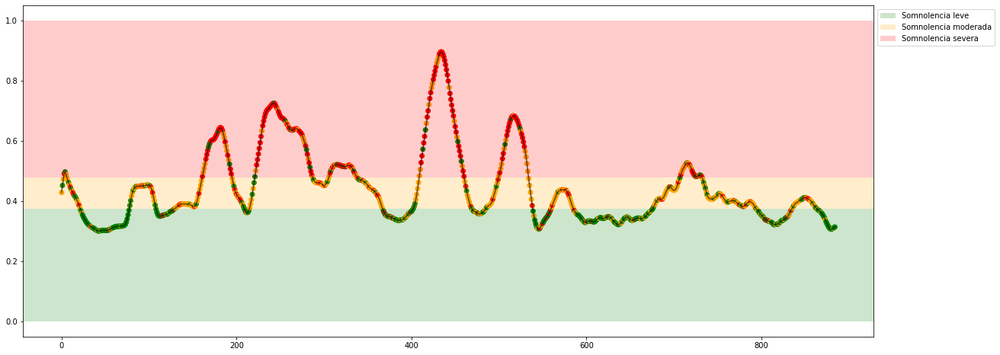

Experiment: 10_20151125_noon


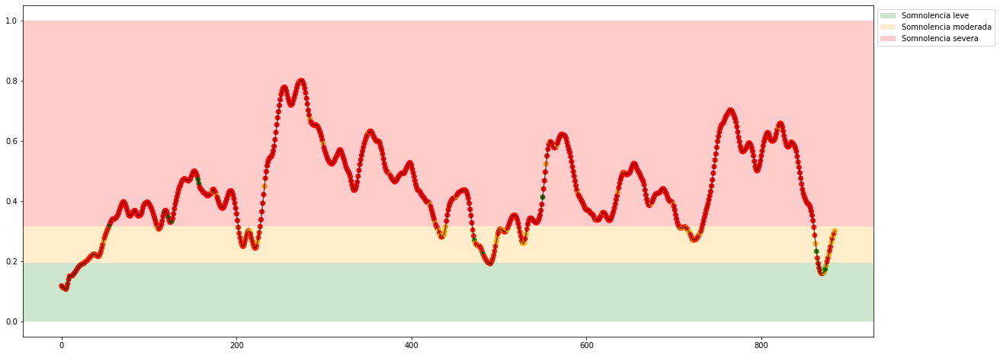

Experiment: 11_20151024_night


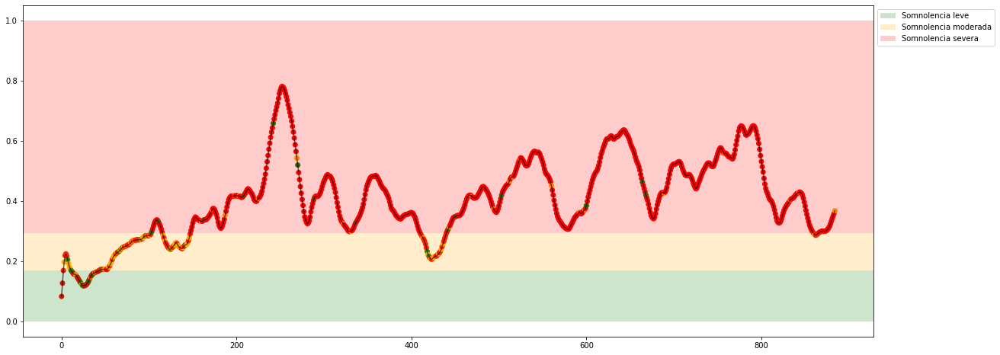

Experiment: 12_20150928_noon


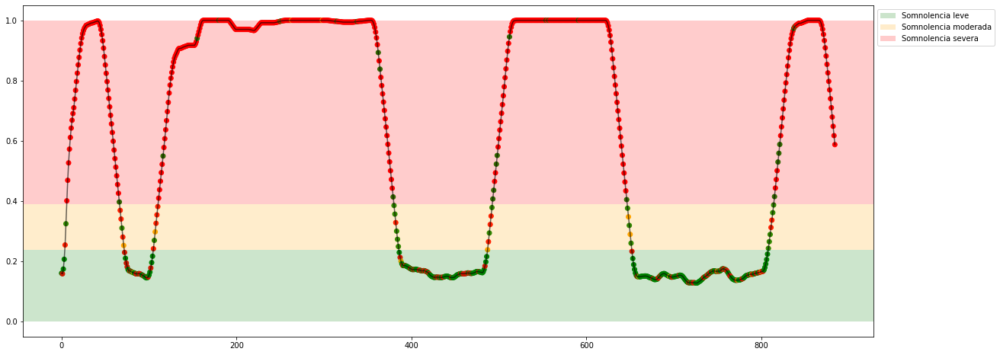

Experiment: 13_20150929_noon


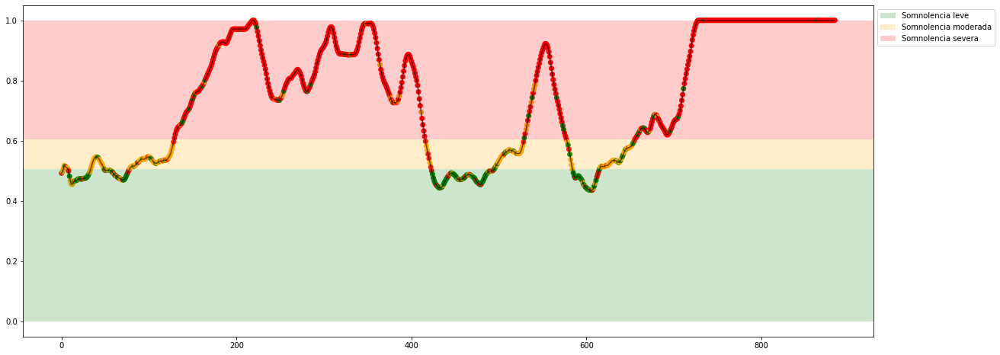

Experiment: 14_20151014_night


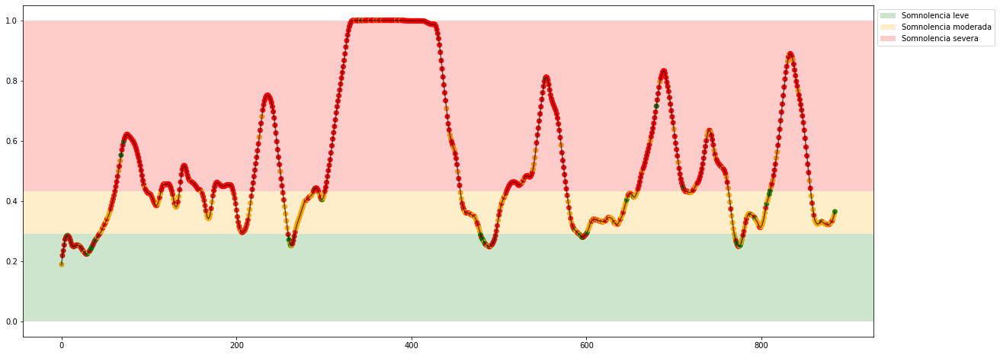

Experiment: 15_20151126_night


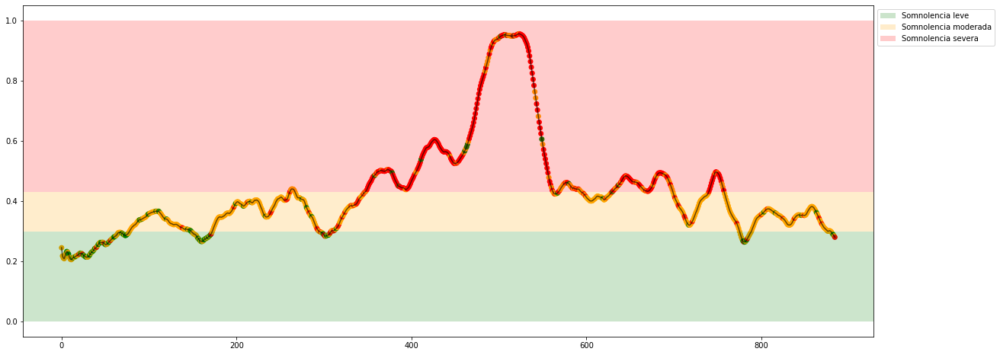

Experiment: 16_20151128_night


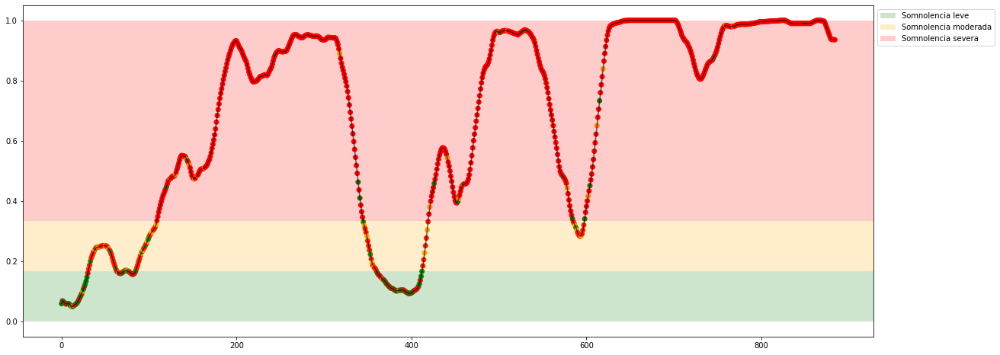

Experiment: 17_20150925_noon


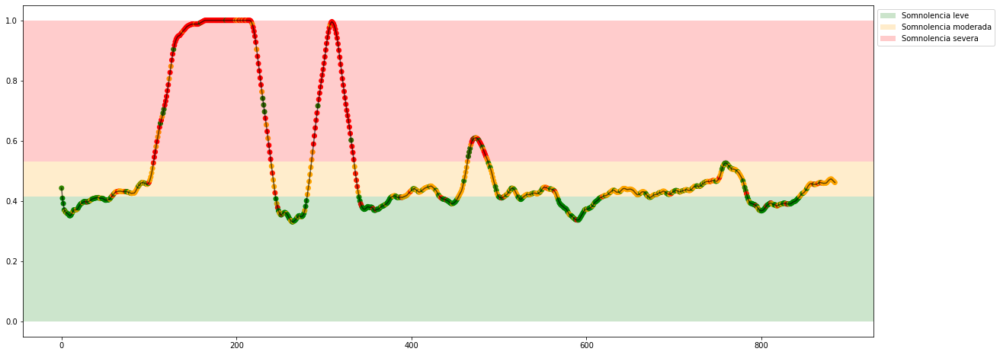

Experiment: 18_20150926_noon


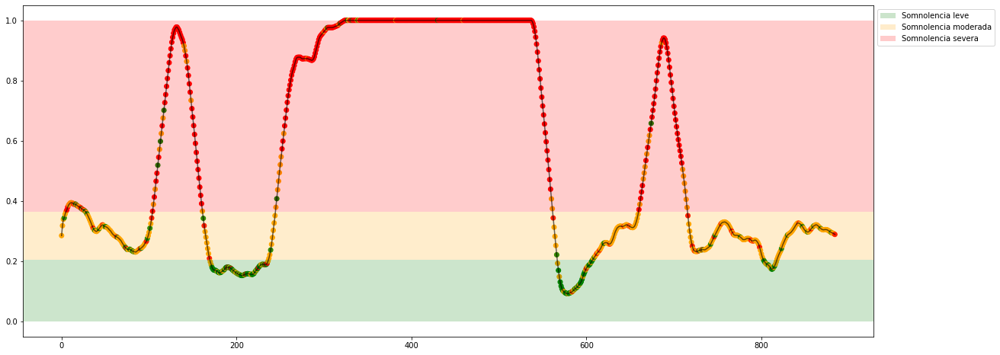

Experiment: 19_20151114_noon


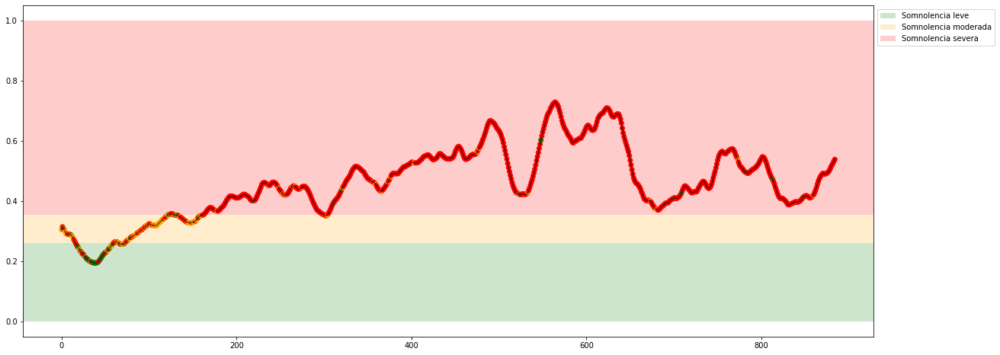

Experiment: 20_20151129_night


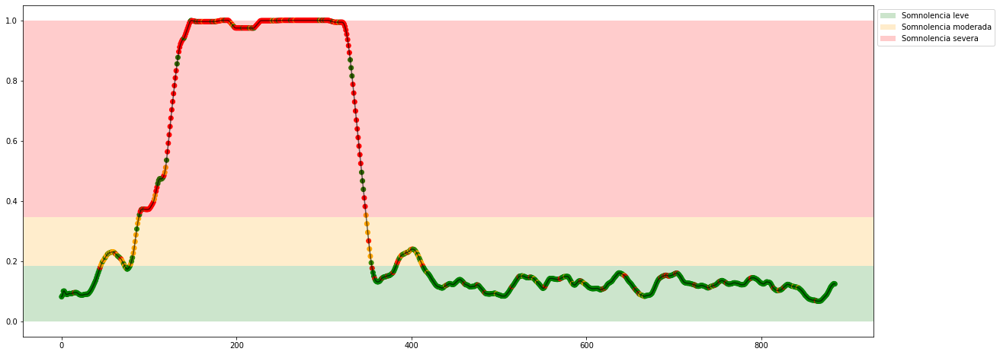

Experiment: 21_20151016_noon


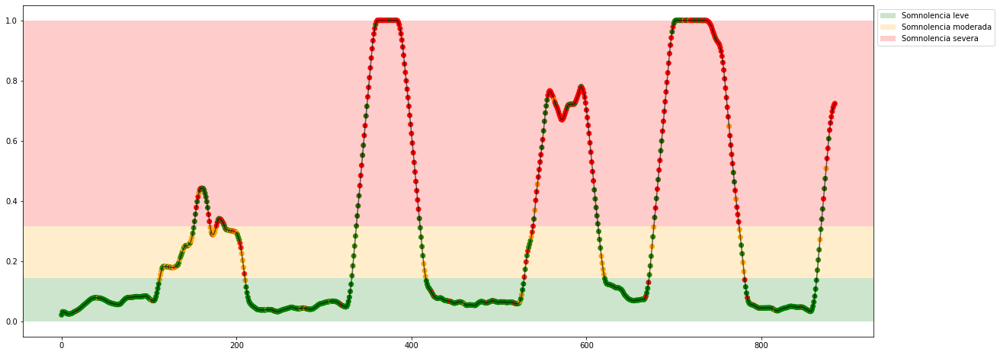

In [54]:
for key in X_all:
    data, aux2 = read_features(f'./features/{key}.csv')
    scaler = MinMaxScaler(feature_range=(0, 1))
    data_minmax = scaler.fit_transform(data)
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(general_model.predict(data_minmax), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

### Decision tree PSD

Experiment: Modelo General Decision Tree PSD
Best Model:
	Score: 0.7079
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 26, 'max_features': 'auto', 'min_samples_split': 5, 'splitter': 'best'}

Results with X_test:
	Accuracy: 73.31%
	Precision: 0.6882
	Recall: 0.6959
	f1: 0.6917
Matriz de confusión para X completo


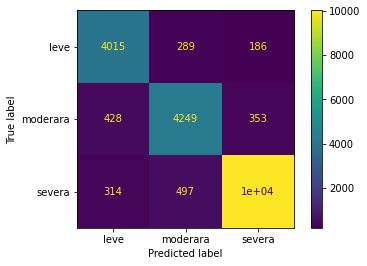

In [42]:
print(f"Experiment: Modelo General Decision Tree PSD")
model = DecisionTreeClassifier(random_state=42)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['criterion'] = ["gini", "entropy"]
space['splitter'] = ["best", "random"]
space['max_depth'] = randint(5, 100)
space['min_samples_split'] = randint(2, 10)
#space['min_samples_leaf'] = randint(1, 10)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['ccp_alpha'] = uniform(0, 5) # empeora el ponerlo, el mejor valor es 0.0

general_model, acc, pre, rec, f1 = find_and_test_best_model_class(X, y_class, model, space, cv=cv,  n_iter=10)

In [43]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = general_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

psd_alpha: 0.2301
psd_gamma: 0.2217
psd_delta: 0.1963
psd_theta: 0.1828
psd_betha: 0.1692


Experiment: 1_20151124_noon_2


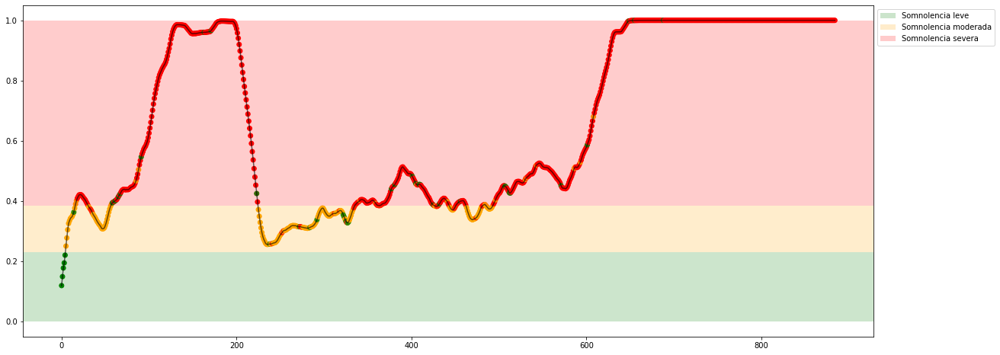

Experiment: 2_20151106_noon


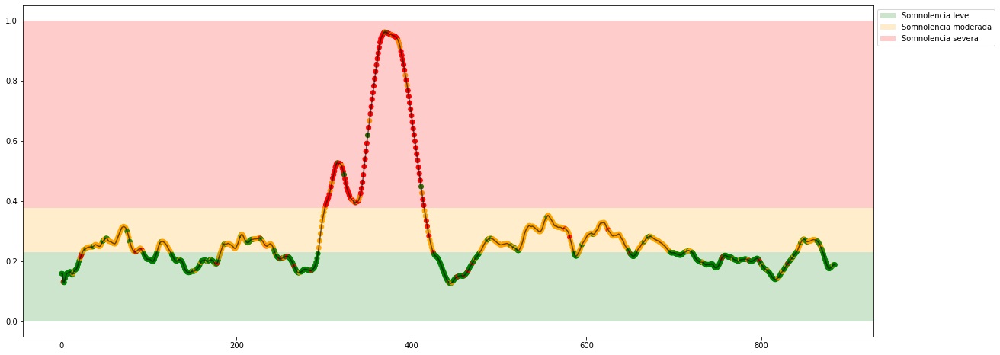

Experiment: 3_20151024_noon


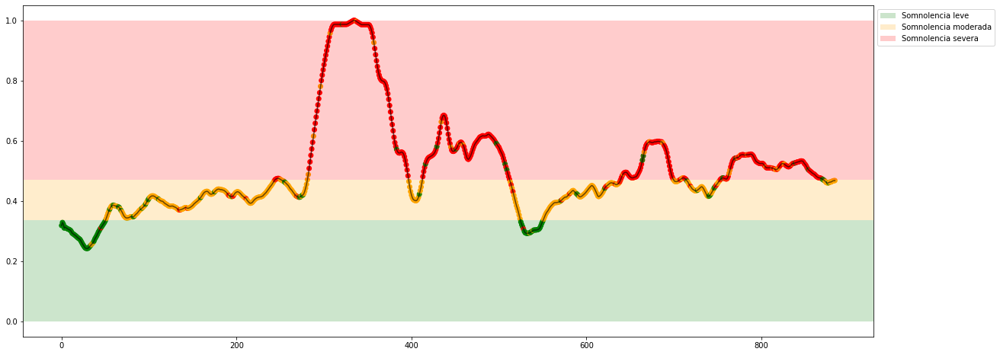

Experiment: 4_20151105_noon


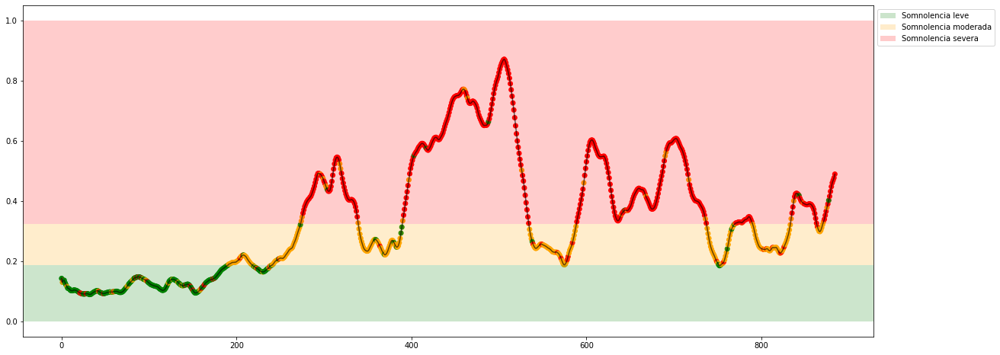

Experiment: 4_20151107_noon


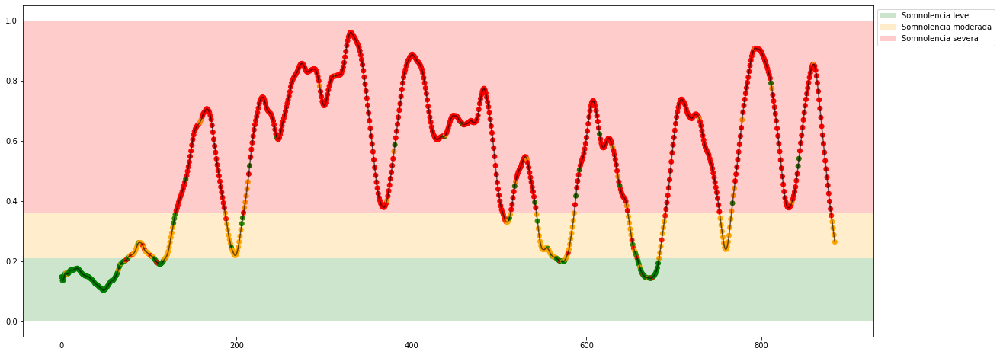

Experiment: 5_20141108_noon


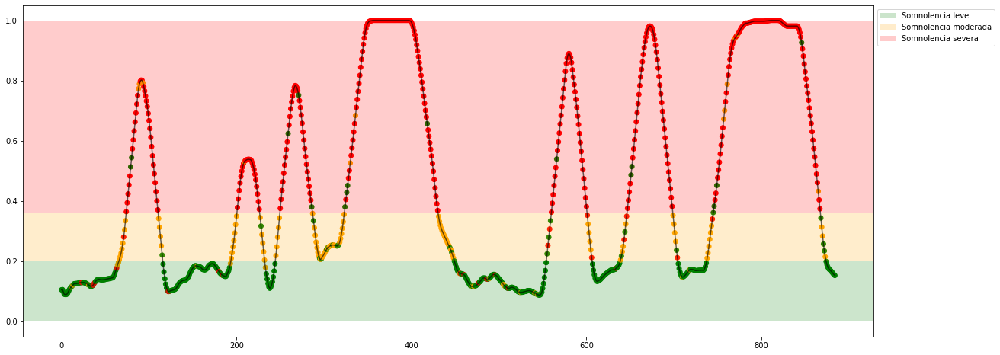

Experiment: 5_20151012_night


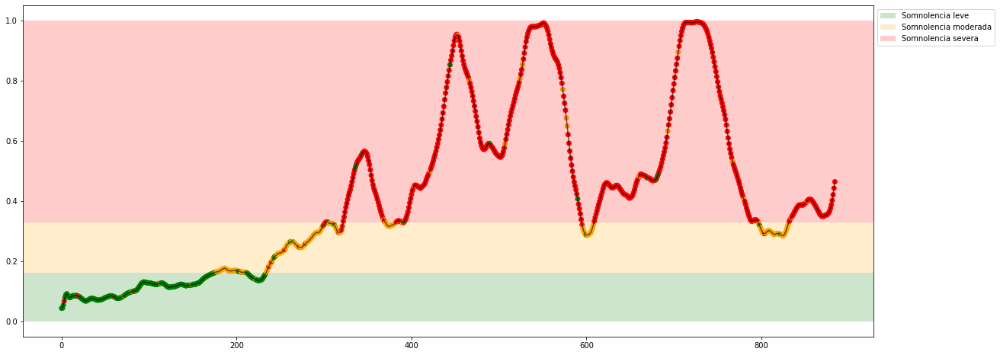

Experiment: 6_20151121_noon


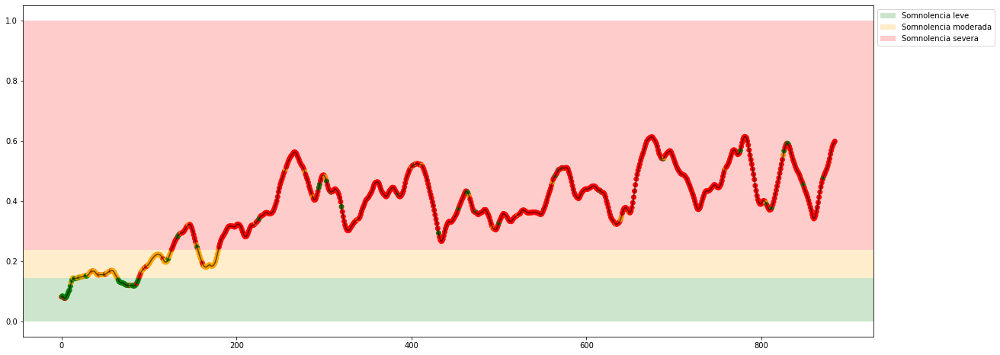

Experiment: 7_20151015_night


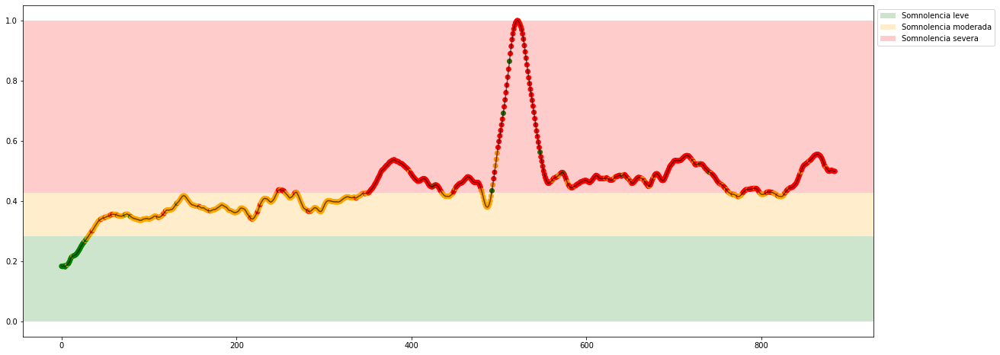

Experiment: 8_20151022_noon


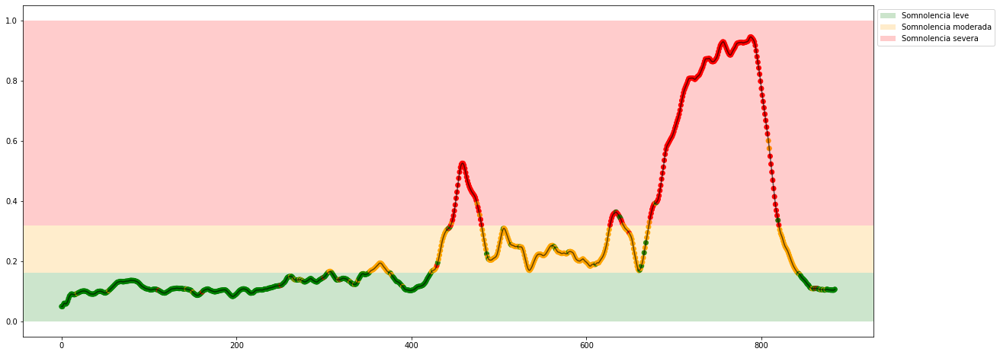

Experiment: 9_20151017_night


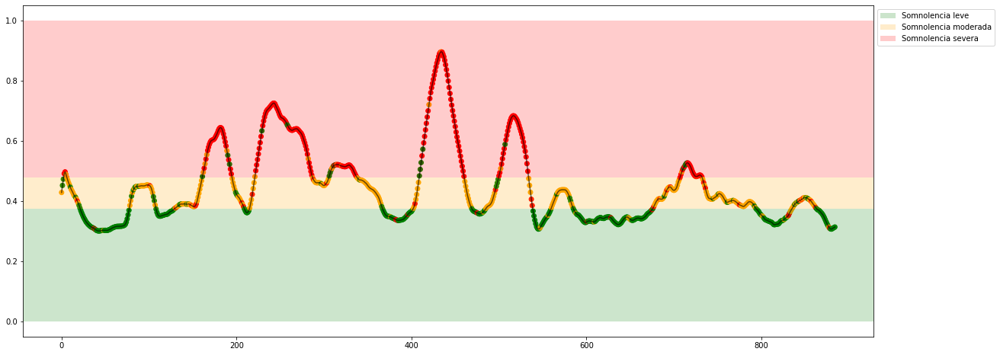

Experiment: 10_20151125_noon


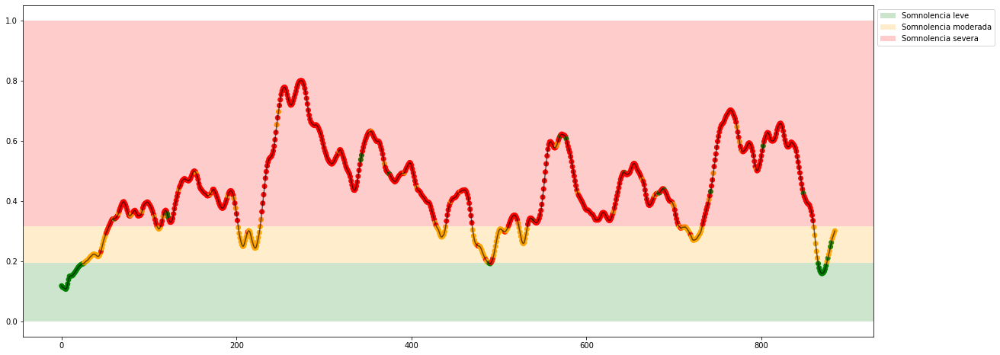

Experiment: 11_20151024_night


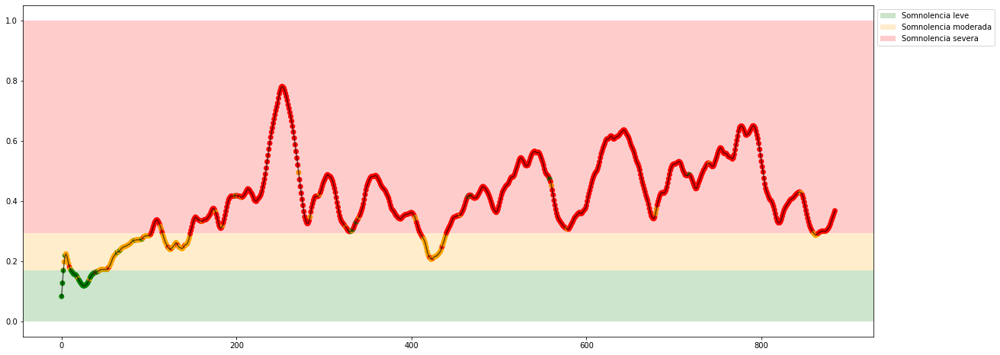

Experiment: 12_20150928_noon


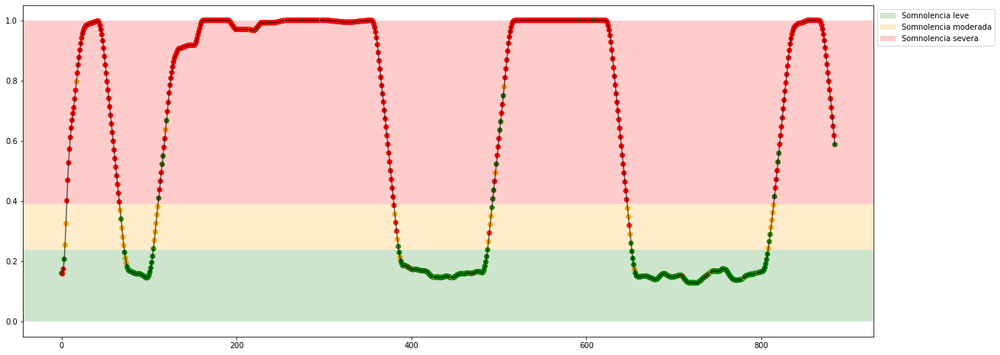

Experiment: 13_20150929_noon


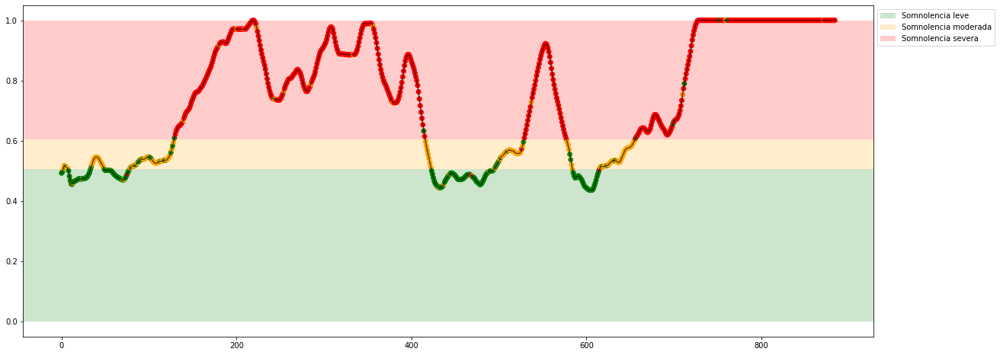

Experiment: 14_20151014_night


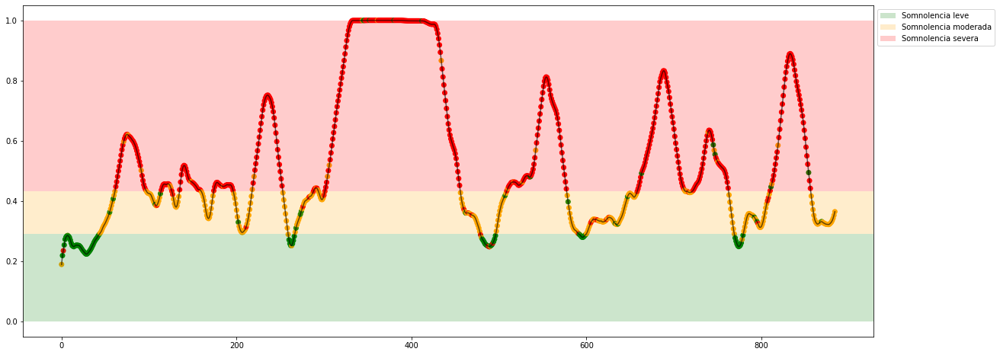

Experiment: 15_20151126_night


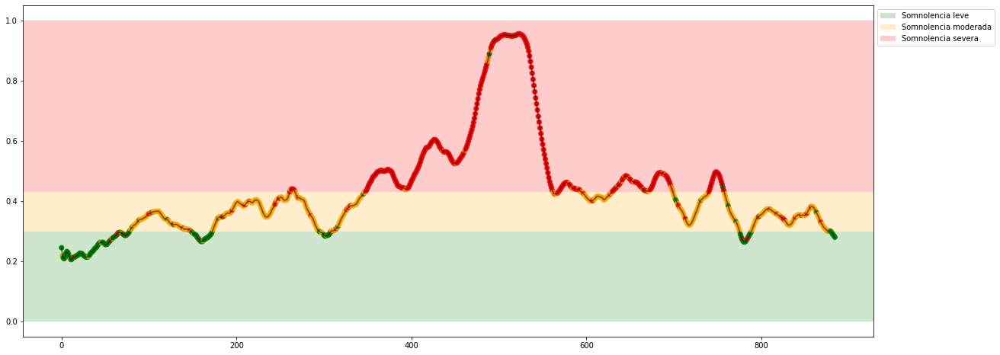

Experiment: 16_20151128_night


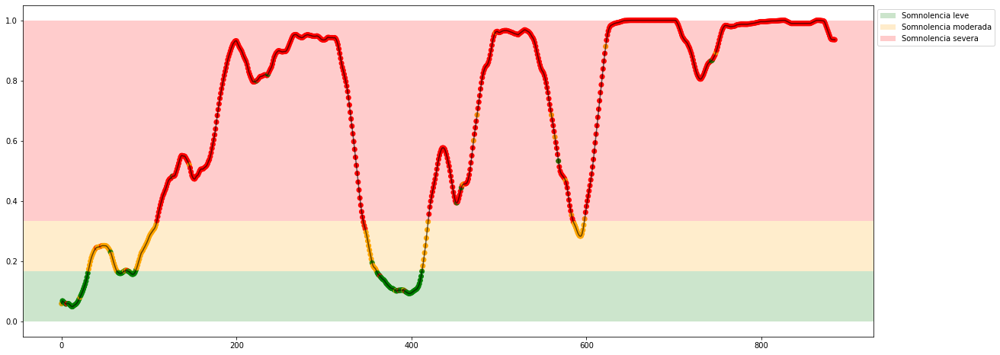

Experiment: 17_20150925_noon


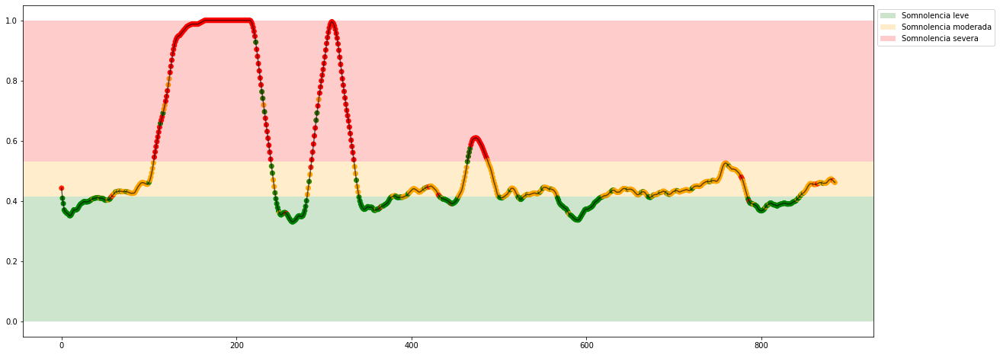

Experiment: 18_20150926_noon


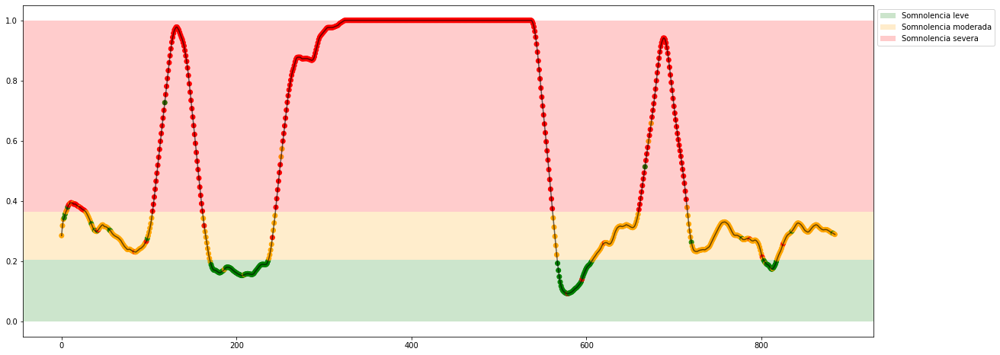

Experiment: 19_20151114_noon


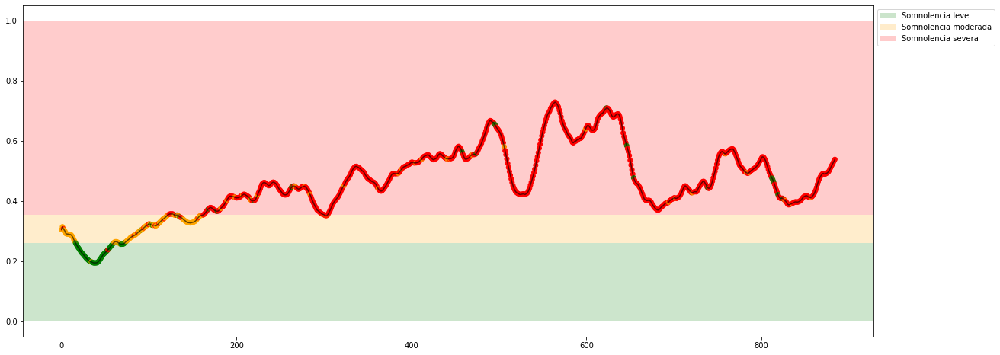

Experiment: 20_20151129_night


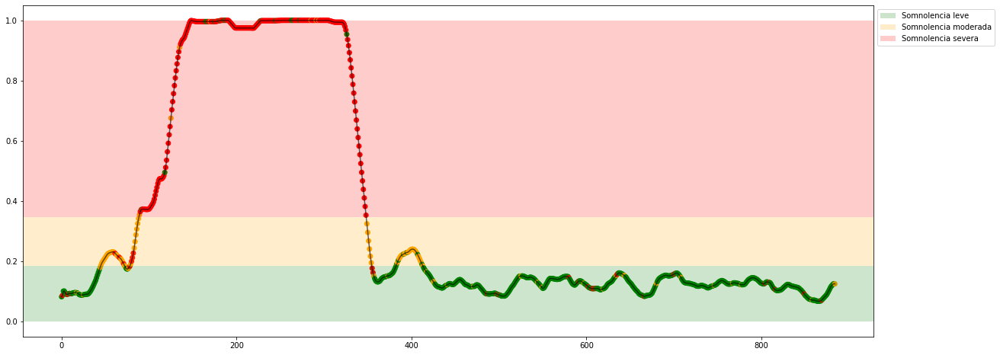

Experiment: 21_20151016_noon


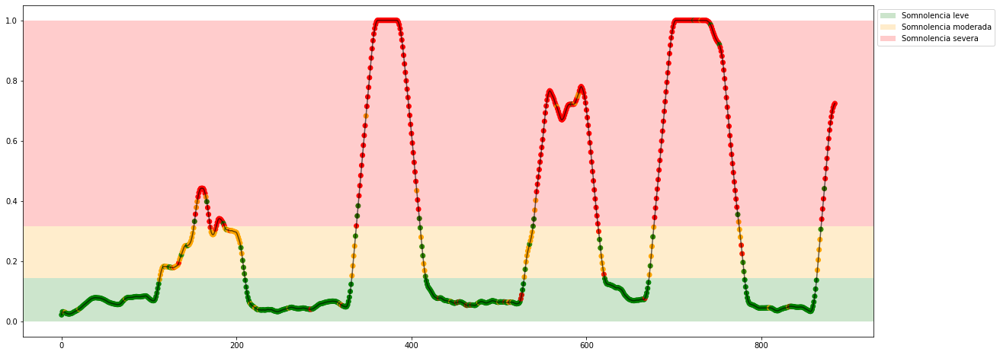

In [44]:
for key in X_all:
    data = X_all[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(general_model.predict(data), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

### Decision Tree PSD + EOG

Experiment: Modelo General Decision Tree PSD + EOG
Best Model:
	Score: 0.6854
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 26, 'max_features': 'auto', 'min_samples_split': 5, 'splitter': 'best'}

Results with X_test:
	Accuracy: 71.49%
	Precision: 0.6675
	Recall: 0.6720
	f1: 0.6697
Matriz de confusión para X completo


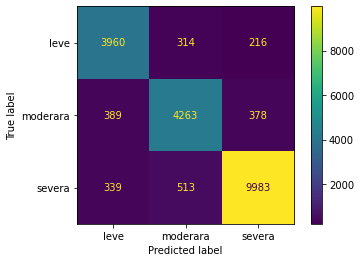

In [45]:
print(f"Experiment: Modelo General Decision Tree PSD + EOG")
model = DecisionTreeClassifier(random_state=42)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['criterion'] = ["gini", "entropy"]
space['splitter'] = ["best", "random"]
space['max_depth'] = randint(5, 100)
space['min_samples_split'] = randint(2, 10)
#space['min_samples_leaf'] = randint(1, 10)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['ccp_alpha'] = uniform(0, 5) # empeora el ponerlo, el mejor valor es 0.0

general_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_eog, y_class, model, space, cv=cv,  n_iter=10)

In [46]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = general_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

psd_alpha: 0.2236
psd_theta: 0.1808
psd_delta: 0.1716
psd_gamma: 0.1603
psd_betha: 0.1507
n_parpadeos: 0.1130


Experiment: 1_20151124_noon_2


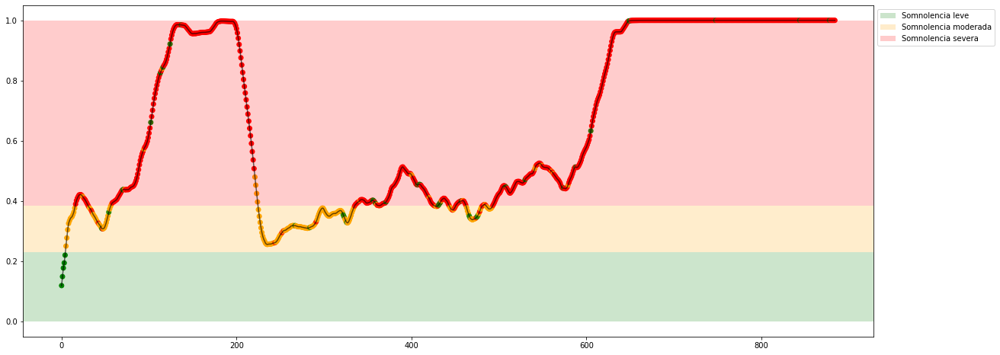

Experiment: 2_20151106_noon


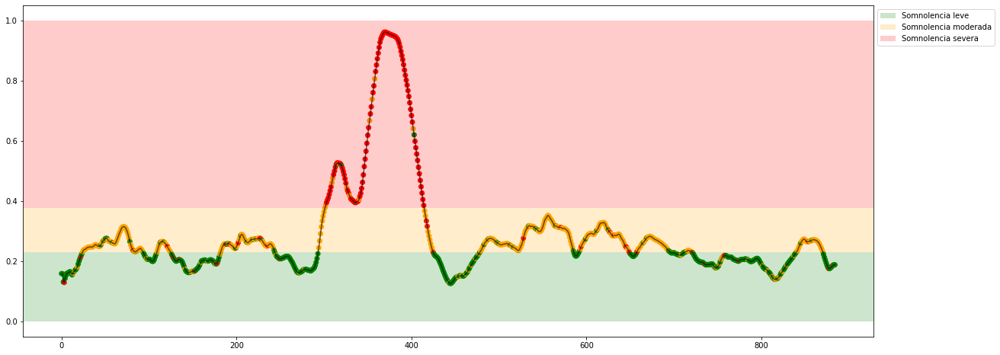

Experiment: 3_20151024_noon


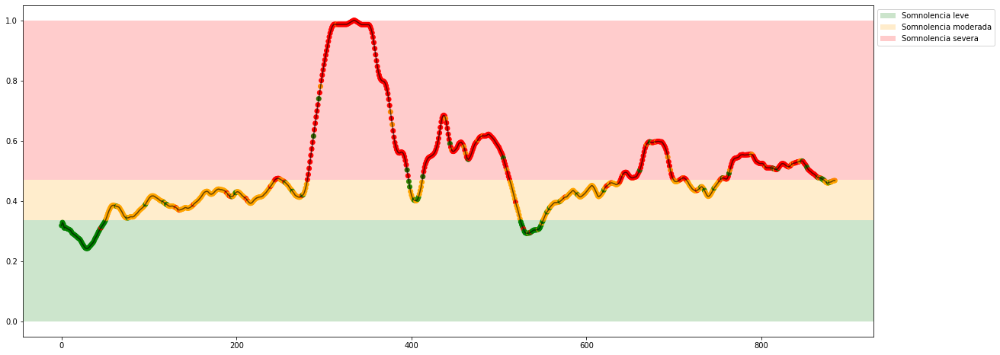

Experiment: 4_20151105_noon


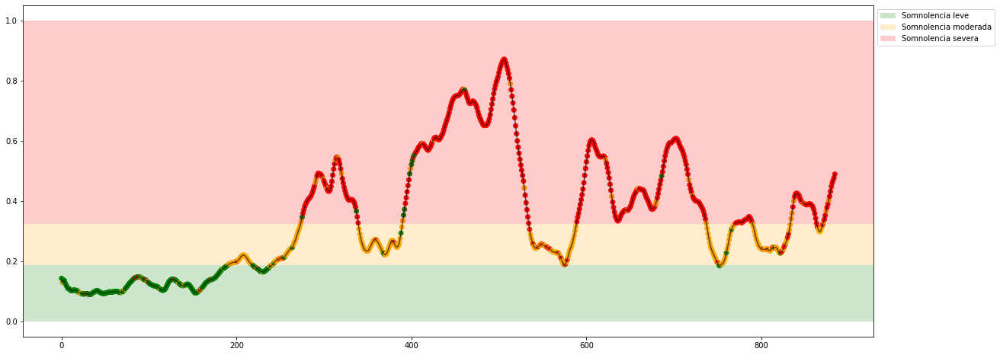

Experiment: 4_20151107_noon


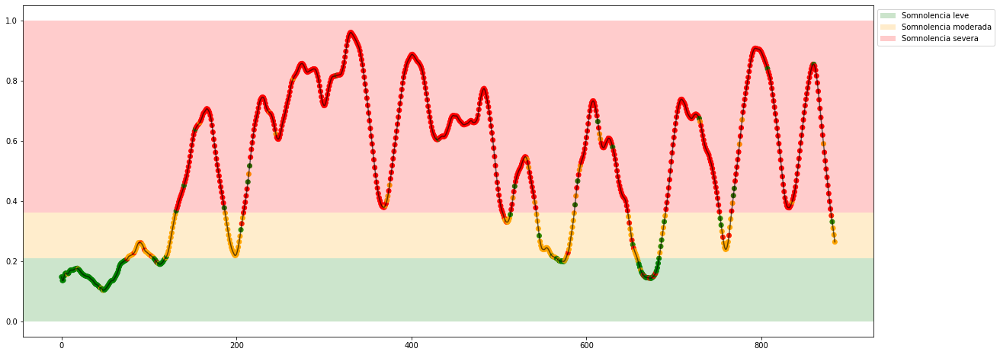

Experiment: 5_20141108_noon


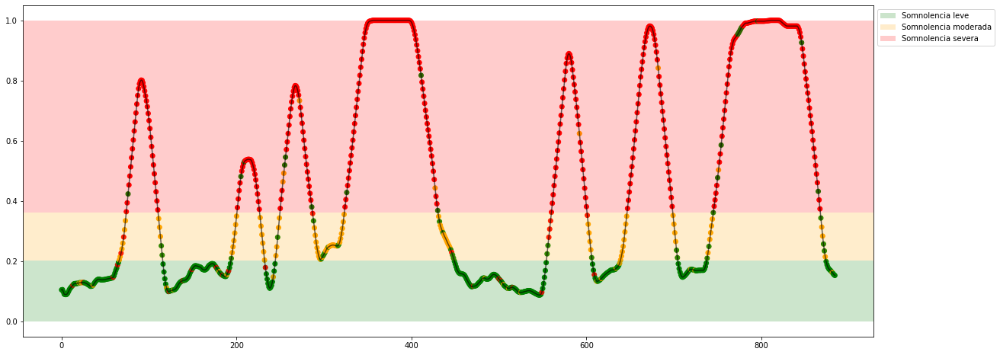

Experiment: 5_20151012_night


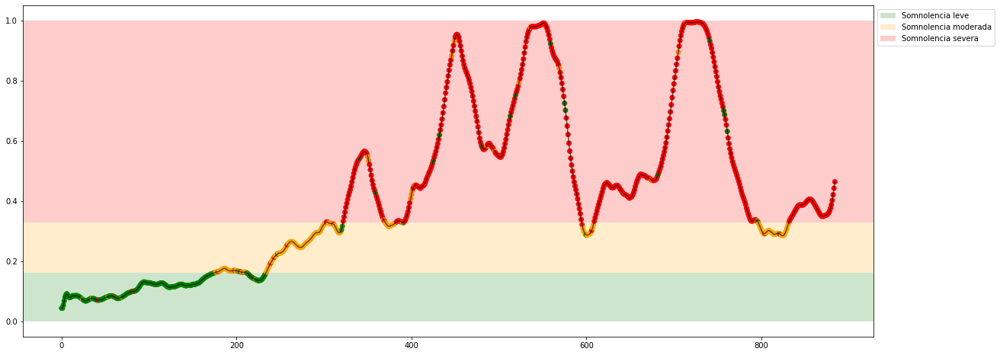

Experiment: 6_20151121_noon


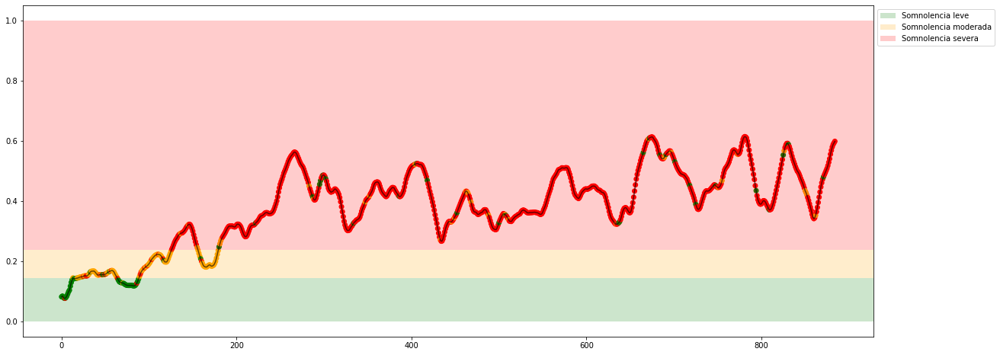

Experiment: 7_20151015_night


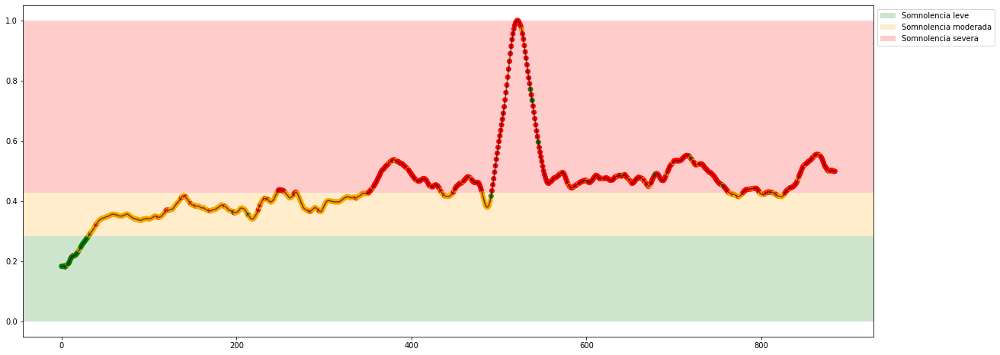

Experiment: 8_20151022_noon


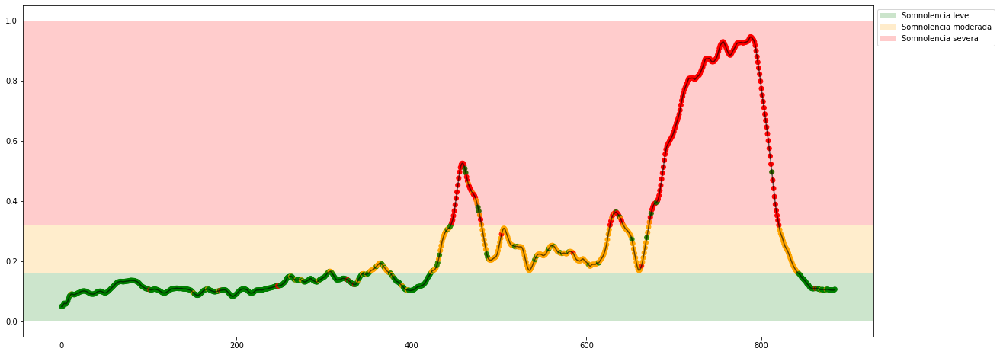

Experiment: 9_20151017_night


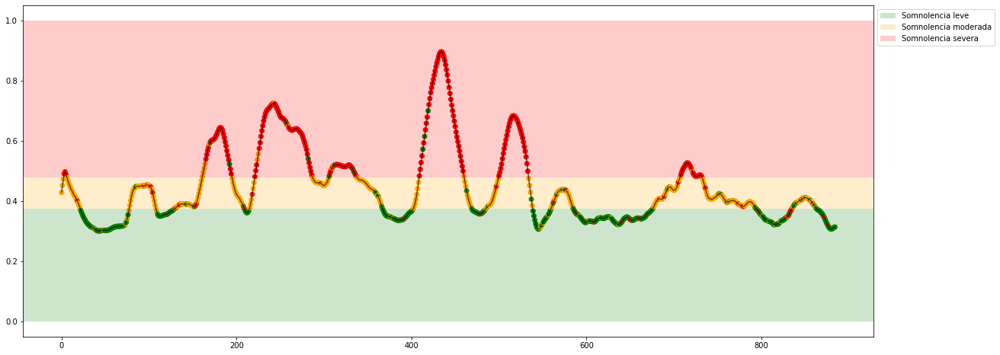

Experiment: 10_20151125_noon


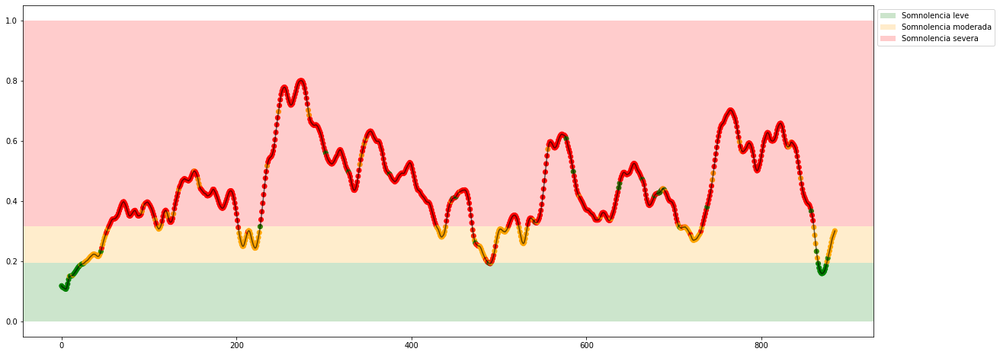

Experiment: 11_20151024_night


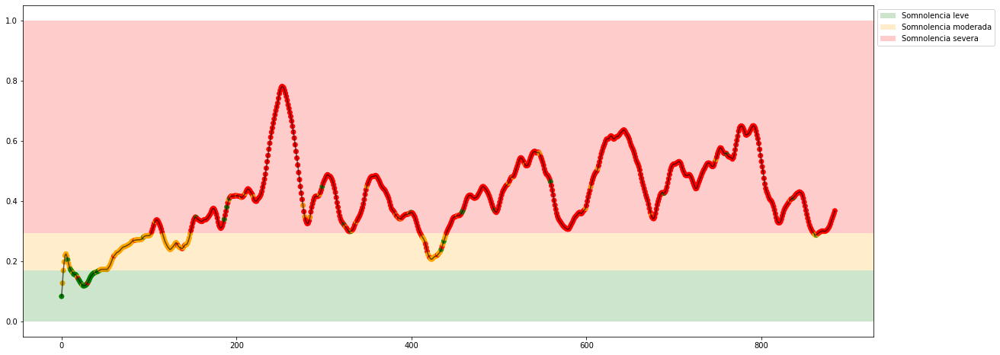

Experiment: 12_20150928_noon


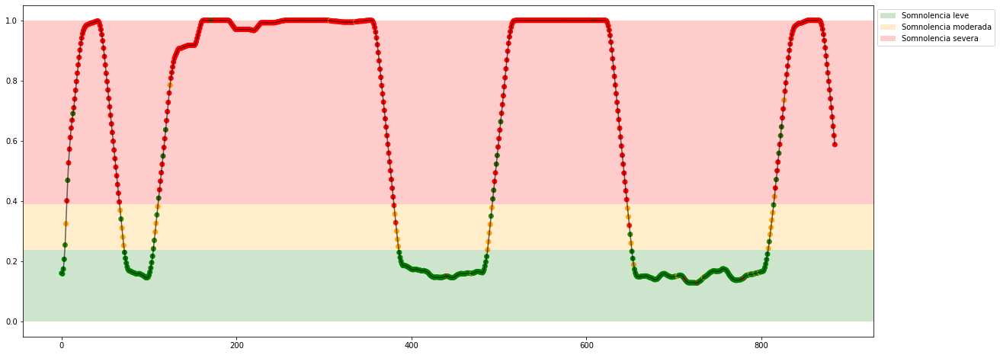

Experiment: 13_20150929_noon


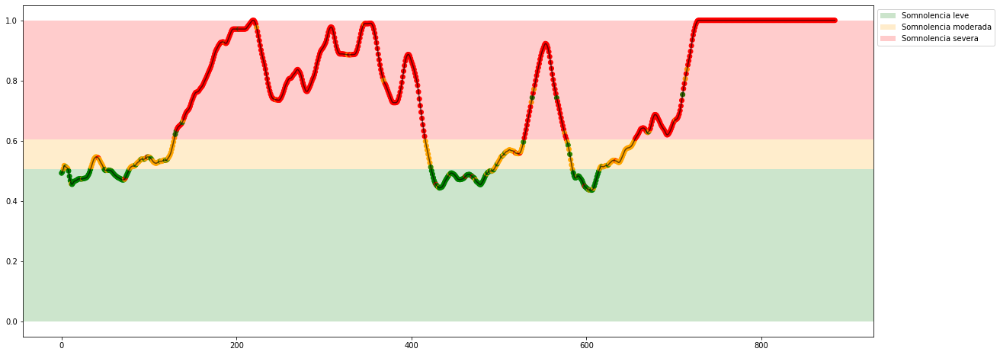

Experiment: 14_20151014_night


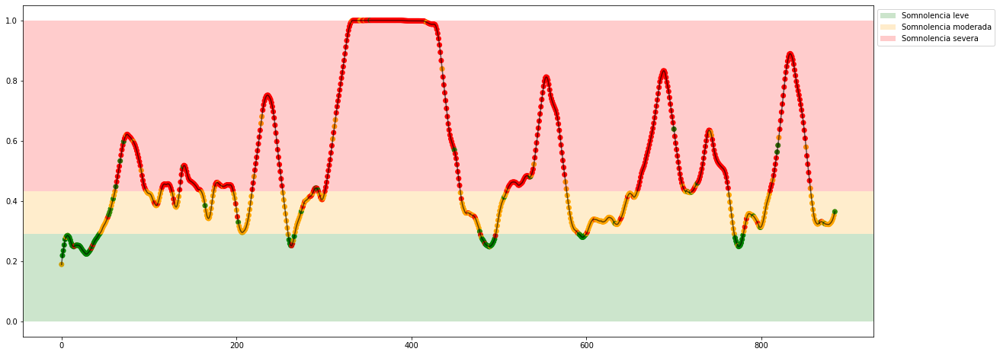

Experiment: 15_20151126_night


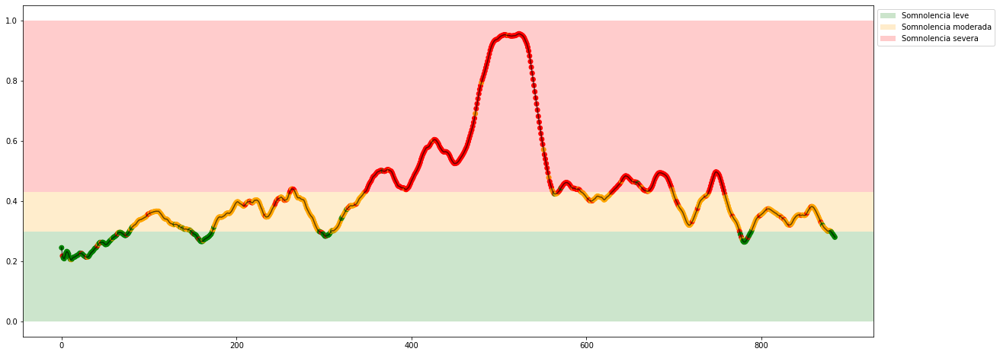

Experiment: 16_20151128_night


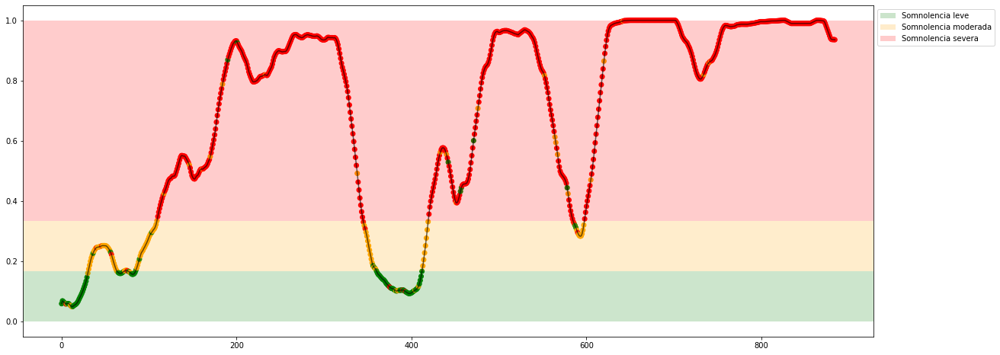

Experiment: 17_20150925_noon


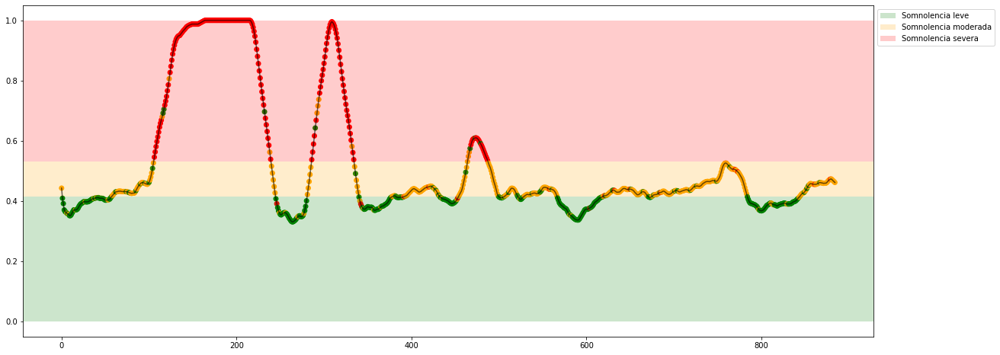

Experiment: 18_20150926_noon


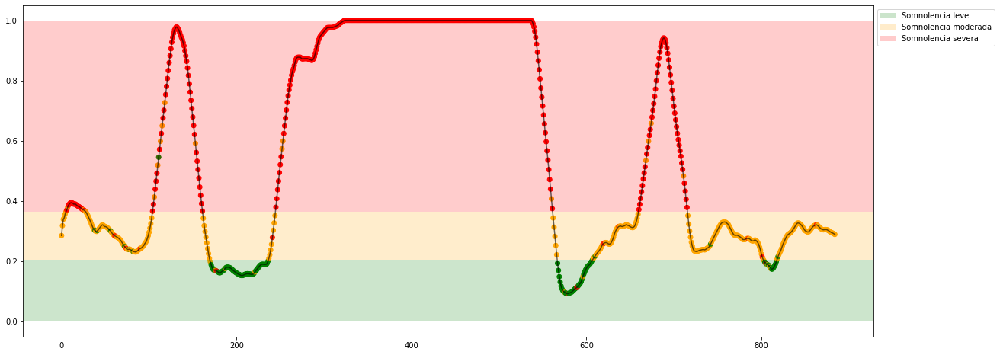

Experiment: 19_20151114_noon


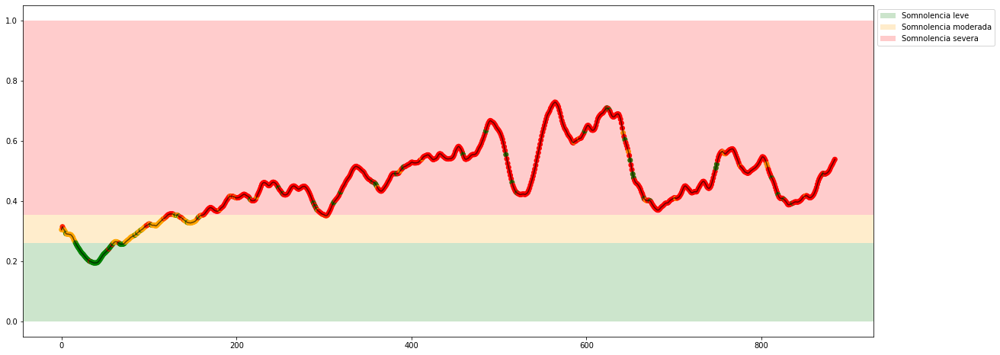

Experiment: 20_20151129_night


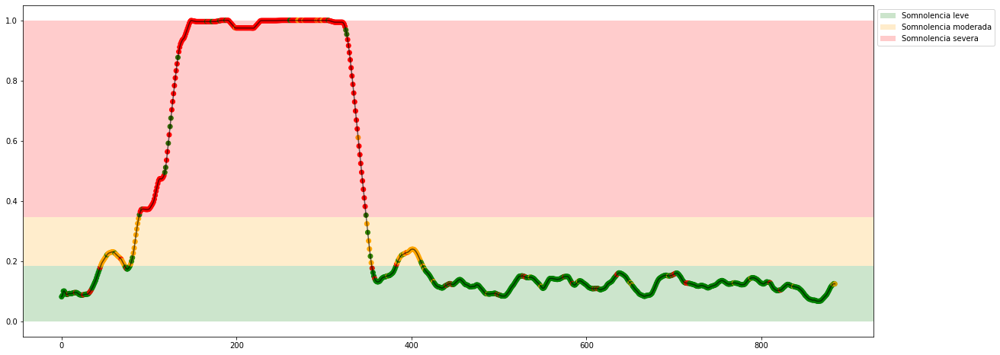

Experiment: 21_20151016_noon


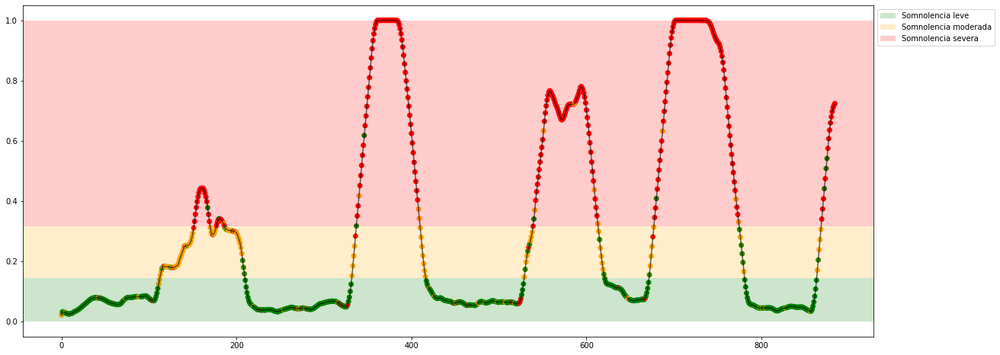

In [47]:
for key in X_all:
    data = X_all_eog[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(general_model.predict(data), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

## Random Forest

In [55]:
from sklearn.ensemble import RandomForestClassifier

### Random Forest EEG

Experiment: Modelo General Decision Tree EEG
Best Model:
	Score: 0.7102
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 72.49%
	Precision: 0.6744
	Recall: 0.6530
	f1: 0.6599
Matriz de confusión para X completo


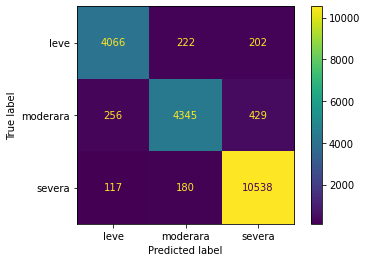

In [56]:
print(f"Experiment: Modelo General Random Forest EEG")
model = RandomForestClassifier(random_state=42, n_jobs=-1)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['n_estimators'] = randint(75, 200)
space['criterion'] = ["gini", "entropy"]
space['max_depth'] = randint(75, 150)
space['min_samples_split'] = randint(2, 10)
space['min_samples_leaf'] = randint(1, 10)
# space['min_weight_fraction_leaf'] = uniform(0, 0.5)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['max_leaf_nodes'] = randint(1, 300)
# space['min_impurity_decrease'] = uniform(0, 5)
#space['bootstrap'] = [True, False]
# space['oob_score'] = [True, False]
space['warm_start'] = [True, False]
# space['class_weight'] = ['balanced', 'balanced_subsample']
#space['ccp_alpha'] = uniform(0, 5)
#space['max_samples'] = uniform(0, 1)

general_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_eeg, y_class, model, space, cv=cv,  n_iter=20)

Experiment: 1_20151124_noon_2


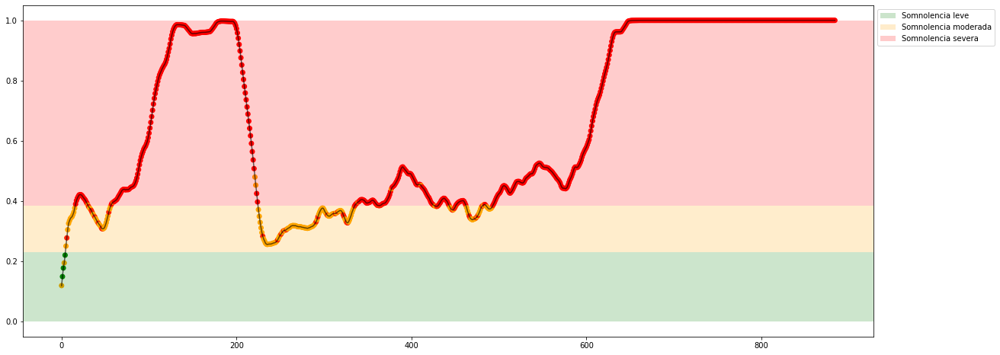

Experiment: 2_20151106_noon


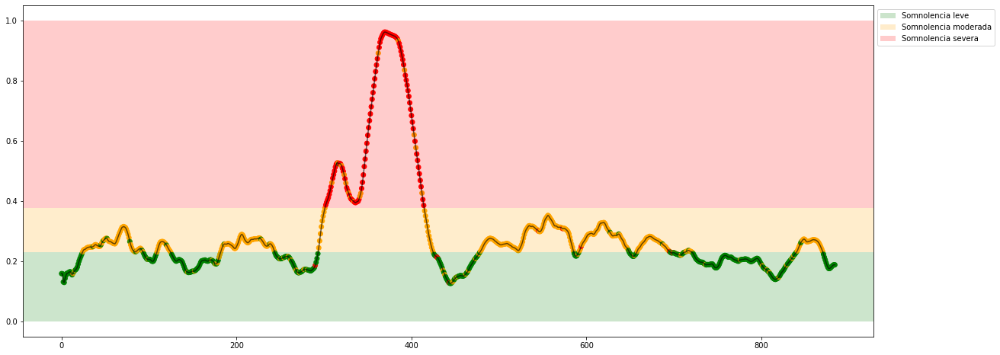

Experiment: 3_20151024_noon


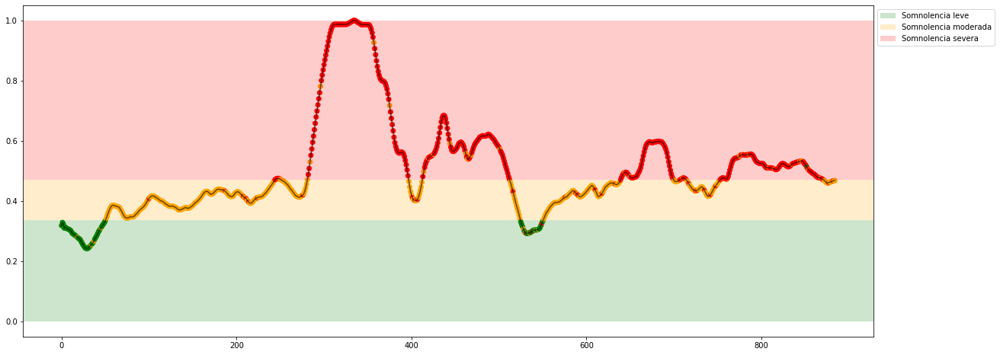

Experiment: 4_20151105_noon


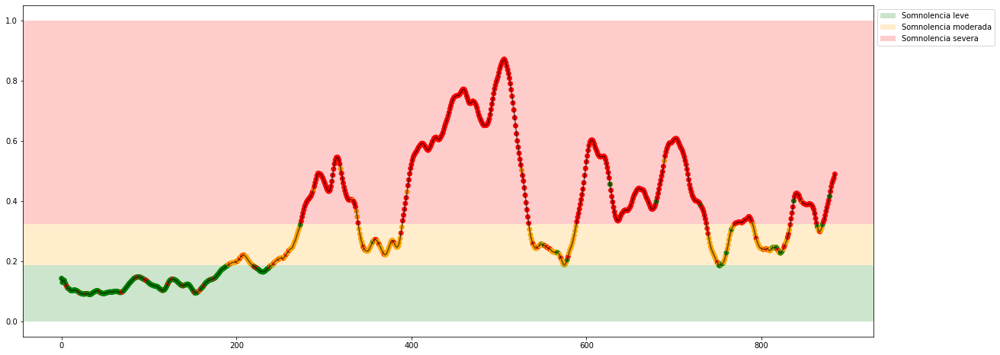

Experiment: 4_20151107_noon


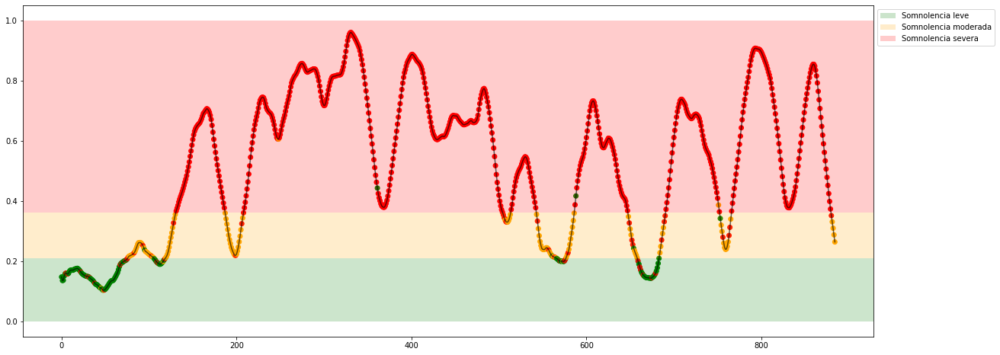

Experiment: 5_20141108_noon


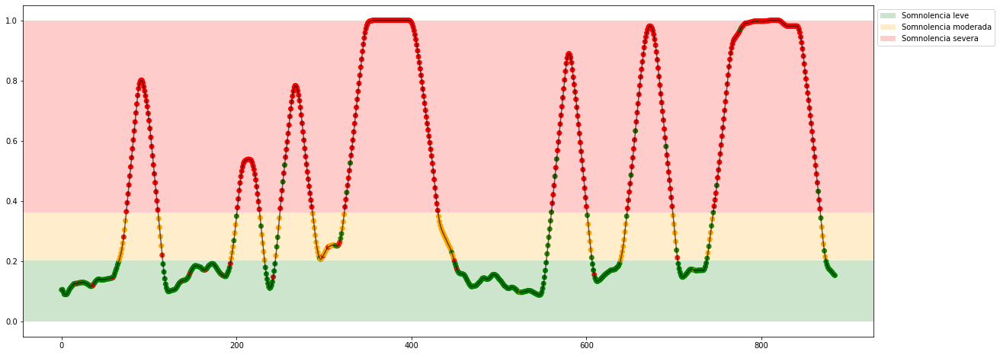

Experiment: 5_20151012_night


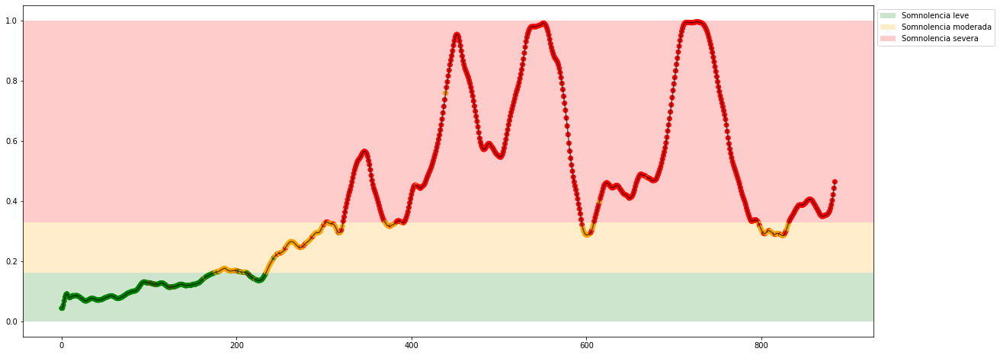

Experiment: 6_20151121_noon


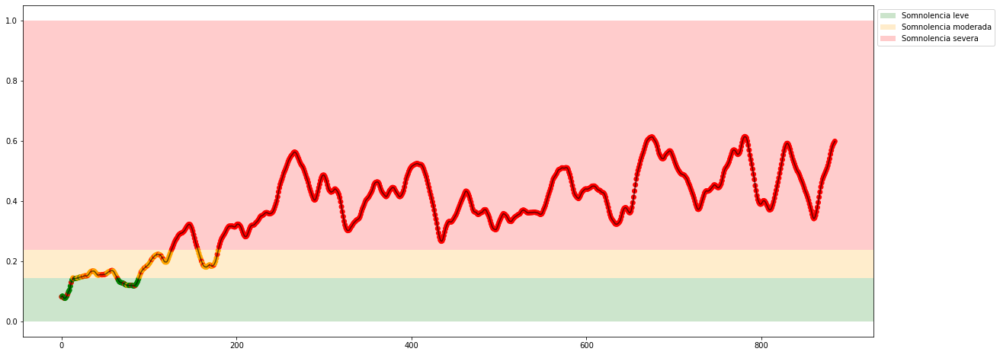

Experiment: 7_20151015_night


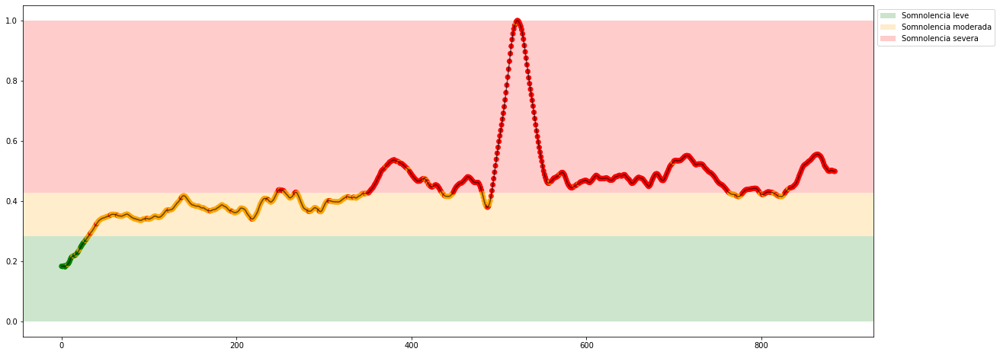

Experiment: 8_20151022_noon


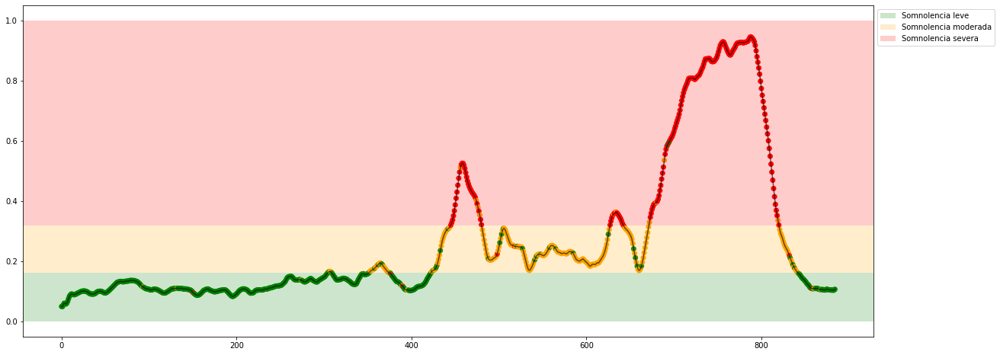

Experiment: 9_20151017_night


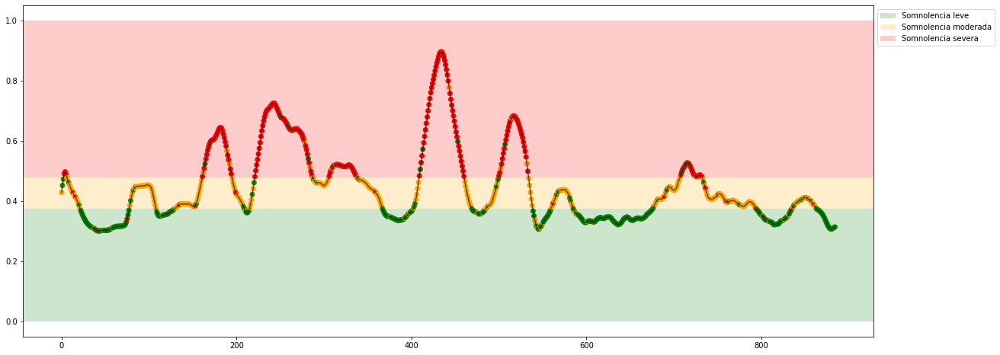

Experiment: 10_20151125_noon


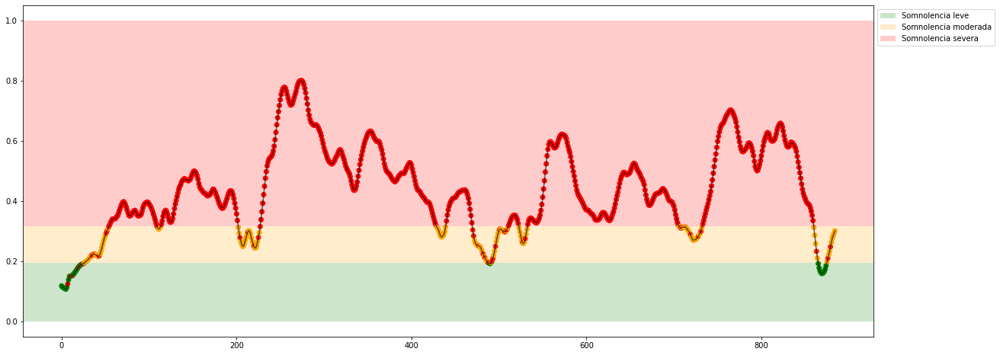

Experiment: 11_20151024_night


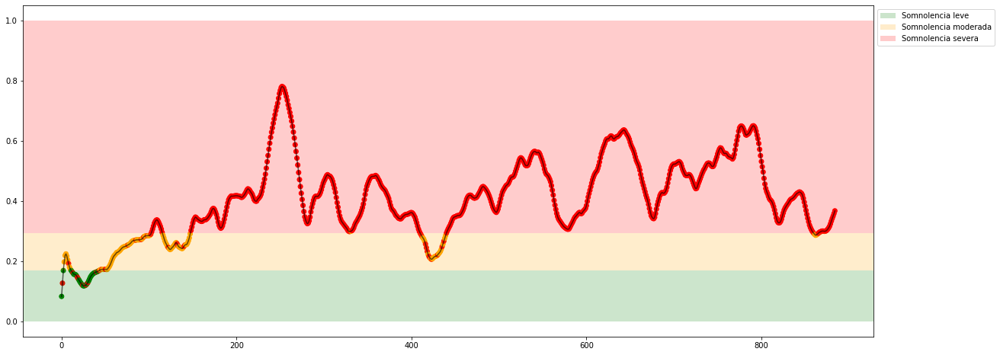

Experiment: 12_20150928_noon


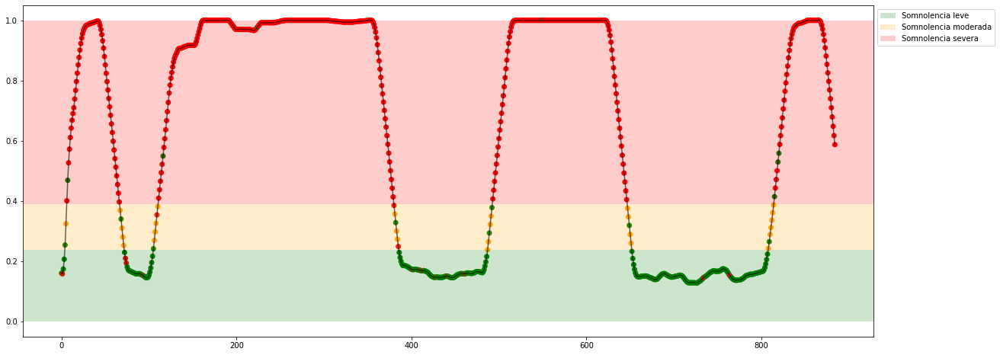

Experiment: 13_20150929_noon


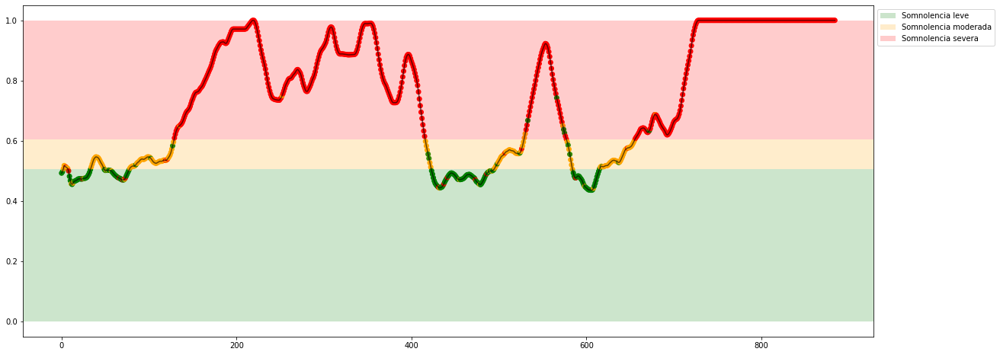

Experiment: 14_20151014_night


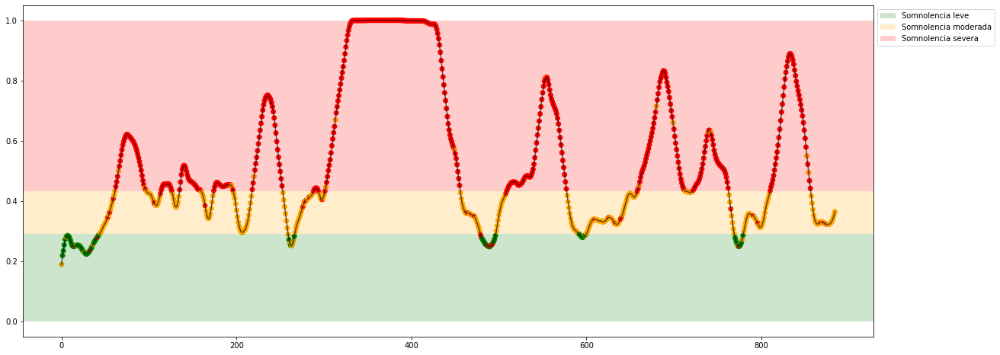

Experiment: 15_20151126_night


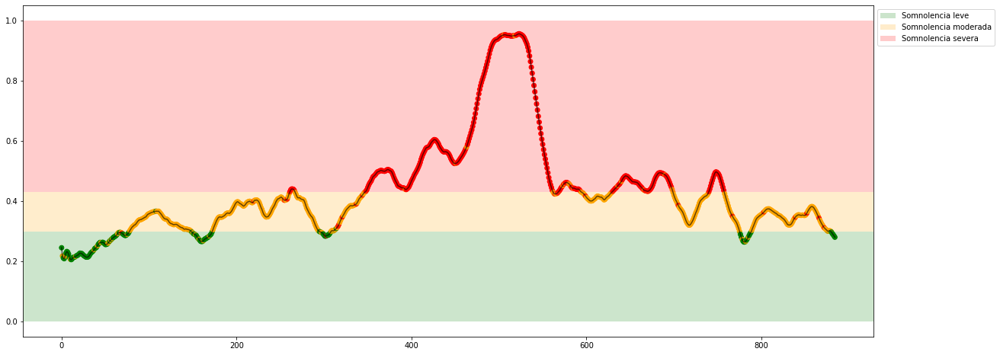

Experiment: 16_20151128_night


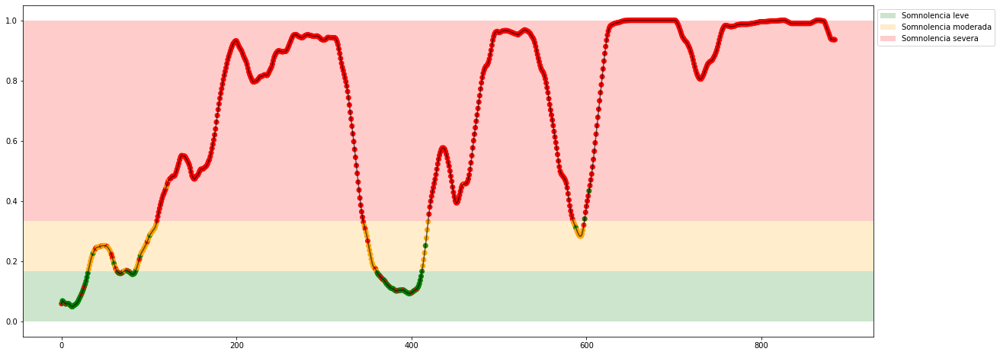

Experiment: 17_20150925_noon


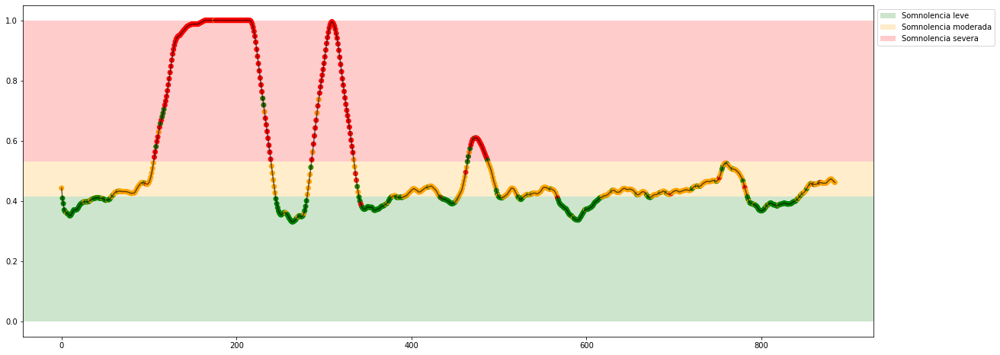

Experiment: 18_20150926_noon


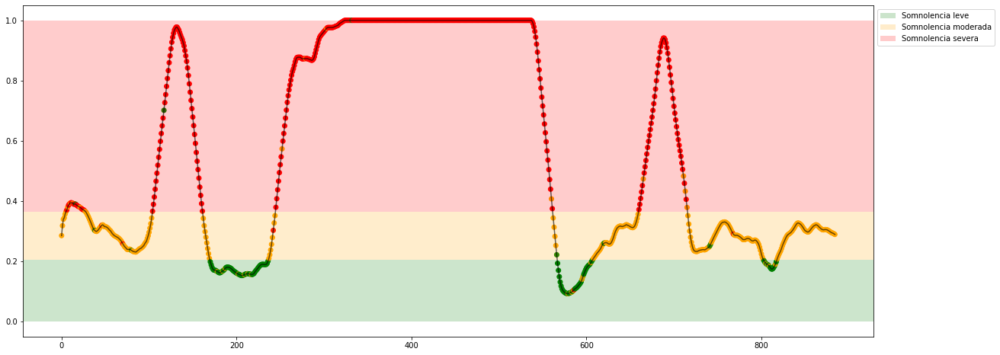

Experiment: 19_20151114_noon


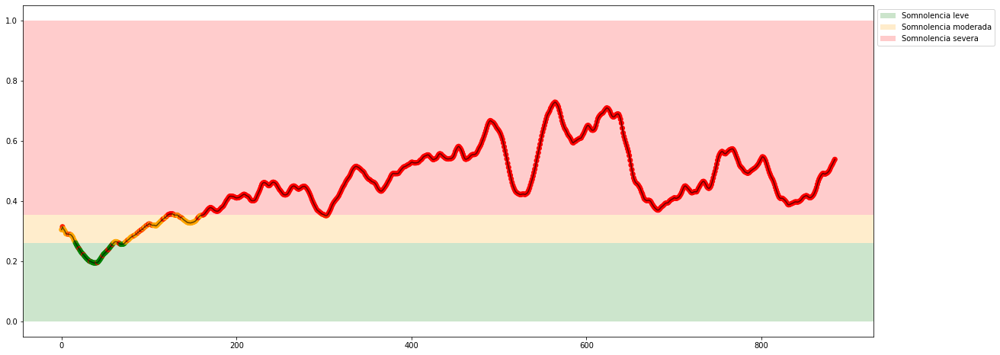

Experiment: 20_20151129_night


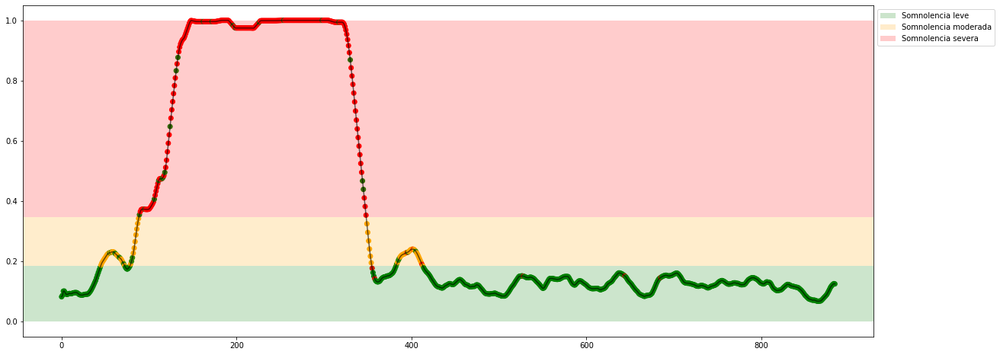

Experiment: 21_20151016_noon


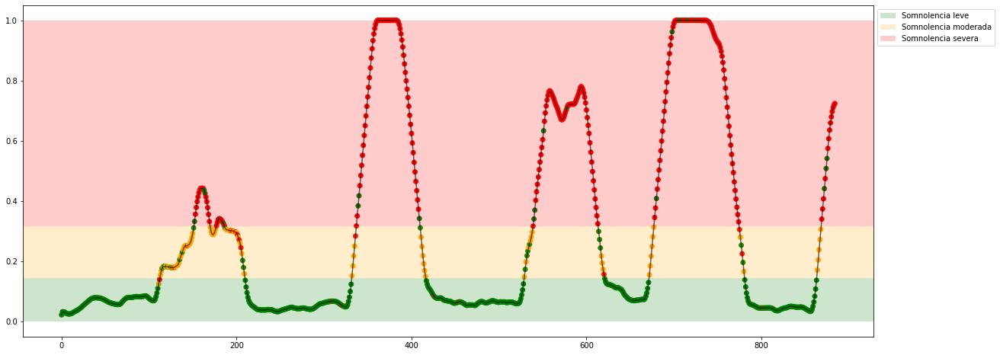

In [64]:
for key in X_all:
    data, aux2 = read_features(f'./features/{key}.csv')
    scaler = MinMaxScaler(feature_range=(0, 1))
    data_minmax = scaler.fit_transform(data)
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(general_model.predict(data_minmax), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

### Random Forest PSD

Experiment: Modelo General Random Forest PSD
Best Model:
	Score: 0.7969
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 82.47%
	Precision: 0.7989
	Recall: 0.7835
	f1: 0.7903
Matriz de confusión para X completo


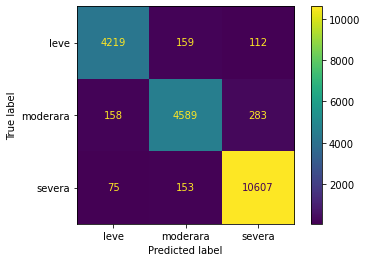

In [65]:
print(f"Experiment: Modelo General Random Forest PSD")
model = RandomForestClassifier(random_state=42, n_jobs=-1)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['n_estimators'] = randint(75, 200)
space['criterion'] = ["gini", "entropy"]
space['max_depth'] = randint(75, 150)
space['min_samples_split'] = randint(2, 10)
space['min_samples_leaf'] = randint(1, 10)
# space['min_weight_fraction_leaf'] = uniform(0, 0.5)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['max_leaf_nodes'] = randint(1, 300)
# space['min_impurity_decrease'] = uniform(0, 5)
#space['bootstrap'] = [True, False]
# space['oob_score'] = [True, False]
space['warm_start'] = [True, False]
# space['class_weight'] = ['balanced', 'balanced_subsample']
#space['ccp_alpha'] = uniform(0, 5)
#space['max_samples'] = uniform(0, 1)

general_model, acc, pre, rec, f1 = find_and_test_best_model_class(X, y_class, model, space, cv=cv,  n_iter=20)

In [66]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = general_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

psd_alpha: 0.2451
psd_gamma: 0.1989
psd_delta: 0.1952
psd_theta: 0.1916
psd_betha: 0.1692


Experiment: 1_20151124_noon_2


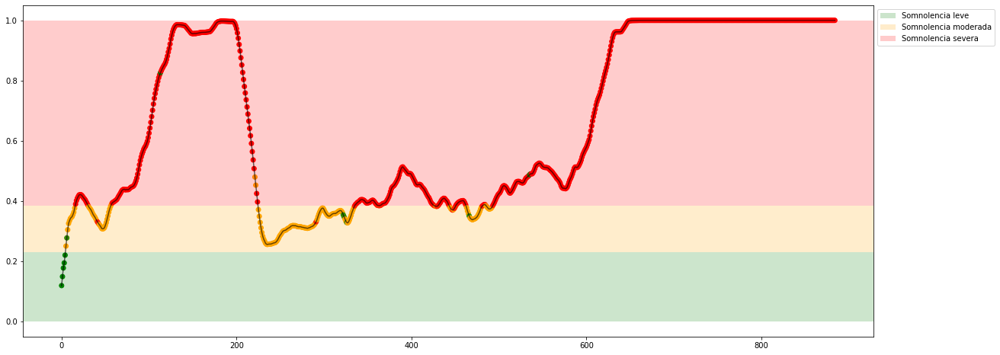

Experiment: 2_20151106_noon


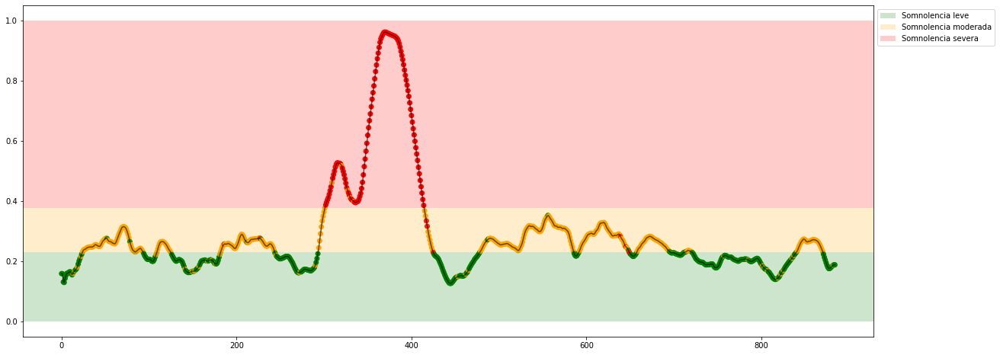

Experiment: 3_20151024_noon


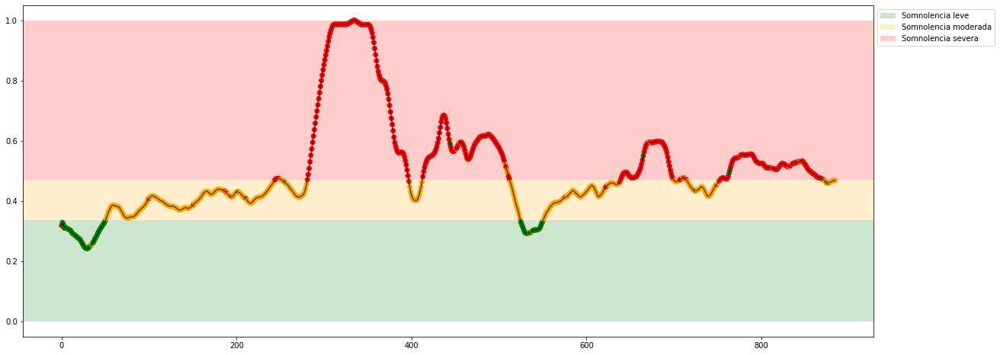

Experiment: 4_20151105_noon


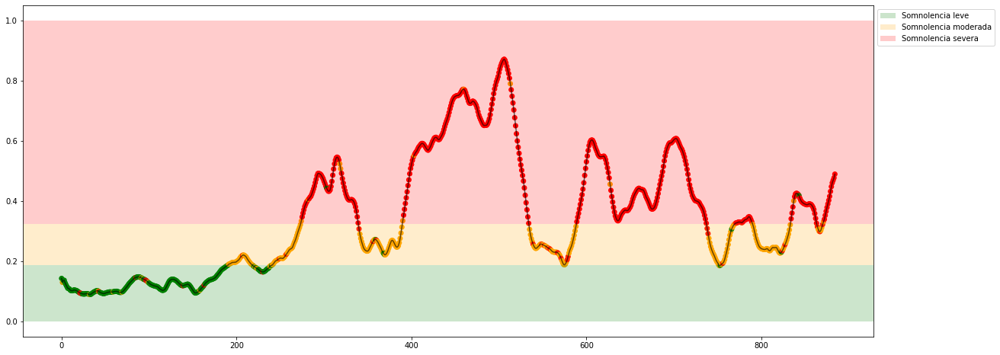

Experiment: 4_20151107_noon


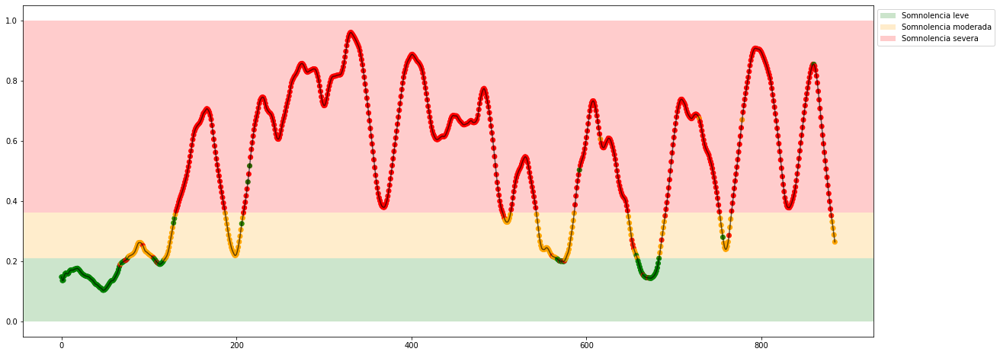

Experiment: 5_20141108_noon


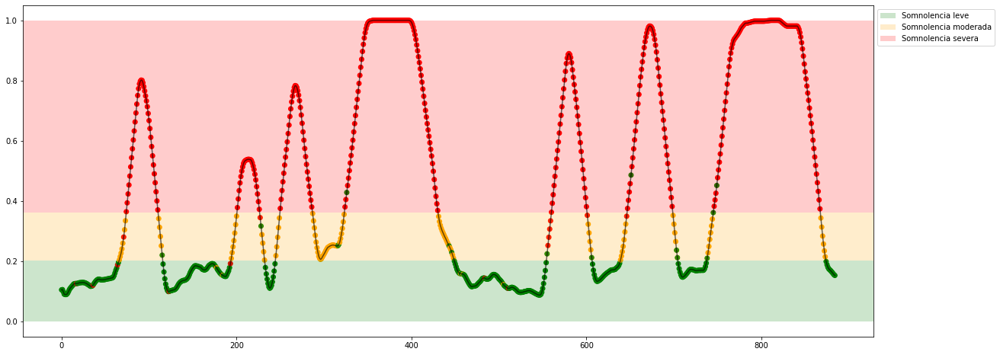

Experiment: 5_20151012_night


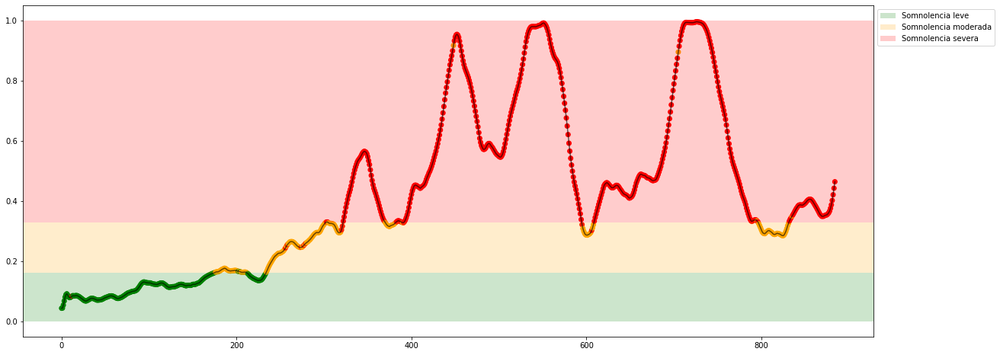

Experiment: 6_20151121_noon


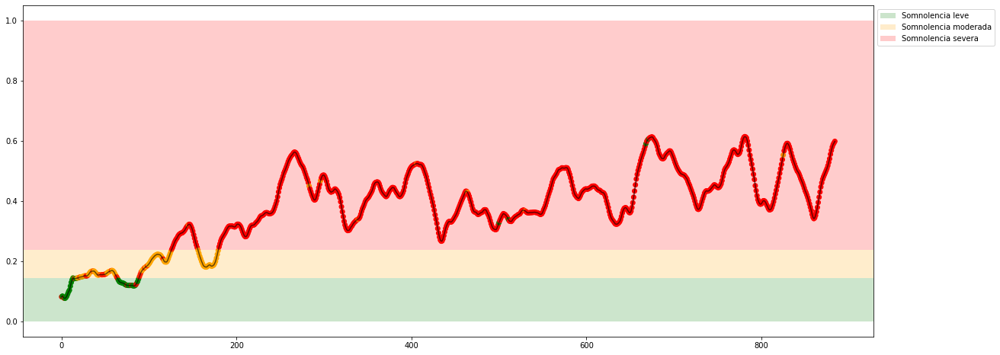

Experiment: 7_20151015_night


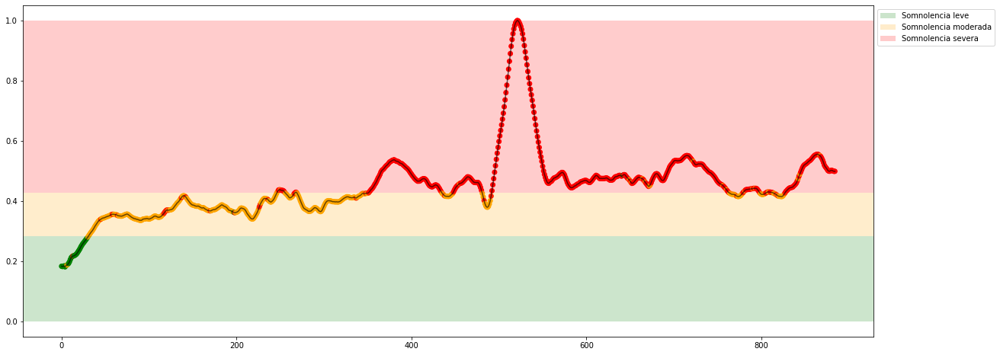

Experiment: 8_20151022_noon


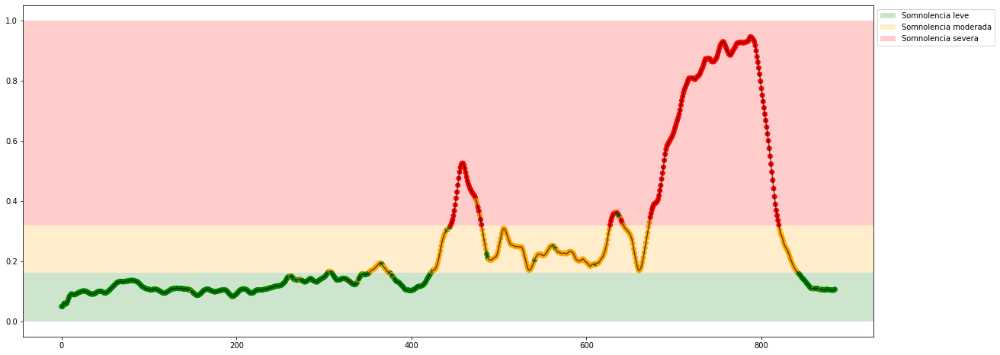

Experiment: 9_20151017_night


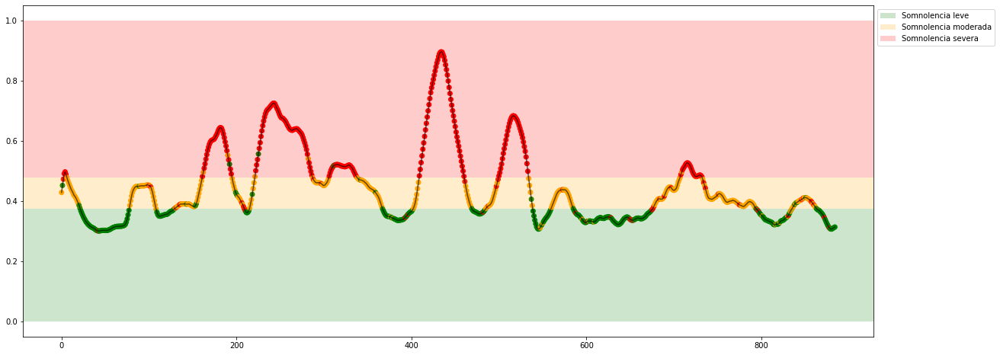

Experiment: 10_20151125_noon


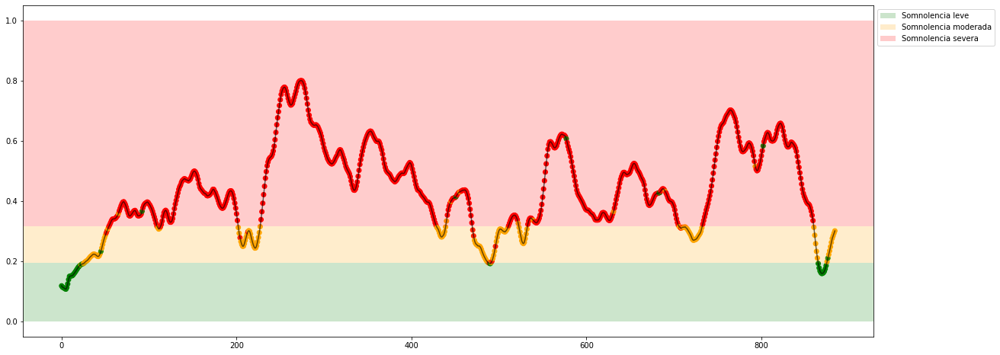

Experiment: 11_20151024_night


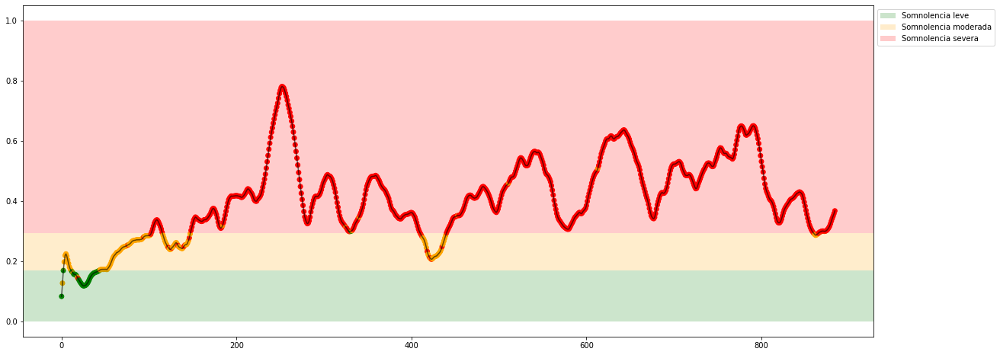

Experiment: 12_20150928_noon


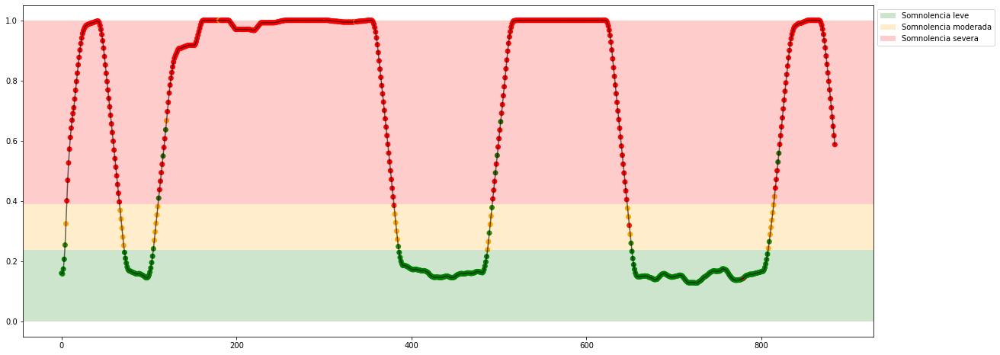

Experiment: 13_20150929_noon


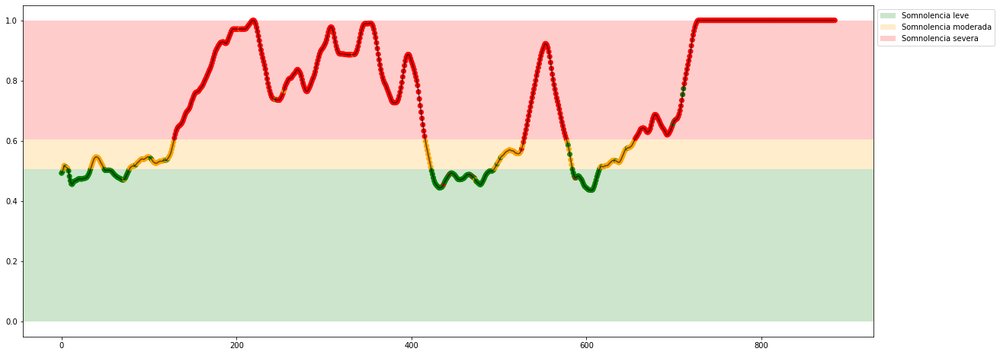

Experiment: 14_20151014_night


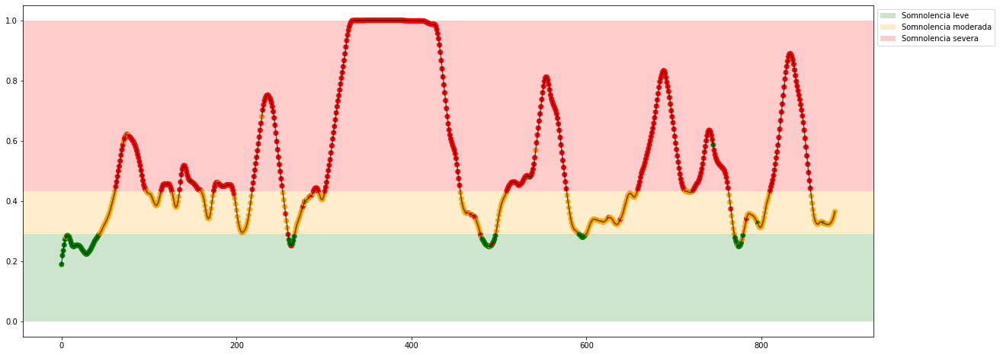

Experiment: 15_20151126_night


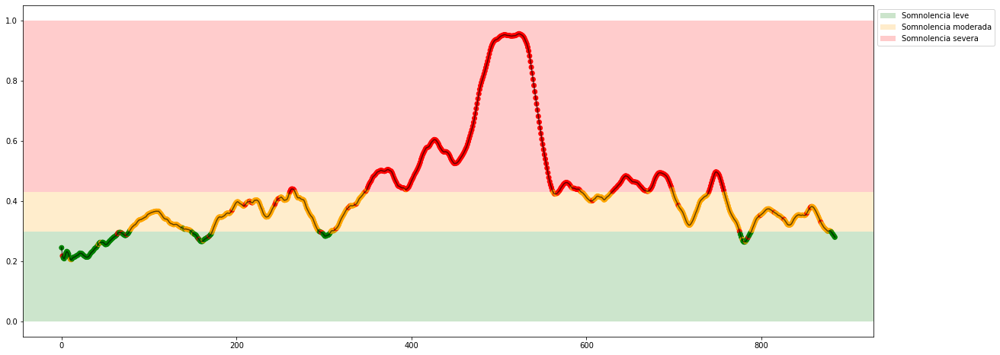

Experiment: 16_20151128_night


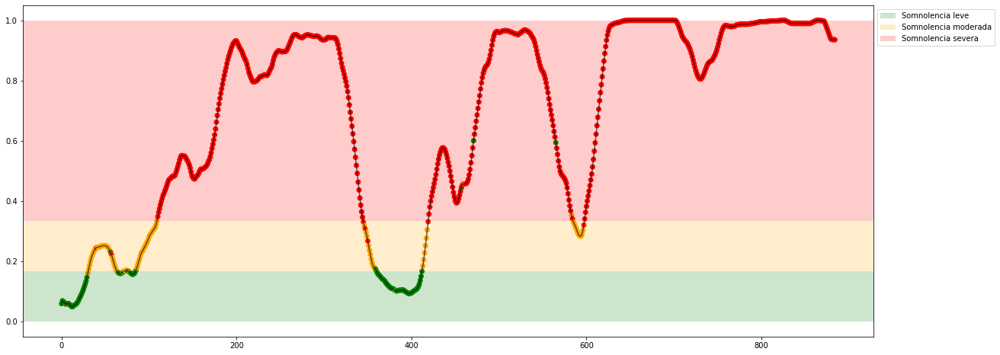

Experiment: 17_20150925_noon


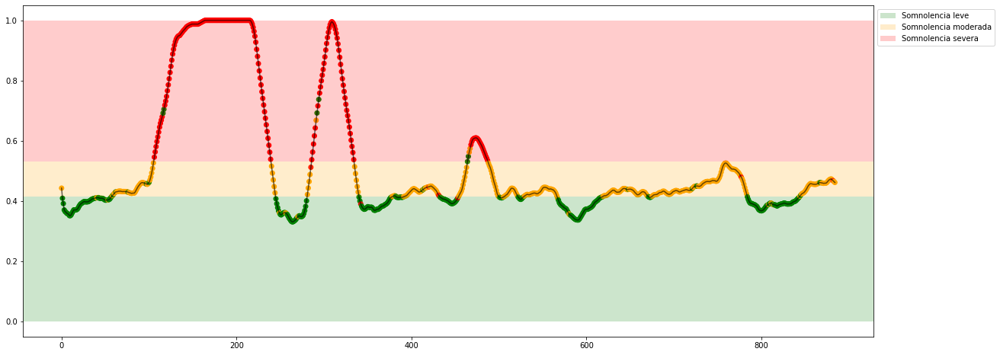

Experiment: 18_20150926_noon


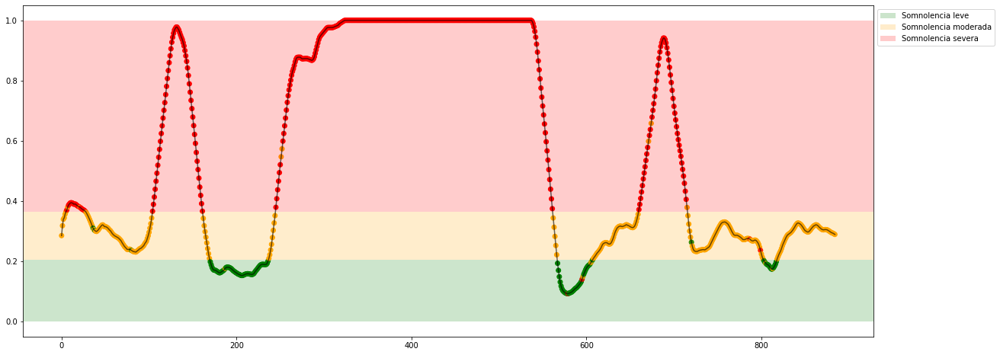

Experiment: 19_20151114_noon


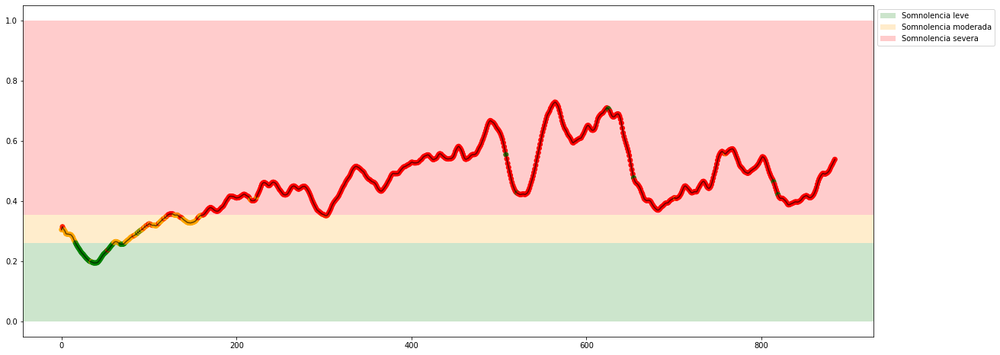

Experiment: 20_20151129_night


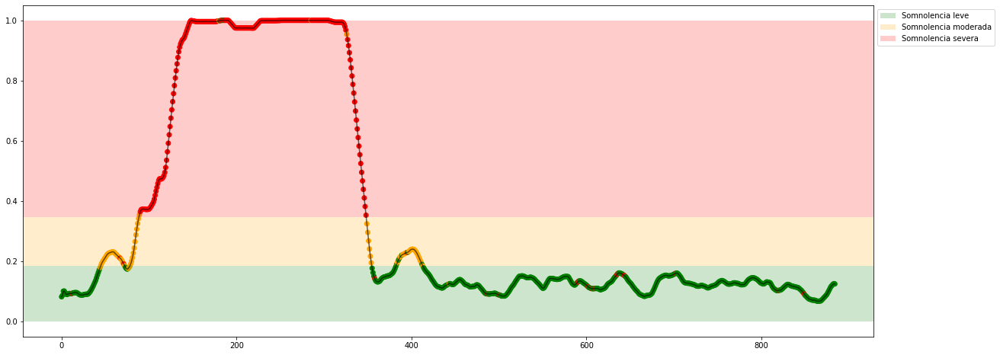

Experiment: 21_20151016_noon


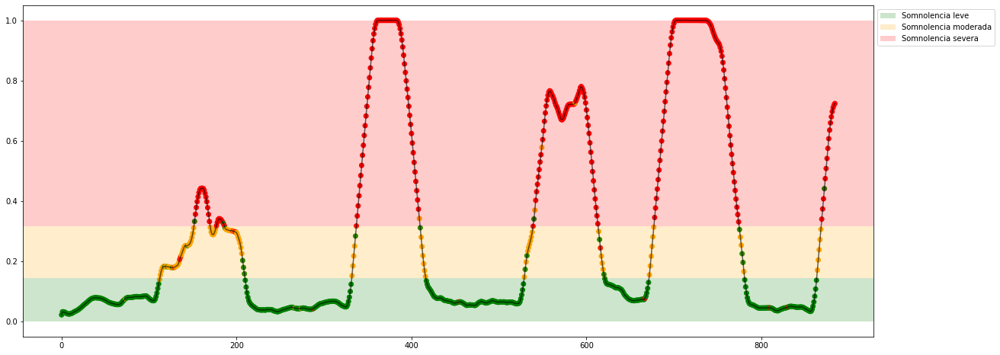

In [67]:
for key in X_all:
    data = X_all[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(general_model.predict(data), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

### Random Forest PSD + EOG

Experiment: Modelo General Random Forest PSD + EOG
Best Model:
	Score: 0.7798
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 80.49%
	Precision: 0.7716
	Recall: 0.7590
	f1: 0.7647
Matriz de confusión para X completo


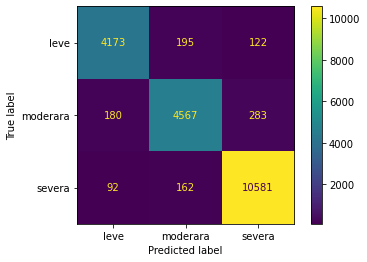

In [68]:
print(f"Experiment: Modelo General Random Forest PSD + EOG")
model = RandomForestClassifier(random_state=42, n_jobs=-1)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['n_estimators'] = randint(75, 200)
space['criterion'] = ["gini", "entropy"]
space['max_depth'] = randint(75, 150)
space['min_samples_split'] = randint(2, 10)
space['min_samples_leaf'] = randint(1, 10)
# space['min_weight_fraction_leaf'] = uniform(0, 0.5)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['max_leaf_nodes'] = randint(1, 300)
# space['min_impurity_decrease'] = uniform(0, 5)
#space['bootstrap'] = [True, False]
# space['oob_score'] = [True, False]
space['warm_start'] = [True, False]
# space['class_weight'] = ['balanced', 'balanced_subsample']
#space['ccp_alpha'] = uniform(0, 5)
#space['max_samples'] = uniform(0, 1)

general_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_eog, y_class, model, space, cv=cv,  n_iter=20)

In [69]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = general_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

psd_alpha: 0.2093
psd_theta: 0.1719
psd_delta: 0.1666
psd_gamma: 0.1599
psd_betha: 0.1486
n_parpadeos: 0.1437


Experiment: 1_20151124_noon_2


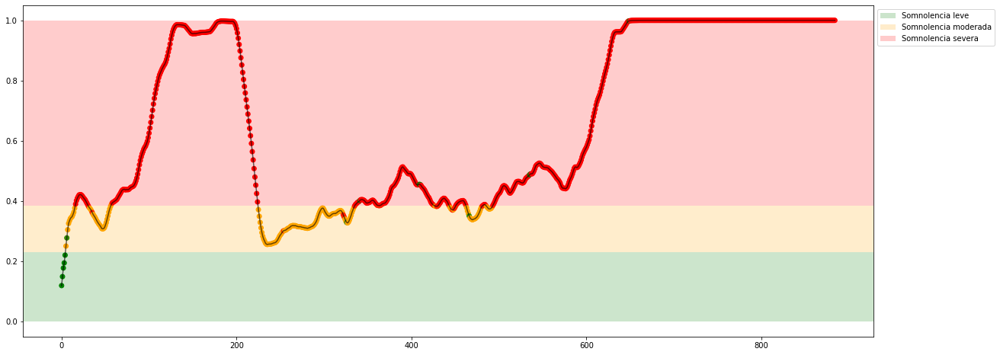

Experiment: 2_20151106_noon


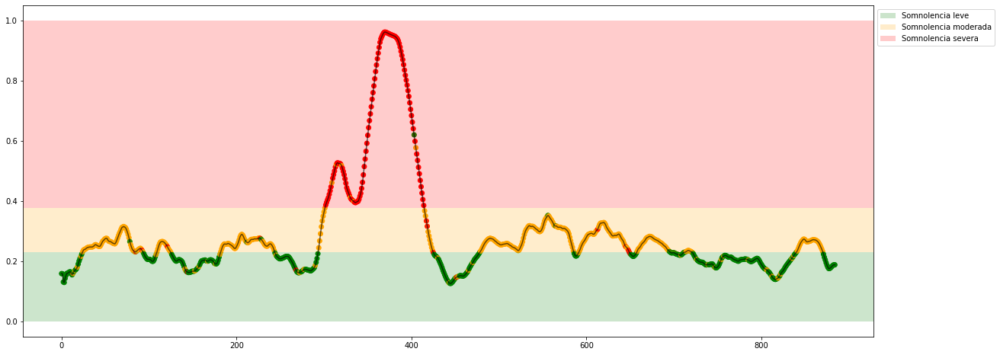

Experiment: 3_20151024_noon


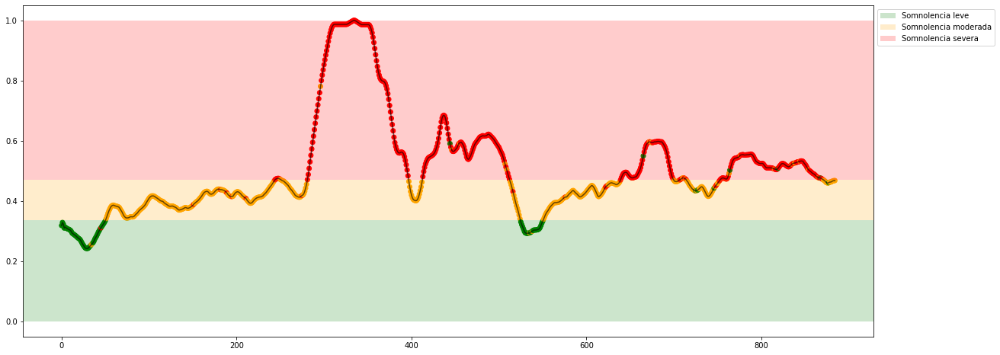

Experiment: 4_20151105_noon


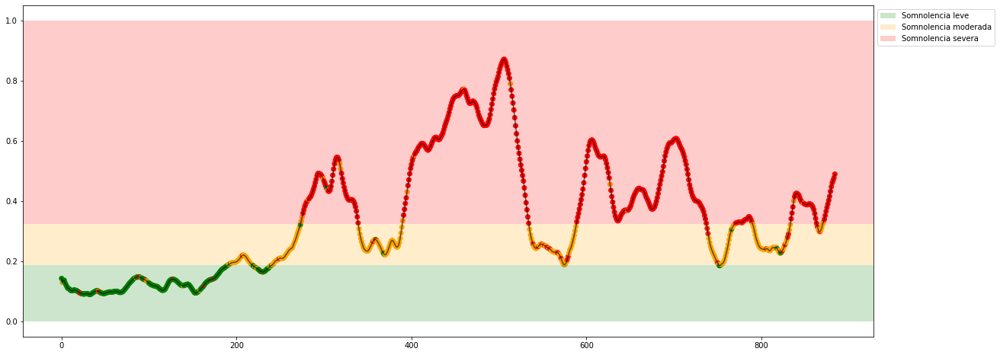

Experiment: 4_20151107_noon


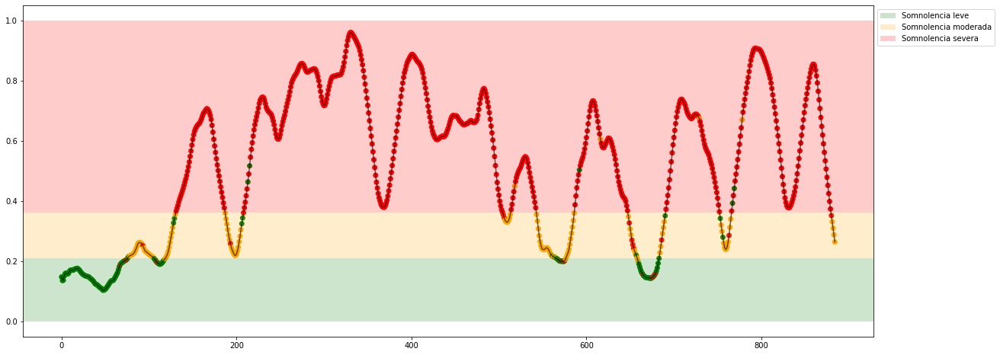

Experiment: 5_20141108_noon


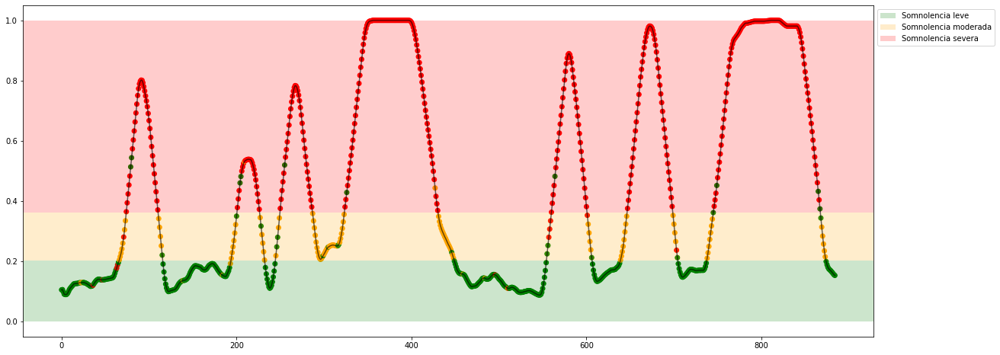

Experiment: 5_20151012_night


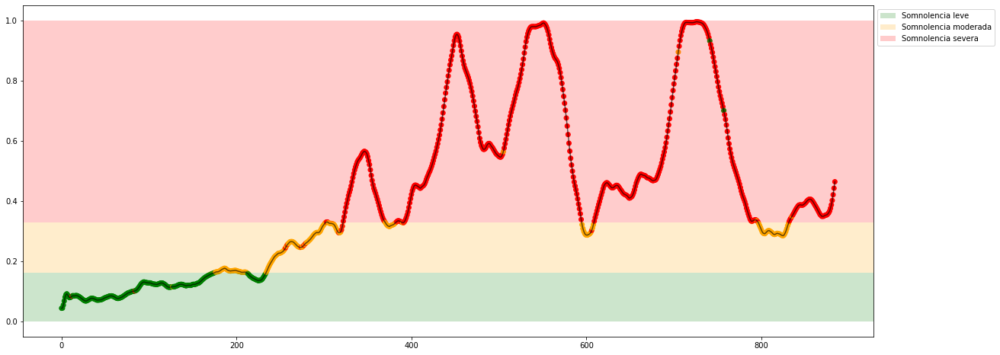

Experiment: 6_20151121_noon


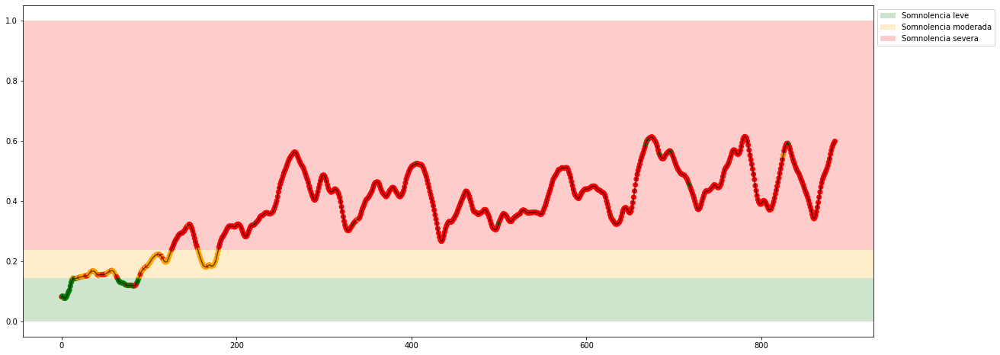

Experiment: 7_20151015_night


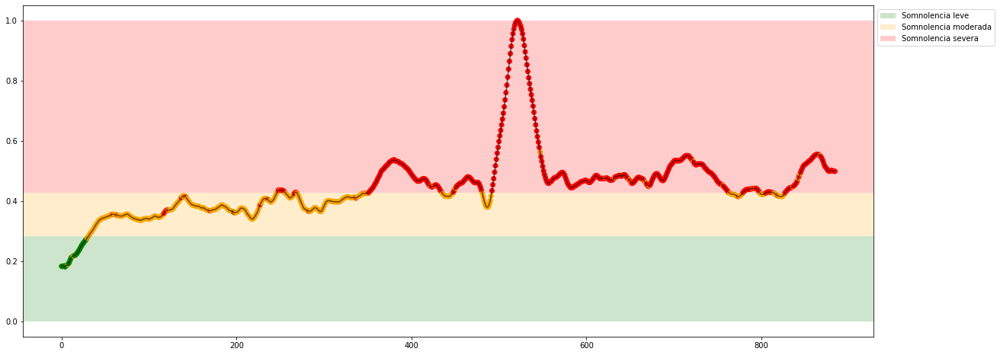

Experiment: 8_20151022_noon


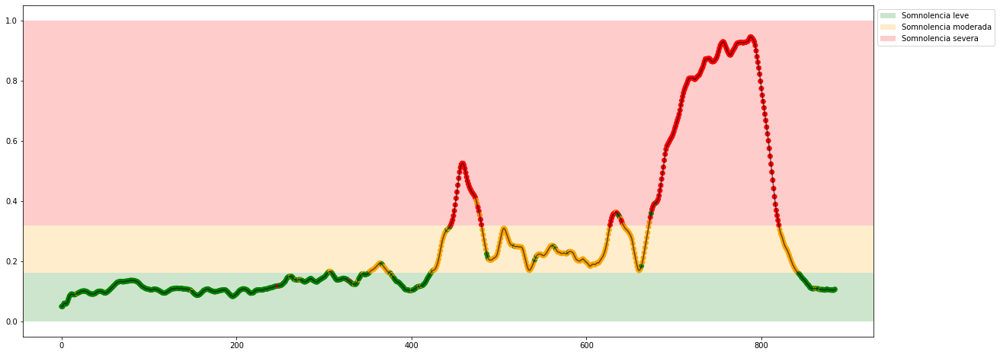

Experiment: 9_20151017_night


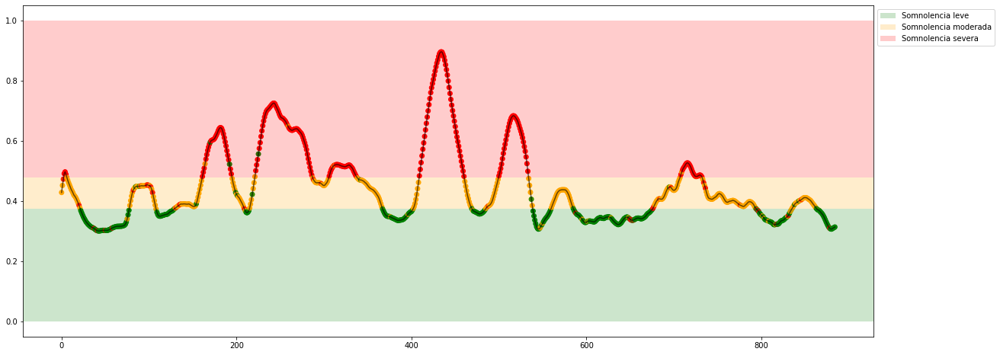

Experiment: 10_20151125_noon


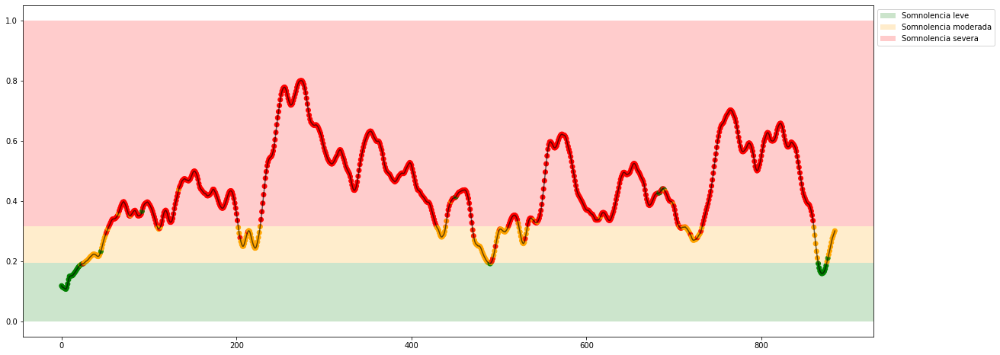

Experiment: 11_20151024_night


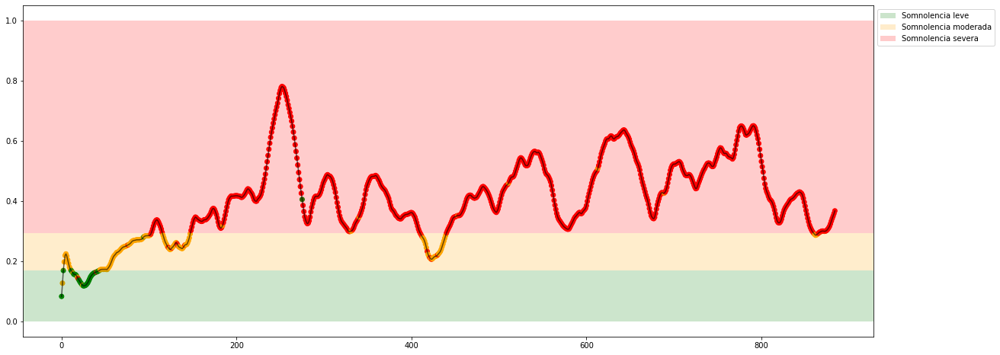

Experiment: 12_20150928_noon


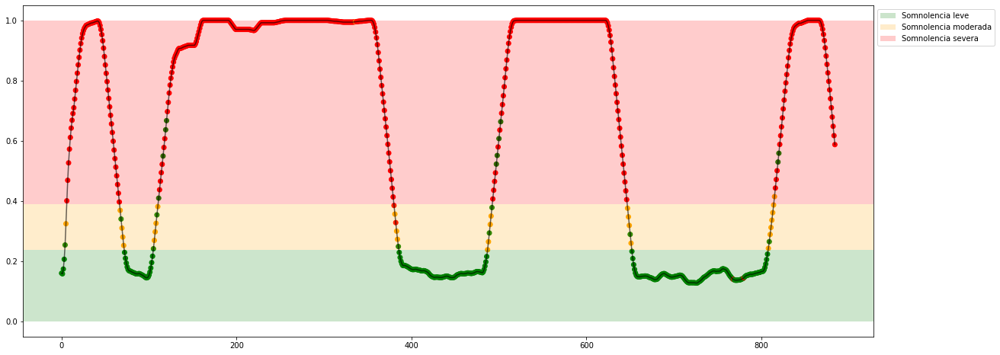

Experiment: 13_20150929_noon


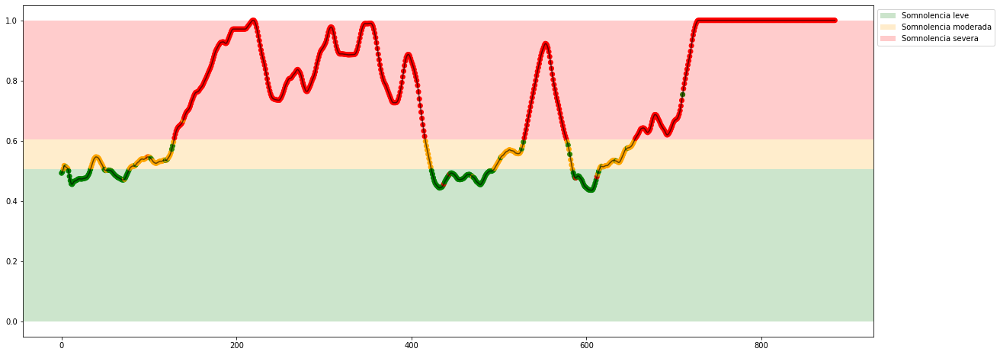

Experiment: 14_20151014_night


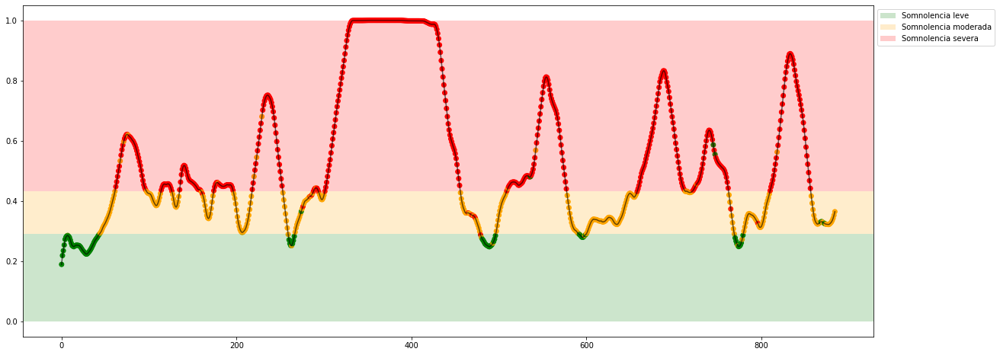

Experiment: 15_20151126_night


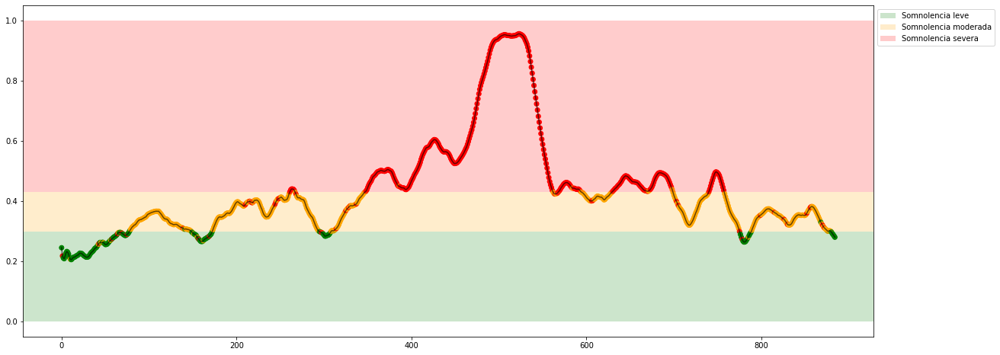

Experiment: 16_20151128_night


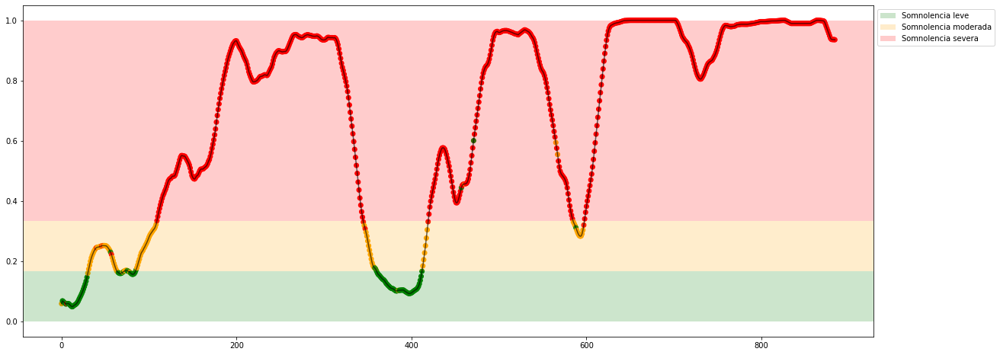

Experiment: 17_20150925_noon


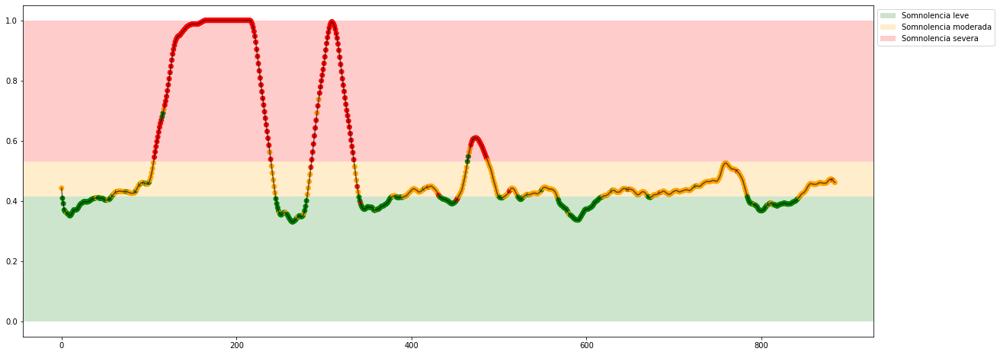

Experiment: 18_20150926_noon


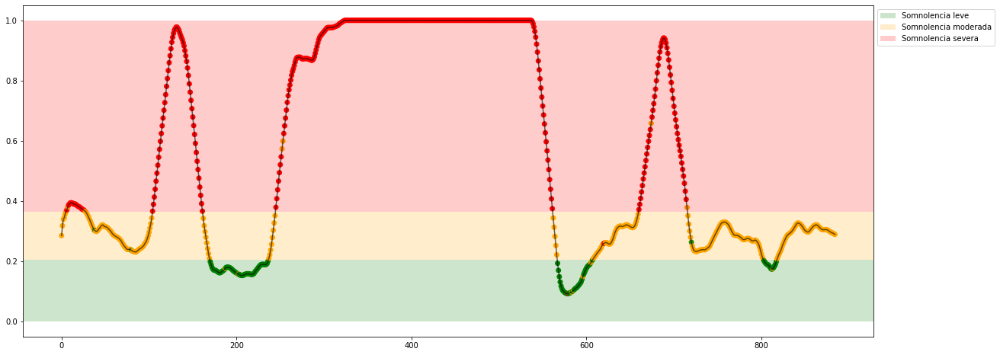

Experiment: 19_20151114_noon


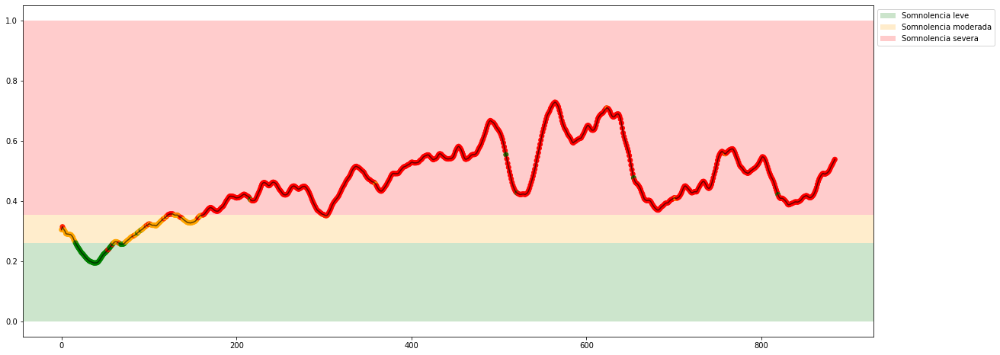

Experiment: 20_20151129_night


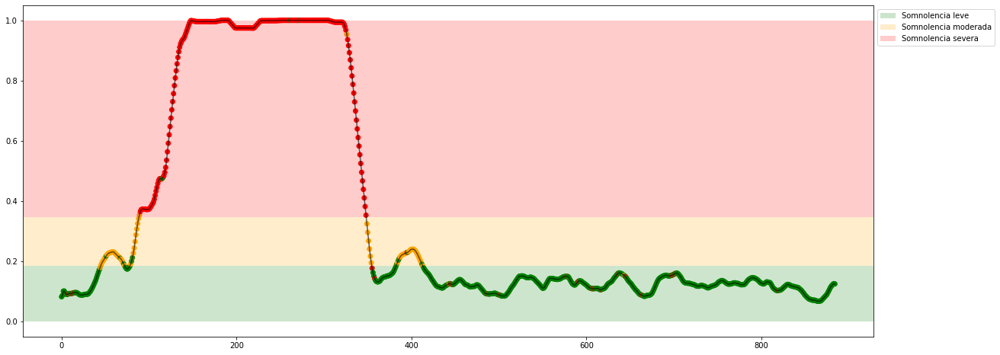

Experiment: 21_20151016_noon


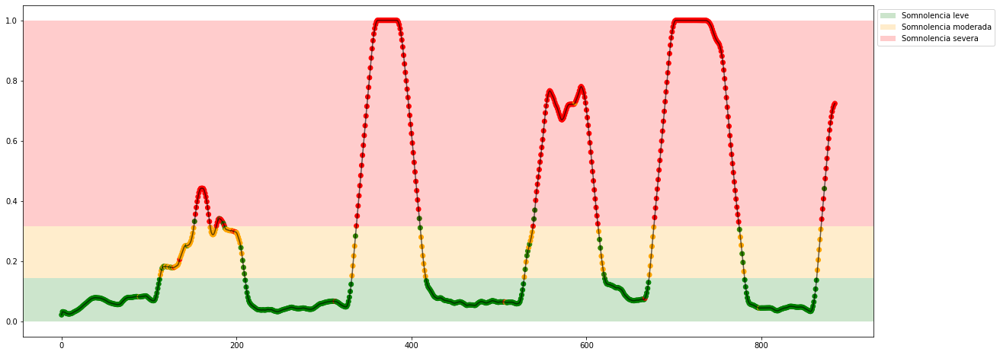

In [70]:
for key in X_all:
    data = X_all_eog[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(general_model.predict(data), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

# Modelo 90-10
- 21/23 = ~9%
- 2/23 = ~10%X_eog

In [59]:
# Separamos 2 experimentos para hacer las pruebas
subset_train, subset_test = train_test_split(features_files, test_size=2, random_state=77)

X_sub = []
X_sub_eog = []
X_sub_eeg = []
y_sub = []
y_sub_class = []

for key in subset_train:
    X_sub.append(X_all[key[:-4]])
    X_sub_eog.append(X_all_eog[key[:-4]])
    aux, aux2 = read_features(f'./features/{key[:-4]}.csv')
    aux_minmax = scaler.fit_transform(aux)
    X_sub_eeg.append(aux_minmax)
    
    y_sub.append(y_all[key[:-4]])
    y_sub_class.append(y_all_class[key[:-4]])

X_sub = np.array(X_sub)
X_sub = X_sub.reshape((X_sub.shape[0]*X_sub.shape[1], X_sub.shape[2]))
X_sub_eog = np.array(X_sub_eog)
X_sub_eog = X_sub_eog.reshape((X_sub_eog.shape[0]*X_sub_eog.shape[1], X_sub_eog.shape[2]))
X_sub_eeg = np.array(X_sub_eeg)
X_sub_eeg = X_sub_eeg.reshape((X_sub_eeg.shape[0]*X_sub_eeg.shape[1], X_sub_eeg.shape[2]))

y_sub = np.array(y_sub)
y_sub = y_sub.reshape((y_sub.shape[0]*y_sub.shape[1]))
y_sub_class = np.array(y_sub_class)
y_sub_class = y_sub_class.reshape((y_sub_class.shape[0]*y_sub_class.shape[1]))

In [60]:
print(f'{X_sub.shape}, {X_sub_eog.shape}, {X_sub_eeg.shape}, {y_sub.shape}, {y_sub_class.shape}')

(18585, 5), (18585, 6), (18585, 136), (18585,), (18585,)


## SMV-c

In [79]:
from sklearn.svm import SVC

### SMV-c PSD

Experiment: Modelo 90-10 SVM-c PSD
Best Model:
	Score: 0.6131
	Hyperparameters: {'C': 4.636499344142012, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 61.78%
	Precision: 0.5594
	Recall: 0.4862
	f1: 0.4915
Matriz de confusión para X completo


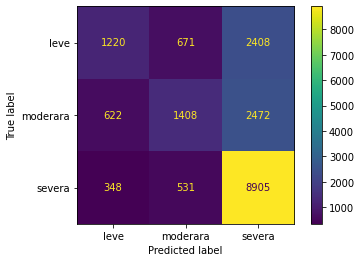

In [87]:
print(f"Experiment: Modelo 90-10 SVM-c PSD")
model = SVC(random_state=42)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['C'] = uniform(1, 20)
space['kernel'] = ['linear', 'rbf']
space['gamma'] = ['scale', 'auto']
space['shrinking'] = [True, False]
space['probability'] = [True, False]
space['decision_function_shape'] = ['ovo', 'ovr']

partial_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_sub, y_sub_class, model, space, cv=cv,  n_iter=10)

Experiment: 13_20150929_noon


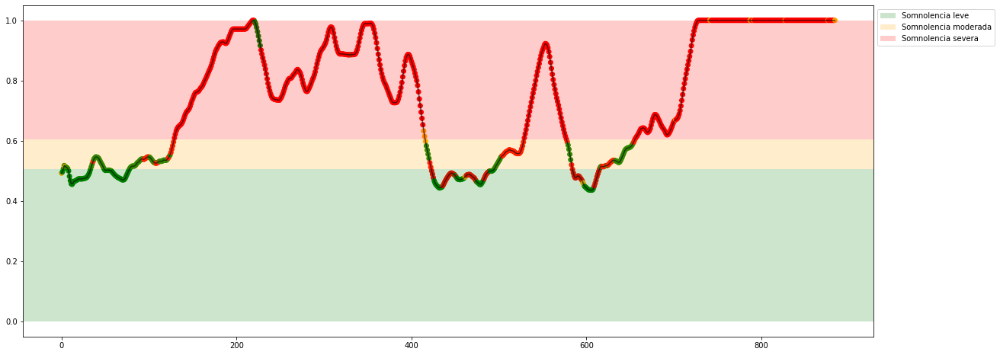

Experiment: 7_20151015_night


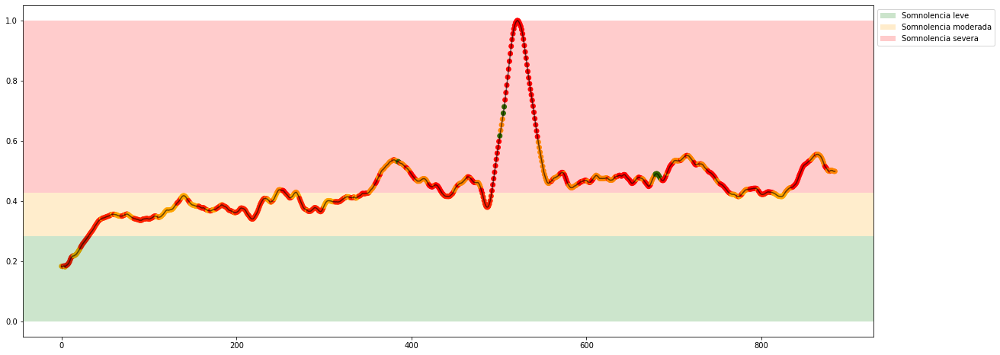

In [88]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(partial_model.predict(data), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

### SMV-r PSD + EOG

Experiment: Modelo 90-10 SVM-r PSD + EOG
Best Model:
	Score: 0.6177
	Hyperparameters: {'C': 4.636499344142012, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 63.07%
	Precision: 0.5663
	Recall: 0.5243
	f1: 0.5323
Matriz de confusión para X completo


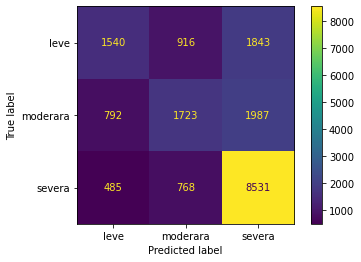

In [89]:
print(f"Experiment: Modelo 90-10 SVM-r PSD + EOG")
model = SVC(random_state=42)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['C'] = uniform(1, 20)
space['kernel'] = ['linear', 'rbf']
space['gamma'] = ['scale', 'auto']
space['shrinking'] = [True, False]
space['probability'] = [True, False]
space['decision_function_shape'] = ['ovo', 'ovr']

partial_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_sub_eog, y_sub_class, model, space, cv=cv,  n_iter=10)

Experiment: 13_20150929_noon


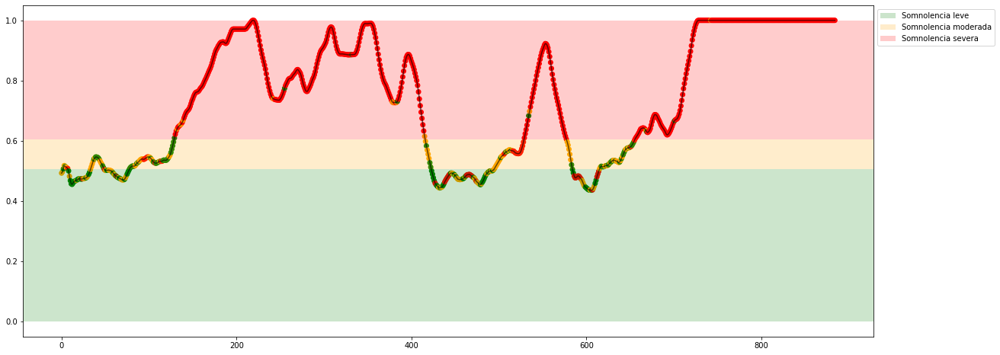

Experiment: 7_20151015_night


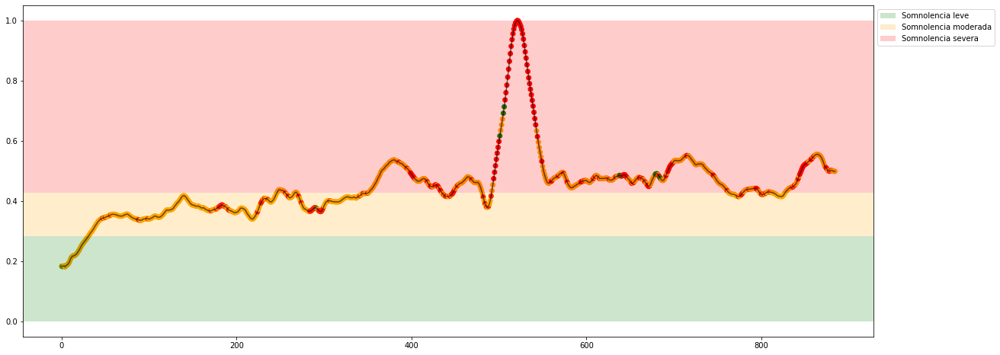

In [90]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all_eog[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(partial_model.predict(data), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

## KNN

In [57]:
from sklearn.neighbors import KNeighborsClassifier

### KNN PSD

Experiment: Modelo 90-10 KNN PSD
Best Model:
	Score: 0.7722
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 15, 'n_neighbors': 9, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 79.99%
	Precision: 0.7669
	Recall: 0.7683
	f1: 0.7676
Matriz de confusión para X completo


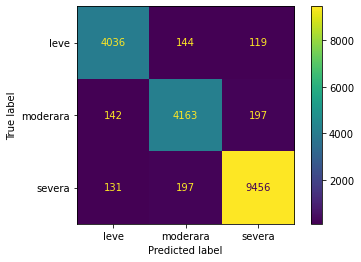

In [61]:
print(f"Experiment: Modelo 90-10 KNN PSD")
model = KNeighborsClassifier()

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['n_neighbors'] = randint(3, 21)
space['weights'] = ['uniform', 'distance']
space['algorithm'] = ['auto', 'ball_tree', 'kd_tree', 'brute']
space['leaf_size'] = randint(15,50)
space['p'] = [1, 2]

partial_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_sub, y_sub_class, model, space, cv=cv,  n_iter=20)

Experiment: 13_20150929_noon


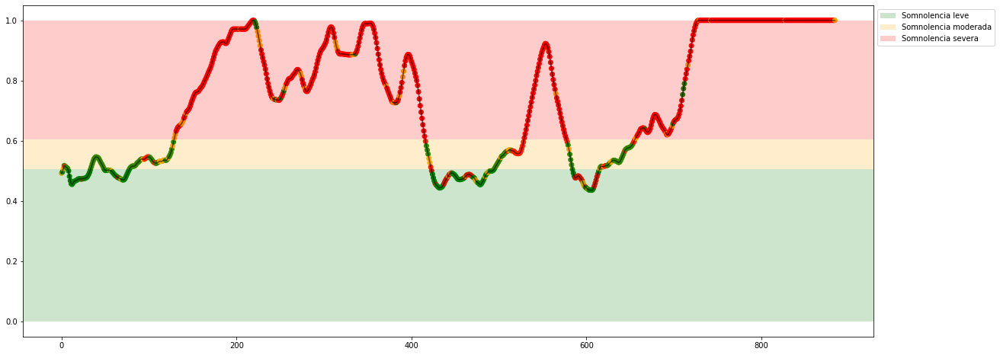

Experiment: 7_20151015_night


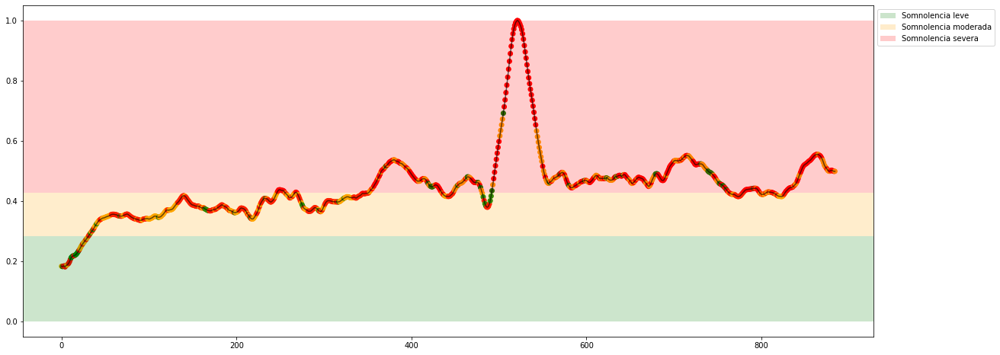

In [63]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(partial_model.predict(data), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

### KNN PSD + EOG

Experiment: Modelo 90-10 KNN PSD+EOG
Best Model:
	Score: 0.7237
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 15, 'n_neighbors': 9, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 74.07%
	Precision: 0.6941
	Recall: 0.6913
	f1: 0.6926
Matriz de confusión para X completo


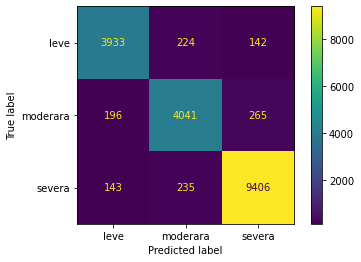

In [71]:
print(f"Experiment: Modelo 90-10 KNN PSD+EOG")
model = KNeighborsClassifier()

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['n_neighbors'] = randint(3, 21)
space['weights'] = ['uniform', 'distance']
space['algorithm'] = ['auto', 'ball_tree', 'kd_tree', 'brute']
space['leaf_size'] = randint(15,50)
space['p'] = [1, 2]

partial_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_sub_eog, y_sub_class, model, space, cv=cv,  n_iter=20)

Experiment: 13_20150929_noon


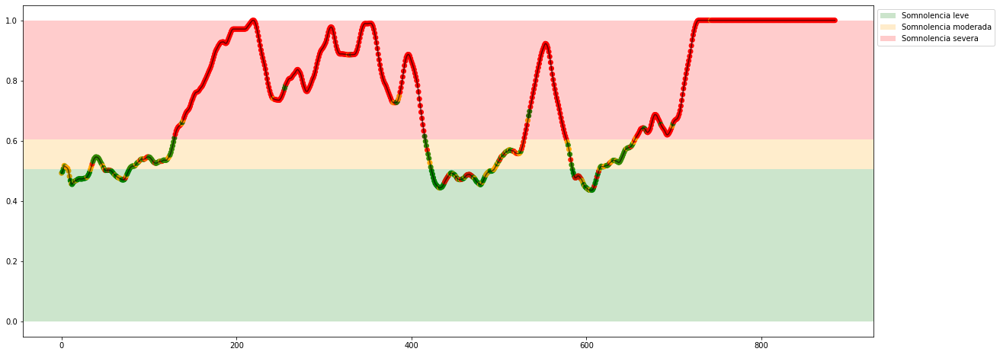

Experiment: 7_20151015_night


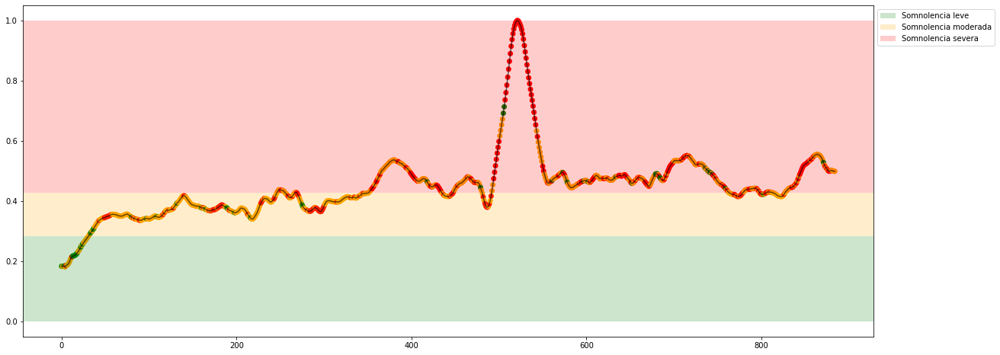

In [72]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all_eog[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(partial_model.predict(data), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

## Decision Tree

In [82]:
from sklearn.tree import DecisionTreeClassifier

### Decision Tree PSD

Experiment: Modelo 90-10 Decision Tree PSD
Best Model:
	Score: 0.7238
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 93, 'max_features': 'log2', 'min_samples_split': 2, 'splitter': 'best'}

Results with X_test:
	Accuracy: 73.96%
	Precision: 0.6974
	Recall: 0.7021
	f1: 0.6996
Matriz de confusión para X completo


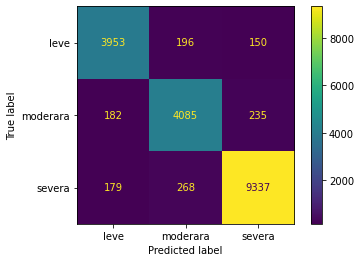

In [91]:
print(f"Experiment: Modelo 90-10 Decision Tree PSD")
model = DecisionTreeClassifier(random_state=42)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['criterion'] = ["gini", "entropy"]
space['splitter'] = ["best", "random"]
space['max_depth'] = randint(5, 100)
space['min_samples_split'] = randint(2, 10)
#space['min_samples_leaf'] = randint(1, 10)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['ccp_alpha'] = uniform(0, 5) # empeora el ponerlo, el mejor valor es 0.0

partial_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_sub, y_sub_class, model, space, cv=cv,  n_iter=100)

In [92]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = partial_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

psd_alpha: 0.2262
psd_delta: 0.2165
psd_theta: 0.1935
psd_gamma: 0.1892
psd_betha: 0.1745


Experiment: 13_20150929_noon


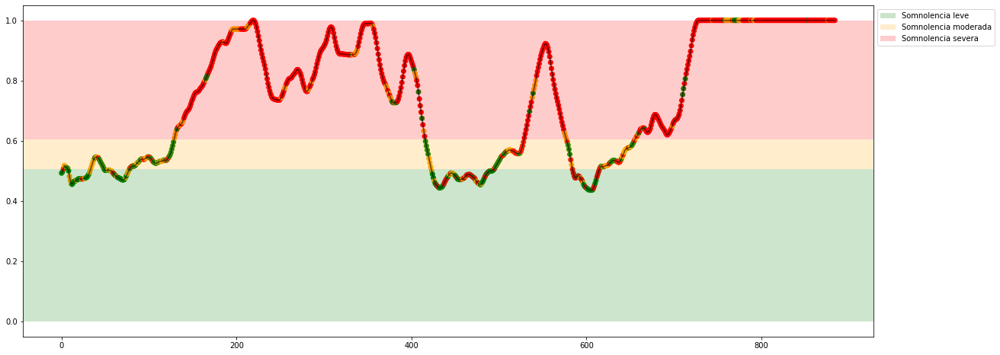

Experiment: 7_20151015_night


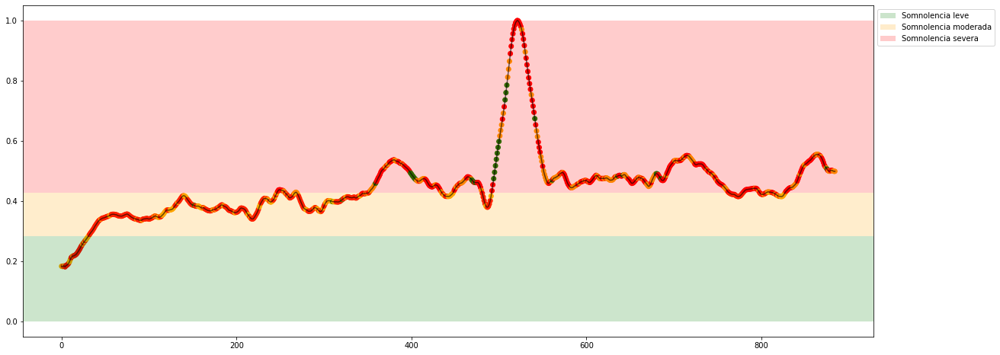

In [93]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(partial_model.predict(data), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

### Decision Tree PSD + EOG

Experiment: Modelo 90-10 Decision Tree PSD
Best Model:
	Score: 0.6927
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 93, 'max_features': 'log2', 'min_samples_split': 2, 'splitter': 'best'}

Results with X_test:
	Accuracy: 70.65%
	Precision: 0.6607
	Recall: 0.6651
	f1: 0.6625
Matriz de confusión para X completo


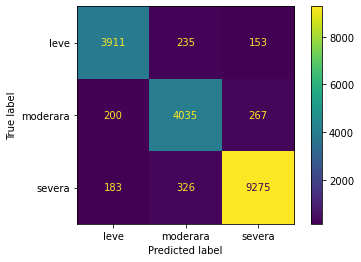

In [94]:
print(f"Experiment: Modelo 90-10 Decision Tree PSD")
model = DecisionTreeClassifier(random_state=42)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['criterion'] = ["gini", "entropy"]
space['splitter'] = ["best", "random"]
space['max_depth'] = randint(5, 100)
space['min_samples_split'] = randint(2, 10)
#space['min_samples_leaf'] = randint(1, 10)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['ccp_alpha'] = uniform(0, 5) # empeora el ponerlo, el mejor valor es 0.0

partial_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_sub_eog, y_sub_class, model, space, cv=cv,  n_iter=100)

In [95]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = partial_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

psd_alpha: 0.2262
psd_theta: 0.1715
psd_delta: 0.1641
psd_gamma: 0.1625
psd_betha: 0.1589
n_parpadeos: 0.1168


Experiment: 13_20150929_noon


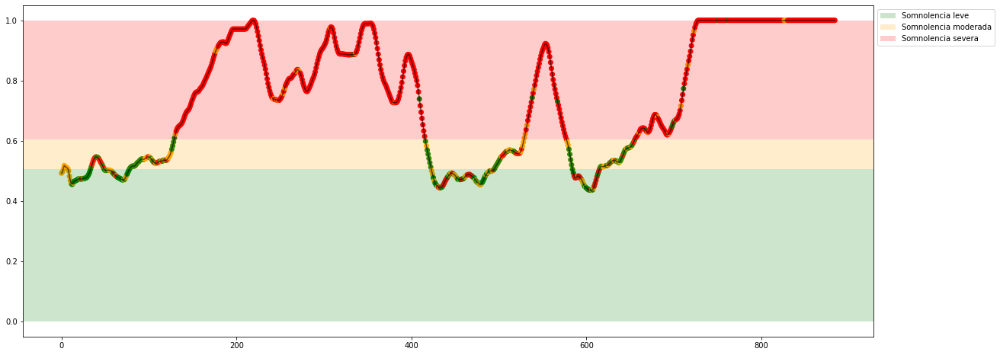

Experiment: 7_20151015_night


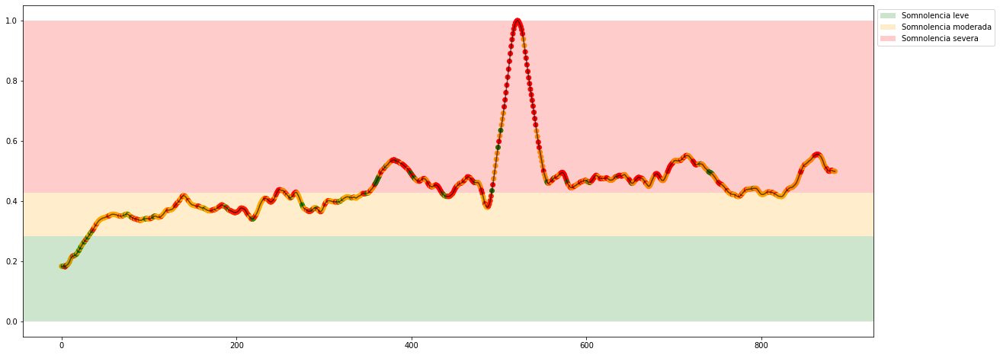

In [96]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all_eog[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(partial_model.predict(data), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

## Random Forest

In [98]:
from sklearn.ensemble import RandomForestClassifier

### Random Forest PSD

Experiment: Modelo General Random Forest PSD
Best Model:
	Score: 0.8018
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 82.66%
	Precision: 0.7974
	Recall: 0.7896
	f1: 0.7932
Matriz de confusión para X completo


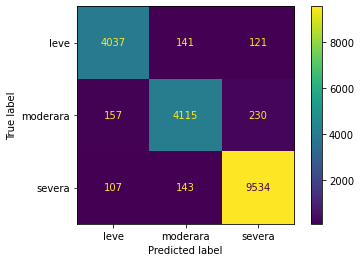

In [97]:
print(f"Experiment: Modelo 90-10 Random Forest PSD")
model = RandomForestClassifier(random_state=42, n_jobs=-1)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['n_estimators'] = randint(75, 200)
space['criterion'] = ["gini", "entropy"]
space['max_depth'] = randint(75, 150)
space['min_samples_split'] = randint(2, 10)
space['min_samples_leaf'] = randint(1, 10)
# space['min_weight_fraction_leaf'] = uniform(0, 0.5)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['max_leaf_nodes'] = randint(1, 300)
# space['min_impurity_decrease'] = uniform(0, 5)
#space['bootstrap'] = [True, False]
# space['oob_score'] = [True, False]
space['warm_start'] = [True, False]
# space['class_weight'] = ['balanced', 'balanced_subsample']
#space['ccp_alpha'] = uniform(0, 5)
#space['max_samples'] = uniform(0, 1)

partial_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_sub, y_sub_class, model, space, cv=cv,  n_iter=20)

In [99]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = partial_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

psd_alpha: 0.2434
psd_gamma: 0.1974
psd_delta: 0.1955
psd_theta: 0.1928
psd_betha: 0.1709


Experiment: 13_20150929_noon


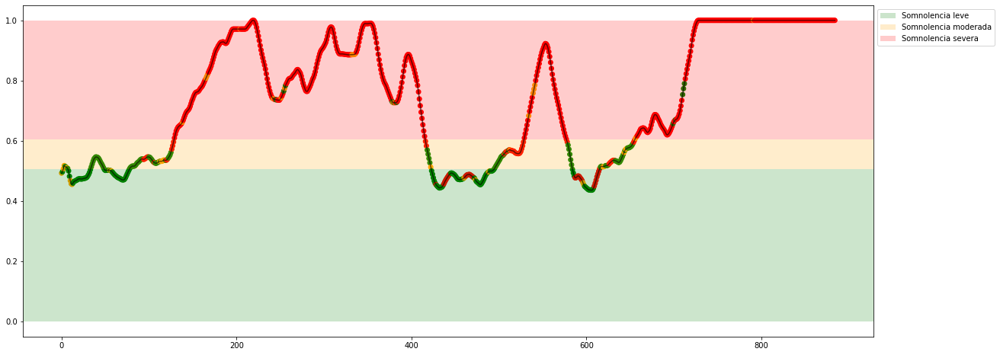

Experiment: 7_20151015_night


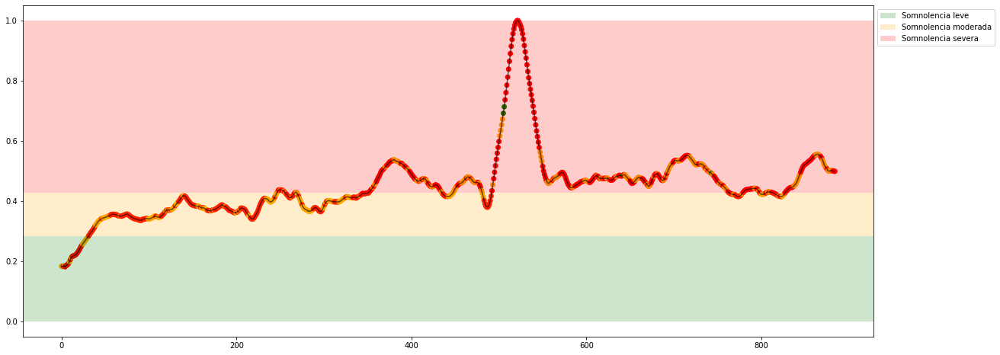

In [100]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    colors = map_2_colors(partial_model.predict(data), labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

### Random Forest PSD + EOG

Experiment: Modelo General Random Forest PSD
Best Model:
	Score: 0.7855
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 80.53%
	Precision: 0.7711
	Recall: 0.7612
	f1: 0.7655
Matriz de confusión para X completo


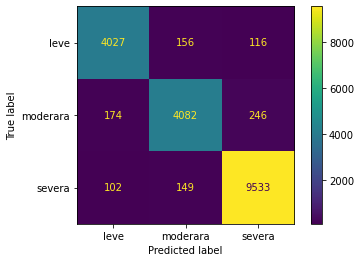

In [101]:
print(f"Experiment: Modelo General Random Forest PSD")
model = RandomForestClassifier(random_state=42, n_jobs=-1)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['n_estimators'] = randint(75, 200)
space['criterion'] = ["gini", "entropy"]
space['max_depth'] = randint(75, 150)
space['min_samples_split'] = randint(2, 10)
space['min_samples_leaf'] = randint(1, 10)
# space['min_weight_fraction_leaf'] = uniform(0, 0.5)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['max_leaf_nodes'] = randint(1, 300)
# space['min_impurity_decrease'] = uniform(0, 5)
#space['bootstrap'] = [True, False]
# space['oob_score'] = [True, False]
space['warm_start'] = [True, False]
# space['class_weight'] = ['balanced', 'balanced_subsample']
#space['ccp_alpha'] = uniform(0, 5)
#space['max_samples'] = uniform(0, 1)

partial_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_sub_eog, y_sub_class, model, space, cv=cv,  n_iter=20)

In [102]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = partial_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

psd_alpha: 0.2101
psd_theta: 0.1724
psd_delta: 0.1681
psd_gamma: 0.1590
psd_betha: 0.1489
n_parpadeos: 0.1414


Experiment: 13_20150929_noon
	Accuracy: 73.33%
	Precision: 0.5263
	Recall: 0.5576
	f1: 0.5262


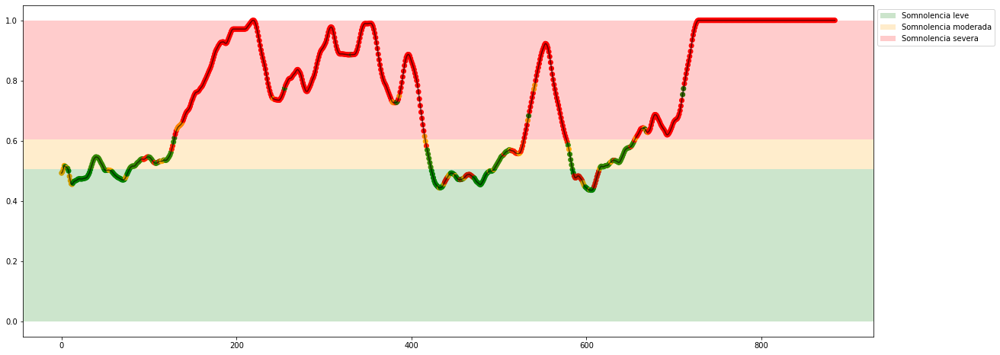

Experiment: 7_20151015_night
	Accuracy: 49.83%
	Precision: 0.3724
	Recall: 0.3687
	f1: 0.3271


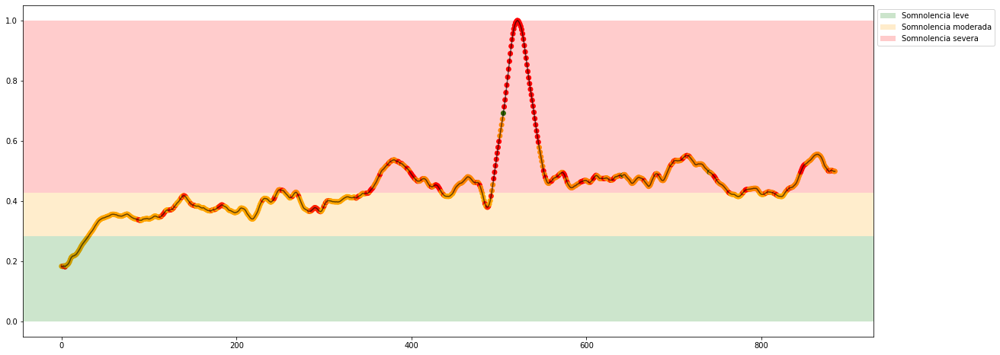

In [104]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all_eog[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    
    predictions = partial_model.predict(data)
    acc = accuracy_score(expected, predictions)
    pre = precision_score(expected, predictions, average='macro', zero_division=1)
    rec = recall_score(expected, predictions, average='macro', zero_division=1)
    f1 = f1_score(expected, predictions, average='macro', zero_division=1)
    print(f"\tAccuracy: {acc*100:.2f}%")
    print(f"\tPrecision: {pre:.4f}")
    print(f"\tRecall: {rec:.4f}")
    print(f"\tf1: {f1:.4f}")
    
    colors = map_2_colors(predictions, labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

# Modelo 70-30
- 16/23 = ~70%
- 7/23 = ~30%X_all_eog

In [106]:
# Separamos 2 experimentos para hacer las pruebas
subset_train, subset_test = train_test_split(features_files, test_size=7, random_state=77)

X_sub = []
X_sub_eog = []
X_sub_eeg = []
y_sub = []
y_sub_class = []

for key in subset_train:
    X_sub.append(X_all[key[:-4]])
    X_sub_eog.append(X_all_eog[key[:-4]])
    aux, aux2 = read_features(f'./features/{key[:-4]}.csv')
    aux_minmax = scaler.fit_transform(aux)
    X_sub_eeg.append(aux_minmax)
    
    y_sub.append(y_all[key[:-4]])
    y_sub_class.append(y_all_class[key[:-4]])

X_sub = np.array(X_sub)
X_sub = X_sub.reshape((X_sub.shape[0]*X_sub.shape[1], X_sub.shape[2]))
X_sub_eog = np.array(X_sub_eog)
X_sub_eog = X_sub_eog.reshape((X_sub_eog.shape[0]*X_sub_eog.shape[1], X_sub_eog.shape[2]))
X_sub_eeg = np.array(X_sub_eeg)
X_sub_eeg = X_sub_eeg.reshape((X_sub_eeg.shape[0]*X_sub_eeg.shape[1], X_sub_eeg.shape[2]))

y_sub = np.array(y_sub)
y_sub = y_sub.reshape((y_sub.shape[0]*y_sub.shape[1]))
y_sub_class = np.array(y_sub_class)
y_sub_class = y_sub_class.reshape((y_sub_class.shape[0]*y_sub_class.shape[1]))

In [107]:
print(f'{X_sub.shape}, {X_sub_eog.shape}, {X_sub_eeg.shape}, {y_sub.shape}, {y_sub_class.shape}')

(14160, 5), (14160, 6), (14160, 136), (14160,), (14160,)


## SMV-c

In [105]:
from sklearn.svm import SVC

### SMV-c PSD

Experiment: Modelo 70-30 SVM-r PSD
Best Model:
	Score: 0.6676
	Hyperparameters: {'C': 4.636499344142012, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 66.86%
	Precision: 0.6382
	Recall: 0.4942
	f1: 0.4978
Matriz de confusión para X completo


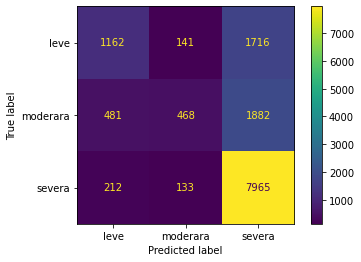

In [108]:
print(f"Experiment: Modelo 70-30 SVM-r PSD")
model = SVC(random_state=42)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['C'] = uniform(1, 20)
space['kernel'] = ['linear', 'rbf']
space['gamma'] = ['scale', 'auto']
space['shrinking'] = [True, False]
space['probability'] = [True, False]
space['decision_function_shape'] = ['ovo', 'ovr']

partial_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_sub, y_sub_class, model, space, cv=cv,  n_iter=10)

Experiment: 13_20150929_noon
	Accuracy: 71.86%
	Precision: 0.4293
	Recall: 0.5126
	f1: 0.4672


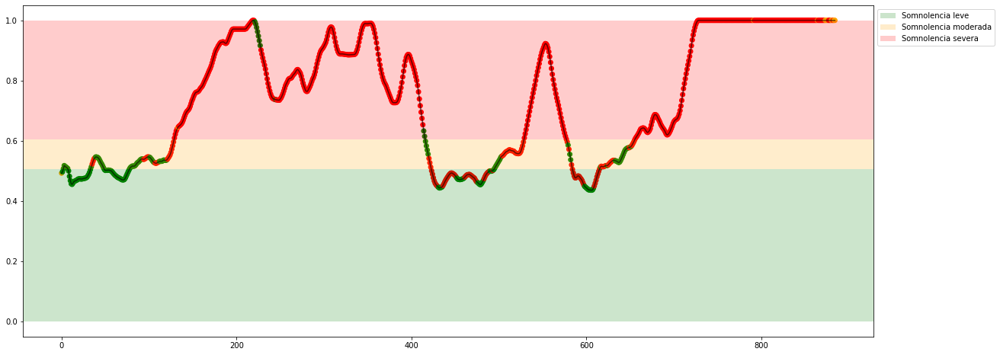

Experiment: 7_20151015_night
	Accuracy: 51.19%
	Precision: 0.4365
	Recall: 0.4722
	f1: 0.4412


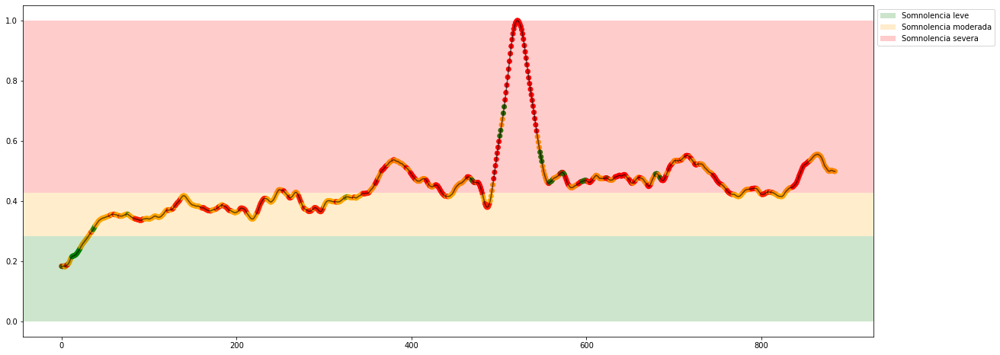

Experiment: 2_20151106_noon
	Accuracy: 16.95%
	Precision: 0.2502
	Recall: 0.3053
	f1: 0.1540


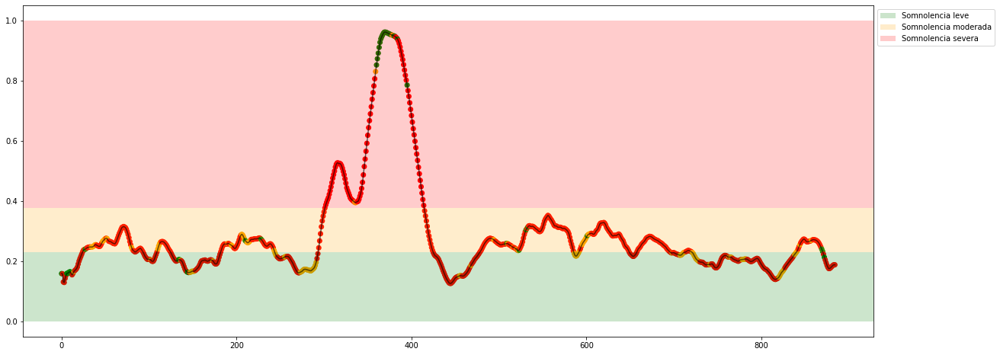

Experiment: 8_20151022_noon
	Accuracy: 24.18%
	Precision: 0.3222
	Recall: 0.3450
	f1: 0.1495


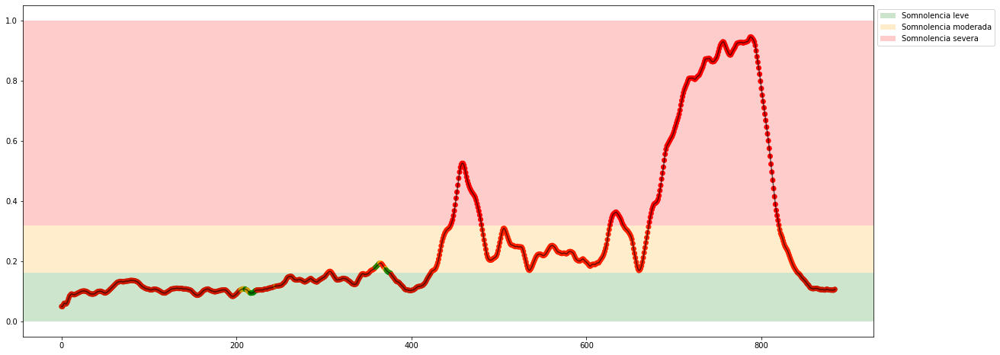

Experiment: 14_20151014_night
	Accuracy: 53.90%
	Precision: 0.4221
	Recall: 0.4981
	f1: 0.3740


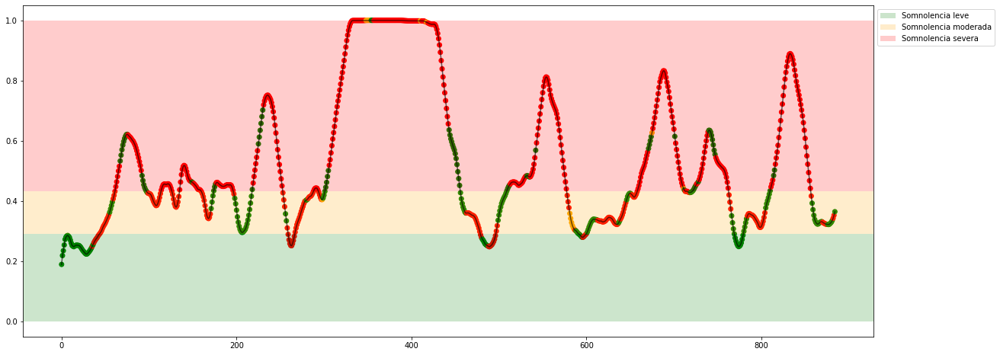

Experiment: 3_20151024_noon
	Accuracy: 28.81%
	Precision: 0.3576
	Recall: 0.3545
	f1: 0.2386


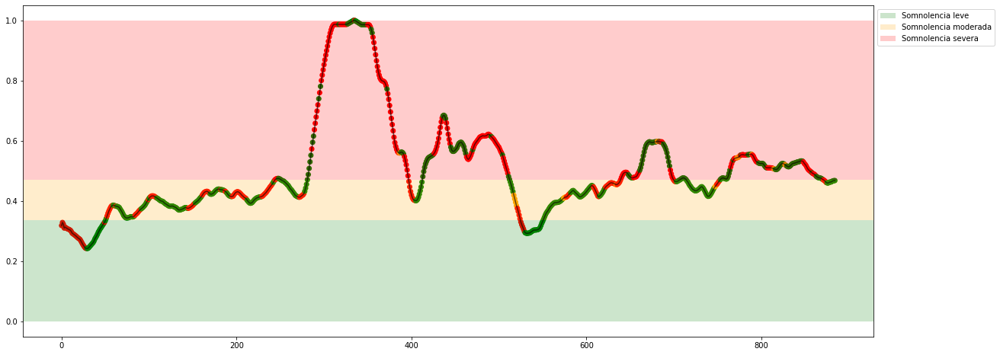

Experiment: 9_20151017_night
	Accuracy: 30.17%
	Precision: 0.4360
	Recall: 0.3541
	f1: 0.1988


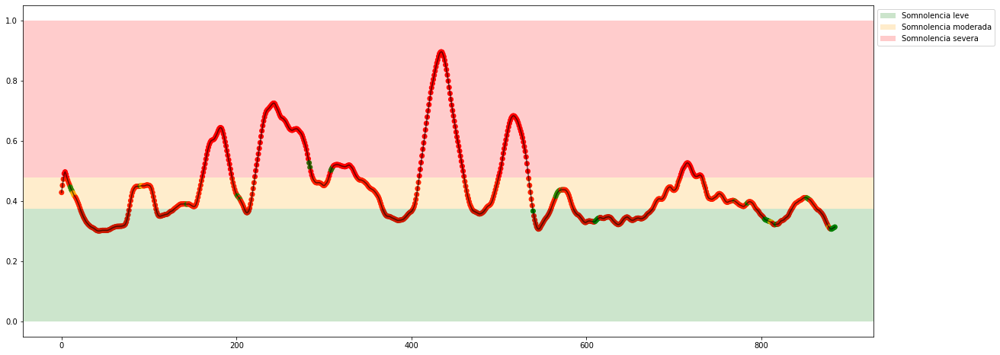

In [111]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    
    predictions = partial_model.predict(data)
    acc = accuracy_score(expected, predictions)
    pre = precision_score(expected, predictions, average='macro', zero_division=1)
    rec = recall_score(expected, predictions, average='macro', zero_division=1)
    f1 = f1_score(expected, predictions, average='macro', zero_division=1)
    print(f"\tAccuracy: {acc*100:.2f}%")
    print(f"\tPrecision: {pre:.4f}")
    print(f"\tRecall: {rec:.4f}")
    print(f"\tf1: {f1:.4f}")
    
    colors = map_2_colors(predictions, labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

### SMV-r PSD + EOG

Experiment: Modelo 70-30 SVM-r PSD+EOG
Best Model:
	Score: 0.6782
	Hyperparameters: {'C': 4.636499344142012, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 67.43%
	Precision: 0.6251
	Recall: 0.5151
	f1: 0.5123
Matriz de confusión para X completo


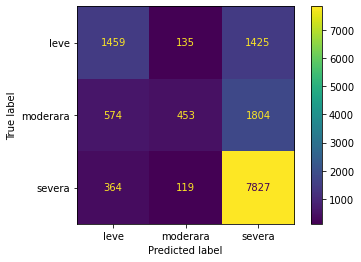

In [112]:
print(f"Experiment: Modelo 70-30 SVM-r PSD+EOG")
model = SVC(random_state=42)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['C'] = uniform(1, 20)
space['kernel'] = ['linear', 'rbf']
space['gamma'] = ['scale', 'auto']
space['shrinking'] = [True, False]
space['probability'] = [True, False]
space['decision_function_shape'] = ['ovo', 'ovr']

partial_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_sub_eog, y_sub_class, model, space, cv=cv,  n_iter=10)

Experiment: 13_20150929_noon
	Accuracy: 73.11%
	Precision: 0.4267
	Recall: 0.5266
	f1: 0.4698


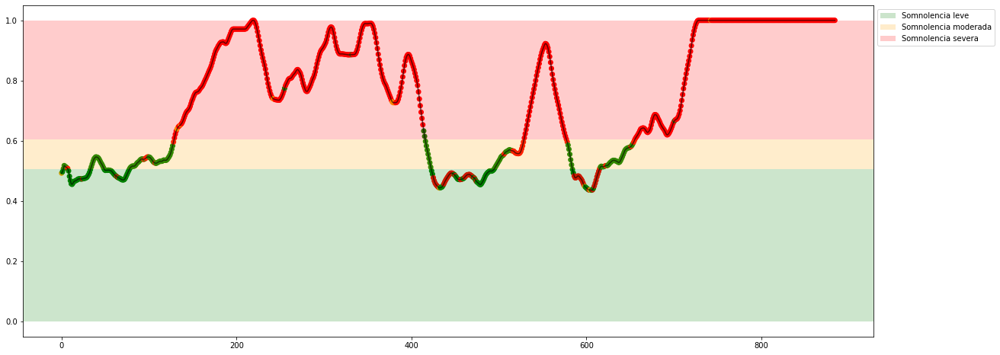

Experiment: 7_20151015_night
	Accuracy: 54.69%
	Precision: 0.4901
	Recall: 0.5179
	f1: 0.4616


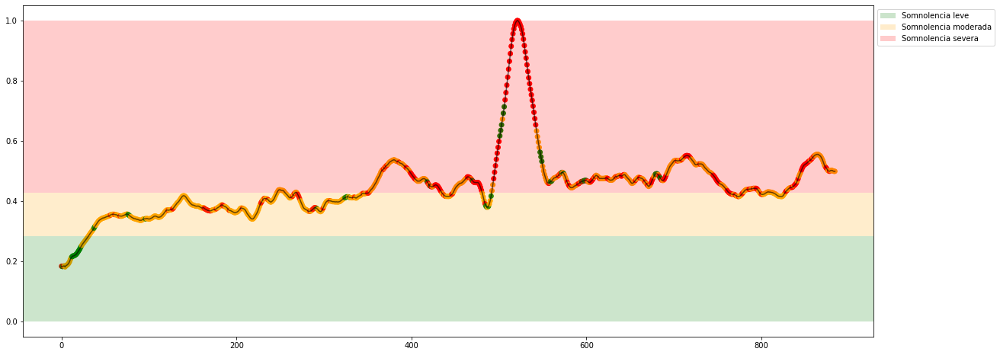

Experiment: 2_20151106_noon
	Accuracy: 21.69%
	Precision: 0.3739
	Recall: 0.3461
	f1: 0.2165


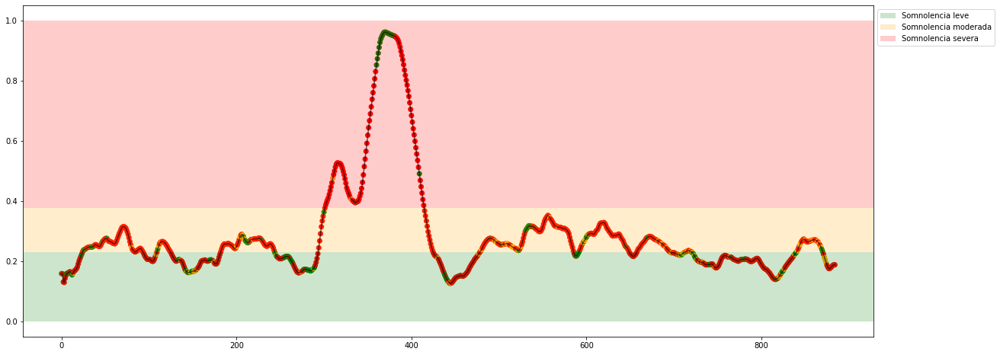

Experiment: 8_20151022_noon
	Accuracy: 23.84%
	Precision: 0.2666
	Recall: 0.3421
	f1: 0.1441


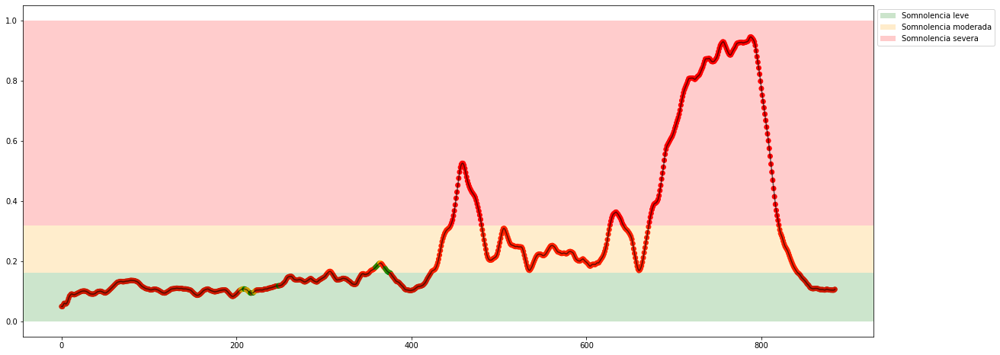

Experiment: 14_20151014_night
	Accuracy: 54.46%
	Precision: 0.4950
	Recall: 0.5385
	f1: 0.3946


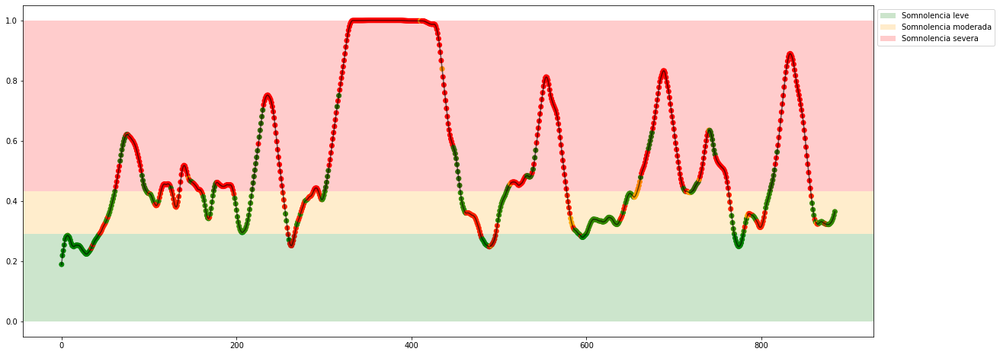

Experiment: 3_20151024_noon
	Accuracy: 28.81%
	Precision: 0.3523
	Recall: 0.3270
	f1: 0.2516


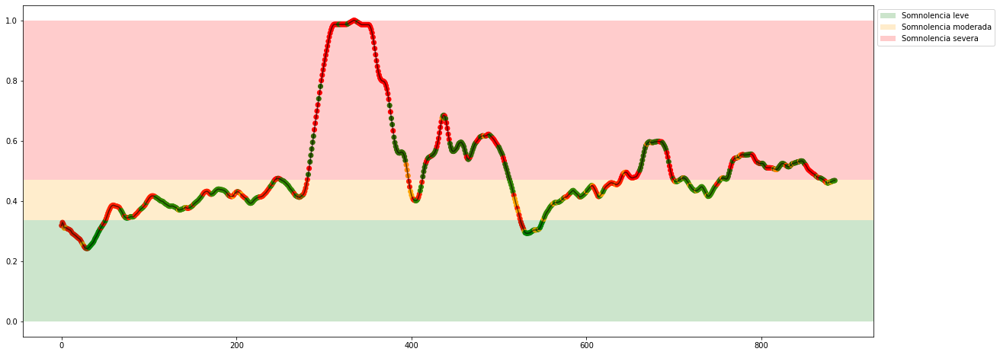

Experiment: 9_20151017_night
	Accuracy: 38.53%
	Precision: 0.4432
	Recall: 0.4248
	f1: 0.3451


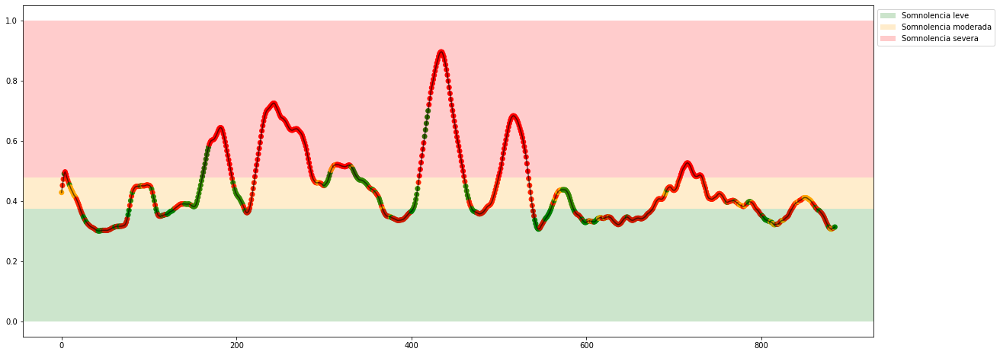

In [113]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all_eog[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    
    predictions = partial_model.predict(data)
    acc = accuracy_score(expected, predictions)
    pre = precision_score(expected, predictions, average='macro', zero_division=1)
    rec = recall_score(expected, predictions, average='macro', zero_division=1)
    f1 = f1_score(expected, predictions, average='macro', zero_division=1)
    print(f"\tAccuracy: {acc*100:.2f}%")
    print(f"\tPrecision: {pre:.4f}")
    print(f"\tRecall: {rec:.4f}")
    print(f"\tf1: {f1:.4f}")
    
    colors = map_2_colors(predictions, labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

## KNN

In [114]:
from sklearn.neighbors import KNeighborsClassifier

### KNN EEG

Experiment: Modelo 70-30 KNN PSD
Best Model:
	Score: 0.7385
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 15, 'n_neighbors': 9, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 73.93%
	Precision: 0.6757
	Recall: 0.6452
	f1: 0.6554
Matriz de confusión para X completo


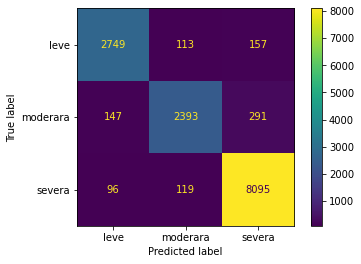

In [133]:
print(f"Experiment: Modelo 70-30 KNN PSD")
model = KNeighborsClassifier()

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['n_neighbors'] = randint(3, 21)
space['weights'] = ['uniform', 'distance']
space['algorithm'] = ['auto', 'ball_tree', 'kd_tree', 'brute']
space['leaf_size'] = randint(15,50)
space['p'] = [1, 2]

partial_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_sub_eeg, y_sub_class, model, space, cv=cv,  n_iter=20)

Experiment: 13_20150929_noon
	Accuracy: 60.90%
	Precision: 0.2336
	Recall: 0.3195
	f1: 0.2564


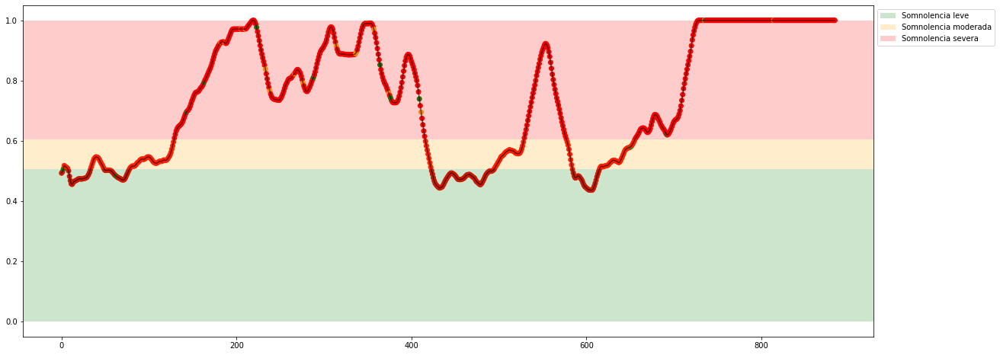

Experiment: 7_20151015_night
	Accuracy: 48.36%
	Precision: 0.3722
	Recall: 0.3649
	f1: 0.3527


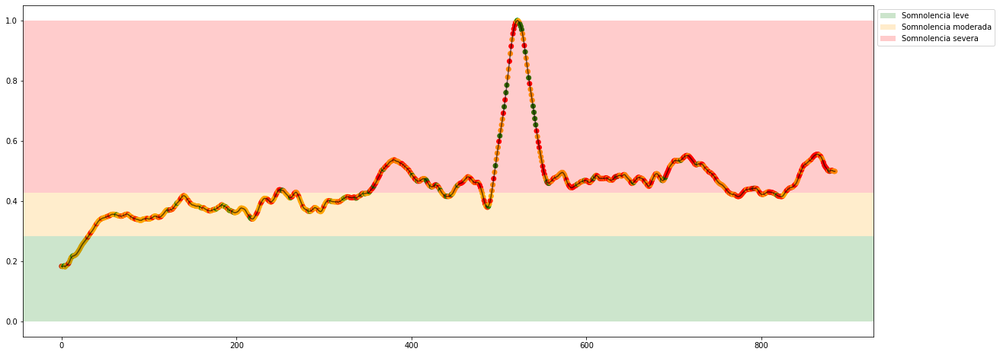

Experiment: 2_20151106_noon
	Accuracy: 26.67%
	Precision: 0.3228
	Recall: 0.3263
	f1: 0.2164


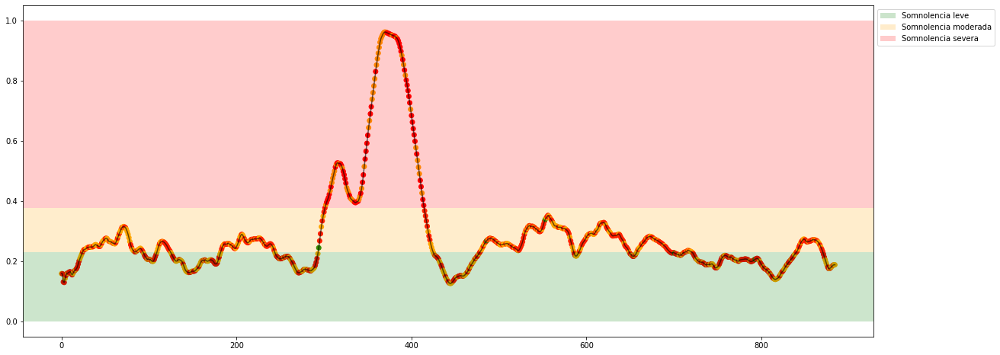

Experiment: 8_20151022_noon
	Accuracy: 51.86%
	Precision: 0.4264
	Recall: 0.4827
	f1: 0.4207


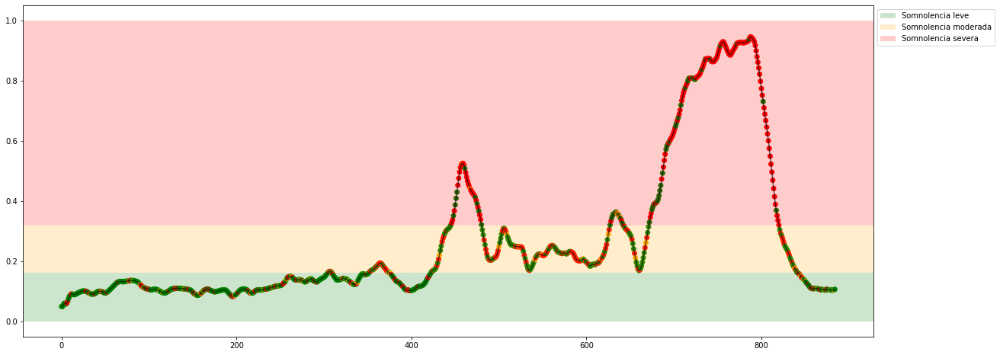

Experiment: 14_20151014_night
	Accuracy: 46.10%
	Precision: 0.3258
	Recall: 0.3268
	f1: 0.3173


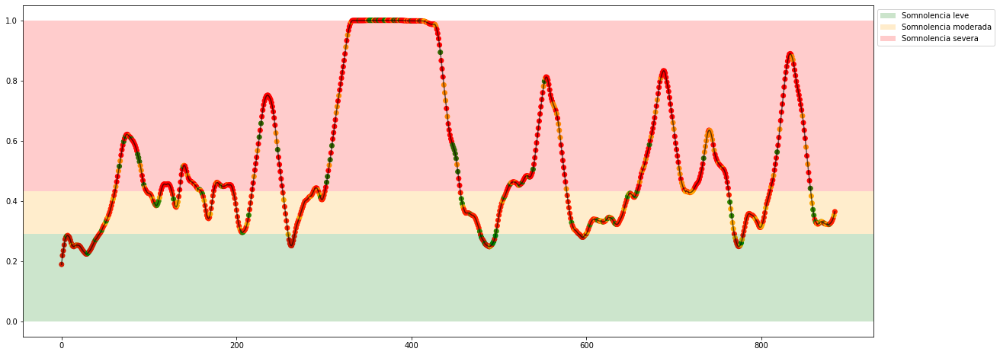

Experiment: 3_20151024_noon
	Accuracy: 44.29%
	Precision: 0.3525
	Recall: 0.3536
	f1: 0.2965


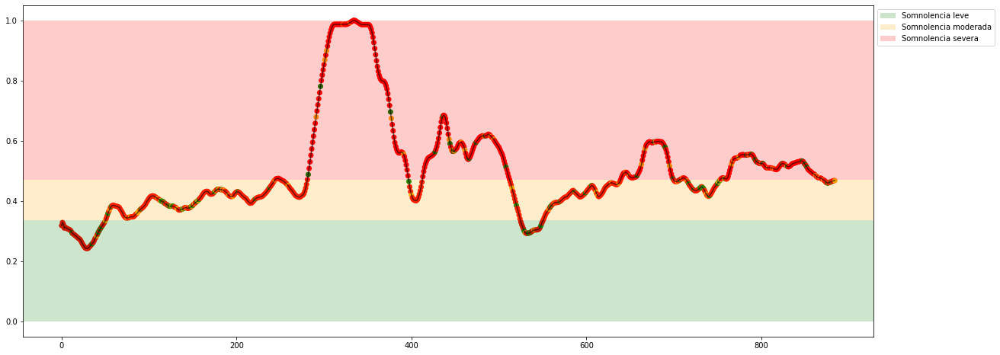

Experiment: 9_20151017_night
	Accuracy: 37.74%
	Precision: 0.3887
	Recall: 0.4065
	f1: 0.3549


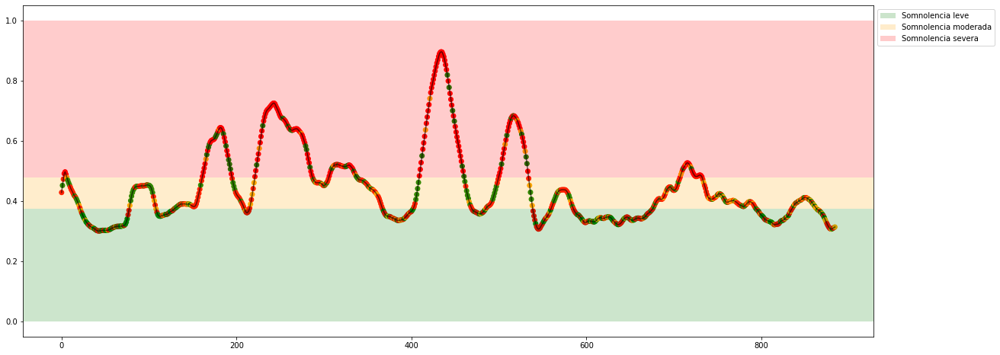

In [134]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data, aux2 = read_features(f'./features/{key}.csv')
    scaler = MinMaxScaler(feature_range=(0, 1))
    data_minmax = scaler.fit_transform(data)
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    
    predictions = partial_model.predict(data_minmax)
    acc = accuracy_score(expected, predictions)
    pre = precision_score(expected, predictions, average='macro', zero_division=1)
    rec = recall_score(expected, predictions, average='macro', zero_division=1)
    f1 = f1_score(expected, predictions, average='macro', zero_division=1)
    print(f"\tAccuracy: {acc*100:.2f}%")
    print(f"\tPrecision: {pre:.4f}")
    print(f"\tRecall: {rec:.4f}")
    print(f"\tf1: {f1:.4f}")
    
    colors = map_2_colors(predictions, labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

### KNN PSD

Experiment: Modelo 70-30 KNN PSD
Best Model:
	Score: 0.8070
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 15, 'n_neighbors': 9, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 81.81%
	Precision: 0.7760
	Recall: 0.7705
	f1: 0.7717
Matriz de confusión para X completo


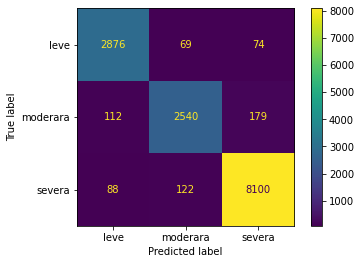

In [115]:
print(f"Experiment: Modelo 70-30 KNN PSD")
model = KNeighborsClassifier()

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['n_neighbors'] = randint(3, 21)
space['weights'] = ['uniform', 'distance']
space['algorithm'] = ['auto', 'ball_tree', 'kd_tree', 'brute']
space['leaf_size'] = randint(15,50)
space['p'] = [1, 2]

partial_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_sub, y_sub_class, model, space, cv=cv,  n_iter=20)

Experiment: 13_20150929_noon
	Accuracy: 71.64%
	Precision: 0.5153
	Recall: 0.5532
	f1: 0.5166


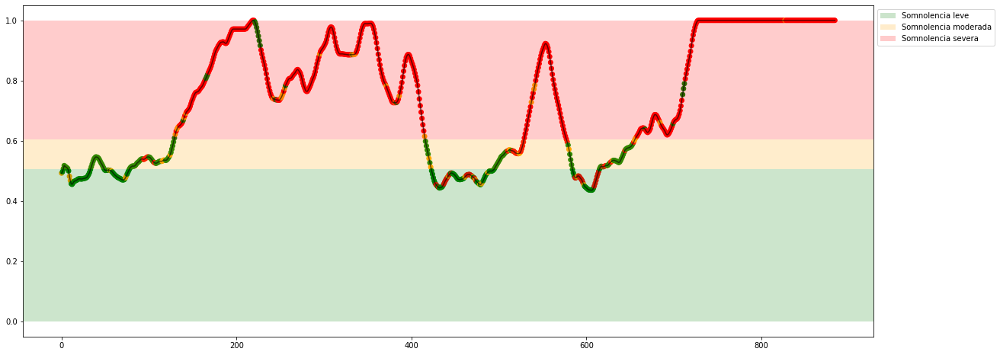

Experiment: 7_20151015_night
	Accuracy: 52.09%
	Precision: 0.4501
	Recall: 0.5608
	f1: 0.4406


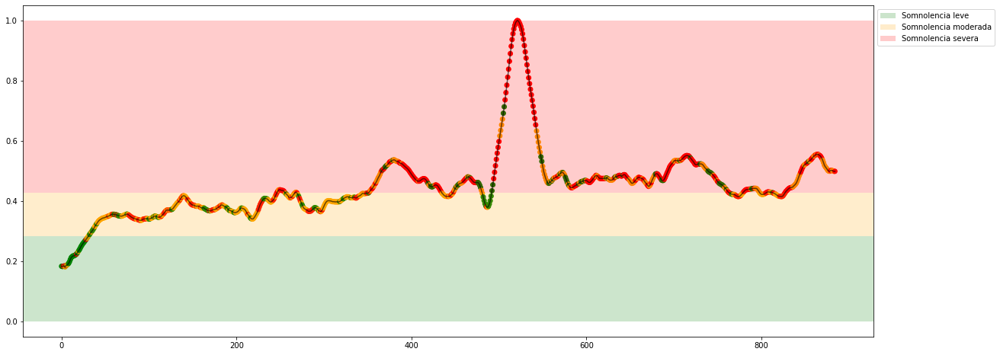

Experiment: 2_20151106_noon
	Accuracy: 34.58%
	Precision: 0.3489
	Recall: 0.3343
	f1: 0.3063


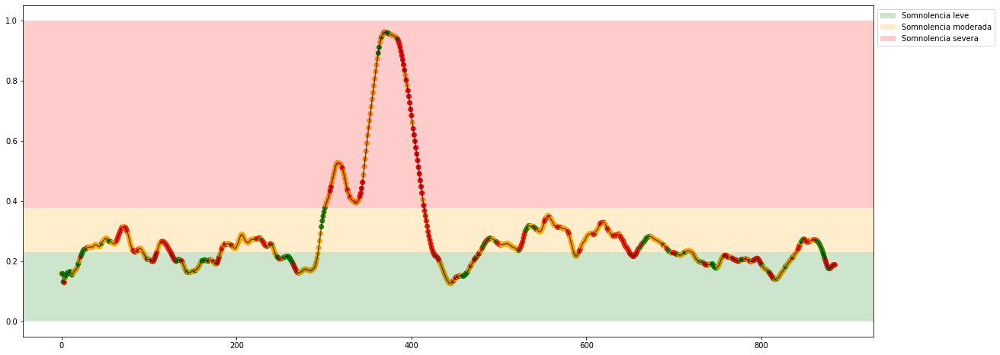

Experiment: 8_20151022_noon
	Accuracy: 27.46%
	Precision: 0.4881
	Recall: 0.3628
	f1: 0.2231


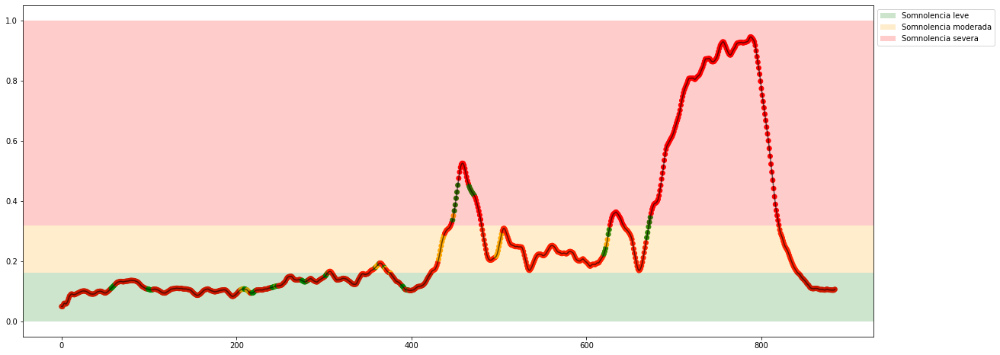

Experiment: 14_20151014_night
	Accuracy: 56.72%
	Precision: 0.4949
	Recall: 0.5486
	f1: 0.4605


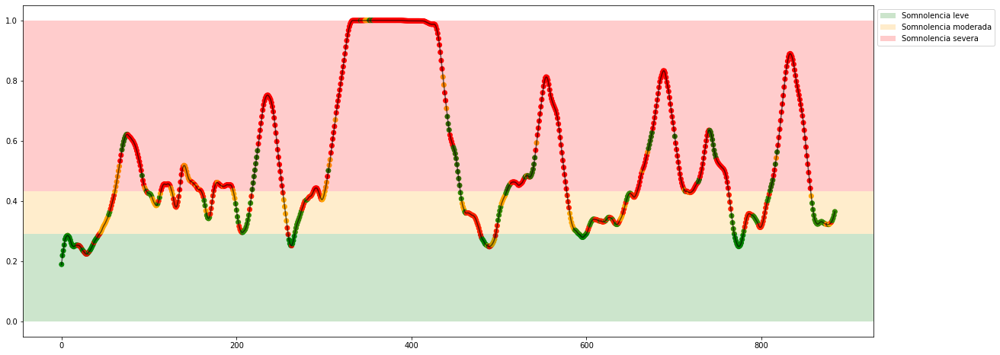

Experiment: 3_20151024_noon
	Accuracy: 31.07%
	Precision: 0.3251
	Recall: 0.2981
	f1: 0.2637


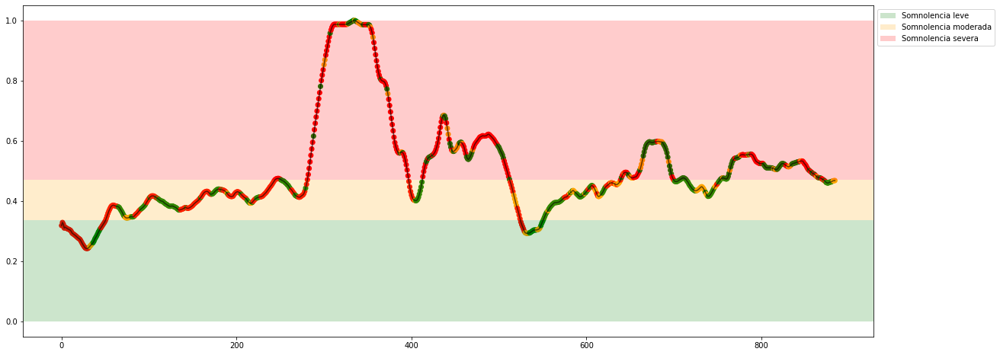

Experiment: 9_20151017_night
	Accuracy: 40.00%
	Precision: 0.4274
	Recall: 0.4385
	f1: 0.3653


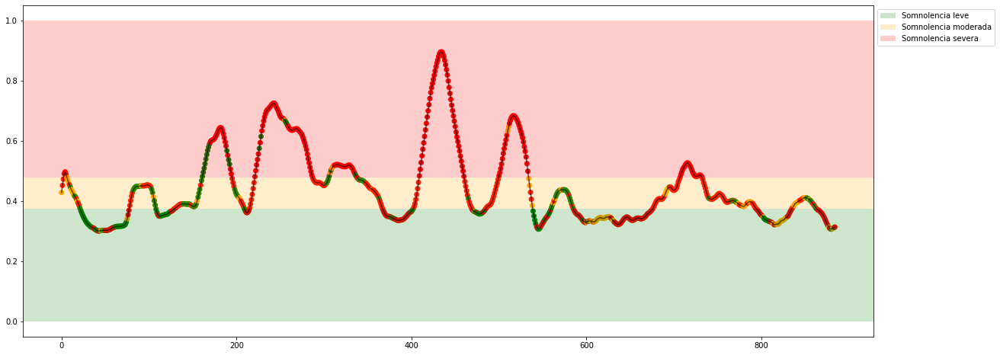

In [116]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    
    predictions = partial_model.predict(data)
    acc = accuracy_score(expected, predictions)
    pre = precision_score(expected, predictions, average='macro', zero_division=1)
    rec = recall_score(expected, predictions, average='macro', zero_division=1)
    f1 = f1_score(expected, predictions, average='macro', zero_division=1)
    print(f"\tAccuracy: {acc*100:.2f}%")
    print(f"\tPrecision: {pre:.4f}")
    print(f"\tRecall: {rec:.4f}")
    print(f"\tf1: {f1:.4f}")
    
    colors = map_2_colors(predictions, labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

### KNN PSD + EOG

Experiment: Modelo 70-30 KNN PSD+EOG
Best Model:
	Score: 0.7719
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 15, 'n_neighbors': 9, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 77.20%
	Precision: 0.7121
	Recall: 0.7002
	f1: 0.7030
Matriz de confusión para X completo


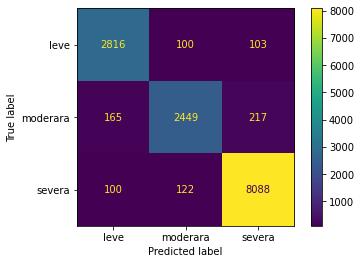

In [117]:
print(f"Experiment: Modelo 70-30 KNN PSD+EOG")
model = KNeighborsClassifier()

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['n_neighbors'] = randint(3, 21)
space['weights'] = ['uniform', 'distance']
space['algorithm'] = ['auto', 'ball_tree', 'kd_tree', 'brute']
space['leaf_size'] = randint(15,50)
space['p'] = [1, 2]

partial_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_sub_eog, y_sub_class, model, space, cv=cv,  n_iter=20)

Experiment: 13_20150929_noon
	Accuracy: 71.98%
	Precision: 0.5502
	Recall: 0.5610
	f1: 0.5331


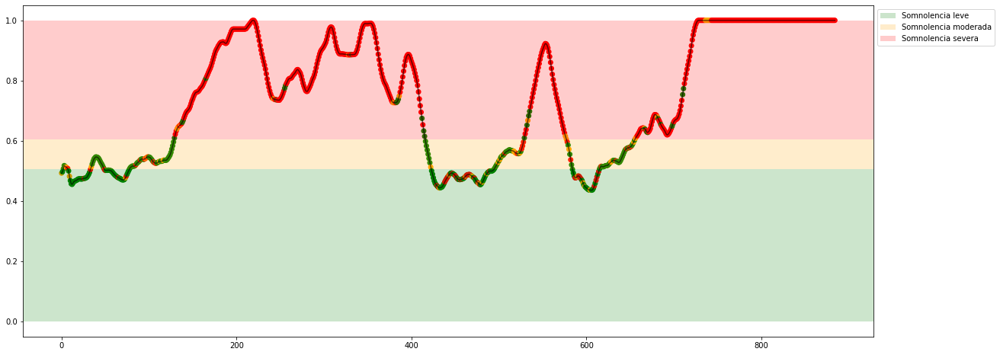

Experiment: 7_20151015_night
	Accuracy: 52.66%
	Precision: 0.4265
	Recall: 0.4586
	f1: 0.4166


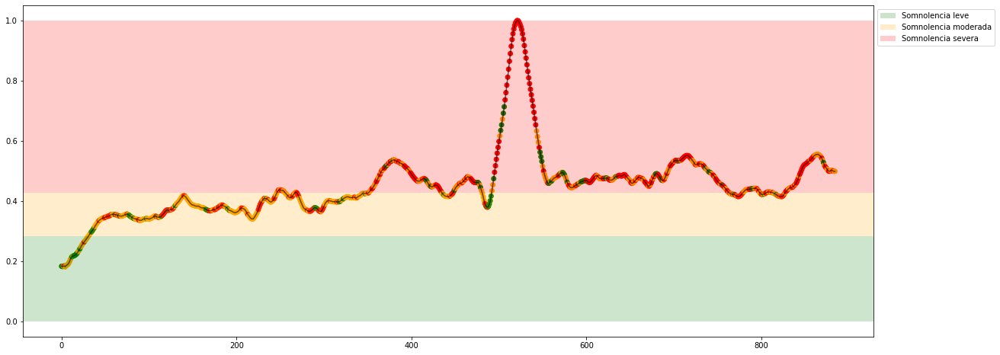

Experiment: 2_20151106_noon
	Accuracy: 38.08%
	Precision: 0.3790
	Recall: 0.3999
	f1: 0.3621


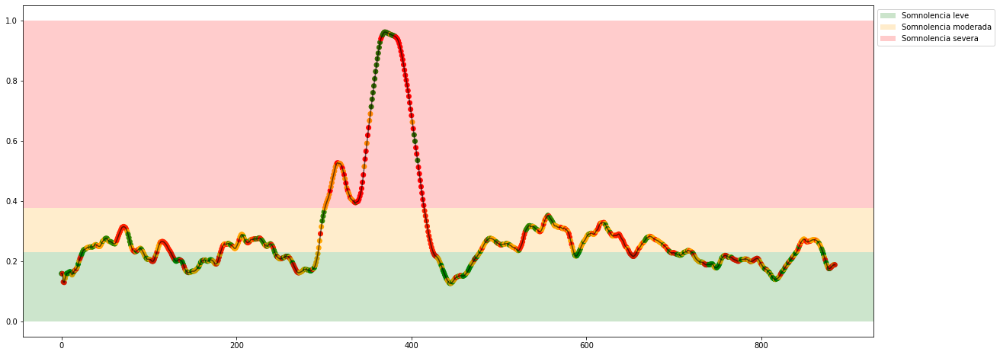

Experiment: 8_20151022_noon
	Accuracy: 28.36%
	Precision: 0.3072
	Recall: 0.3088
	f1: 0.2861


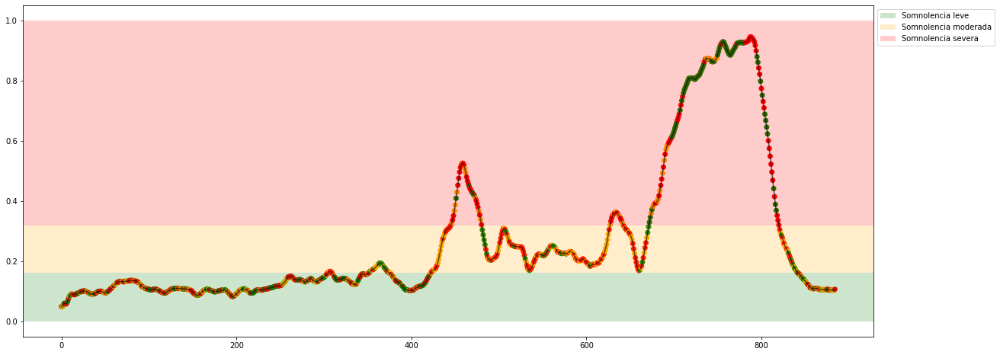

Experiment: 14_20151014_night
	Accuracy: 57.85%
	Precision: 0.4914
	Recall: 0.5535
	f1: 0.4714


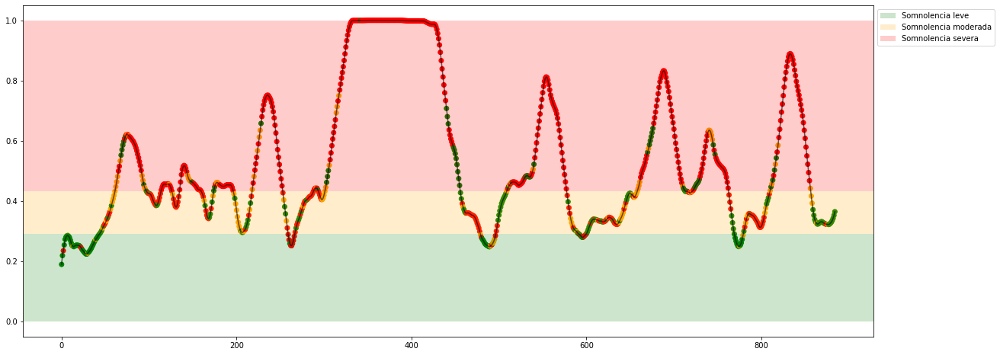

Experiment: 3_20151024_noon
	Accuracy: 34.92%
	Precision: 0.3518
	Recall: 0.3501
	f1: 0.2890


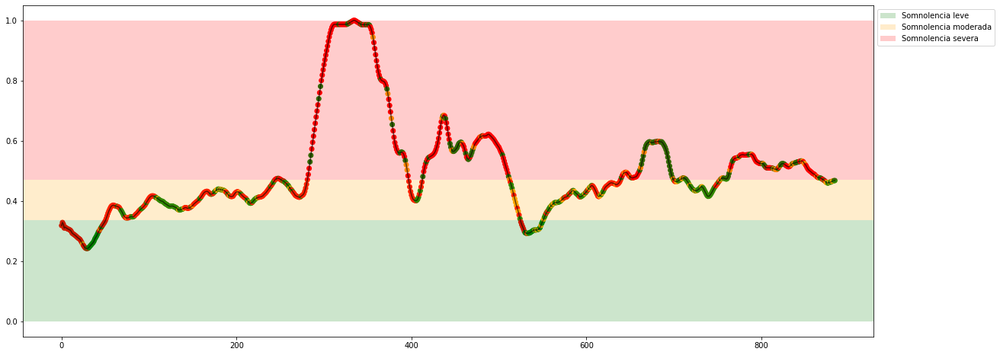

Experiment: 9_20151017_night
	Accuracy: 40.45%
	Precision: 0.4355
	Recall: 0.4397
	f1: 0.3753


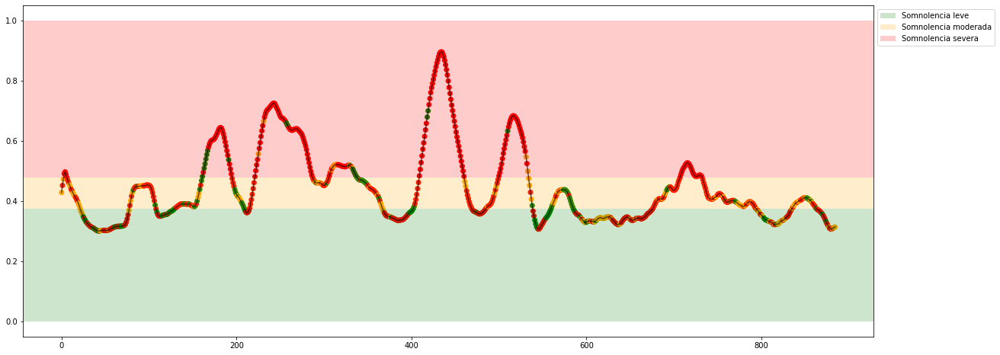

In [118]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all_eog[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    
    predictions = partial_model.predict(data)
    acc = accuracy_score(expected, predictions)
    pre = precision_score(expected, predictions, average='macro', zero_division=1)
    rec = recall_score(expected, predictions, average='macro', zero_division=1)
    f1 = f1_score(expected, predictions, average='macro', zero_division=1)
    print(f"\tAccuracy: {acc*100:.2f}%")
    print(f"\tPrecision: {pre:.4f}")
    print(f"\tRecall: {rec:.4f}")
    print(f"\tf1: {f1:.4f}")
    
    colors = map_2_colors(predictions, labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

## Decision Tree

In [119]:
from sklearn.tree import DecisionTreeClassifier

### Decision Tree PSD

Experiment: Modelo 70-30 Decision Tree PSD
Best Model:
	Score: 0.7568
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 93, 'max_features': 'log2', 'min_samples_split': 2, 'splitter': 'best'}

Results with X_test:
	Accuracy: 75.76%
	Precision: 0.7004
	Recall: 0.7062
	f1: 0.7028
Matriz de confusión para X completo


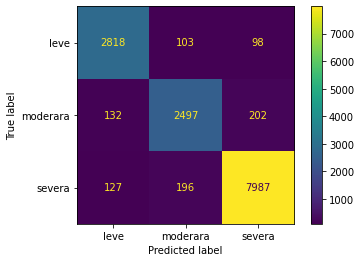

In [120]:
print(f"Experiment: Modelo 70-30 Decision Tree PSD")
model = DecisionTreeClassifier(random_state=42)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['criterion'] = ["gini", "entropy"]
space['splitter'] = ["best", "random"]
space['max_depth'] = randint(5, 100)
space['min_samples_split'] = randint(2, 10)
#space['min_samples_leaf'] = randint(1, 10)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['ccp_alpha'] = uniform(0, 5) # empeora el ponerlo, el mejor valor es 0.0

partial_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_sub, y_sub_class, model, space, cv=cv,  n_iter=100)

In [121]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = partial_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

psd_alpha: 0.2300
psd_gamma: 0.2138
psd_delta: 0.2097
psd_theta: 0.1772
psd_betha: 0.1694


Experiment: 13_20150929_noon
	Accuracy: 67.68%
	Precision: 0.4875
	Recall: 0.5162
	f1: 0.4941


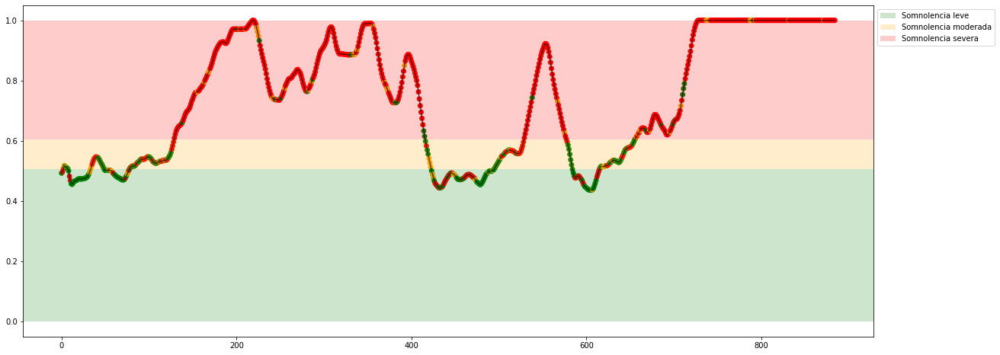

Experiment: 7_20151015_night
	Accuracy: 51.19%
	Precision: 0.4248
	Recall: 0.4467
	f1: 0.4101


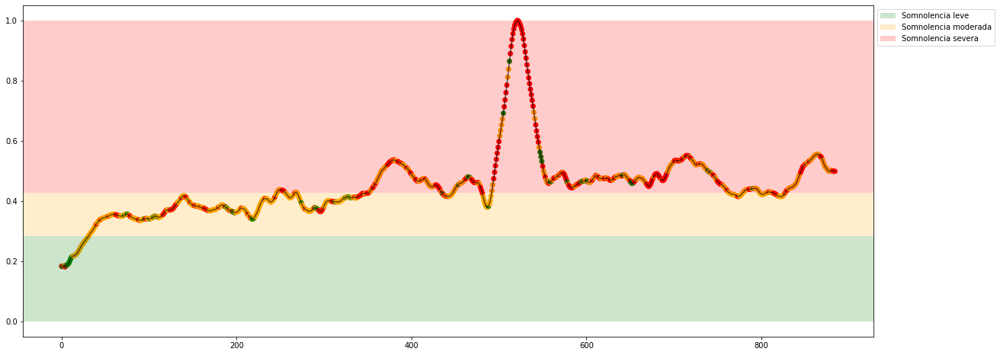

Experiment: 2_20151106_noon
	Accuracy: 30.85%
	Precision: 0.3545
	Recall: 0.3275
	f1: 0.2866


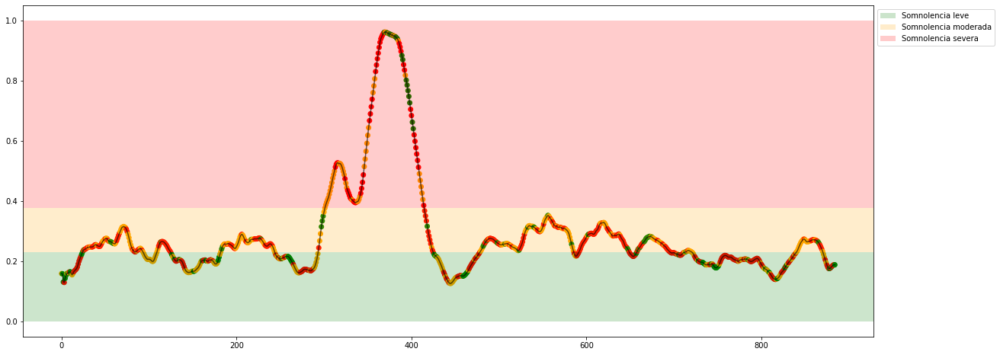

Experiment: 8_20151022_noon
	Accuracy: 25.54%
	Precision: 0.2592
	Recall: 0.2439
	f1: 0.2281


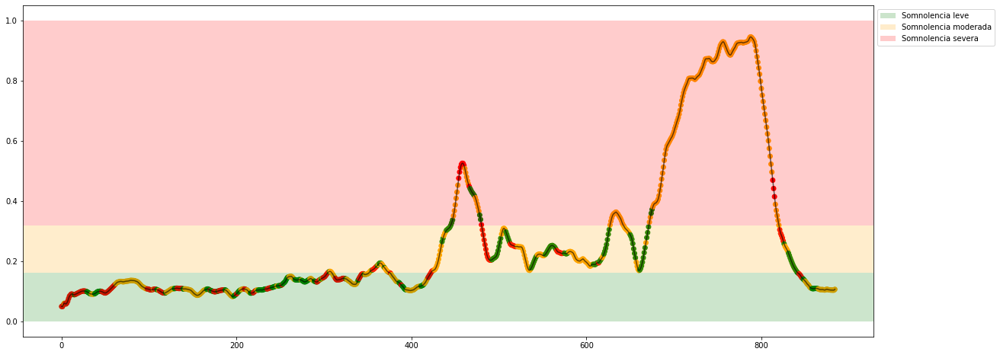

Experiment: 14_20151014_night
	Accuracy: 52.88%
	Precision: 0.4016
	Recall: 0.4147
	f1: 0.3817


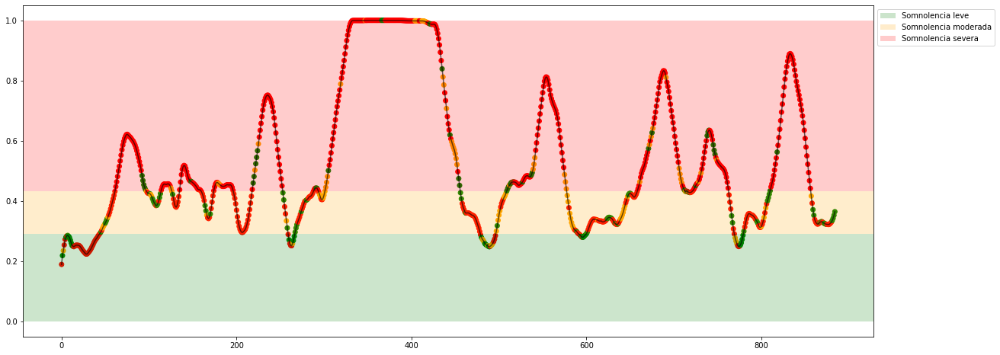

Experiment: 3_20151024_noon
	Accuracy: 32.43%
	Precision: 0.3004
	Recall: 0.2840
	f1: 0.2720


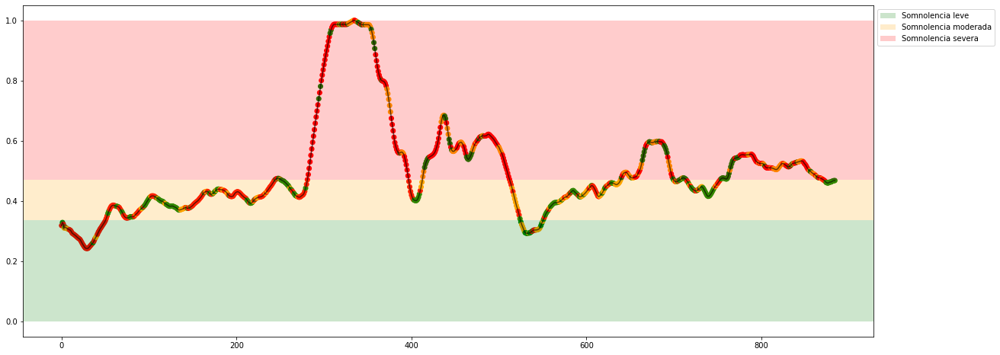

Experiment: 9_20151017_night
	Accuracy: 37.51%
	Precision: 0.4087
	Recall: 0.4090
	f1: 0.3483


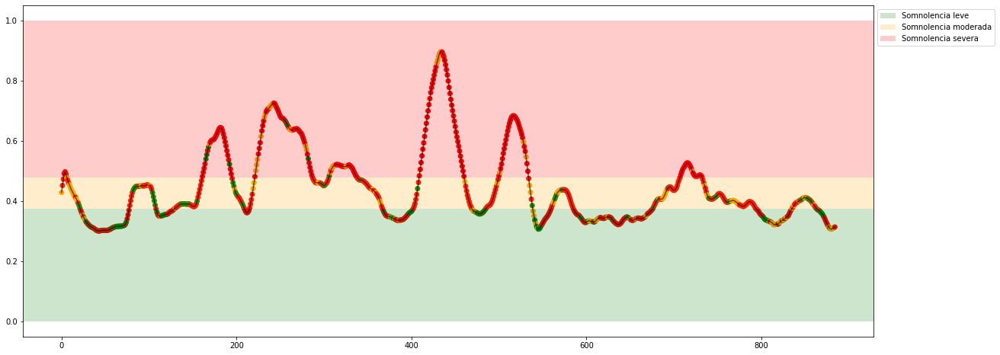

In [122]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    
    predictions = partial_model.predict(data)
    acc = accuracy_score(expected, predictions)
    pre = precision_score(expected, predictions, average='macro', zero_division=1)
    rec = recall_score(expected, predictions, average='macro', zero_division=1)
    f1 = f1_score(expected, predictions, average='macro', zero_division=1)
    print(f"\tAccuracy: {acc*100:.2f}%")
    print(f"\tPrecision: {pre:.4f}")
    print(f"\tRecall: {rec:.4f}")
    print(f"\tf1: {f1:.4f}")
    
    colors = map_2_colors(predictions, labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

### Decision Tree PSD + EOG

Experiment: Modelo 70-30 Decision Tree PSD+EOG
Best Model:
	Score: 0.7438
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 93, 'max_features': 'log2', 'min_samples_split': 2, 'splitter': 'best'}

Results with X_test:
	Accuracy: 75.14%
	Precision: 0.6939
	Recall: 0.6933
	f1: 0.6935
Matriz de confusión para X completo


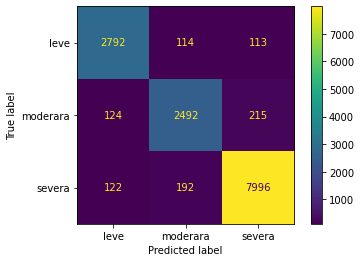

In [123]:
print(f"Experiment: Modelo 70-30 Decision Tree PSD+EOG")
model = DecisionTreeClassifier(random_state=42)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['criterion'] = ["gini", "entropy"]
space['splitter'] = ["best", "random"]
space['max_depth'] = randint(5, 100)
space['min_samples_split'] = randint(2, 10)
#space['min_samples_leaf'] = randint(1, 10)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['ccp_alpha'] = uniform(0, 5) # empeora el ponerlo, el mejor valor es 0.0

partial_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_sub_eog, y_sub_class, model, space, cv=cv,  n_iter=100)

In [124]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = partial_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

psd_alpha: 0.2308
psd_gamma: 0.1898
psd_theta: 0.1890
psd_delta: 0.1588
psd_betha: 0.1476
n_parpadeos: 0.0840


Experiment: 13_20150929_noon
	Accuracy: 61.13%
	Precision: 0.4646
	Recall: 0.4849
	f1: 0.4698


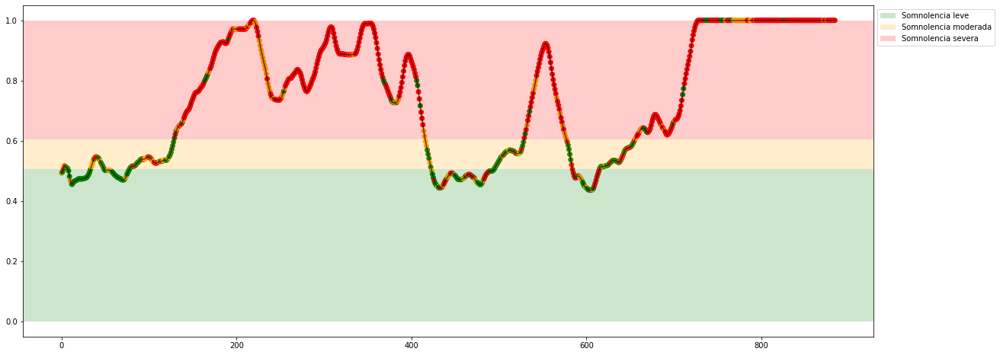

Experiment: 7_20151015_night
	Accuracy: 46.78%
	Precision: 0.4297
	Recall: 0.4316
	f1: 0.3706


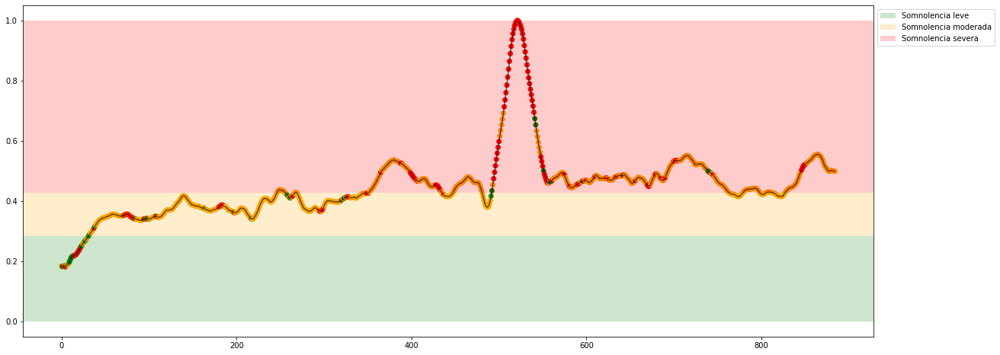

Experiment: 2_20151106_noon
	Accuracy: 30.17%
	Precision: 0.3492
	Recall: 0.3169
	f1: 0.2848


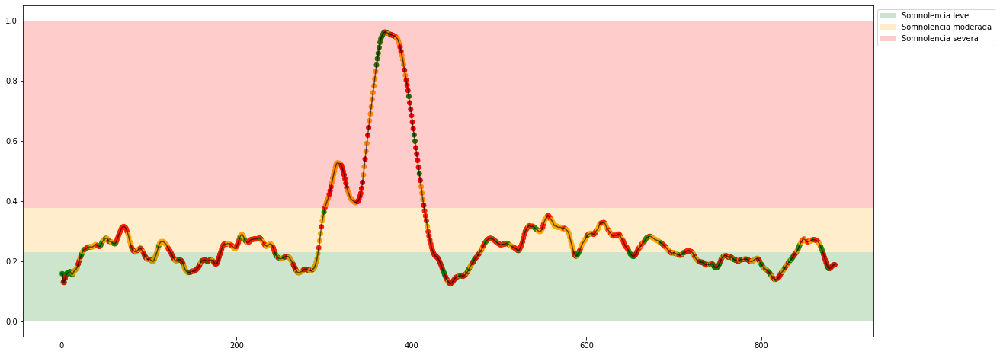

Experiment: 8_20151022_noon
	Accuracy: 28.81%
	Precision: 0.3141
	Recall: 0.3302
	f1: 0.2179


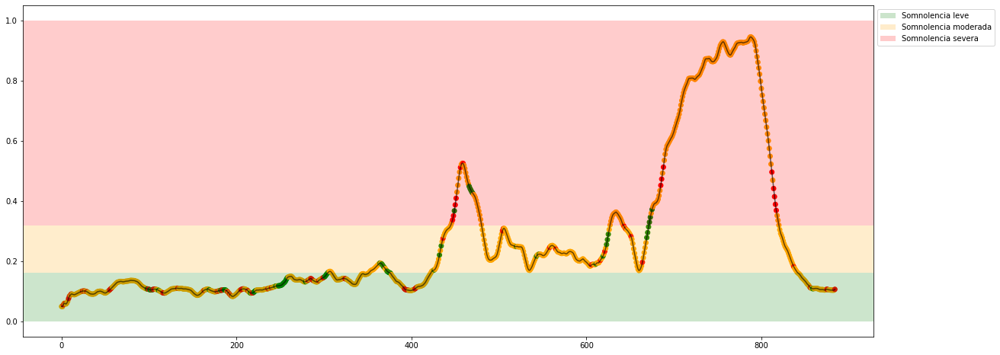

Experiment: 14_20151014_night
	Accuracy: 50.62%
	Precision: 0.3793
	Recall: 0.4369
	f1: 0.3760


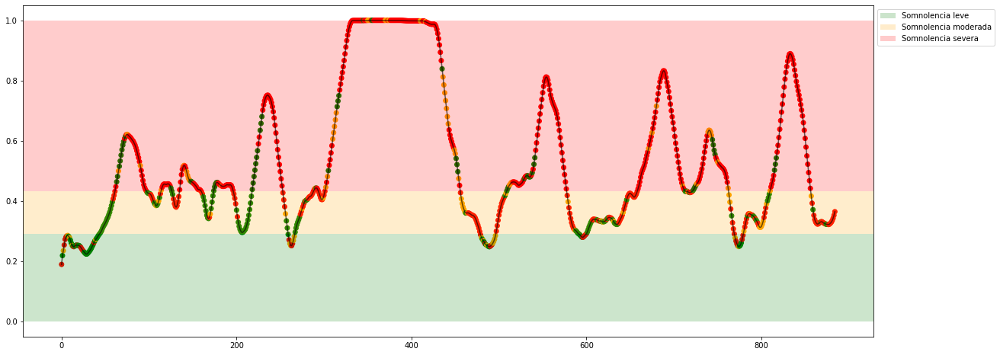

Experiment: 3_20151024_noon
	Accuracy: 31.64%
	Precision: 0.3007
	Recall: 0.2813
	f1: 0.2590


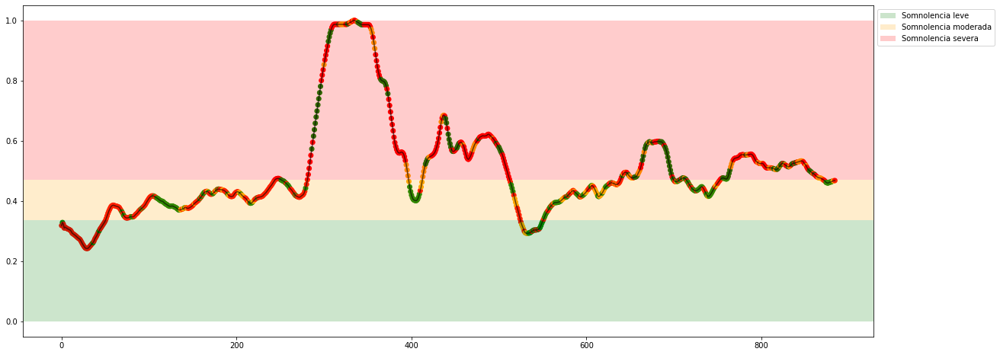

Experiment: 9_20151017_night
	Accuracy: 38.64%
	Precision: 0.4240
	Recall: 0.4225
	f1: 0.3523


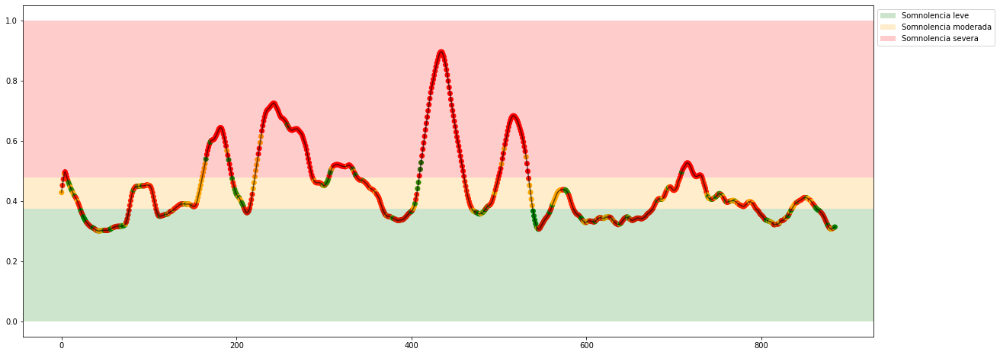

In [125]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all_eog[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    
    predictions = partial_model.predict(data)
    acc = accuracy_score(expected, predictions)
    pre = precision_score(expected, predictions, average='macro', zero_division=1)
    rec = recall_score(expected, predictions, average='macro', zero_division=1)
    f1 = f1_score(expected, predictions, average='macro', zero_division=1)
    print(f"\tAccuracy: {acc*100:.2f}%")
    print(f"\tPrecision: {pre:.4f}")
    print(f"\tRecall: {rec:.4f}")
    print(f"\tf1: {f1:.4f}")
    
    colors = map_2_colors(predictions, labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

## Random Forest

In [126]:
from sklearn.ensemble import RandomForestClassifier

### Random Forest PSD

Experiment: Modelo 70-30 Random Forest PSD
Best Model:
	Score: 0.8312
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 83.64%
	Precision: 0.8071
	Recall: 0.7817
	f1: 0.7903
Matriz de confusión para X completo


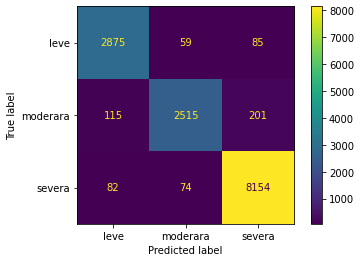

In [127]:
print(f"Experiment: Modelo 70-30 Random Forest PSD")
model = RandomForestClassifier(random_state=42, n_jobs=-1)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['n_estimators'] = randint(75, 200)
space['criterion'] = ["gini", "entropy"]
space['max_depth'] = randint(75, 150)
space['min_samples_split'] = randint(2, 10)
space['min_samples_leaf'] = randint(1, 10)
# space['min_weight_fraction_leaf'] = uniform(0, 0.5)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['max_leaf_nodes'] = randint(1, 300)
# space['min_impurity_decrease'] = uniform(0, 5)
#space['bootstrap'] = [True, False]
# space['oob_score'] = [True, False]
space['warm_start'] = [True, False]
# space['class_weight'] = ['balanced', 'balanced_subsample']
#space['ccp_alpha'] = uniform(0, 5)
#space['max_samples'] = uniform(0, 1)

partial_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_sub, y_sub_class, model, space, cv=cv,  n_iter=20)

In [128]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = partial_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

psd_alpha: 0.2424
psd_gamma: 0.2039
psd_delta: 0.1976
psd_theta: 0.1968
psd_betha: 0.1595


Experiment: 13_20150929_noon
	Accuracy: 73.90%
	Precision: 0.5328
	Recall: 0.5531
	f1: 0.5137


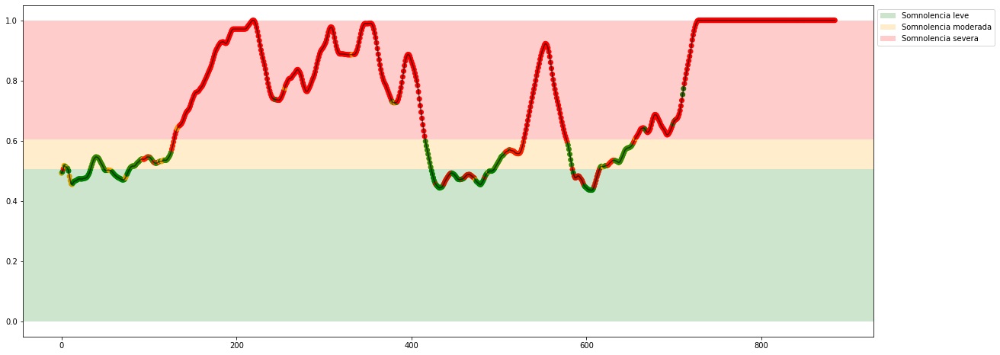

Experiment: 7_20151015_night
	Accuracy: 49.94%
	Precision: 0.3908
	Recall: 0.3686
	f1: 0.3550


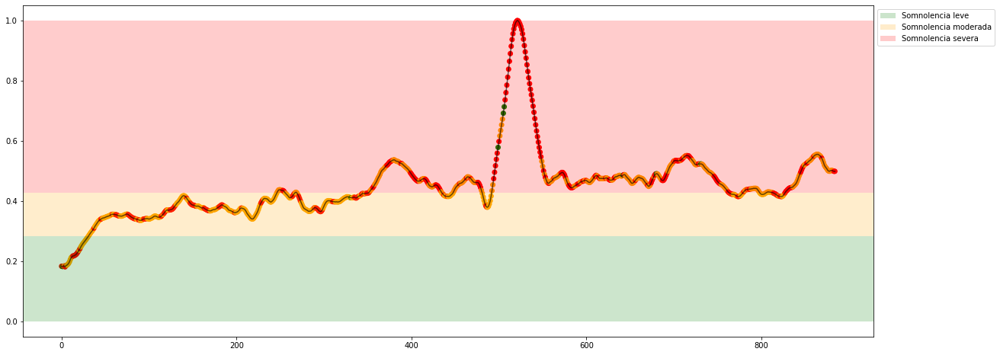

Experiment: 2_20151106_noon
	Accuracy: 32.54%
	Precision: 0.3816
	Recall: 0.3928
	f1: 0.3102


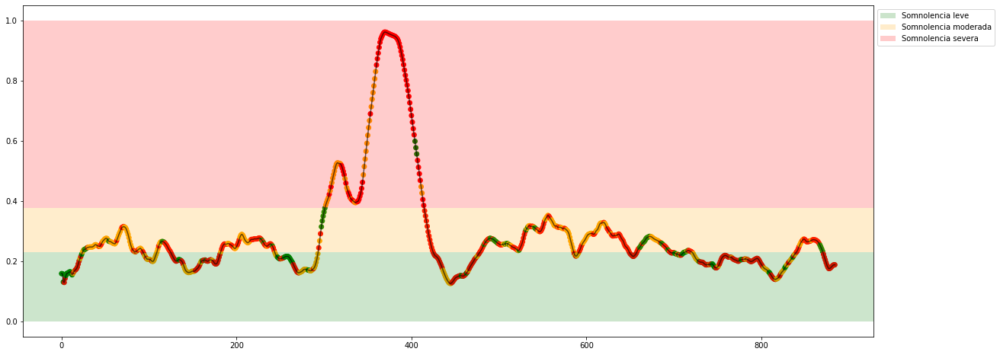

Experiment: 8_20151022_noon
	Accuracy: 34.35%
	Precision: 0.3723
	Recall: 0.4289
	f1: 0.3365


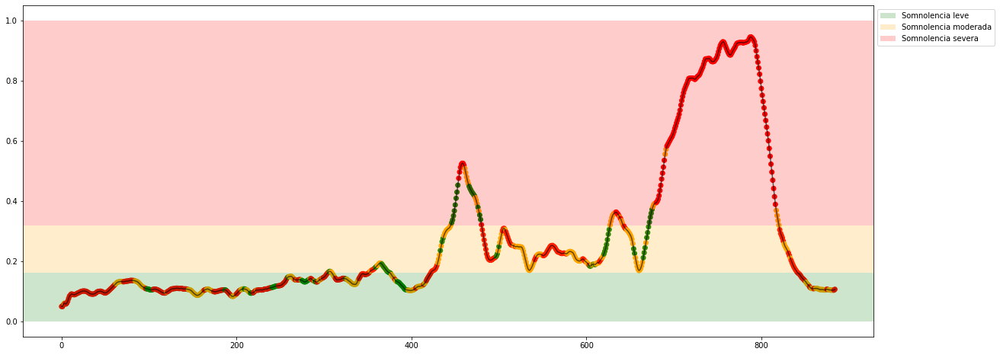

Experiment: 14_20151014_night
	Accuracy: 55.82%
	Precision: 0.4039
	Recall: 0.4015
	f1: 0.3586


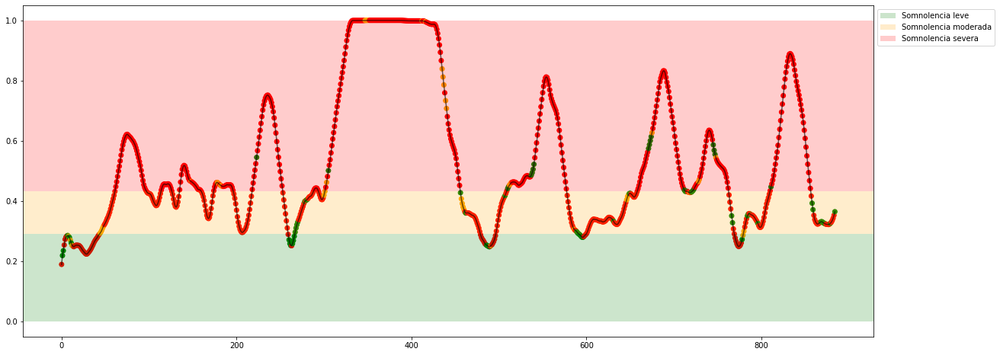

Experiment: 3_20151024_noon
	Accuracy: 38.76%
	Precision: 0.3497
	Recall: 0.3356
	f1: 0.2968


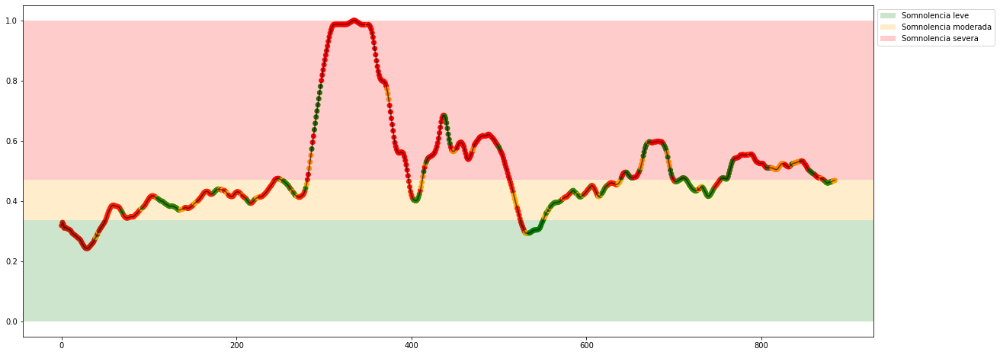

Experiment: 9_20151017_night
	Accuracy: 35.71%
	Precision: 0.4073
	Recall: 0.3998
	f1: 0.3043


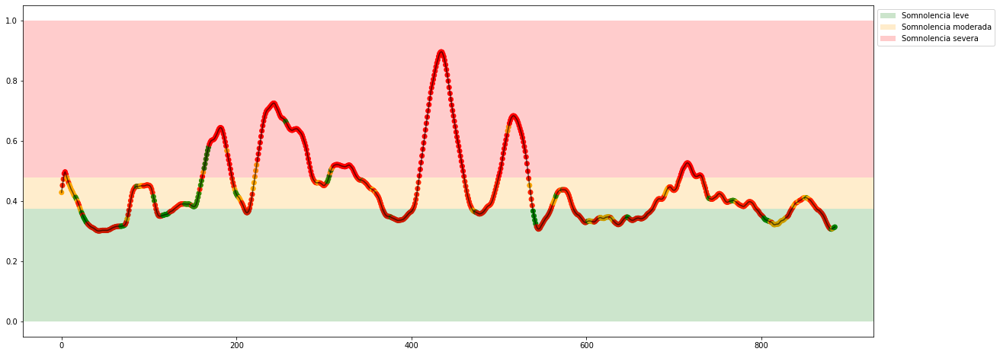

In [129]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    
    predictions = partial_model.predict(data)
    acc = accuracy_score(expected, predictions)
    pre = precision_score(expected, predictions, average='macro', zero_division=1)
    rec = recall_score(expected, predictions, average='macro', zero_division=1)
    f1 = f1_score(expected, predictions, average='macro', zero_division=1)
    print(f"\tAccuracy: {acc*100:.2f}%")
    print(f"\tPrecision: {pre:.4f}")
    print(f"\tRecall: {rec:.4f}")
    print(f"\tf1: {f1:.4f}")
    
    colors = map_2_colors(predictions, labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

### Random Forest PSD + EOG

Experiment: Modelo 70-30 Random Forest PSD+EOG
Best Model:
	Score: 0.8214
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 82.32%
	Precision: 0.7912
	Recall: 0.7623
	f1: 0.7714
Matriz de confusión para X completo


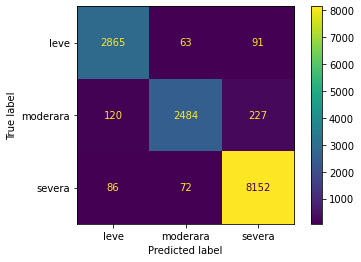

In [130]:
print(f"Experiment: Modelo 70-30 Random Forest PSD+EOG")
model = RandomForestClassifier(random_state=42, n_jobs=-1)

cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

space = dict()
space['n_estimators'] = randint(75, 200)
space['criterion'] = ["gini", "entropy"]
space['max_depth'] = randint(75, 150)
space['min_samples_split'] = randint(2, 10)
space['min_samples_leaf'] = randint(1, 10)
# space['min_weight_fraction_leaf'] = uniform(0, 0.5)
space['max_features'] = ["auto", "sqrt", "log2"]
#space['max_leaf_nodes'] = randint(1, 300)
# space['min_impurity_decrease'] = uniform(0, 5)
#space['bootstrap'] = [True, False]
# space['oob_score'] = [True, False]
space['warm_start'] = [True, False]
# space['class_weight'] = ['balanced', 'balanced_subsample']
#space['ccp_alpha'] = uniform(0, 5)
#space['max_samples'] = uniform(0, 1)

partial_model, acc, pre, rec, f1 = find_and_test_best_model_class(X_sub_eog, y_sub_class, model, space, cv=cv,  n_iter=20)

In [131]:
attribs = ['psd_delta', 'psd_theta', 'psd_alpha', 'psd_betha', 'psd_gamma', 'n_parpadeos']
importances = partial_model.feature_importances_
importance_features = sorted(zip(importances, attribs), reverse=True)
for imp, attr in importance_features:
    print(f'{attr}: {imp:.4f}')

psd_alpha: 0.2114
psd_theta: 0.1829
psd_delta: 0.1720
psd_gamma: 0.1674
psd_betha: 0.1430
n_parpadeos: 0.1233


Experiment: 13_20150929_noon
	Accuracy: 73.56%
	Precision: 0.4946
	Recall: 0.5573
	f1: 0.5032


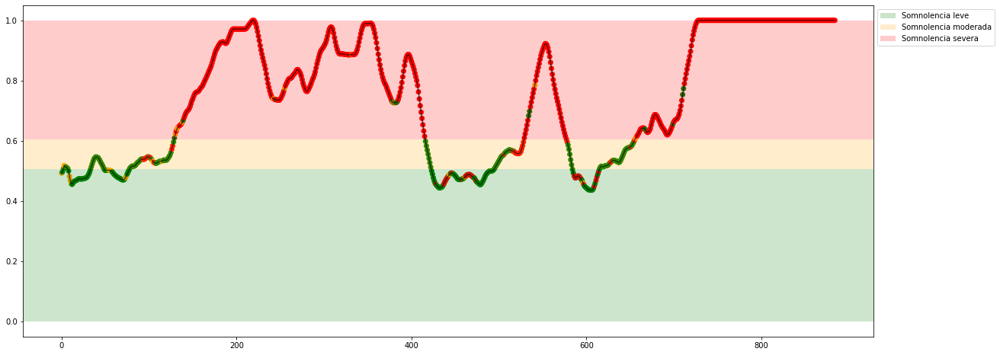

Experiment: 7_20151015_night
	Accuracy: 53.11%
	Precision: 0.4307
	Recall: 0.3980
	f1: 0.3716


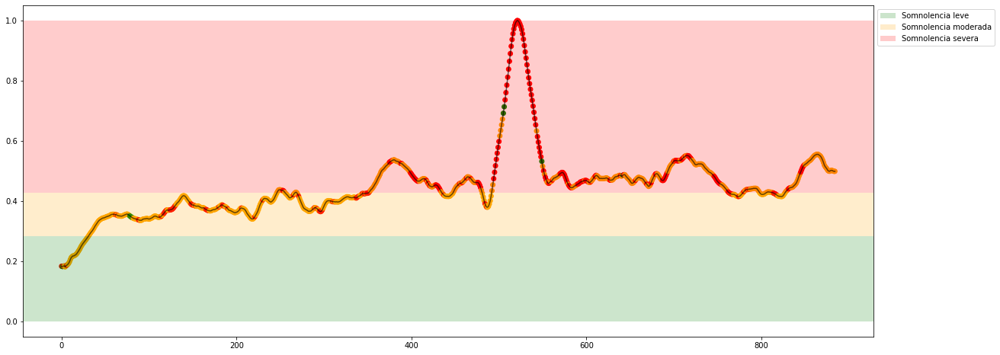

Experiment: 2_20151106_noon
	Accuracy: 27.91%
	Precision: 0.3696
	Recall: 0.3698
	f1: 0.2762


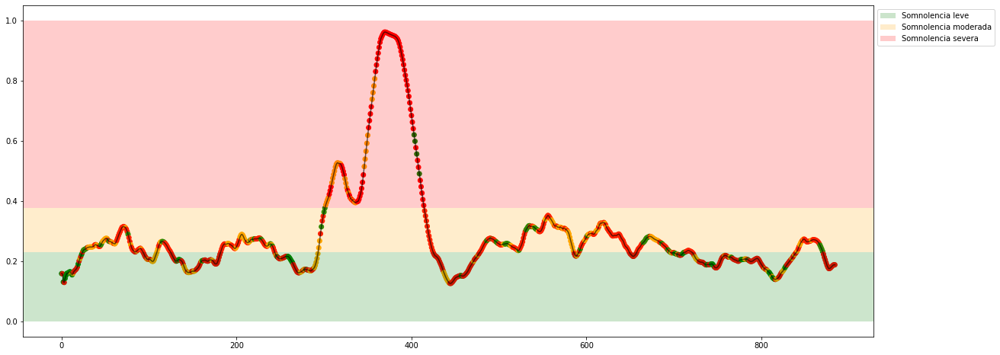

Experiment: 8_20151022_noon
	Accuracy: 26.21%
	Precision: 0.3489
	Recall: 0.3414
	f1: 0.2473


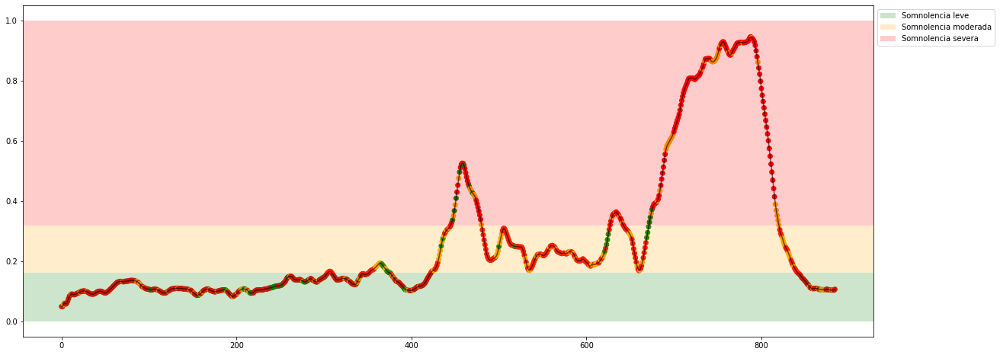

Experiment: 14_20151014_night
	Accuracy: 57.74%
	Precision: 0.4787
	Recall: 0.5407
	f1: 0.4403


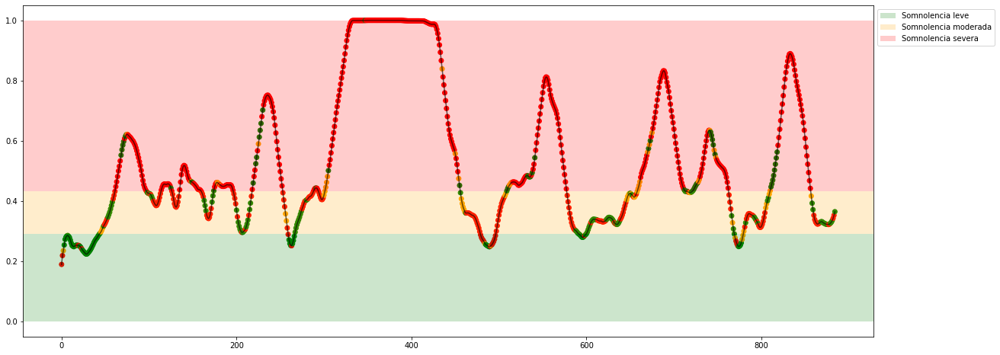

Experiment: 3_20151024_noon
	Accuracy: 38.53%
	Precision: 0.3689
	Recall: 0.3378
	f1: 0.3042


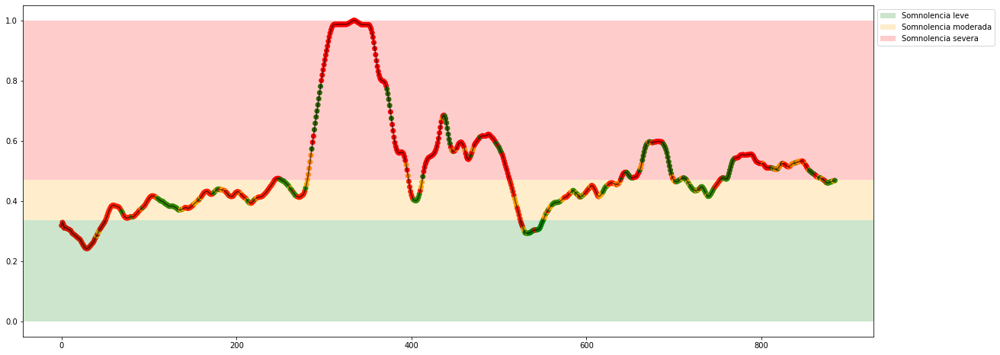

Experiment: 9_20151017_night
	Accuracy: 39.89%
	Precision: 0.4239
	Recall: 0.4372
	f1: 0.3630


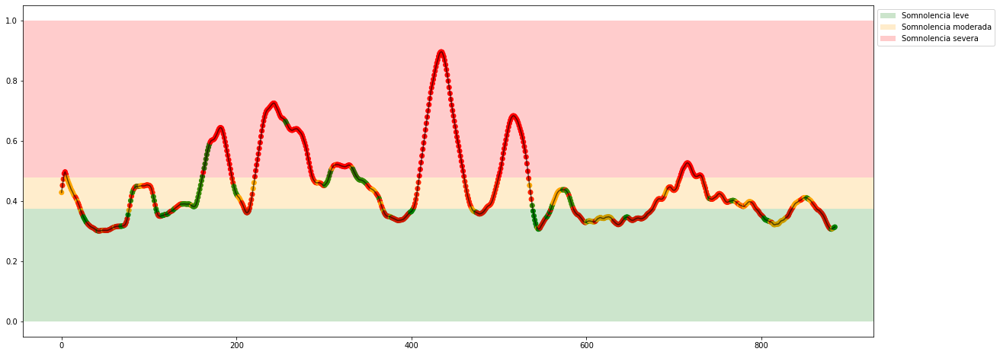

In [132]:
for experiment in subset_test:
    key = f'{experiment[:-4]}'
    data = X_all_eog[key]
    
    perclos = y_all[key]
    expected = y_all_class[key]
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    
    print(f'Experiment: {key}')
    
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
    plt.plot(perclos, c='k', alpha=0.6)
    
    predictions = partial_model.predict(data)
    acc = accuracy_score(expected, predictions)
    pre = precision_score(expected, predictions, average='macro', zero_division=1)
    rec = recall_score(expected, predictions, average='macro', zero_division=1)
    f1 = f1_score(expected, predictions, average='macro', zero_division=1)
    print(f"\tAccuracy: {acc*100:.2f}%")
    print(f"\tPrecision: {pre:.4f}")
    print(f"\tRecall: {rec:.4f}")
    print(f"\tf1: {f1:.4f}")
    
    colors = map_2_colors(predictions, labels)
    plt.scatter(range(len(perclos)), perclos, c=colors)
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

# Ahora que tenemos una input mucho mas grande al juntar todos los X en uno, vamos a probar con Deep Learning (GRU)

In [31]:
import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, GRU
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler
from tensorflow.keras.optimizers import SGD, Adam

In [41]:
def gru_train_model(X, y, neurons=15, layers=2, verbose=1):
    
    # Tenemos que pasar de X de (885,n_features) a (885,n_features,1) para trabajar con RNN (LSTM, GRU, ...)
    X_rs = np.reshape(X, (X.shape[0],X.shape[1],1))
    # Tenemos que pasar de y de (885,) a (885,1)
    y_rs = np.reshape(y, (y.shape[0],1))

    X_train, X_test, y_train, y_test = train_test_split(X_rs, y_rs, test_size=0.25, random_state=42)

    model = Sequential()
    model.add(GRU(neurons, input_shape=(None, 1), return_sequences=True))
    
    #Internal layers
    for i in range(layers-1):
        model.add(GRU(neurons, return_sequences=True))
    model.add(GRU(neurons))
    
    model.add(Dense(1))

    early_stop = EarlyStopping(monitor='loss', patience=10, verbose=verbose)
    optimizer = Adam(beta_1=0.9, beta_2=0.999, lr=0.01, decay=1e-4)

    model.compile(loss='mean_squared_error', optimizer=optimizer)

    #model.summary()
    
    model.fit(X_train, y_train, batch_size=32, epochs=200, verbose=verbose, callbacks=[early_stop])
    
    return model

In [42]:
DL_model = gru_train_model(X, y)

Epoch 1/200
478/478 [==============================] - 5s 4ms/step - loss: 0.0706
Epoch 2/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0556
Epoch 3/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0509
Epoch 4/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0483
Epoch 5/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0434
Epoch 6/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0395
Epoch 7/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0377
Epoch 8/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0360
Epoch 9/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0345
Epoch 10/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0343
Epoch 11/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0314
Epoch 12/200
478/478 [==============================] - 2s 4ms/step - loss: 0.0314
Epoch 13/200


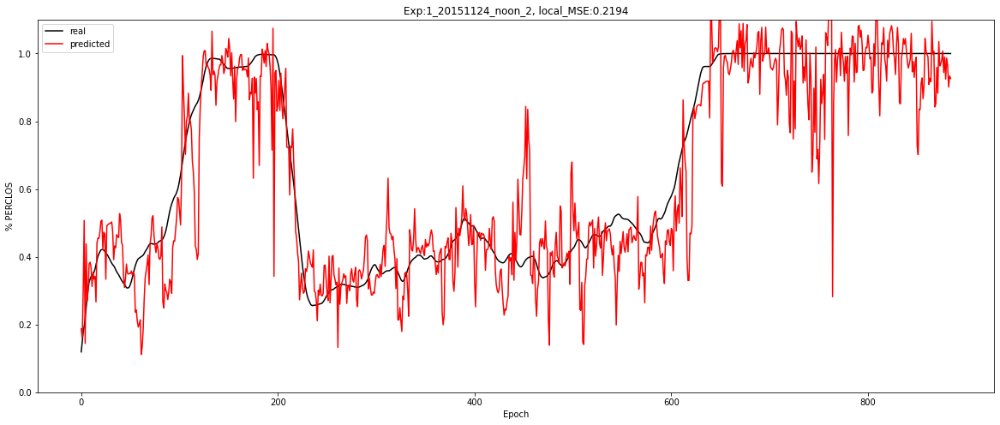

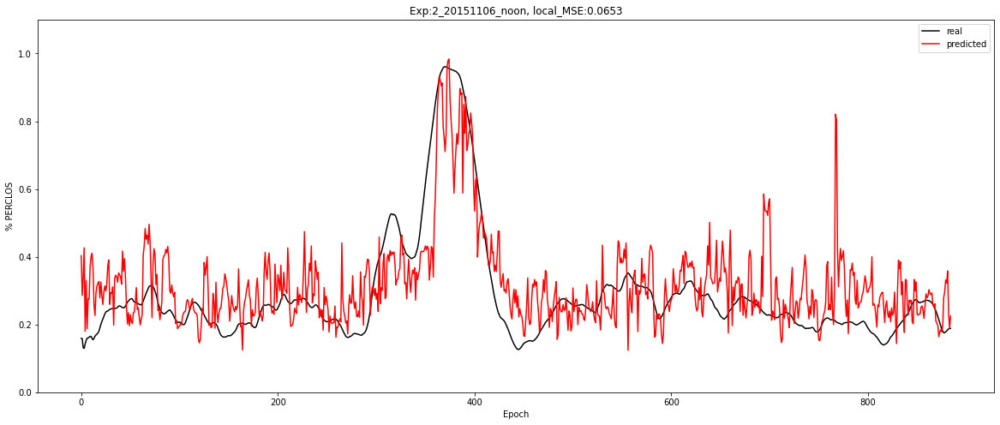

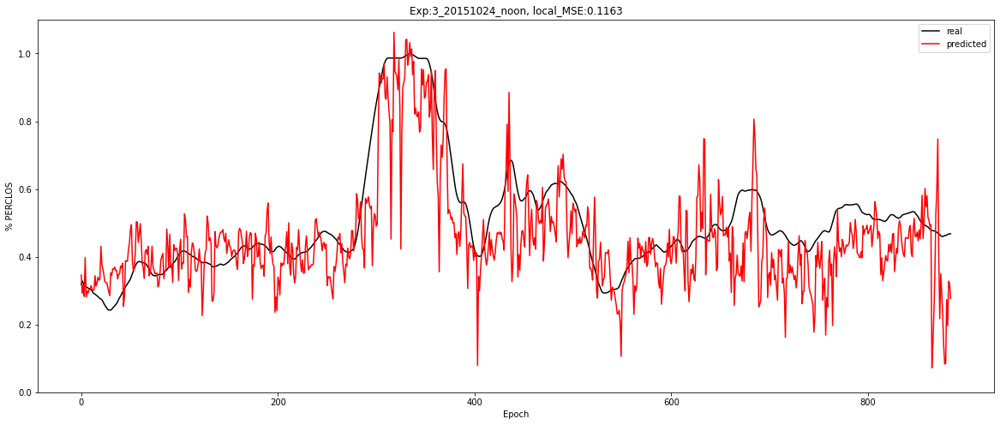

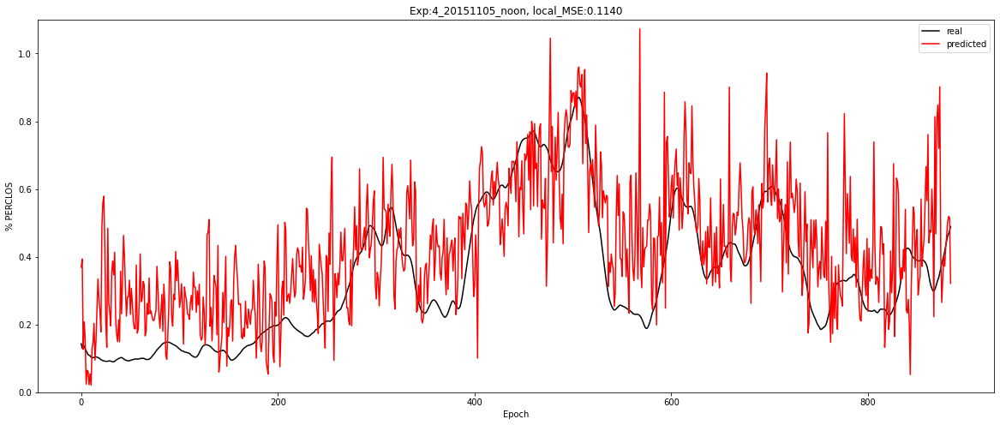

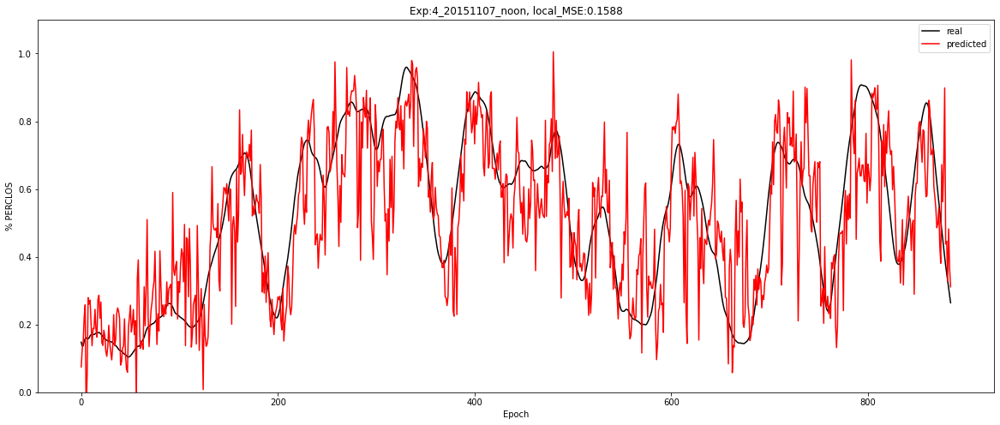

...

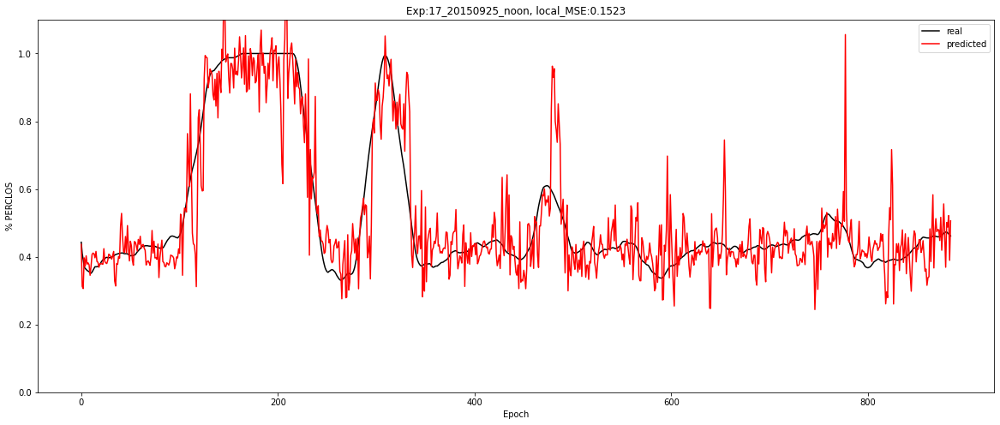

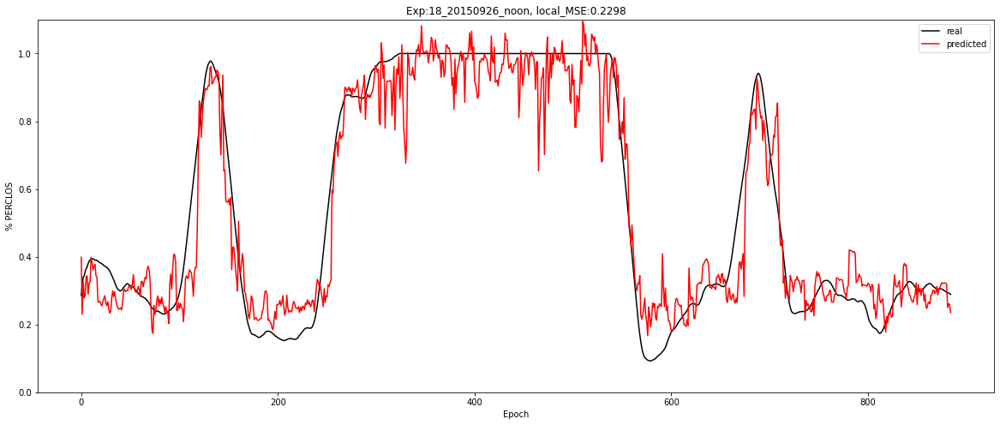

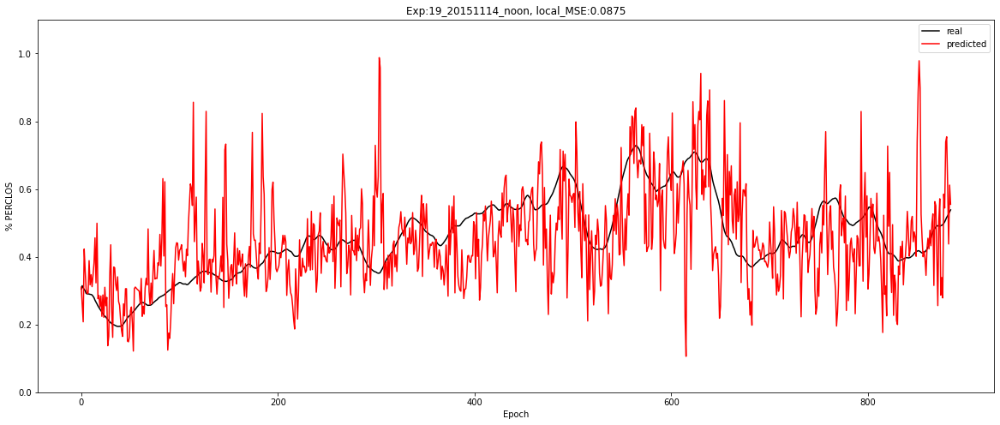

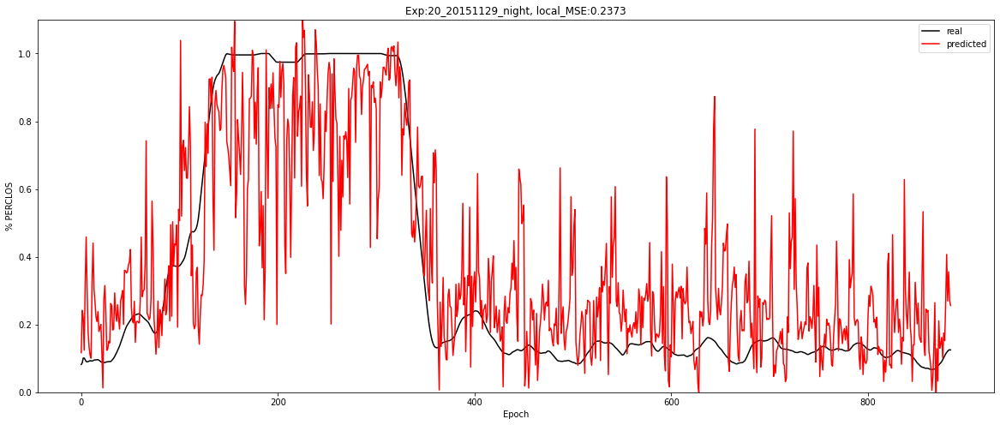

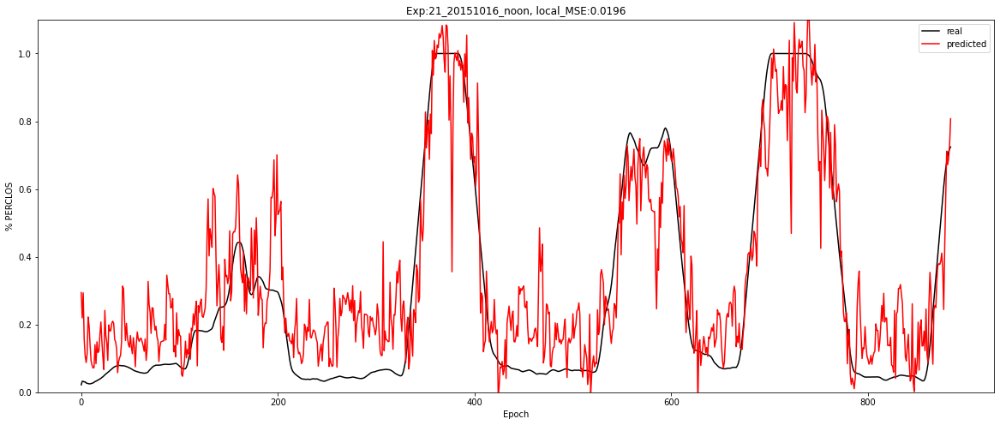

In [44]:
for key in X_all:
    data = X_all[key]
    expected = y_all[key]

    predictions = DL_model.predict(np.reshape(data, (data.shape[0],data.shape[1],1)))
    local_mse = mean_squared_error(np.reshape(expected, (expected.shape[0],1)), prediction)
    
    plt.figure(figsize=(20, 8))
    plt.plot(expected, color="black", label="real")
    plt.plot(predictions, color="red", label="predicted")
    plt.title(f'Exp:{key}, local_MSE:{local_mse:.4f}')
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.legend(loc='best')
    plt.ylim(0, 1.1)
    plt.show()